<a href="https://colab.research.google.com/github/OlegPozovnoy/RLHW3/blob/master/HW3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import json
import math
import random
import numpy as np
import scipy as sp
import scipy.stats as st
import scipy.integrate as integrate
from scipy.stats import multivariate_normal
from sklearn import linear_model
from sklearn.utils.testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning
import statsmodels.api as sm
from matplotlib.colors import LogNorm
import pickle

from joblib import Parallel, delayed
import multiprocessing
from collections import namedtuple
from itertools import count

import cProfile
from datetime import datetime

sns.set_style("whitegrid")
sns.set_palette("colorblind")
palette = sns.color_palette()
figsize = (15,8)
legend_fontsize = 16

from matplotlib import rc

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.utils.testing module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.utils. Anything that cannot be imported from sklearn.utils is now part of the private API.
  warnings.warn(message, FutureWarning)
/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.autograd import Variable
from torchvision.utils import save_image

import torchvision.datasets as datasets
from torchvision.utils import make_grid

## Pix2Pix

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
def plot_losses(d_losses, g_losses):
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111)

    n_epochs = len(d_losses) - 1
    x_train = np.linspace(0, n_epochs, len(d_losses))
    x_test = np.arange(n_epochs + 1)

    ax.plot(x_train, d_losses, label='Ошибка дискриминатора')
    ax.plot(x_test, g_losses, label='Ошибка генератора')
    ax.legend()
    plt.xlabel('Эпоха обучения')
    plt.ylabel('Ошибка')
    plt.show()

In [5]:

class ConvBlock(torch.nn.Module):
    def __init__(self, input_size, output_size, kernel_size=4, stride=2, padding=1, activation=True, batch_norm=True):
        super(ConvBlock, self).__init__()
        self.conv = torch.nn.Conv2d(input_size, output_size, kernel_size, stride, padding)
        self.activation = activation
        self.lrelu = torch.nn.LeakyReLU(0.2, True)
        self.batch_norm = batch_norm
        self.bn = torch.nn.BatchNorm2d(output_size)

    def forward(self, x):
        if self.activation:
            out = self.conv(self.lrelu(x))
        else:
            out = self.conv(x)

        if self.batch_norm:
            return self.bn(out)
        else:
            return out


class DeconvBlock(torch.nn.Module):
    def __init__(self, input_size, output_size, kernel_size=4, stride=2, padding=1, batch_norm=True):
        super(DeconvBlock, self).__init__()
        self.deconv = torch.nn.ConvTranspose2d(input_size, output_size,
                                               kernel_size, stride, padding)
        self.bn = torch.nn.BatchNorm2d(output_size)
        self.drop = torch.nn.Dropout(0.25)
        self.relu = torch.nn.ReLU(True)
        self.batch_norm = batch_norm

    def forward(self, x):
        if self.batch_norm:
            out = self.bn(self.deconv(self.relu(x)))
        else:
            out = self.deconv(self.relu(x))

        return out


class Generator(torch.nn.Module):
    def __init__(self, input_dim, output_dim):
        super(Generator, self).__init__()


        self.conv1 = ConvBlock(input_dim, 64, activation=False, batch_norm=False)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512)
        self.conv5 = ConvBlock(512, 512, batch_norm=False)

        self.deconv1 = DeconvBlock(512, 512)
        self.deconv2 = DeconvBlock(1024, 256)
        self.deconv3 = DeconvBlock(512, 128)
        self.deconv4 = DeconvBlock(256, 64)
        self.deconv5 = DeconvBlock(128, output_dim, batch_norm=False)

    def forward(self, x):
        enc1 = self.conv1(x)
        enc2 = self.conv2(enc1)
        enc3 = self.conv3(enc2)
        enc4 = self.conv4(enc3)
        enc5 = self.conv5(enc4)

        dec1 = self.deconv1(enc5)
        dec1 = torch.cat([dec1, enc4], 1)
        dec2 = self.deconv2(dec1)
        dec2 = torch.cat([dec2, enc3], 1)
        dec3 = self.deconv3(dec2)
        dec3 = torch.cat([dec3, enc2], 1)
        dec4 = self.deconv4(dec3)
        dec4 = torch.cat([dec4, enc1], 1)
        dec5 = self.deconv5(dec4)
        out = torch.nn.Tanh()(dec5)
        return out


class Discriminator(torch.nn.Module):
    def __init__(self, input_dim):
        super(Discriminator, self).__init__()

        self.conv1 = ConvBlock(input_dim, 64, activation=False, batch_norm=False)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512, stride=1)
        self.conv5 = ConvBlock(512, 1, stride=1, batch_norm=False)

    def forward(self, x, label):
        x = torch.cat([x, label], 1)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        out = torch.nn.Sigmoid()(x)
        return out

    def normal_weight_init(self, mean=0.0, std=0.02):
        for m in self.children():
            if isinstance(m, ConvBlock):
                torch.nn.init.normal(m.conv.weight, mean, std)




In [6]:
import torch.utils.data as data
import os
from PIL import Image

class loadData(data.Dataset):
    def __init__(self, image_dir, subfolder, transform):
        super(loadData, self).__init__()
        self.input_path = os.path.join(image_dir, subfolder)
        self.image_filenames = [x for x in sorted(os.listdir(self.input_path))]
        self.transform = transform

    def __getitem__(self, index):
        fileim = os.path.join(self.input_path, self.image_filenames[index])
        img = Image.open(fileim)
        
        image = img.crop((0, 0, img.width // 2, img.height))
        templ = img.crop((img.width // 2, 0, img.width, img.height))
        
        image = self.transform(image)
        templ = self.transform(templ)

        return templ, image

    def __len__(self):
        return len(self.image_filenames)

	...epoch 0/100	batch 0/7	D loss: 1.411667	G loss: 66.224449
	...epoch 0/100	batch 1/7	D loss: 1.664620	G loss: 59.657192
	...epoch 0/100	batch 2/7	D loss: 1.581925	G loss: 53.926270
	...epoch 0/100	batch 3/7	D loss: 1.448056	G loss: 51.669060
	...epoch 0/100	batch 4/7	D loss: 1.354794	G loss: 49.979500
	...epoch 0/100	batch 5/7	D loss: 1.321823	G loss: 46.626133
	...epoch 0/100	batch 6/7	D loss: 1.267549	G loss: 44.043728


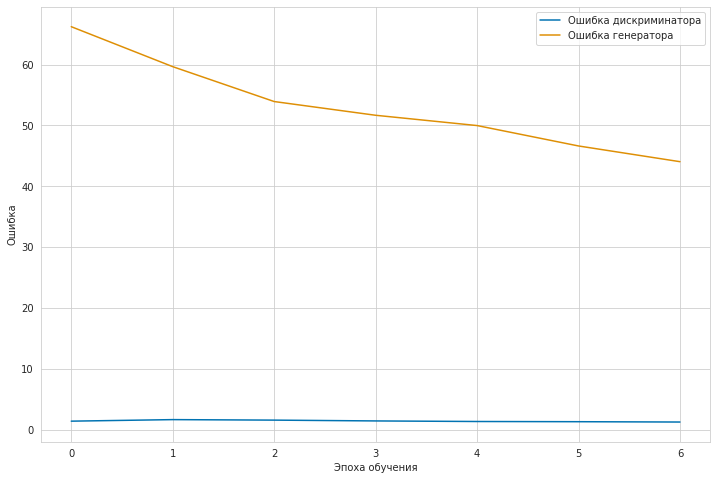

	...epoch 1/100	batch 0/7	D loss: 1.248794	G loss: 44.715473
	...epoch 1/100	batch 1/7	D loss: 1.217234	G loss: 44.653896
	...epoch 1/100	batch 2/7	D loss: 1.182448	G loss: 42.929653
	...epoch 1/100	batch 3/7	D loss: 1.140654	G loss: 42.104256
	...epoch 1/100	batch 4/7	D loss: 1.069834	G loss: 44.540527
	...epoch 1/100	batch 5/7	D loss: 1.051123	G loss: 42.129311
	...epoch 1/100	batch 6/7	D loss: 1.051902	G loss: 41.259186


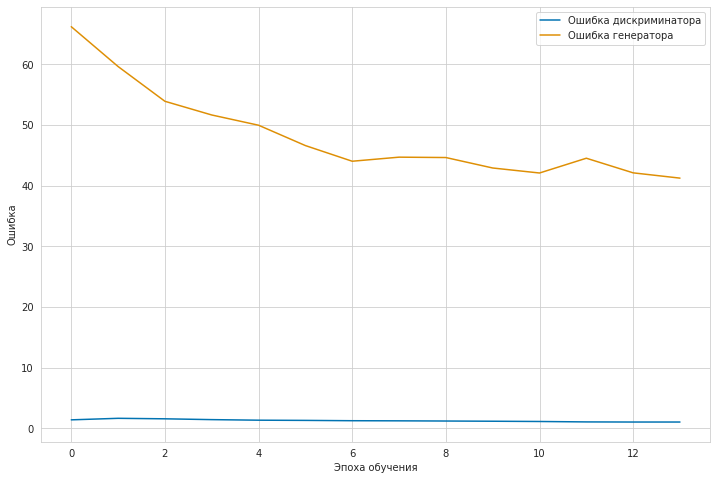

	...epoch 2/100	batch 0/7	D loss: 1.111771	G loss: 41.732285
	...epoch 2/100	batch 1/7	D loss: 0.971411	G loss: 41.674675
	...epoch 2/100	batch 2/7	D loss: 0.891620	G loss: 40.295700
	...epoch 2/100	batch 3/7	D loss: 0.880322	G loss: 39.914238
	...epoch 2/100	batch 4/7	D loss: 0.758985	G loss: 41.528656
	...epoch 2/100	batch 5/7	D loss: 0.706170	G loss: 40.250378
	...epoch 2/100	batch 6/7	D loss: 0.788543	G loss: 39.800869


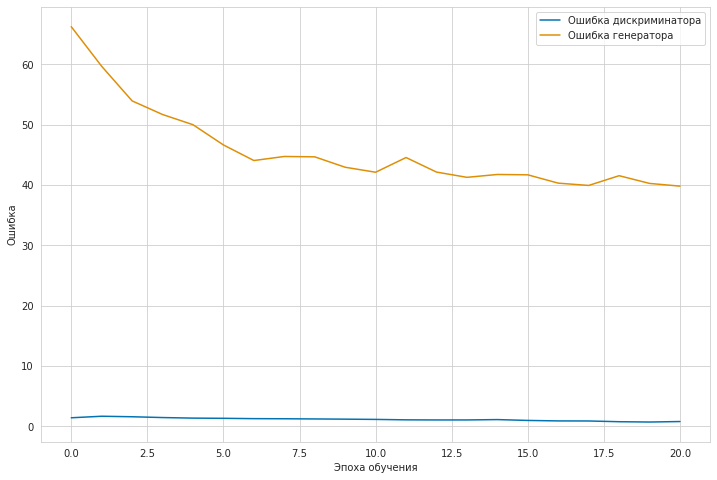

	...epoch 3/100	batch 0/7	D loss: 1.061484	G loss: 42.256927
	...epoch 3/100	batch 1/7	D loss: 0.830274	G loss: 40.229084
	...epoch 3/100	batch 2/7	D loss: 0.728431	G loss: 39.404324
	...epoch 3/100	batch 3/7	D loss: 0.632365	G loss: 39.958263
	...epoch 3/100	batch 4/7	D loss: 0.587660	G loss: 39.400761
	...epoch 3/100	batch 5/7	D loss: 0.569424	G loss: 38.237488
	...epoch 3/100	batch 6/7	D loss: 0.545200	G loss: 40.071949


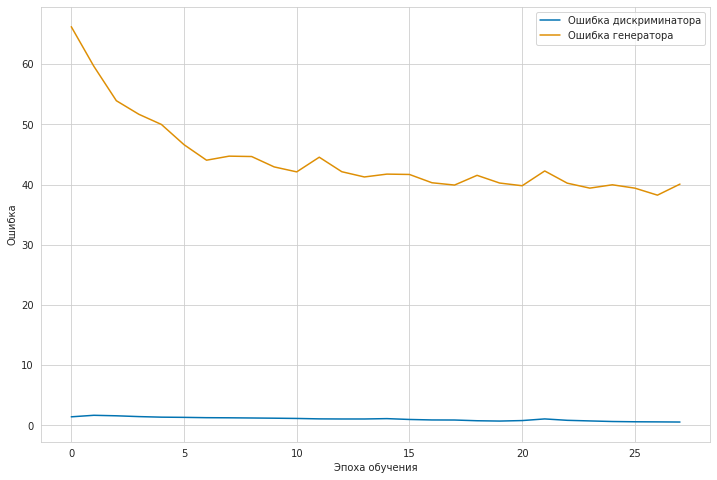

	...epoch 4/100	batch 0/7	D loss: 0.462618	G loss: 39.737450
	...epoch 4/100	batch 1/7	D loss: 0.447398	G loss: 39.585270
	...epoch 4/100	batch 2/7	D loss: 0.383177	G loss: 39.110222
	...epoch 4/100	batch 3/7	D loss: 0.411552	G loss: 39.077290
	...epoch 4/100	batch 4/7	D loss: 0.427086	G loss: 38.678932
	...epoch 4/100	batch 5/7	D loss: 0.413941	G loss: 39.230759
	...epoch 4/100	batch 6/7	D loss: 0.354460	G loss: 39.342388


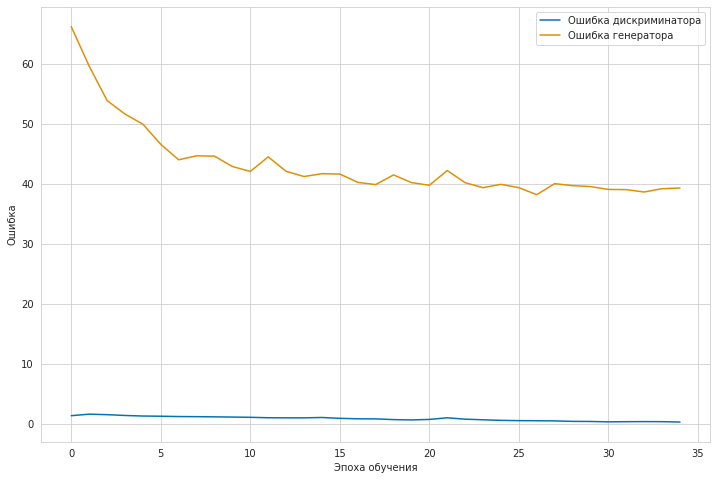

	...epoch 5/100	batch 0/7	D loss: 0.375653	G loss: 39.766148
	...epoch 5/100	batch 1/7	D loss: 0.317047	G loss: 38.651070
	...epoch 5/100	batch 2/7	D loss: 0.261531	G loss: 40.154133
	...epoch 5/100	batch 3/7	D loss: 0.243913	G loss: 39.608696
	...epoch 5/100	batch 4/7	D loss: 0.250353	G loss: 37.541466
	...epoch 5/100	batch 5/7	D loss: 0.232737	G loss: 37.982510
	...epoch 5/100	batch 6/7	D loss: 0.315816	G loss: 39.594559


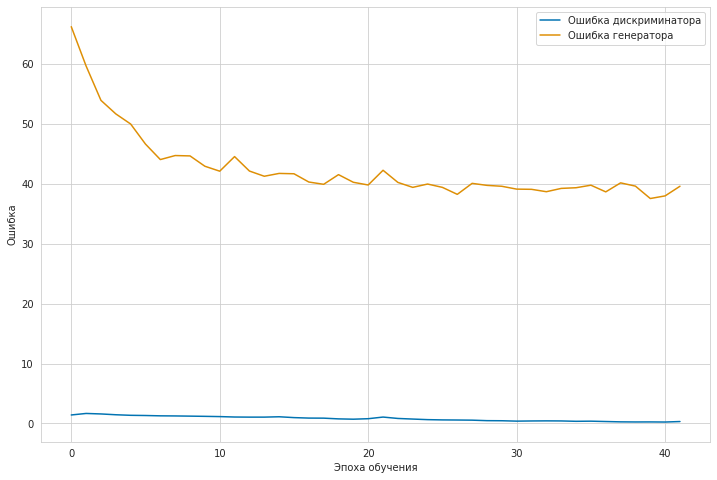

	...epoch 6/100	batch 0/7	D loss: 0.667319	G loss: 38.458572
	...epoch 6/100	batch 1/7	D loss: 1.764972	G loss: 39.828499
	...epoch 6/100	batch 2/7	D loss: 0.820161	G loss: 37.788536
	...epoch 6/100	batch 3/7	D loss: 0.986542	G loss: 38.020317
	...epoch 6/100	batch 4/7	D loss: 0.877805	G loss: 38.412552
	...epoch 6/100	batch 5/7	D loss: 0.759020	G loss: 38.279602
	...epoch 6/100	batch 6/7	D loss: 1.218813	G loss: 38.097736


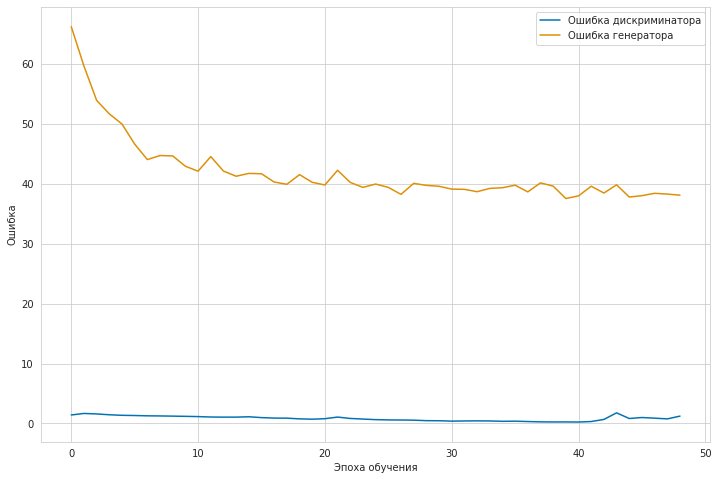

	...epoch 7/100	batch 0/7	D loss: 0.800920	G loss: 38.594162
	...epoch 7/100	batch 1/7	D loss: 0.762167	G loss: 38.048622
	...epoch 7/100	batch 2/7	D loss: 0.893237	G loss: 37.676414
	...epoch 7/100	batch 3/7	D loss: 0.795033	G loss: 37.948975
	...epoch 7/100	batch 4/7	D loss: 0.877501	G loss: 37.051071
	...epoch 7/100	batch 5/7	D loss: 0.637925	G loss: 38.530800
	...epoch 7/100	batch 6/7	D loss: 0.519536	G loss: 37.368217


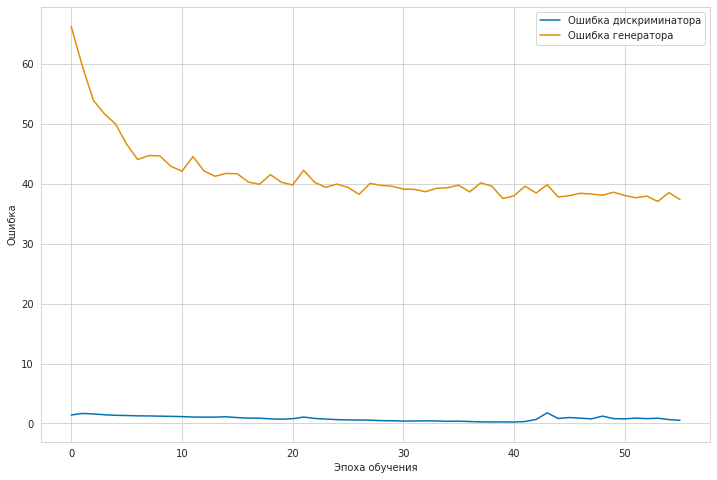

	...epoch 8/100	batch 0/7	D loss: 0.537673	G loss: 38.751160
	...epoch 8/100	batch 1/7	D loss: 0.509337	G loss: 39.189682
	...epoch 8/100	batch 2/7	D loss: 0.537350	G loss: 38.086025
	...epoch 8/100	batch 3/7	D loss: 0.797637	G loss: 37.389782
	...epoch 8/100	batch 4/7	D loss: 1.301758	G loss: 37.577717
	...epoch 8/100	batch 5/7	D loss: 0.722884	G loss: 36.285168
	...epoch 8/100	batch 6/7	D loss: 0.975341	G loss: 37.012321


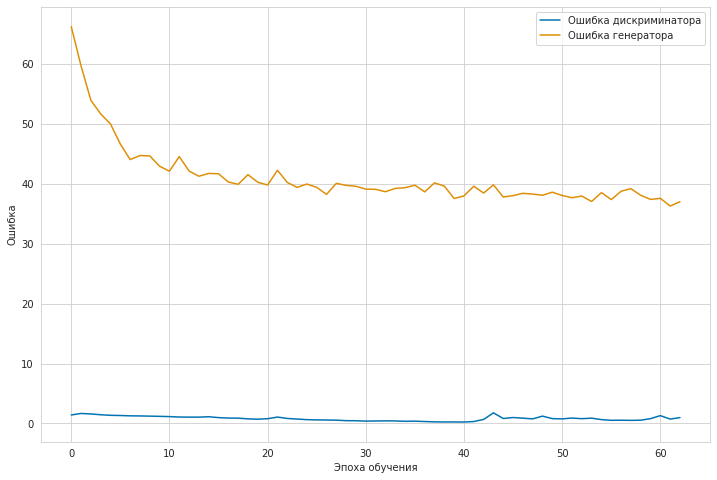

	...epoch 9/100	batch 0/7	D loss: 0.983198	G loss: 37.514503
	...epoch 9/100	batch 1/7	D loss: 0.678890	G loss: 35.989044
	...epoch 9/100	batch 2/7	D loss: 0.763054	G loss: 38.514431
	...epoch 9/100	batch 3/7	D loss: 0.725152	G loss: 36.473545
	...epoch 9/100	batch 4/7	D loss: 0.501526	G loss: 39.563759
	...epoch 9/100	batch 5/7	D loss: 0.568638	G loss: 36.667294
	...epoch 9/100	batch 6/7	D loss: 0.486619	G loss: 37.376022


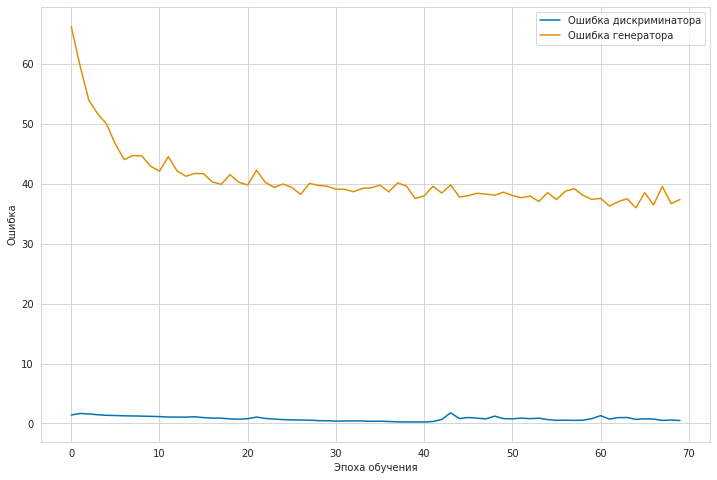

	...epoch 10/100	batch 0/7	D loss: 0.653374	G loss: 37.642273
	...epoch 10/100	batch 1/7	D loss: 0.531784	G loss: 37.130558
	...epoch 10/100	batch 2/7	D loss: 0.518108	G loss: 38.142643
	...epoch 10/100	batch 3/7	D loss: 0.550853	G loss: 38.790596
	...epoch 10/100	batch 4/7	D loss: 0.646145	G loss: 37.193638
	...epoch 10/100	batch 5/7	D loss: 0.812921	G loss: 37.589333
	...epoch 10/100	batch 6/7	D loss: 0.767835	G loss: 39.982185


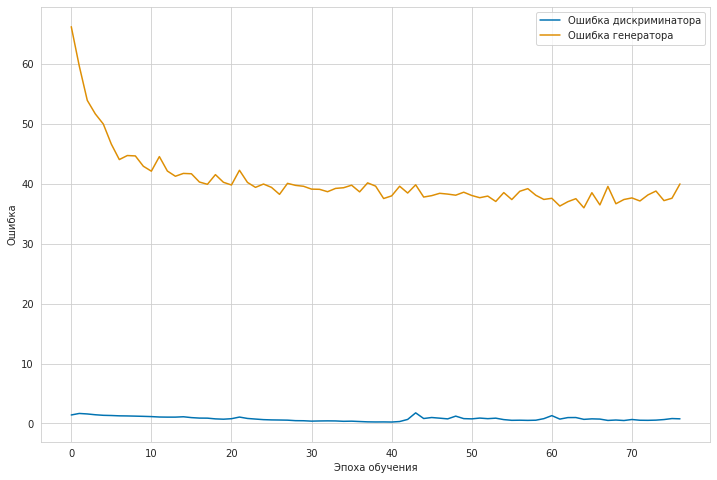

	...epoch 11/100	batch 0/7	D loss: 0.805572	G loss: 37.974030
	...epoch 11/100	batch 1/7	D loss: 0.644681	G loss: 37.498894
	...epoch 11/100	batch 2/7	D loss: 0.449637	G loss: 37.050449
	...epoch 11/100	batch 3/7	D loss: 0.549127	G loss: 36.822403
	...epoch 11/100	batch 4/7	D loss: 0.550014	G loss: 36.579292
	...epoch 11/100	batch 5/7	D loss: 0.414924	G loss: 38.558609
	...epoch 11/100	batch 6/7	D loss: 0.423459	G loss: 37.836708


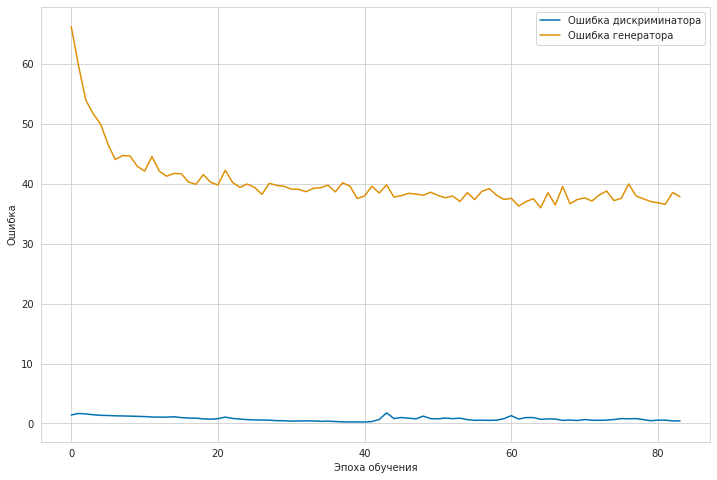

	...epoch 12/100	batch 0/7	D loss: 0.700655	G loss: 38.720383
	...epoch 12/100	batch 1/7	D loss: 0.911184	G loss: 37.278584
	...epoch 12/100	batch 2/7	D loss: 0.539988	G loss: 38.389210
	...epoch 12/100	batch 3/7	D loss: 0.561283	G loss: 39.647511
	...epoch 12/100	batch 4/7	D loss: 0.477068	G loss: 37.604748
	...epoch 12/100	batch 5/7	D loss: 0.504308	G loss: 37.344093
	...epoch 12/100	batch 6/7	D loss: 0.785159	G loss: 33.513996


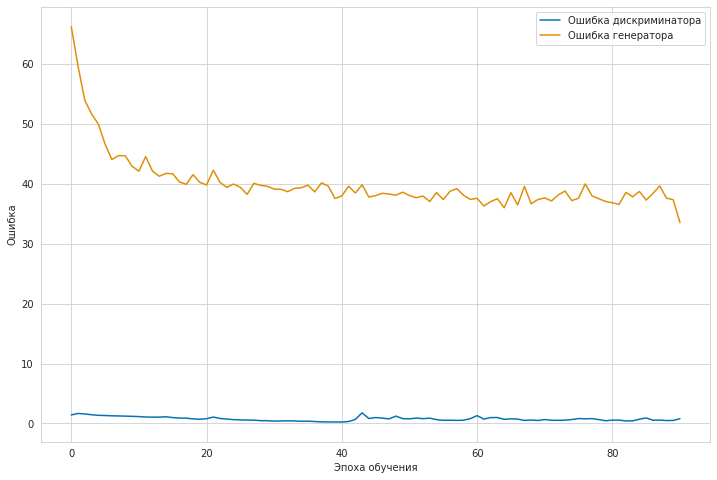

	...epoch 13/100	batch 0/7	D loss: 0.722022	G loss: 38.125805
	...epoch 13/100	batch 1/7	D loss: 0.526887	G loss: 37.775822
	...epoch 13/100	batch 2/7	D loss: 0.480395	G loss: 35.289299
	...epoch 13/100	batch 3/7	D loss: 0.773265	G loss: 39.089890
	...epoch 13/100	batch 4/7	D loss: 0.814255	G loss: 35.902966
	...epoch 13/100	batch 5/7	D loss: 0.517619	G loss: 36.852863
	...epoch 13/100	batch 6/7	D loss: 0.652331	G loss: 38.010052


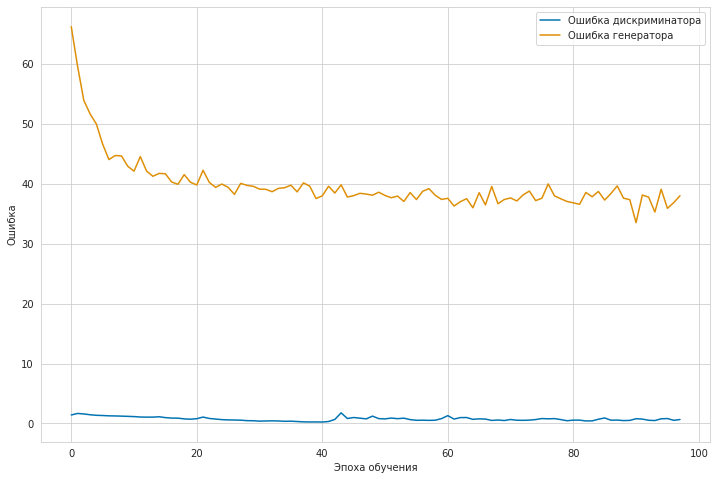

	...epoch 14/100	batch 0/7	D loss: 0.486820	G loss: 37.748928
	...epoch 14/100	batch 1/7	D loss: 0.272136	G loss: 37.784729
	...epoch 14/100	batch 2/7	D loss: 0.408943	G loss: 38.321850
	...epoch 14/100	batch 3/7	D loss: 0.467144	G loss: 36.581585
	...epoch 14/100	batch 4/7	D loss: 0.382408	G loss: 36.852634
	...epoch 14/100	batch 5/7	D loss: 0.402745	G loss: 35.729649
	...epoch 14/100	batch 6/7	D loss: 0.502847	G loss: 37.857861


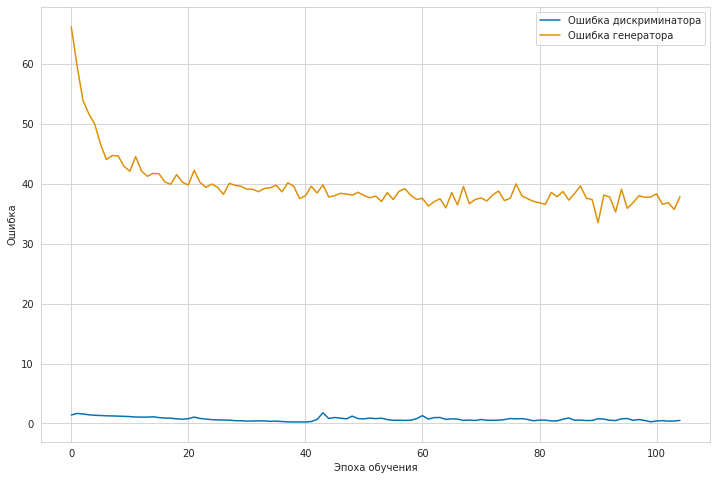

	...epoch 15/100	batch 0/7	D loss: 0.954296	G loss: 36.051491
	...epoch 15/100	batch 1/7	D loss: 0.767824	G loss: 37.633854
	...epoch 15/100	batch 2/7	D loss: 0.551960	G loss: 36.685291
	...epoch 15/100	batch 3/7	D loss: 0.465998	G loss: 34.590244
	...epoch 15/100	batch 4/7	D loss: 0.741935	G loss: 37.336323
	...epoch 15/100	batch 5/7	D loss: 0.789052	G loss: 38.561920
	...epoch 15/100	batch 6/7	D loss: 0.601135	G loss: 35.143734


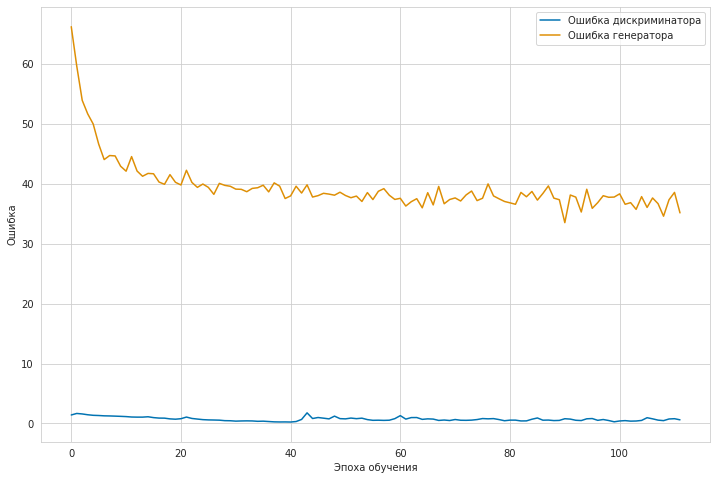

	...epoch 16/100	batch 0/7	D loss: 0.370093	G loss: 37.221066
	...epoch 16/100	batch 1/7	D loss: 0.293636	G loss: 38.598660
	...epoch 16/100	batch 2/7	D loss: 0.452856	G loss: 35.811707
	...epoch 16/100	batch 3/7	D loss: 0.417993	G loss: 35.276379
	...epoch 16/100	batch 4/7	D loss: 0.513806	G loss: 37.577976
	...epoch 16/100	batch 5/7	D loss: 0.868889	G loss: 35.903008
	...epoch 16/100	batch 6/7	D loss: 0.545715	G loss: 36.961754


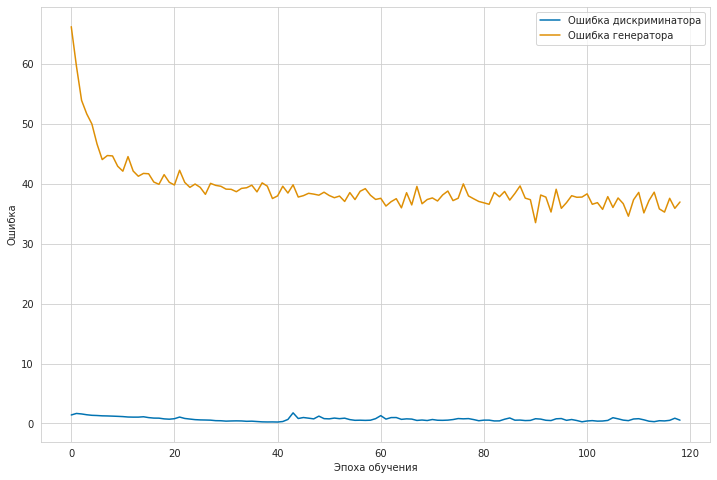

	...epoch 17/100	batch 0/7	D loss: 0.372743	G loss: 37.181206
	...epoch 17/100	batch 1/7	D loss: 0.414450	G loss: 37.275295
	...epoch 17/100	batch 2/7	D loss: 0.456419	G loss: 34.004299
	...epoch 17/100	batch 3/7	D loss: 0.787576	G loss: 37.450577
	...epoch 17/100	batch 4/7	D loss: 0.898025	G loss: 37.211231
	...epoch 17/100	batch 5/7	D loss: 0.781886	G loss: 37.685715
	...epoch 17/100	batch 6/7	D loss: 0.821539	G loss: 37.478218


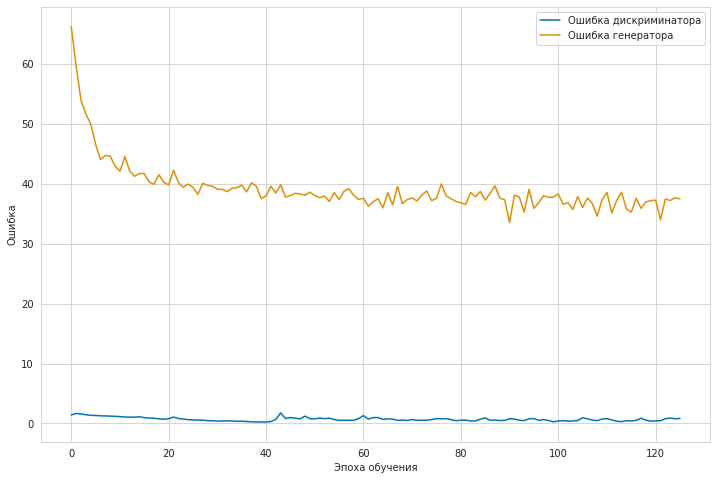

	...epoch 18/100	batch 0/7	D loss: 0.860993	G loss: 35.352253
	...epoch 18/100	batch 1/7	D loss: 0.746578	G loss: 34.771751
	...epoch 18/100	batch 2/7	D loss: 0.483152	G loss: 37.513393
	...epoch 18/100	batch 3/7	D loss: 0.436628	G loss: 36.919388
	...epoch 18/100	batch 4/7	D loss: 0.476938	G loss: 35.297649
	...epoch 18/100	batch 5/7	D loss: 0.338939	G loss: 36.490383
	...epoch 18/100	batch 6/7	D loss: 0.418791	G loss: 33.795132


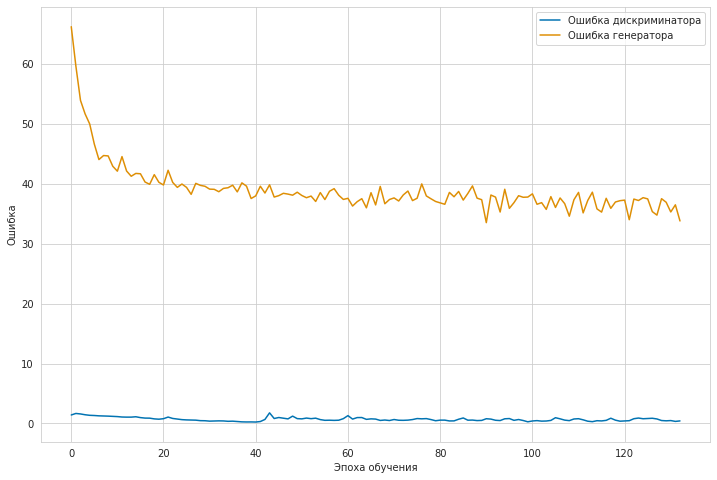

	...epoch 19/100	batch 0/7	D loss: 1.009965	G loss: 37.825115
	...epoch 19/100	batch 1/7	D loss: 1.899053	G loss: 35.702206
	...epoch 19/100	batch 2/7	D loss: 0.795484	G loss: 34.623100
	...epoch 19/100	batch 3/7	D loss: 1.070345	G loss: 34.009251
	...epoch 19/100	batch 4/7	D loss: 0.764517	G loss: 35.548233
	...epoch 19/100	batch 5/7	D loss: 0.976659	G loss: 33.940311
	...epoch 19/100	batch 6/7	D loss: 0.646443	G loss: 34.255493


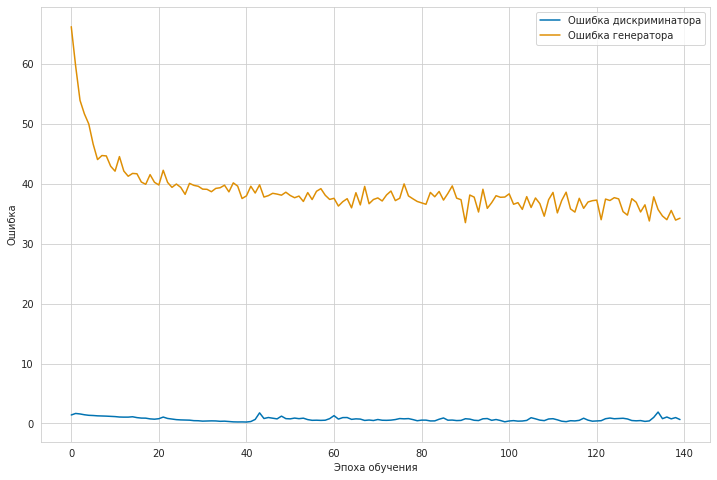

	...epoch 20/100	batch 0/7	D loss: 0.385153	G loss: 34.884598
	...epoch 20/100	batch 1/7	D loss: 0.520745	G loss: 35.543415
	...epoch 20/100	batch 2/7	D loss: 0.518957	G loss: 33.406101
	...epoch 20/100	batch 3/7	D loss: 0.562380	G loss: 36.628513
	...epoch 20/100	batch 4/7	D loss: 0.399245	G loss: 34.741943
	...epoch 20/100	batch 5/7	D loss: 0.334157	G loss: 37.022869
	...epoch 20/100	batch 6/7	D loss: 0.453042	G loss: 34.336452


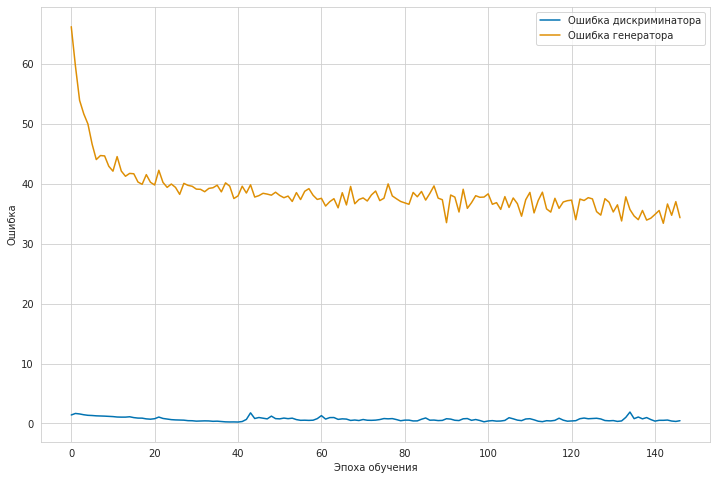

	...epoch 21/100	batch 0/7	D loss: 0.347616	G loss: 37.398285
	...epoch 21/100	batch 1/7	D loss: 0.269034	G loss: 34.328609
	...epoch 21/100	batch 2/7	D loss: 0.292345	G loss: 36.674377
	...epoch 21/100	batch 3/7	D loss: 0.259977	G loss: 35.706627
	...epoch 21/100	batch 4/7	D loss: 0.229472	G loss: 36.707756
	...epoch 21/100	batch 5/7	D loss: 0.266273	G loss: 36.128342
	...epoch 21/100	batch 6/7	D loss: 0.282876	G loss: 36.182358


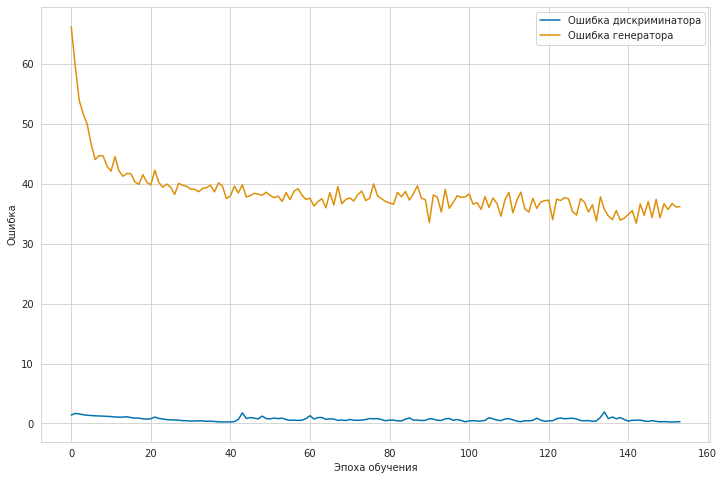

	...epoch 22/100	batch 0/7	D loss: 0.362452	G loss: 36.207020
	...epoch 22/100	batch 1/7	D loss: 0.502851	G loss: 35.207050
	...epoch 22/100	batch 2/7	D loss: 0.875526	G loss: 32.557606
	...epoch 22/100	batch 3/7	D loss: 1.011100	G loss: 35.086430
	...epoch 22/100	batch 4/7	D loss: 0.758789	G loss: 33.438091
	...epoch 22/100	batch 5/7	D loss: 0.876696	G loss: 34.923866
	...epoch 22/100	batch 6/7	D loss: 0.457537	G loss: 37.094364


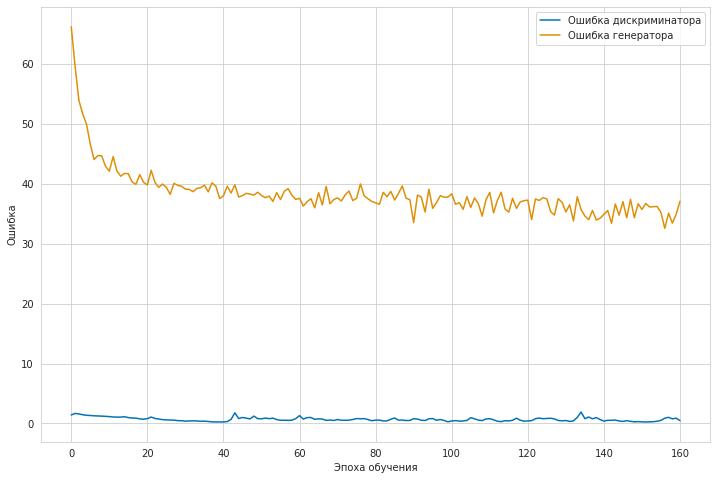

	...epoch 23/100	batch 0/7	D loss: 0.525260	G loss: 33.896309
	...epoch 23/100	batch 1/7	D loss: 0.891043	G loss: 33.715034
	...epoch 23/100	batch 2/7	D loss: 0.611367	G loss: 33.731472
	...epoch 23/100	batch 3/7	D loss: 0.510026	G loss: 34.596489
	...epoch 23/100	batch 4/7	D loss: 0.403755	G loss: 34.600441
	...epoch 23/100	batch 5/7	D loss: 0.463987	G loss: 34.619541
	...epoch 23/100	batch 6/7	D loss: 0.458778	G loss: 35.762207


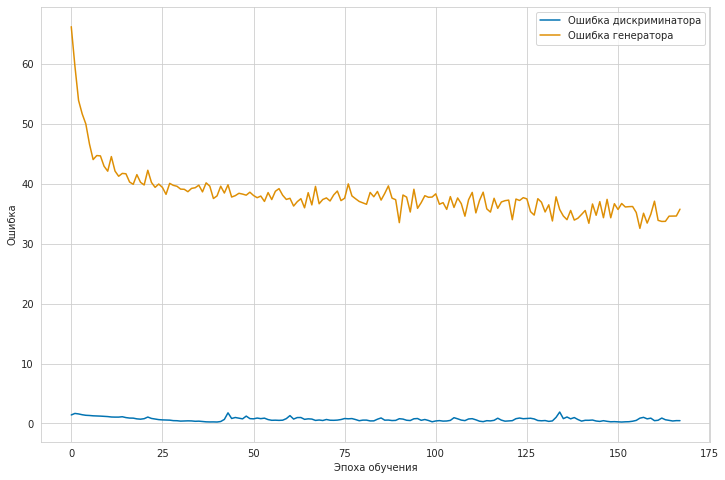

	...epoch 24/100	batch 0/7	D loss: 0.534231	G loss: 34.034889
	...epoch 24/100	batch 1/7	D loss: 0.450234	G loss: 34.289429
	...epoch 24/100	batch 2/7	D loss: 0.534792	G loss: 34.209751
	...epoch 24/100	batch 3/7	D loss: 0.837220	G loss: 32.700588
	...epoch 24/100	batch 4/7	D loss: 0.578657	G loss: 36.126144
	...epoch 24/100	batch 5/7	D loss: 0.389868	G loss: 32.859287
	...epoch 24/100	batch 6/7	D loss: 0.497238	G loss: 36.046139


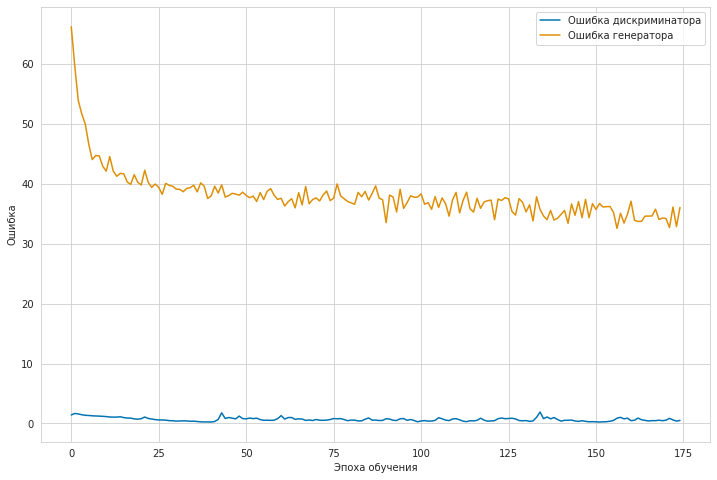

	...epoch 25/100	batch 0/7	D loss: 0.739919	G loss: 39.739784
	...epoch 25/100	batch 1/7	D loss: 1.593847	G loss: 32.957504
	...epoch 25/100	batch 2/7	D loss: 1.008571	G loss: 32.252483
	...epoch 25/100	batch 3/7	D loss: 0.800752	G loss: 34.686108
	...epoch 25/100	batch 4/7	D loss: 0.605393	G loss: 33.065399
	...epoch 25/100	batch 5/7	D loss: 0.393079	G loss: 30.513123
	...epoch 25/100	batch 6/7	D loss: 0.916485	G loss: 33.189930


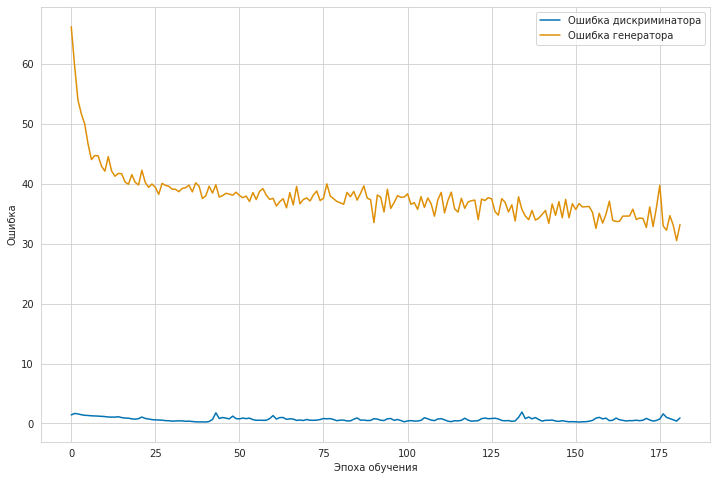

	...epoch 26/100	batch 0/7	D loss: 1.152185	G loss: 32.436104
	...epoch 26/100	batch 1/7	D loss: 0.397458	G loss: 30.981361
	...epoch 26/100	batch 2/7	D loss: 0.579943	G loss: 33.626617
	...epoch 26/100	batch 3/7	D loss: 0.415442	G loss: 32.044262
	...epoch 26/100	batch 4/7	D loss: 0.384898	G loss: 32.541523
	...epoch 26/100	batch 5/7	D loss: 0.376292	G loss: 34.914139
	...epoch 26/100	batch 6/7	D loss: 0.400302	G loss: 32.208973


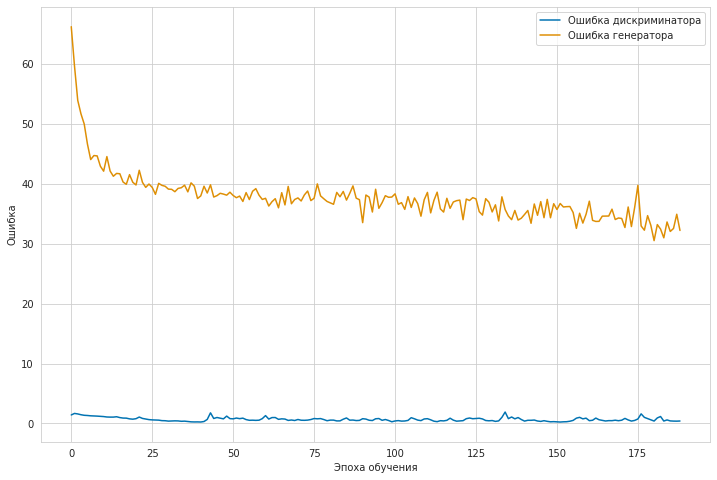

	...epoch 27/100	batch 0/7	D loss: 0.569793	G loss: 33.199928
	...epoch 27/100	batch 1/7	D loss: 0.840637	G loss: 30.416628
	...epoch 27/100	batch 2/7	D loss: 0.469923	G loss: 31.861494
	...epoch 27/100	batch 3/7	D loss: 0.385235	G loss: 32.497383
	...epoch 27/100	batch 4/7	D loss: 0.399616	G loss: 32.899372
	...epoch 27/100	batch 5/7	D loss: 0.486152	G loss: 32.422020
	...epoch 27/100	batch 6/7	D loss: 0.687043	G loss: 33.509056


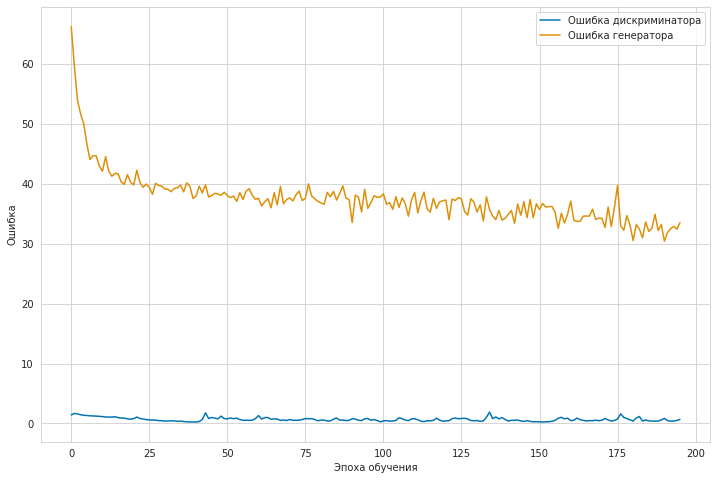

	...epoch 28/100	batch 0/7	D loss: 1.339961	G loss: 31.400236
	...epoch 28/100	batch 1/7	D loss: 0.384930	G loss: 31.585602
	...epoch 28/100	batch 2/7	D loss: 0.805939	G loss: 34.322063
	...epoch 28/100	batch 3/7	D loss: 0.658198	G loss: 32.214249
	...epoch 28/100	batch 4/7	D loss: 0.481129	G loss: 31.174358
	...epoch 28/100	batch 5/7	D loss: 0.679905	G loss: 33.177204
	...epoch 28/100	batch 6/7	D loss: 1.443655	G loss: 29.924551


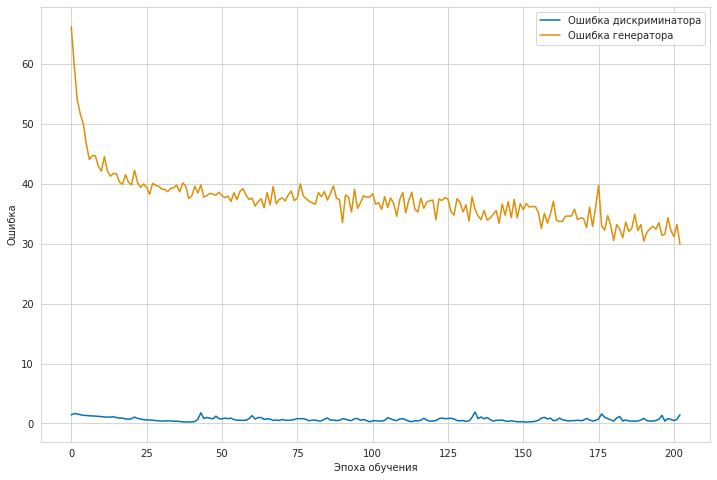

	...epoch 29/100	batch 0/7	D loss: 0.596772	G loss: 30.262926
	...epoch 29/100	batch 1/7	D loss: 0.684759	G loss: 31.009426
	...epoch 29/100	batch 2/7	D loss: 0.572790	G loss: 30.419649
	...epoch 29/100	batch 3/7	D loss: 0.557458	G loss: 32.993340
	...epoch 29/100	batch 4/7	D loss: 0.578589	G loss: 31.059147
	...epoch 29/100	batch 5/7	D loss: 0.394663	G loss: 30.875881
	...epoch 29/100	batch 6/7	D loss: 0.482603	G loss: 31.654888


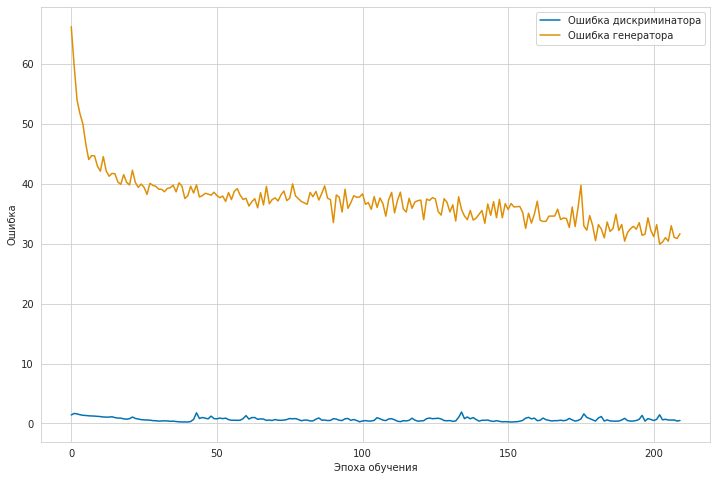

	...epoch 30/100	batch 0/7	D loss: 0.500455	G loss: 30.490602
	...epoch 30/100	batch 1/7	D loss: 0.538492	G loss: 32.620213
	...epoch 30/100	batch 2/7	D loss: 1.033227	G loss: 29.449650
	...epoch 30/100	batch 3/7	D loss: 0.727744	G loss: 31.023556
	...epoch 30/100	batch 4/7	D loss: 0.501892	G loss: 29.456257
	...epoch 30/100	batch 5/7	D loss: 0.612133	G loss: 30.466587
	...epoch 30/100	batch 6/7	D loss: 0.344672	G loss: 33.102589


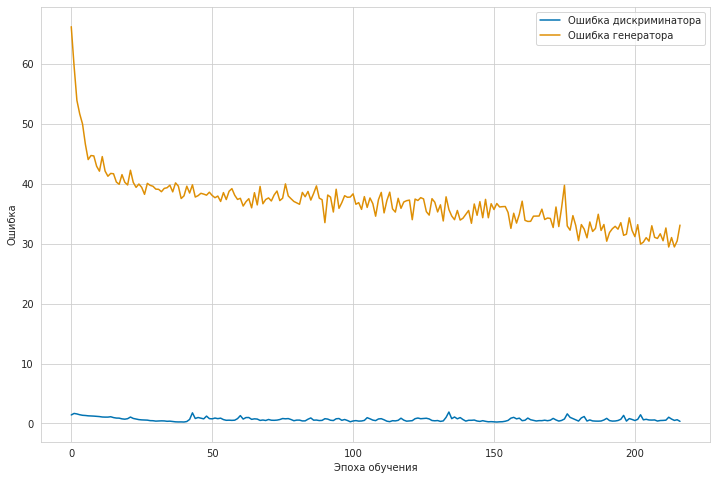

	...epoch 31/100	batch 0/7	D loss: 0.421017	G loss: 31.258720
	...epoch 31/100	batch 1/7	D loss: 0.499834	G loss: 29.954662
	...epoch 31/100	batch 2/7	D loss: 0.799191	G loss: 32.050678
	...epoch 31/100	batch 3/7	D loss: 1.225971	G loss: 29.672483
	...epoch 31/100	batch 4/7	D loss: 0.751320	G loss: 31.240650
	...epoch 31/100	batch 5/7	D loss: 0.729954	G loss: 28.392189
	...epoch 31/100	batch 6/7	D loss: 0.423673	G loss: 31.706896


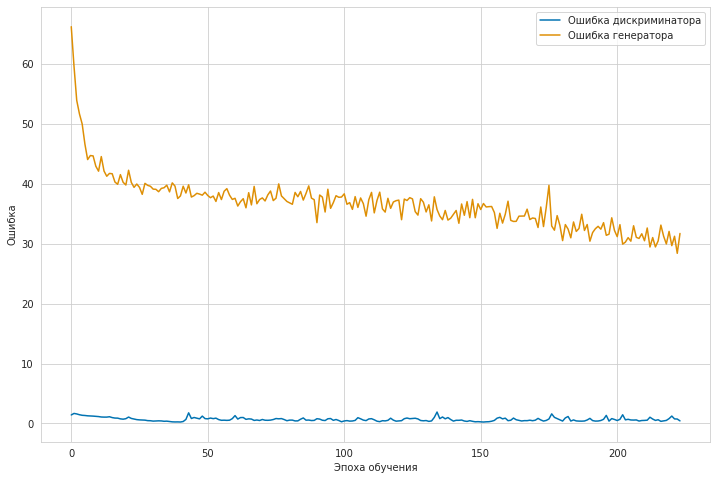

	...epoch 32/100	batch 0/7	D loss: 0.575713	G loss: 31.749924
	...epoch 32/100	batch 1/7	D loss: 0.458957	G loss: 31.376549
	...epoch 32/100	batch 2/7	D loss: 0.772801	G loss: 33.501530
	...epoch 32/100	batch 3/7	D loss: 1.156435	G loss: 28.533915
	...epoch 32/100	batch 4/7	D loss: 0.548436	G loss: 28.576565
	...epoch 32/100	batch 5/7	D loss: 0.555585	G loss: 29.430408
	...epoch 32/100	batch 6/7	D loss: 0.513076	G loss: 28.975243


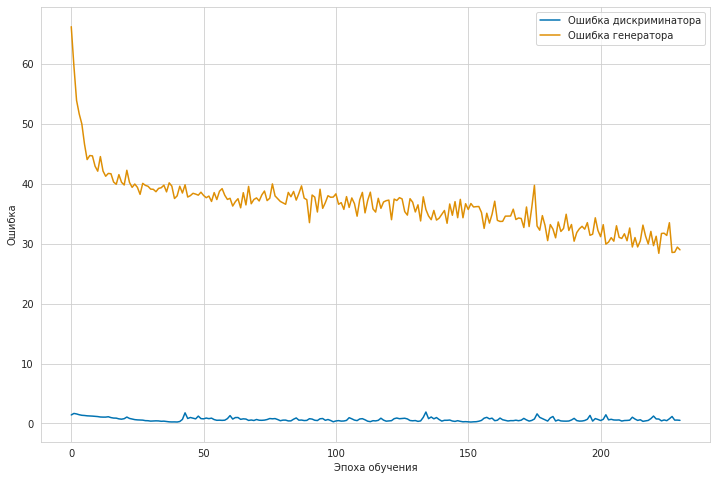

	...epoch 33/100	batch 0/7	D loss: 1.376990	G loss: 30.389837
	...epoch 33/100	batch 1/7	D loss: 1.667902	G loss: 30.182697
	...epoch 33/100	batch 2/7	D loss: 0.751722	G loss: 27.594702
	...epoch 33/100	batch 3/7	D loss: 0.906824	G loss: 27.432867
	...epoch 33/100	batch 4/7	D loss: 0.802923	G loss: 27.803900
	...epoch 33/100	batch 5/7	D loss: 0.461730	G loss: 29.342302
	...epoch 33/100	batch 6/7	D loss: 1.046319	G loss: 31.415516


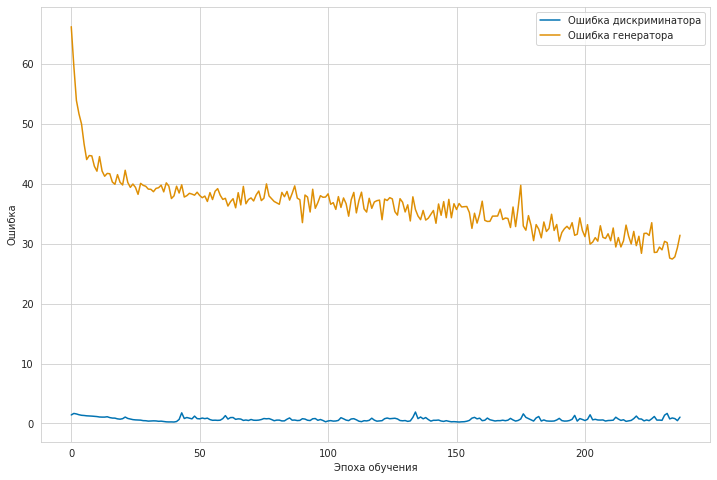

	...epoch 34/100	batch 0/7	D loss: 0.896112	G loss: 30.398333
	...epoch 34/100	batch 1/7	D loss: 0.722653	G loss: 25.948484
	...epoch 34/100	batch 2/7	D loss: 0.690631	G loss: 28.191917
	...epoch 34/100	batch 3/7	D loss: 0.329612	G loss: 29.601030
	...epoch 34/100	batch 4/7	D loss: 0.300187	G loss: 28.748636
	...epoch 34/100	batch 5/7	D loss: 0.471559	G loss: 29.273457
	...epoch 34/100	batch 6/7	D loss: 0.608316	G loss: 27.039679


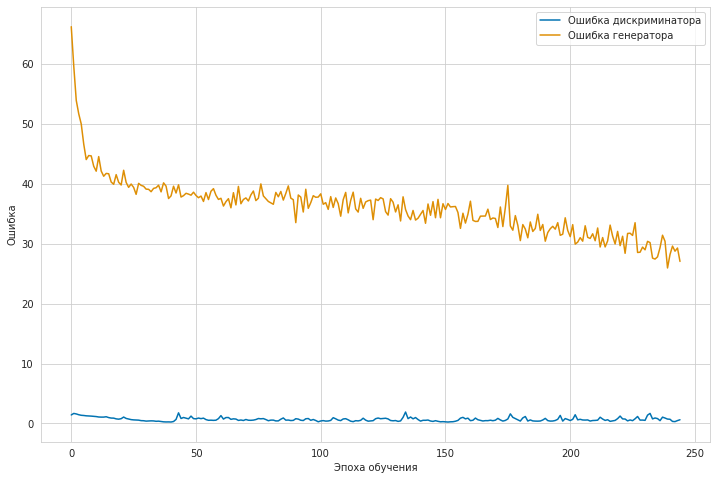

	...epoch 35/100	batch 0/7	D loss: 0.528357	G loss: 28.481705
	...epoch 35/100	batch 1/7	D loss: 0.477196	G loss: 28.311964
	...epoch 35/100	batch 2/7	D loss: 0.540805	G loss: 28.466372
	...epoch 35/100	batch 3/7	D loss: 0.738091	G loss: 27.353394
	...epoch 35/100	batch 4/7	D loss: 0.711411	G loss: 29.251492
	...epoch 35/100	batch 5/7	D loss: 0.609491	G loss: 28.865118
	...epoch 35/100	batch 6/7	D loss: 0.992293	G loss: 28.105211


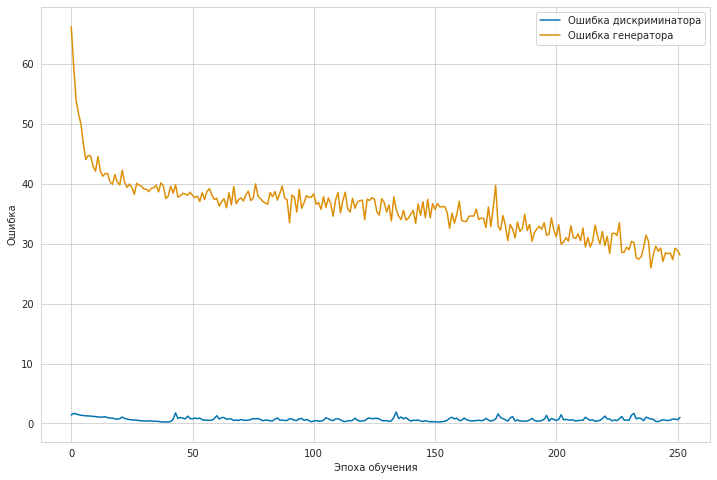

	...epoch 36/100	batch 0/7	D loss: 0.944220	G loss: 26.694563
	...epoch 36/100	batch 1/7	D loss: 0.587498	G loss: 28.403122
	...epoch 36/100	batch 2/7	D loss: 0.601057	G loss: 27.304249
	...epoch 36/100	batch 3/7	D loss: 0.502256	G loss: 27.602106
	...epoch 36/100	batch 4/7	D loss: 1.024859	G loss: 28.725973
	...epoch 36/100	batch 5/7	D loss: 1.475497	G loss: 26.400869
	...epoch 36/100	batch 6/7	D loss: 0.535447	G loss: 26.525946


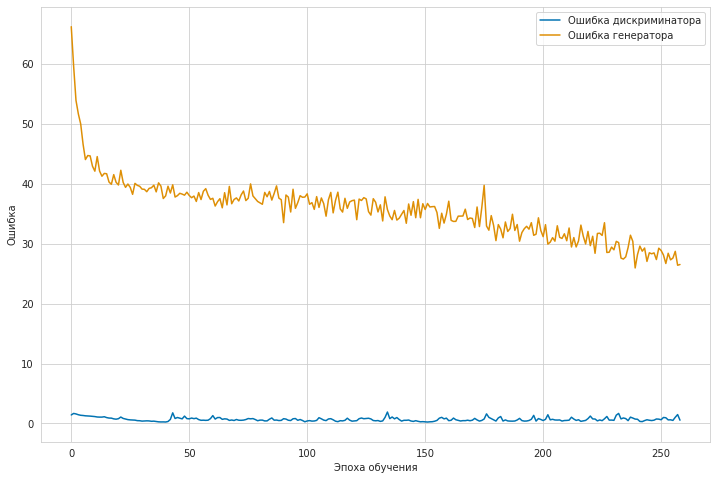

	...epoch 37/100	batch 0/7	D loss: 0.599822	G loss: 27.218555
	...epoch 37/100	batch 1/7	D loss: 0.398355	G loss: 27.681141
	...epoch 37/100	batch 2/7	D loss: 0.594410	G loss: 26.951542
	...epoch 37/100	batch 3/7	D loss: 0.568735	G loss: 26.995630
	...epoch 37/100	batch 4/7	D loss: 0.780994	G loss: 26.271780
	...epoch 37/100	batch 5/7	D loss: 0.850662	G loss: 26.364000
	...epoch 37/100	batch 6/7	D loss: 0.607417	G loss: 28.336975


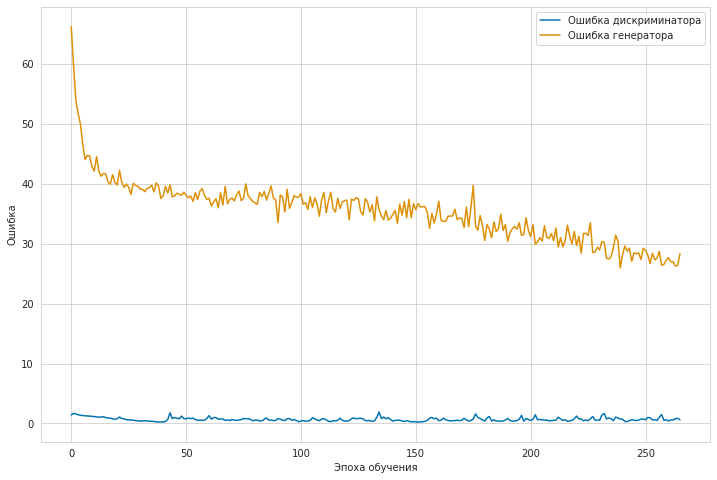

	...epoch 38/100	batch 0/7	D loss: 0.921215	G loss: 26.720232
	...epoch 38/100	batch 1/7	D loss: 0.714769	G loss: 26.661015
	...epoch 38/100	batch 2/7	D loss: 0.612182	G loss: 27.100645
	...epoch 38/100	batch 3/7	D loss: 0.769361	G loss: 26.732101
	...epoch 38/100	batch 4/7	D loss: 0.961350	G loss: 27.236080
	...epoch 38/100	batch 5/7	D loss: 1.068293	G loss: 27.383917
	...epoch 38/100	batch 6/7	D loss: 1.083471	G loss: 24.215900


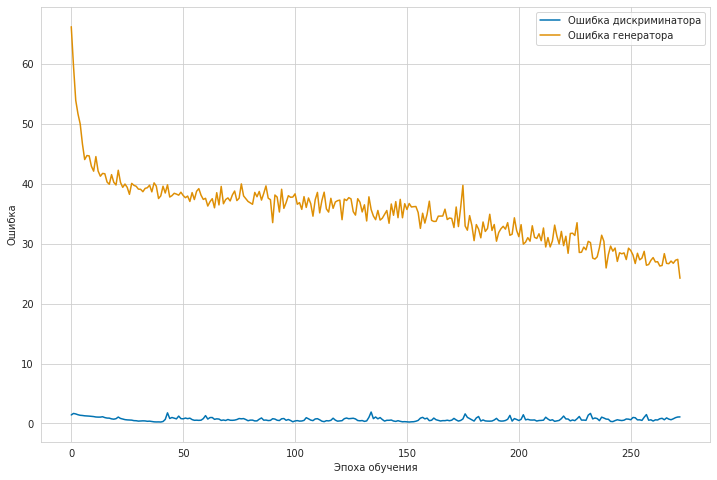

	...epoch 39/100	batch 0/7	D loss: 2.058394	G loss: 28.785305
	...epoch 39/100	batch 1/7	D loss: 1.879775	G loss: 24.156862
	...epoch 39/100	batch 2/7	D loss: 0.996239	G loss: 24.597477
	...epoch 39/100	batch 3/7	D loss: 0.932335	G loss: 23.596497
	...epoch 39/100	batch 4/7	D loss: 0.707923	G loss: 23.759840
	...epoch 39/100	batch 5/7	D loss: 0.890472	G loss: 25.748367
	...epoch 39/100	batch 6/7	D loss: 0.926688	G loss: 26.717766


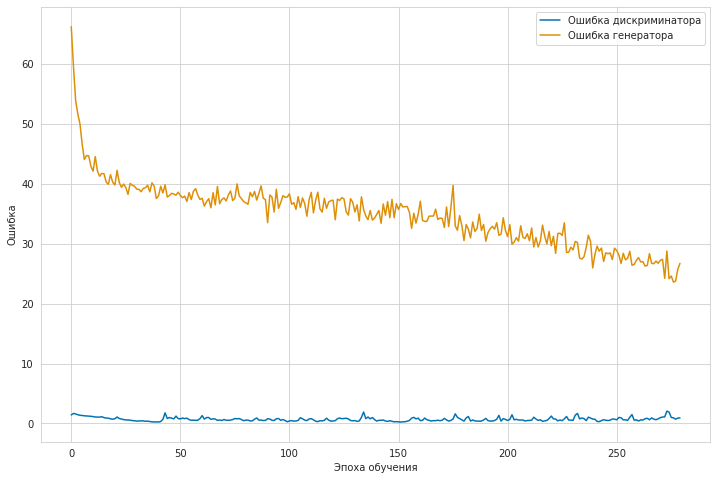

	...epoch 40/100	batch 0/7	D loss: 0.654241	G loss: 24.868311
	...epoch 40/100	batch 1/7	D loss: 0.556072	G loss: 25.147802
	...epoch 40/100	batch 2/7	D loss: 0.462651	G loss: 26.140423
	...epoch 40/100	batch 3/7	D loss: 0.599521	G loss: 24.907097
	...epoch 40/100	batch 4/7	D loss: 0.778014	G loss: 26.904224
	...epoch 40/100	batch 5/7	D loss: 0.903174	G loss: 25.649927
	...epoch 40/100	batch 6/7	D loss: 0.563634	G loss: 27.034403


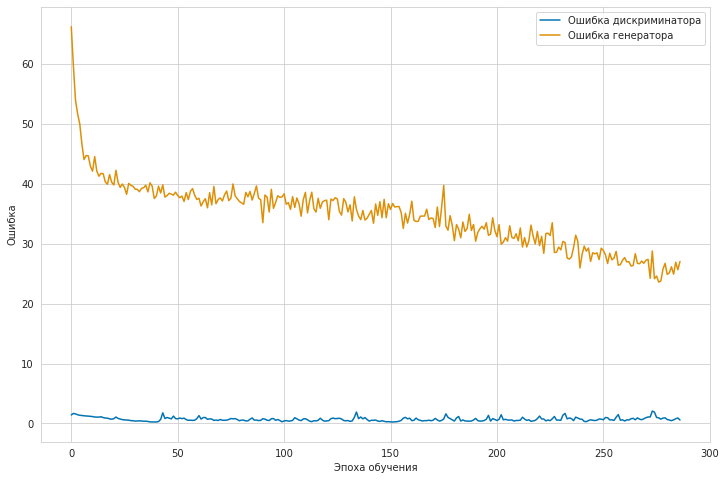

	...epoch 41/100	batch 0/7	D loss: 0.954512	G loss: 26.022038
	...epoch 41/100	batch 1/7	D loss: 0.788731	G loss: 24.104797
	...epoch 41/100	batch 2/7	D loss: 0.772390	G loss: 26.516924
	...epoch 41/100	batch 3/7	D loss: 0.902039	G loss: 24.448231
	...epoch 41/100	batch 4/7	D loss: 0.882277	G loss: 25.883562
	...epoch 41/100	batch 5/7	D loss: 0.864501	G loss: 24.380188
	...epoch 41/100	batch 6/7	D loss: 0.877867	G loss: 26.243349


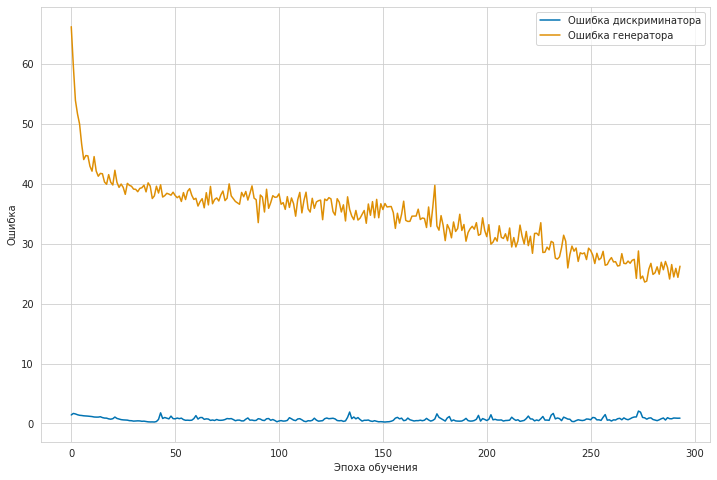

	...epoch 42/100	batch 0/7	D loss: 1.234868	G loss: 24.415791
	...epoch 42/100	batch 1/7	D loss: 0.848530	G loss: 25.543730
	...epoch 42/100	batch 2/7	D loss: 0.681898	G loss: 23.896528
	...epoch 42/100	batch 3/7	D loss: 0.616919	G loss: 25.017305
	...epoch 42/100	batch 4/7	D loss: 0.743345	G loss: 24.460081
	...epoch 42/100	batch 5/7	D loss: 0.812505	G loss: 25.963543
	...epoch 42/100	batch 6/7	D loss: 1.568001	G loss: 23.321823


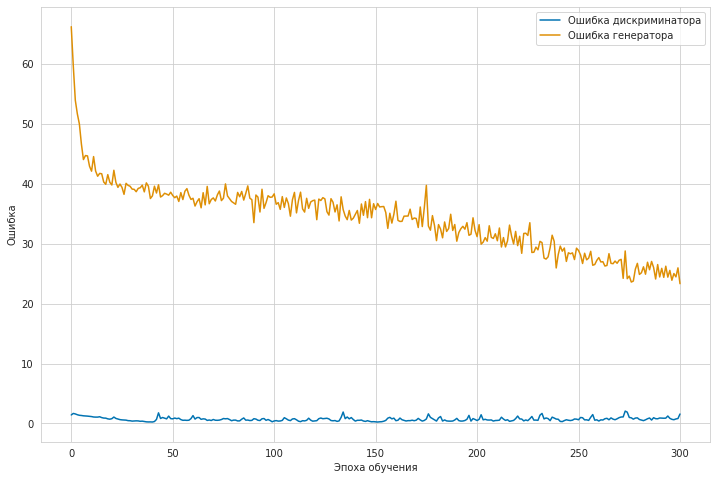

	...epoch 43/100	batch 0/7	D loss: 0.837658	G loss: 26.843407
	...epoch 43/100	batch 1/7	D loss: 0.565913	G loss: 25.447124
	...epoch 43/100	batch 2/7	D loss: 0.726132	G loss: 24.251961
	...epoch 43/100	batch 3/7	D loss: 0.827662	G loss: 24.172220
	...epoch 43/100	batch 4/7	D loss: 0.562829	G loss: 25.107040
	...epoch 43/100	batch 5/7	D loss: 1.168863	G loss: 23.141493
	...epoch 43/100	batch 6/7	D loss: 0.658562	G loss: 23.426096


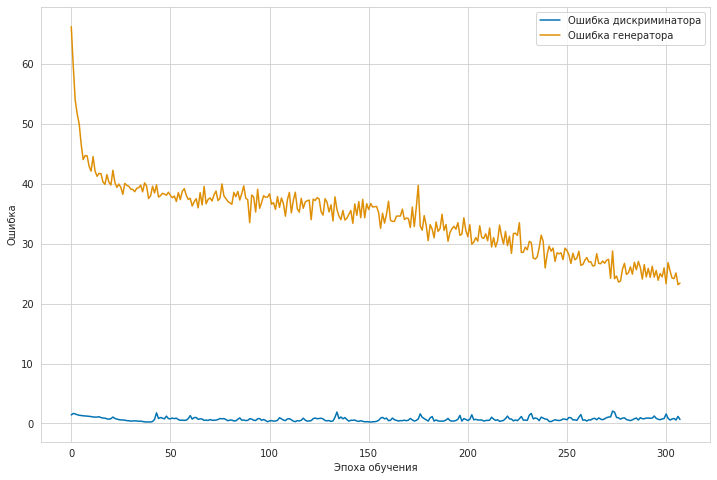

	...epoch 44/100	batch 0/7	D loss: 0.617110	G loss: 24.573309
	...epoch 44/100	batch 1/7	D loss: 0.889100	G loss: 23.546024
	...epoch 44/100	batch 2/7	D loss: 0.839438	G loss: 25.013866
	...epoch 44/100	batch 3/7	D loss: 1.159661	G loss: 22.813267
	...epoch 44/100	batch 4/7	D loss: 0.638039	G loss: 24.331528
	...epoch 44/100	batch 5/7	D loss: 0.621776	G loss: 23.936230
	...epoch 44/100	batch 6/7	D loss: 0.794300	G loss: 26.239159


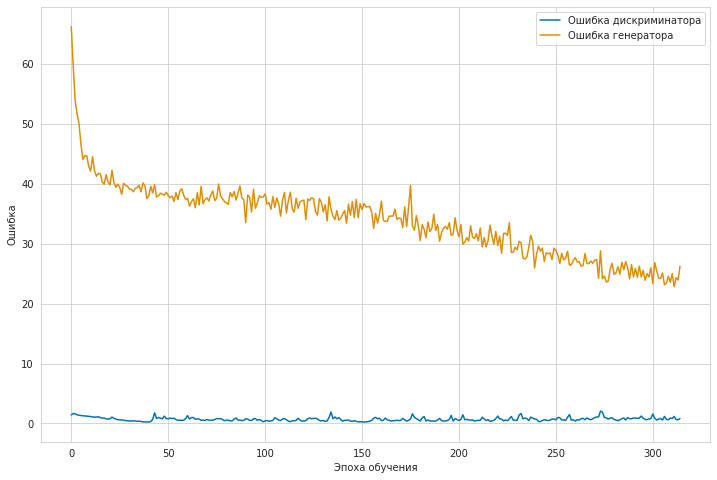

	...epoch 45/100	batch 0/7	D loss: 1.842210	G loss: 22.971537
	...epoch 45/100	batch 1/7	D loss: 0.681414	G loss: 23.348585
	...epoch 45/100	batch 2/7	D loss: 0.880301	G loss: 25.286652
	...epoch 45/100	batch 3/7	D loss: 1.097205	G loss: 22.651363
	...epoch 45/100	batch 4/7	D loss: 0.636088	G loss: 23.871998
	...epoch 45/100	batch 5/7	D loss: 0.911467	G loss: 22.716755
	...epoch 45/100	batch 6/7	D loss: 1.273452	G loss: 27.318930


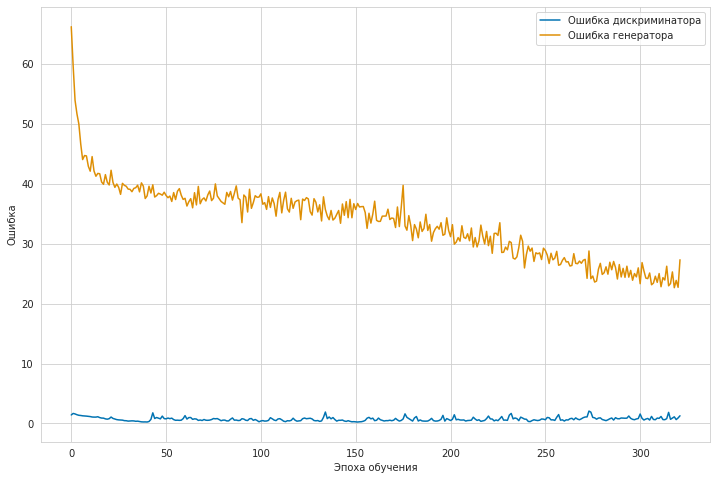

	...epoch 46/100	batch 0/7	D loss: 1.831706	G loss: 26.215986
	...epoch 46/100	batch 1/7	D loss: 0.750767	G loss: 24.120592
	...epoch 46/100	batch 2/7	D loss: 0.787360	G loss: 25.379673
	...epoch 46/100	batch 3/7	D loss: 0.662124	G loss: 23.780975
	...epoch 46/100	batch 4/7	D loss: 0.906507	G loss: 22.999680
	...epoch 46/100	batch 5/7	D loss: 0.812274	G loss: 22.606195
	...epoch 46/100	batch 6/7	D loss: 0.644003	G loss: 24.604807


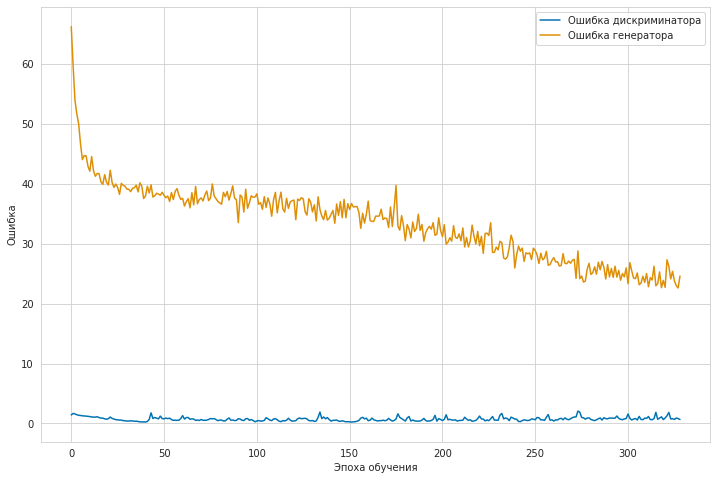

	...epoch 47/100	batch 0/7	D loss: 0.619412	G loss: 25.736866
	...epoch 47/100	batch 1/7	D loss: 0.881487	G loss: 24.865351
	...epoch 47/100	batch 2/7	D loss: 0.788350	G loss: 23.138186
	...epoch 47/100	batch 3/7	D loss: 0.758032	G loss: 22.170006
	...epoch 47/100	batch 4/7	D loss: 0.895724	G loss: 23.597813
	...epoch 47/100	batch 5/7	D loss: 0.965392	G loss: 22.678606
	...epoch 47/100	batch 6/7	D loss: 0.575427	G loss: 23.238125


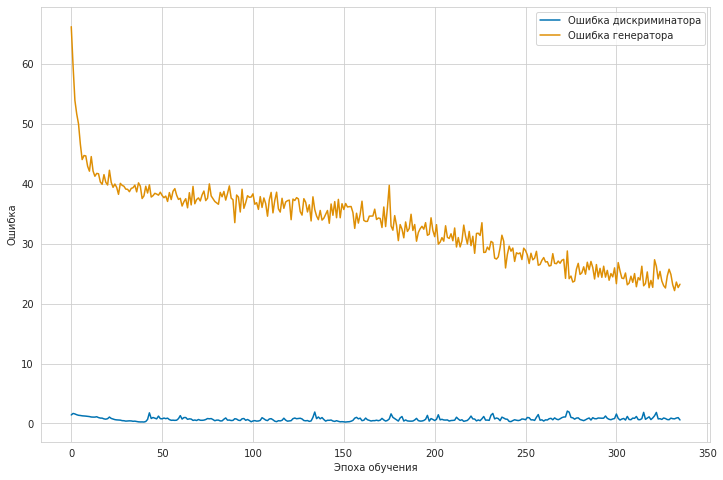

	...epoch 48/100	batch 0/7	D loss: 0.762162	G loss: 24.112614
	...epoch 48/100	batch 1/7	D loss: 0.977633	G loss: 23.546955
	...epoch 48/100	batch 2/7	D loss: 1.303493	G loss: 23.727283
	...epoch 48/100	batch 3/7	D loss: 0.863285	G loss: 22.259659
	...epoch 48/100	batch 4/7	D loss: 0.969553	G loss: 24.085434
	...epoch 48/100	batch 5/7	D loss: 1.034016	G loss: 22.194601
	...epoch 48/100	batch 6/7	D loss: 0.693756	G loss: 23.403660


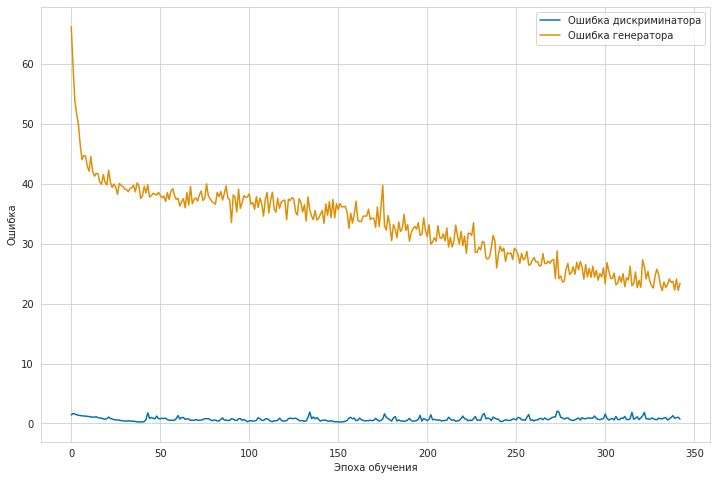

	...epoch 49/100	batch 0/7	D loss: 1.333379	G loss: 24.743275
	...epoch 49/100	batch 1/7	D loss: 1.915661	G loss: 21.521183
	...epoch 49/100	batch 2/7	D loss: 0.854372	G loss: 22.197046
	...epoch 49/100	batch 3/7	D loss: 0.932403	G loss: 22.350519
	...epoch 49/100	batch 4/7	D loss: 0.936105	G loss: 21.333866
	...epoch 49/100	batch 5/7	D loss: 1.037541	G loss: 21.895494
	...epoch 49/100	batch 6/7	D loss: 1.725965	G loss: 23.274250


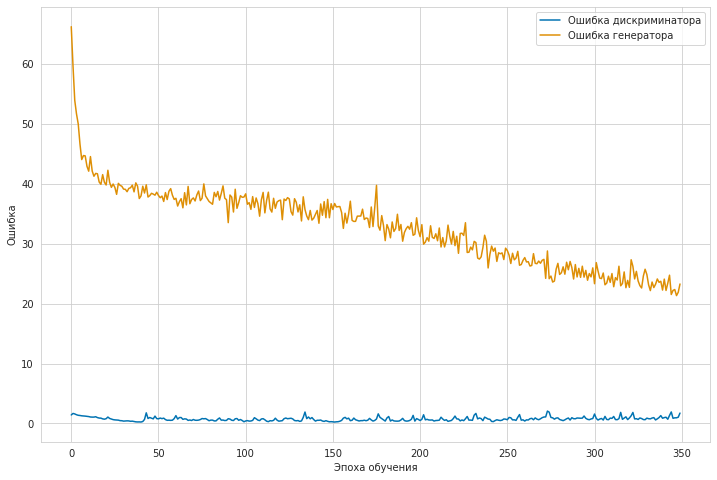

	...epoch 50/100	batch 0/7	D loss: 1.060146	G loss: 21.793236
	...epoch 50/100	batch 1/7	D loss: 1.892150	G loss: 24.791412
	...epoch 50/100	batch 2/7	D loss: 4.554284	G loss: 23.284756
	...epoch 50/100	batch 3/7	D loss: 3.403037	G loss: 21.952299
	...epoch 50/100	batch 4/7	D loss: 1.502341	G loss: 20.935469
	...epoch 50/100	batch 5/7	D loss: 0.853401	G loss: 20.019047
	...epoch 50/100	batch 6/7	D loss: 1.100452	G loss: 21.060337


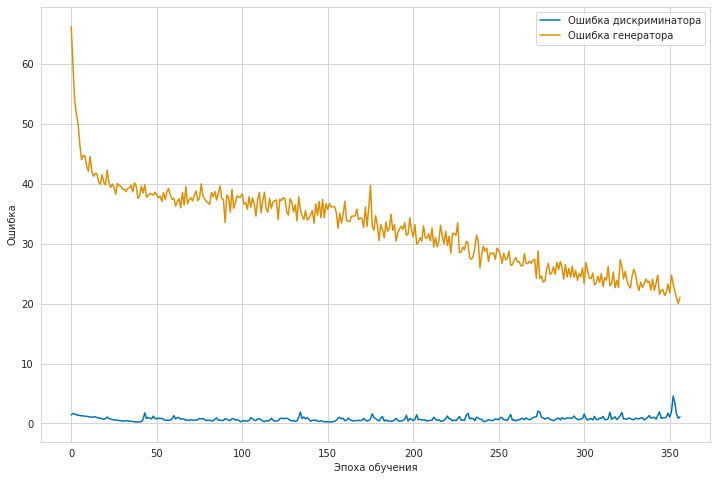

	...epoch 51/100	batch 0/7	D loss: 0.758947	G loss: 21.493284
	...epoch 51/100	batch 1/7	D loss: 0.763880	G loss: 20.646111
	...epoch 51/100	batch 2/7	D loss: 0.610603	G loss: 21.307119
	...epoch 51/100	batch 3/7	D loss: 0.889195	G loss: 22.210089
	...epoch 51/100	batch 4/7	D loss: 0.791014	G loss: 20.864470
	...epoch 51/100	batch 5/7	D loss: 0.785177	G loss: 22.035566
	...epoch 51/100	batch 6/7	D loss: 1.110799	G loss: 20.761597


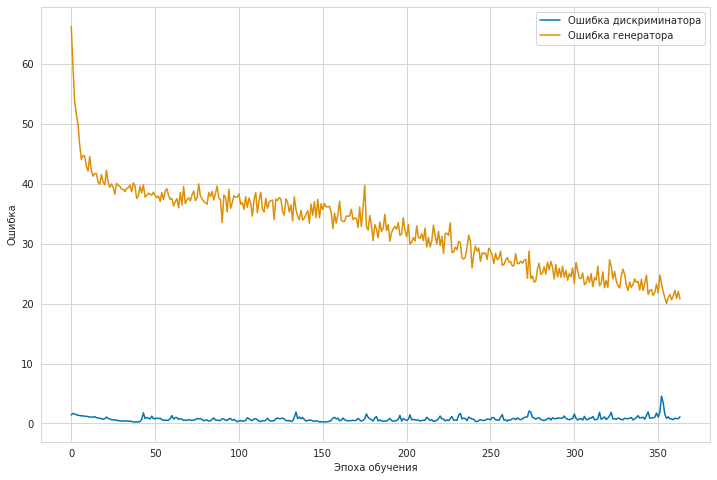

	...epoch 52/100	batch 0/7	D loss: 0.870844	G loss: 21.934370
	...epoch 52/100	batch 1/7	D loss: 0.748474	G loss: 21.665712
	...epoch 52/100	batch 2/7	D loss: 1.146641	G loss: 21.329983
	...epoch 52/100	batch 3/7	D loss: 0.781422	G loss: 20.669886
	...epoch 52/100	batch 4/7	D loss: 0.784449	G loss: 21.746082
	...epoch 52/100	batch 5/7	D loss: 0.995659	G loss: 20.028111
	...epoch 52/100	batch 6/7	D loss: 1.055913	G loss: 21.497778


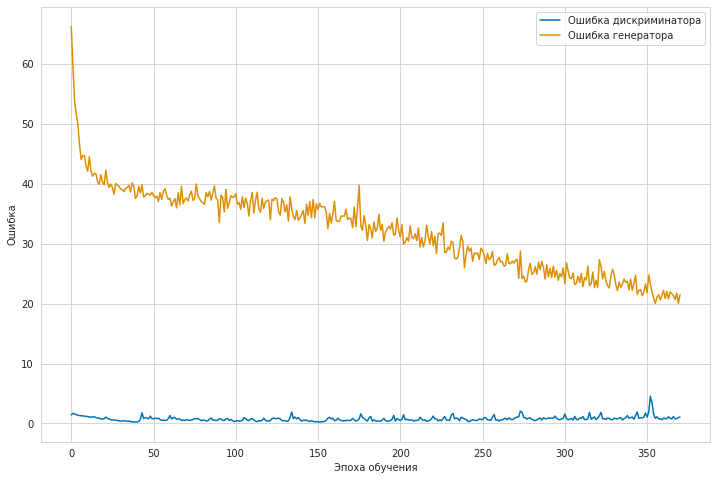

	...epoch 53/100	batch 0/7	D loss: 1.289646	G loss: 22.247366
	...epoch 53/100	batch 1/7	D loss: 1.331019	G loss: 21.214428
	...epoch 53/100	batch 2/7	D loss: 0.580032	G loss: 21.004282
	...epoch 53/100	batch 3/7	D loss: 1.207229	G loss: 21.660793
	...epoch 53/100	batch 4/7	D loss: 1.279496	G loss: 21.764969
	...epoch 53/100	batch 5/7	D loss: 0.815724	G loss: 20.716351
	...epoch 53/100	batch 6/7	D loss: 1.014962	G loss: 23.204569


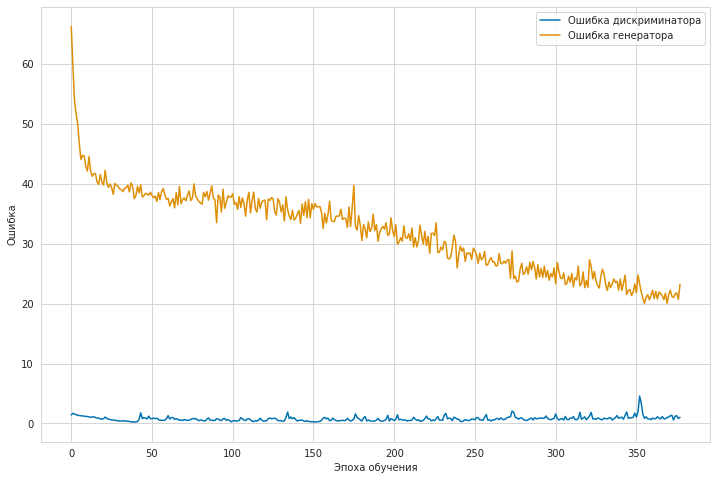

	...epoch 54/100	batch 0/7	D loss: 1.053889	G loss: 21.503740
	...epoch 54/100	batch 1/7	D loss: 1.113052	G loss: 20.321163
	...epoch 54/100	batch 2/7	D loss: 0.679525	G loss: 22.265657
	...epoch 54/100	batch 3/7	D loss: 0.724524	G loss: 20.906313
	...epoch 54/100	batch 4/7	D loss: 0.854460	G loss: 21.931190
	...epoch 54/100	batch 5/7	D loss: 0.952463	G loss: 20.432293
	...epoch 54/100	batch 6/7	D loss: 0.929835	G loss: 23.158331


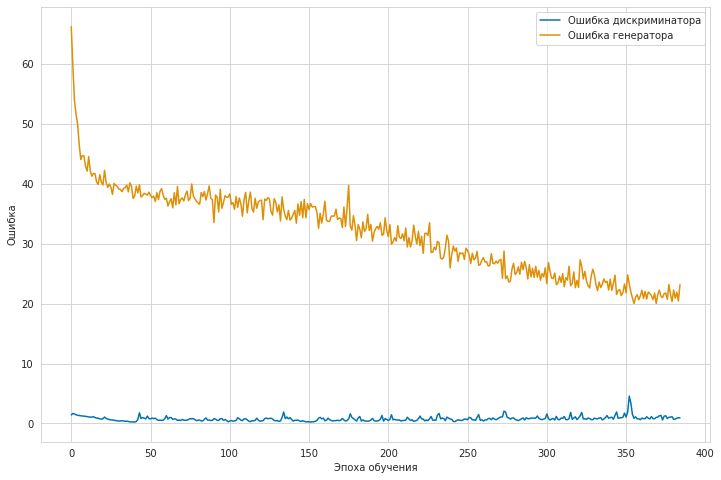

	...epoch 55/100	batch 0/7	D loss: 1.696589	G loss: 21.823107
	...epoch 55/100	batch 1/7	D loss: 0.847242	G loss: 20.310986
	...epoch 55/100	batch 2/7	D loss: 0.871106	G loss: 21.916525
	...epoch 55/100	batch 3/7	D loss: 1.069860	G loss: 19.167574
	...epoch 55/100	batch 4/7	D loss: 0.779005	G loss: 19.370943
	...epoch 55/100	batch 5/7	D loss: 1.116863	G loss: 21.835516
	...epoch 55/100	batch 6/7	D loss: 0.923541	G loss: 22.838110


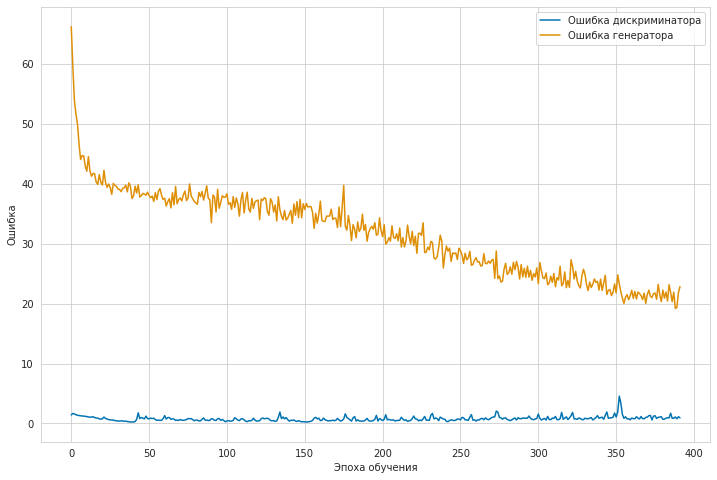

	...epoch 56/100	batch 0/7	D loss: 1.028599	G loss: 21.288675
	...epoch 56/100	batch 1/7	D loss: 0.889787	G loss: 19.873722
	...epoch 56/100	batch 2/7	D loss: 0.758590	G loss: 21.046341
	...epoch 56/100	batch 3/7	D loss: 0.675170	G loss: 20.962286
	...epoch 56/100	batch 4/7	D loss: 1.170280	G loss: 20.410215
	...epoch 56/100	batch 5/7	D loss: 0.773763	G loss: 20.346025
	...epoch 56/100	batch 6/7	D loss: 1.044024	G loss: 21.815510


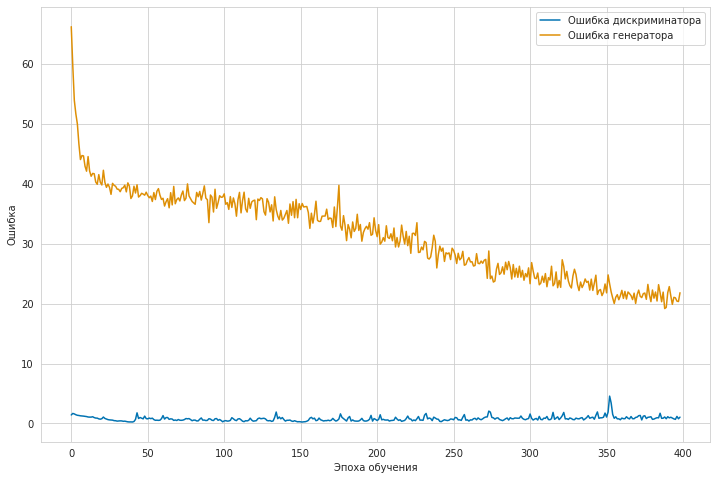

	...epoch 57/100	batch 0/7	D loss: 1.464786	G loss: 20.149431
	...epoch 57/100	batch 1/7	D loss: 0.828664	G loss: 19.633053
	...epoch 57/100	batch 2/7	D loss: 0.842198	G loss: 20.463537
	...epoch 57/100	batch 3/7	D loss: 0.959287	G loss: 20.302776
	...epoch 57/100	batch 4/7	D loss: 1.134735	G loss: 20.414503
	...epoch 57/100	batch 5/7	D loss: 0.718696	G loss: 19.480587
	...epoch 57/100	batch 6/7	D loss: 0.800163	G loss: 21.623190


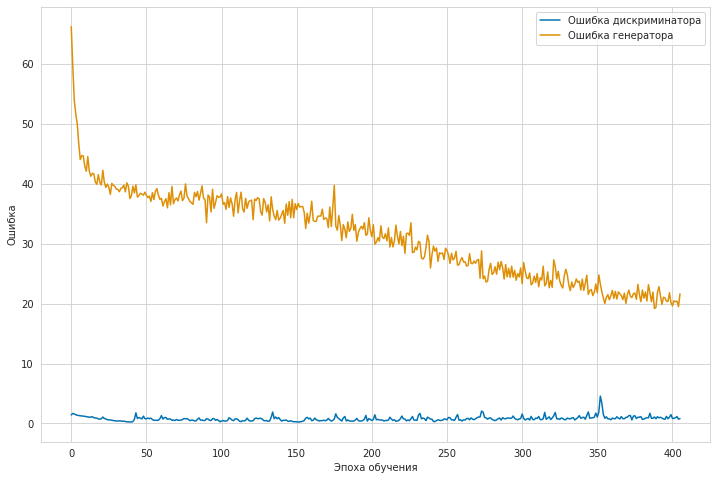

	...epoch 58/100	batch 0/7	D loss: 1.333795	G loss: 19.505671
	...epoch 58/100	batch 1/7	D loss: 0.899124	G loss: 20.338470
	...epoch 58/100	batch 2/7	D loss: 0.933178	G loss: 19.439741
	...epoch 58/100	batch 3/7	D loss: 0.920433	G loss: 21.384001
	...epoch 58/100	batch 4/7	D loss: 1.113387	G loss: 20.404003
	...epoch 58/100	batch 5/7	D loss: 0.815528	G loss: 20.016336
	...epoch 58/100	batch 6/7	D loss: 1.037357	G loss: 18.924009


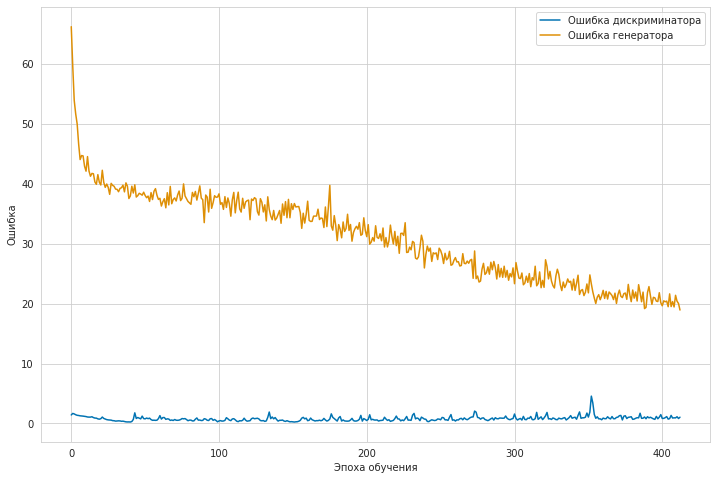

	...epoch 59/100	batch 0/7	D loss: 0.950359	G loss: 20.458790
	...epoch 59/100	batch 1/7	D loss: 1.088903	G loss: 21.714094
	...epoch 59/100	batch 2/7	D loss: 1.328061	G loss: 19.573769
	...epoch 59/100	batch 3/7	D loss: 0.944532	G loss: 21.463993
	...epoch 59/100	batch 4/7	D loss: 0.839289	G loss: 20.142473
	...epoch 59/100	batch 5/7	D loss: 0.833635	G loss: 20.981731
	...epoch 59/100	batch 6/7	D loss: 0.841981	G loss: 20.542723


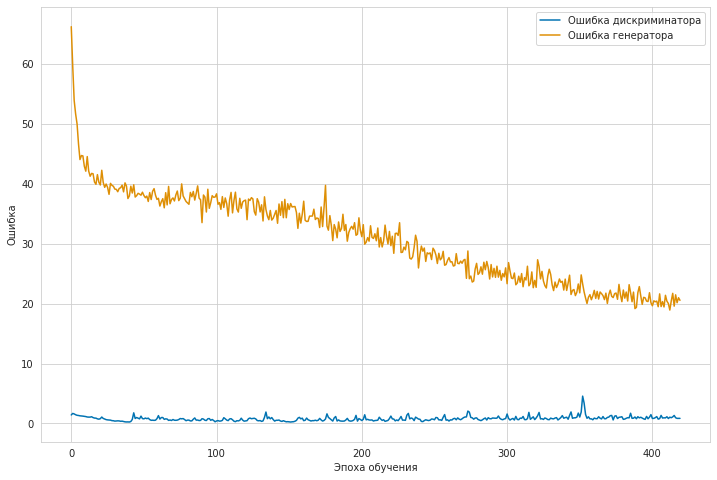

	...epoch 60/100	batch 0/7	D loss: 1.479705	G loss: 21.138710
	...epoch 60/100	batch 1/7	D loss: 1.577225	G loss: 19.442535
	...epoch 60/100	batch 2/7	D loss: 0.943067	G loss: 20.481129
	...epoch 60/100	batch 3/7	D loss: 0.845087	G loss: 19.215715
	...epoch 60/100	batch 4/7	D loss: 0.977507	G loss: 20.433483
	...epoch 60/100	batch 5/7	D loss: 1.219339	G loss: 19.251617
	...epoch 60/100	batch 6/7	D loss: 1.416713	G loss: 21.532251


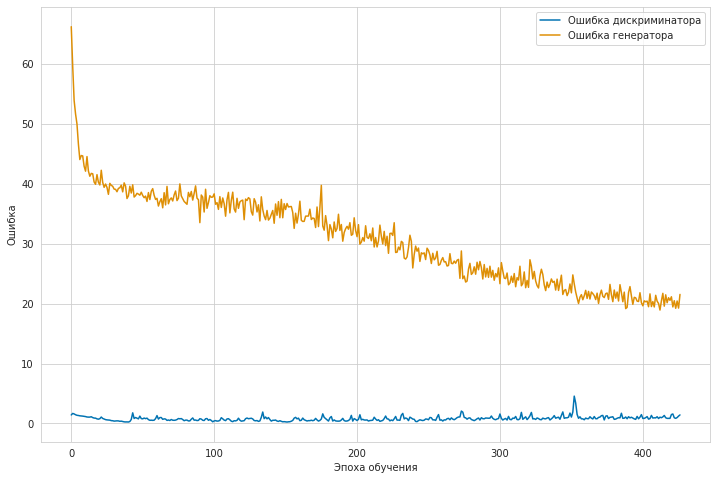

	...epoch 61/100	batch 0/7	D loss: 1.403470	G loss: 18.624138
	...epoch 61/100	batch 1/7	D loss: 0.819321	G loss: 19.365643
	...epoch 61/100	batch 2/7	D loss: 0.976250	G loss: 20.142977
	...epoch 61/100	batch 3/7	D loss: 0.947238	G loss: 19.911768
	...epoch 61/100	batch 4/7	D loss: 0.910710	G loss: 18.924915
	...epoch 61/100	batch 5/7	D loss: 0.888867	G loss: 20.885599
	...epoch 61/100	batch 6/7	D loss: 1.472073	G loss: 21.298376


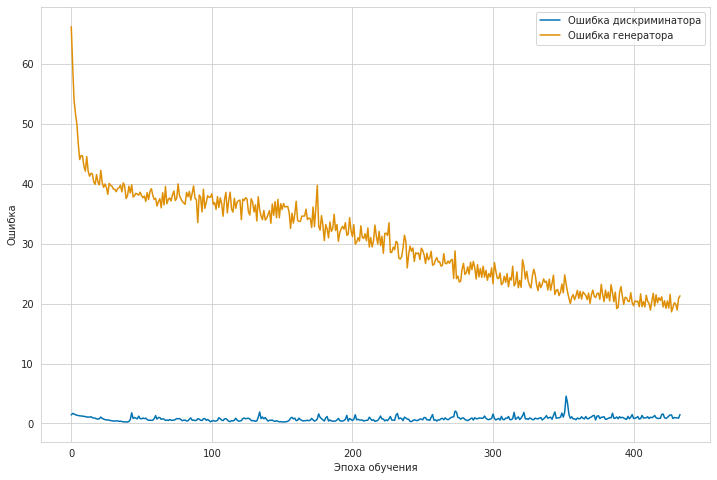

	...epoch 62/100	batch 0/7	D loss: 0.769671	G loss: 20.391838
	...epoch 62/100	batch 1/7	D loss: 1.048520	G loss: 21.280344
	...epoch 62/100	batch 2/7	D loss: 1.055500	G loss: 19.874208
	...epoch 62/100	batch 3/7	D loss: 0.762183	G loss: 18.968935
	...epoch 62/100	batch 4/7	D loss: 0.906534	G loss: 19.949022
	...epoch 62/100	batch 5/7	D loss: 0.875570	G loss: 19.609570
	...epoch 62/100	batch 6/7	D loss: 0.832593	G loss: 19.421106


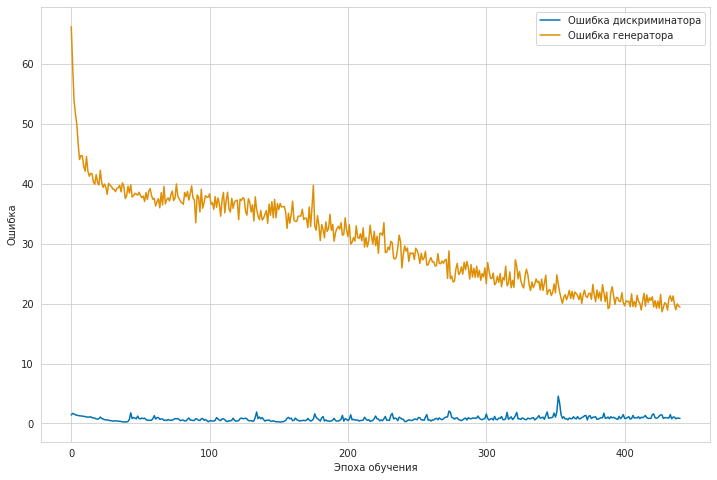

	...epoch 63/100	batch 0/7	D loss: 1.039141	G loss: 19.242643
	...epoch 63/100	batch 1/7	D loss: 0.820061	G loss: 19.388012
	...epoch 63/100	batch 2/7	D loss: 1.285892	G loss: 20.714170
	...epoch 63/100	batch 3/7	D loss: 1.400014	G loss: 20.063932
	...epoch 63/100	batch 4/7	D loss: 0.953735	G loss: 18.851839
	...epoch 63/100	batch 5/7	D loss: 0.922724	G loss: 20.246506
	...epoch 63/100	batch 6/7	D loss: 1.455819	G loss: 18.437792


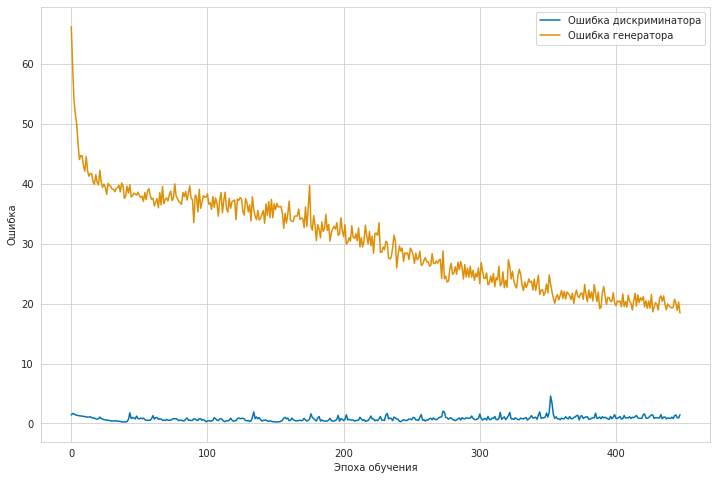

	...epoch 64/100	batch 0/7	D loss: 0.673315	G loss: 19.692001
	...epoch 64/100	batch 1/7	D loss: 1.000955	G loss: 19.907009
	...epoch 64/100	batch 2/7	D loss: 0.844299	G loss: 19.206299
	...epoch 64/100	batch 3/7	D loss: 0.812632	G loss: 19.061295
	...epoch 64/100	batch 4/7	D loss: 0.790976	G loss: 19.103668
	...epoch 64/100	batch 5/7	D loss: 0.700045	G loss: 19.489189
	...epoch 64/100	batch 6/7	D loss: 1.427956	G loss: 23.085871


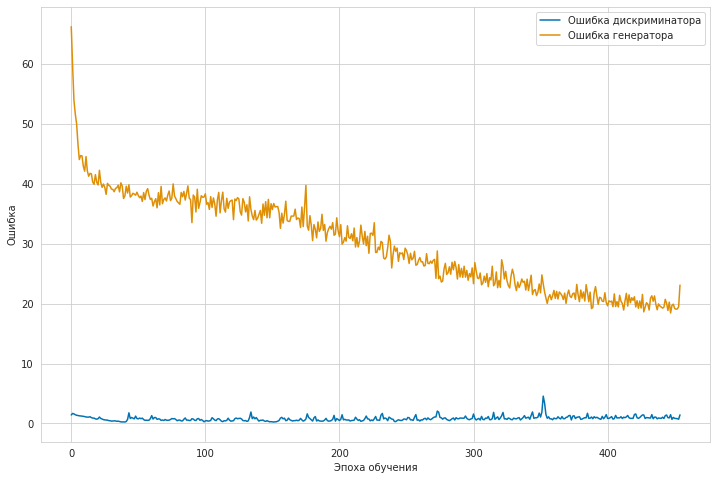

	...epoch 65/100	batch 0/7	D loss: 1.552699	G loss: 20.113537
	...epoch 65/100	batch 1/7	D loss: 0.818853	G loss: 19.524927
	...epoch 65/100	batch 2/7	D loss: 0.970628	G loss: 19.494375
	...epoch 65/100	batch 3/7	D loss: 1.019876	G loss: 19.880581
	...epoch 65/100	batch 4/7	D loss: 1.074124	G loss: 19.002468
	...epoch 65/100	batch 5/7	D loss: 0.882943	G loss: 18.953051
	...epoch 65/100	batch 6/7	D loss: 0.740681	G loss: 20.197115


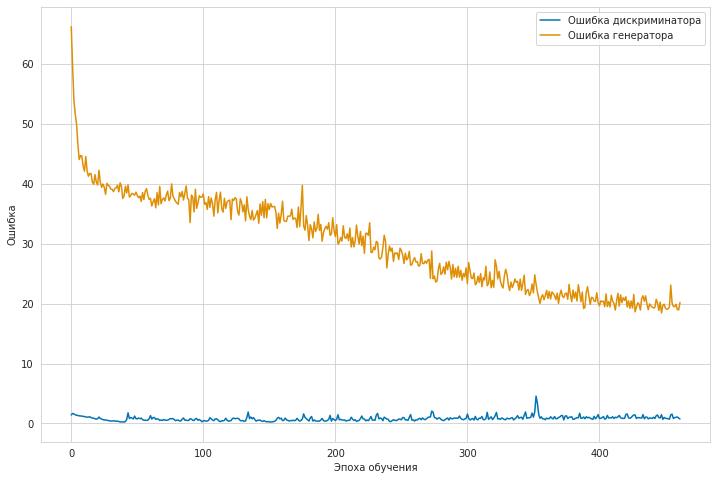

	...epoch 66/100	batch 0/7	D loss: 1.093037	G loss: 19.101799
	...epoch 66/100	batch 1/7	D loss: 1.126197	G loss: 19.609161
	...epoch 66/100	batch 2/7	D loss: 0.817260	G loss: 18.847727
	...epoch 66/100	batch 3/7	D loss: 0.741085	G loss: 19.008535
	...epoch 66/100	batch 4/7	D loss: 1.102144	G loss: 18.703991
	...epoch 66/100	batch 5/7	D loss: 0.956926	G loss: 18.339991
	...epoch 66/100	batch 6/7	D loss: 0.852601	G loss: 20.664301


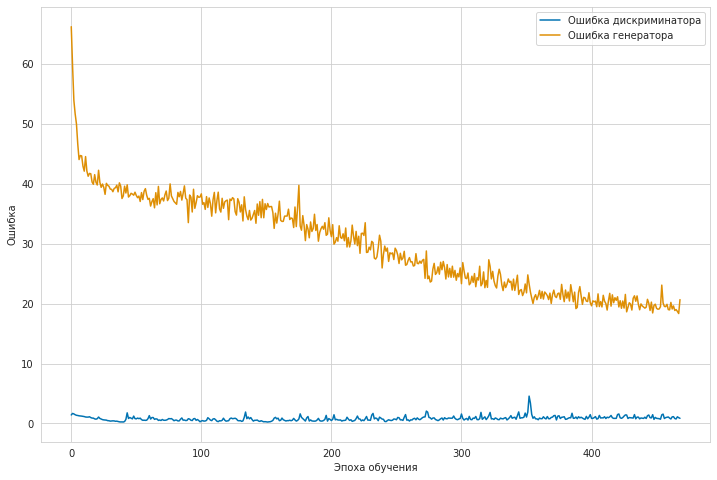

	...epoch 67/100	batch 0/7	D loss: 1.024744	G loss: 20.507298
	...epoch 67/100	batch 1/7	D loss: 0.945648	G loss: 18.421015
	...epoch 67/100	batch 2/7	D loss: 0.953633	G loss: 19.717533
	...epoch 67/100	batch 3/7	D loss: 1.022726	G loss: 19.133474
	...epoch 67/100	batch 4/7	D loss: 1.036471	G loss: 20.196680
	...epoch 67/100	batch 5/7	D loss: 0.875746	G loss: 18.472057
	...epoch 67/100	batch 6/7	D loss: 1.600346	G loss: 22.201954


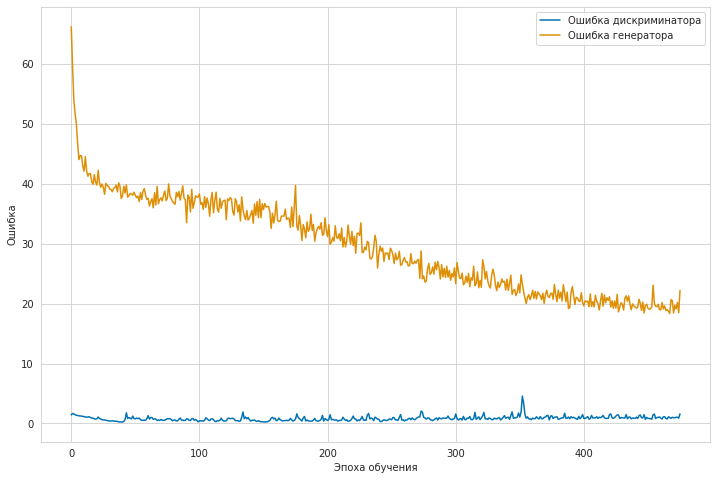

	...epoch 68/100	batch 0/7	D loss: 1.425917	G loss: 20.345926
	...epoch 68/100	batch 1/7	D loss: 0.864803	G loss: 18.375866
	...epoch 68/100	batch 2/7	D loss: 1.112064	G loss: 20.224682
	...epoch 68/100	batch 3/7	D loss: 1.503587	G loss: 18.121063
	...epoch 68/100	batch 4/7	D loss: 0.844999	G loss: 18.951895
	...epoch 68/100	batch 5/7	D loss: 0.854338	G loss: 17.953117
	...epoch 68/100	batch 6/7	D loss: 1.135110	G loss: 19.454760


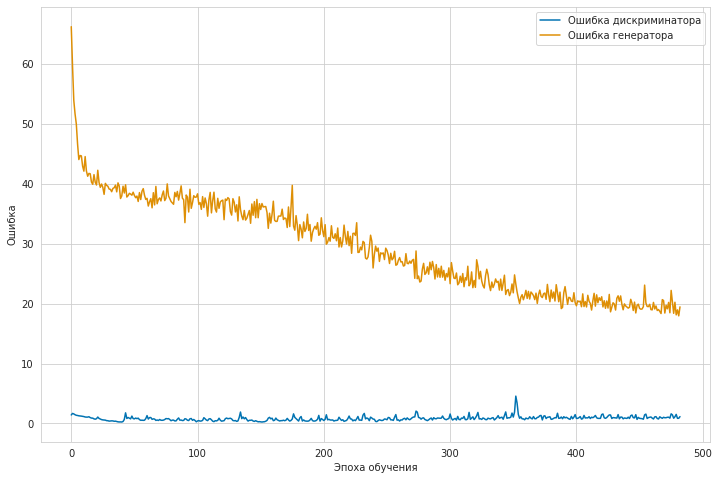

	...epoch 69/100	batch 0/7	D loss: 0.890183	G loss: 18.827208
	...epoch 69/100	batch 1/7	D loss: 0.864968	G loss: 19.066959
	...epoch 69/100	batch 2/7	D loss: 0.864191	G loss: 19.150520
	...epoch 69/100	batch 3/7	D loss: 1.162086	G loss: 19.131403
	...epoch 69/100	batch 4/7	D loss: 0.841625	G loss: 19.703777
	...epoch 69/100	batch 5/7	D loss: 0.934163	G loss: 18.249163
	...epoch 69/100	batch 6/7	D loss: 0.855630	G loss: 18.035196


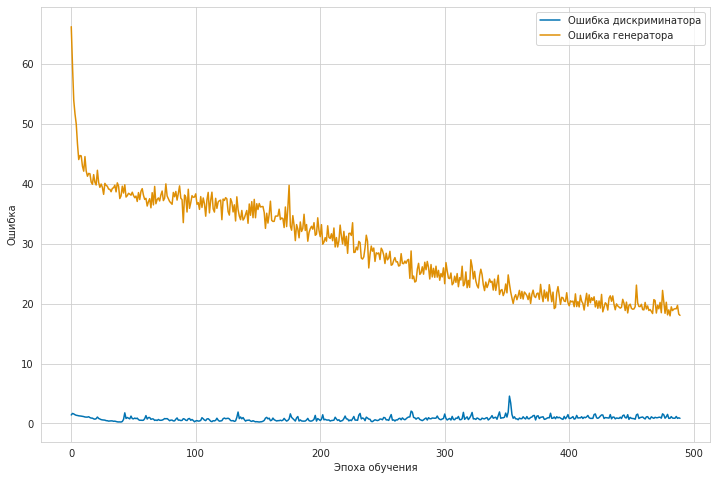

	...epoch 70/100	batch 0/7	D loss: 0.847261	G loss: 20.214544
	...epoch 70/100	batch 1/7	D loss: 1.279106	G loss: 17.502932
	...epoch 70/100	batch 2/7	D loss: 0.957313	G loss: 19.241652
	...epoch 70/100	batch 3/7	D loss: 0.886360	G loss: 17.312399
	...epoch 70/100	batch 4/7	D loss: 1.054509	G loss: 18.879555
	...epoch 70/100	batch 5/7	D loss: 0.948453	G loss: 18.598953
	...epoch 70/100	batch 6/7	D loss: 1.034805	G loss: 17.949678


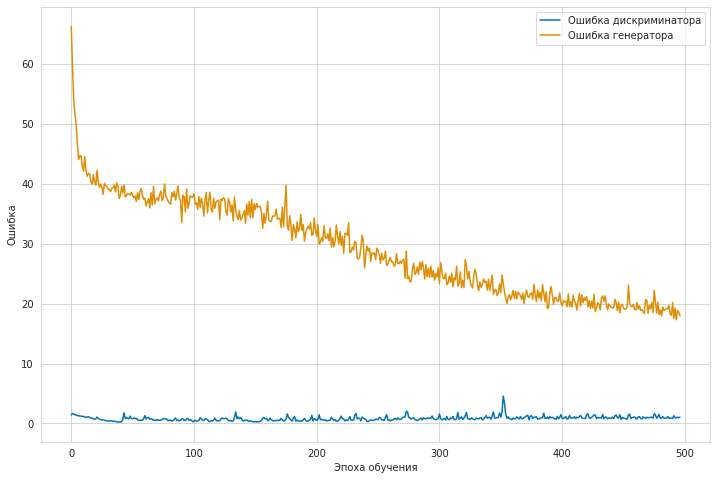

	...epoch 71/100	batch 0/7	D loss: 1.101493	G loss: 19.935108
	...epoch 71/100	batch 1/7	D loss: 1.165308	G loss: 17.824343
	...epoch 71/100	batch 2/7	D loss: 0.777878	G loss: 18.155769
	...epoch 71/100	batch 3/7	D loss: 1.010772	G loss: 18.274202
	...epoch 71/100	batch 4/7	D loss: 0.854350	G loss: 18.376360
	...epoch 71/100	batch 5/7	D loss: 0.974755	G loss: 18.391863
	...epoch 71/100	batch 6/7	D loss: 0.811558	G loss: 19.082870


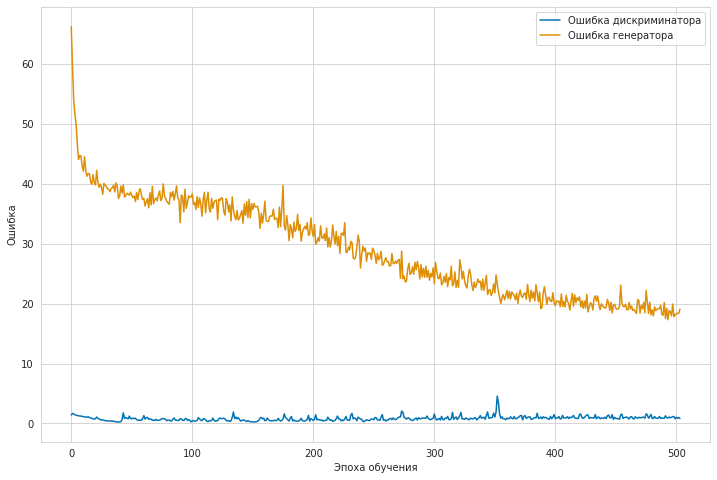

	...epoch 72/100	batch 0/7	D loss: 1.006015	G loss: 18.867188
	...epoch 72/100	batch 1/7	D loss: 1.323595	G loss: 19.247944
	...epoch 72/100	batch 2/7	D loss: 1.085142	G loss: 19.391073
	...epoch 72/100	batch 3/7	D loss: 1.321171	G loss: 17.759874
	...epoch 72/100	batch 4/7	D loss: 1.462533	G loss: 20.083971
	...epoch 72/100	batch 5/7	D loss: 1.614351	G loss: 17.469090
	...epoch 72/100	batch 6/7	D loss: 1.071003	G loss: 17.350391


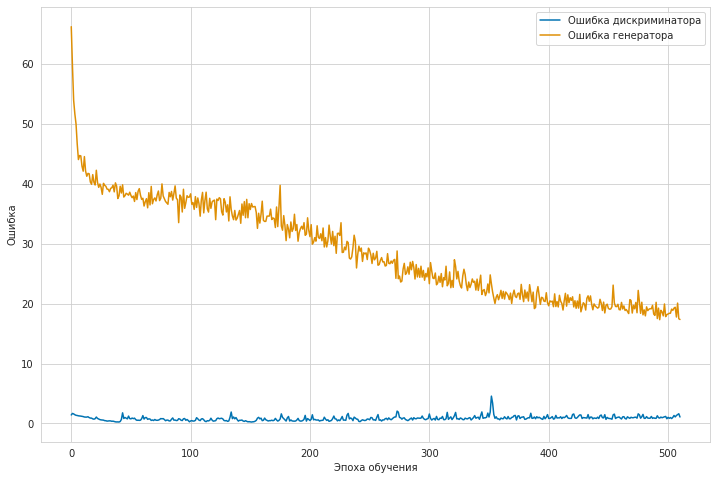

	...epoch 73/100	batch 0/7	D loss: 1.099330	G loss: 18.078495
	...epoch 73/100	batch 1/7	D loss: 1.161201	G loss: 17.689903
	...epoch 73/100	batch 2/7	D loss: 0.785479	G loss: 17.640617
	...epoch 73/100	batch 3/7	D loss: 1.022641	G loss: 17.782295
	...epoch 73/100	batch 4/7	D loss: 1.028825	G loss: 19.116482
	...epoch 73/100	batch 5/7	D loss: 1.084929	G loss: 18.117861
	...epoch 73/100	batch 6/7	D loss: 0.714572	G loss: 18.461102


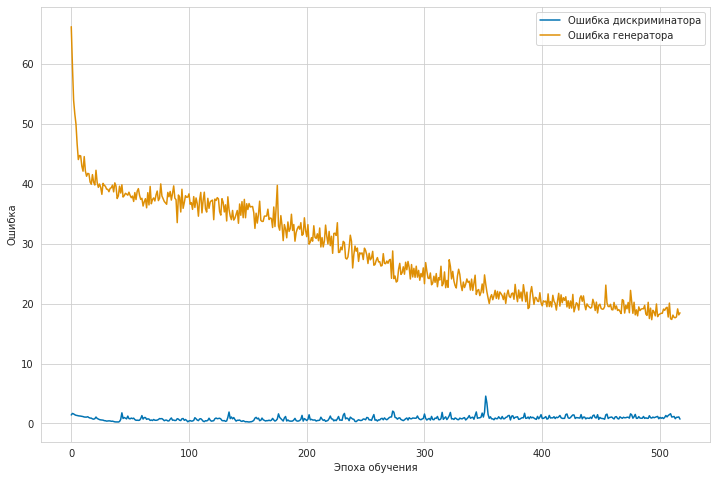

	...epoch 74/100	batch 0/7	D loss: 0.911471	G loss: 18.018557
	...epoch 74/100	batch 1/7	D loss: 1.162510	G loss: 17.142258
	...epoch 74/100	batch 2/7	D loss: 1.166046	G loss: 19.604425
	...epoch 74/100	batch 3/7	D loss: 1.356624	G loss: 18.558117
	...epoch 74/100	batch 4/7	D loss: 0.895914	G loss: 17.515795
	...epoch 74/100	batch 5/7	D loss: 0.970054	G loss: 18.342018
	...epoch 74/100	batch 6/7	D loss: 0.876709	G loss: 17.953421


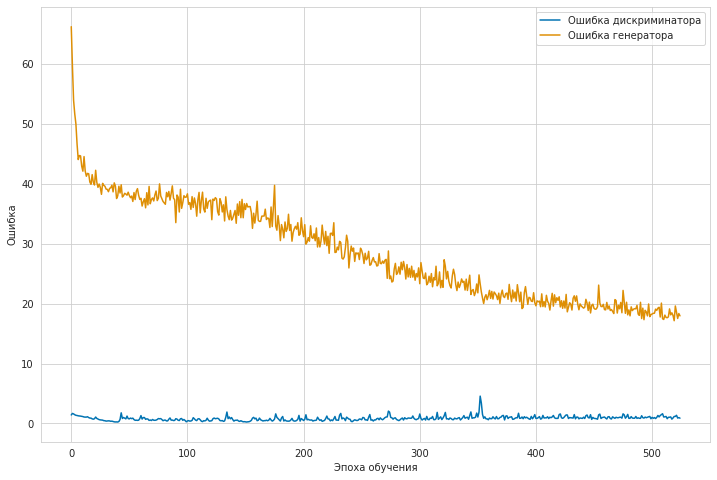

	...epoch 75/100	batch 0/7	D loss: 0.858396	G loss: 18.051155
	...epoch 75/100	batch 1/7	D loss: 0.885869	G loss: 19.615427
	...epoch 75/100	batch 2/7	D loss: 1.266524	G loss: 17.372849
	...epoch 75/100	batch 3/7	D loss: 0.849330	G loss: 17.897856
	...epoch 75/100	batch 4/7	D loss: 1.024818	G loss: 18.332607
	...epoch 75/100	batch 5/7	D loss: 1.220401	G loss: 17.275702
	...epoch 75/100	batch 6/7	D loss: 0.836764	G loss: 17.950710


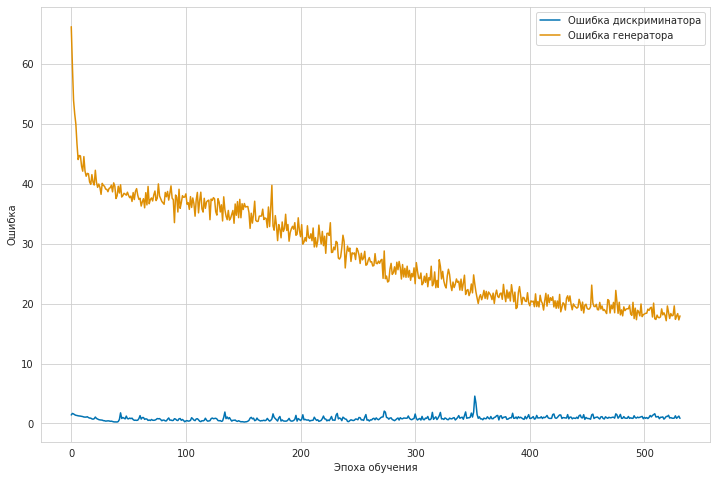

	...epoch 76/100	batch 0/7	D loss: 0.906269	G loss: 17.814198
	...epoch 76/100	batch 1/7	D loss: 0.751876	G loss: 17.954803
	...epoch 76/100	batch 2/7	D loss: 0.935142	G loss: 18.291494
	...epoch 76/100	batch 3/7	D loss: 1.424946	G loss: 17.959312
	...epoch 76/100	batch 4/7	D loss: 0.752386	G loss: 17.329626
	...epoch 76/100	batch 5/7	D loss: 0.973891	G loss: 18.115221
	...epoch 76/100	batch 6/7	D loss: 0.992797	G loss: 20.474350


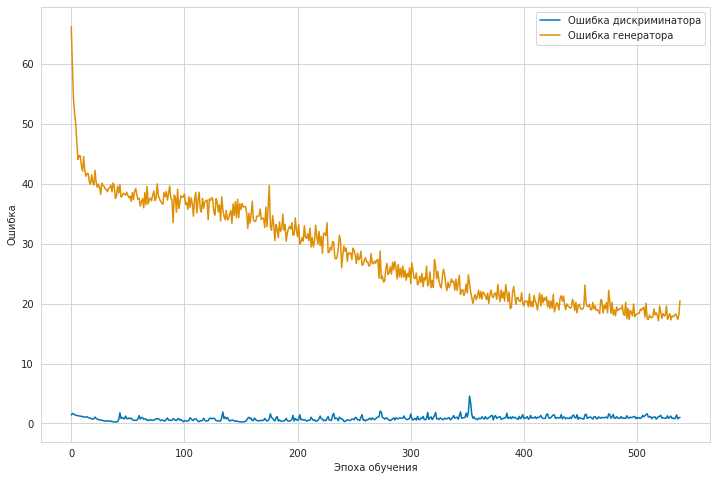

	...epoch 77/100	batch 0/7	D loss: 1.102663	G loss: 17.164690
	...epoch 77/100	batch 1/7	D loss: 1.185936	G loss: 18.553120
	...epoch 77/100	batch 2/7	D loss: 1.116413	G loss: 17.292112
	...epoch 77/100	batch 3/7	D loss: 0.744120	G loss: 17.603968
	...epoch 77/100	batch 4/7	D loss: 0.890099	G loss: 17.306301
	...epoch 77/100	batch 5/7	D loss: 0.940168	G loss: 17.721645
	...epoch 77/100	batch 6/7	D loss: 0.987156	G loss: 17.375467


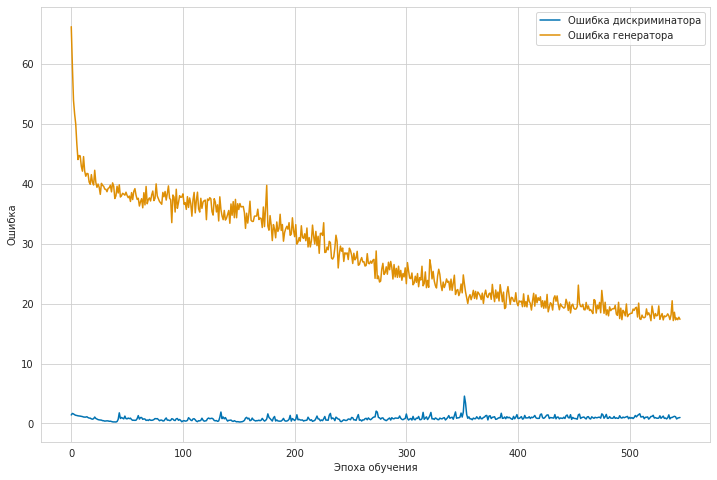

	...epoch 78/100	batch 0/7	D loss: 1.023787	G loss: 17.990009
	...epoch 78/100	batch 1/7	D loss: 0.970218	G loss: 19.177860
	...epoch 78/100	batch 2/7	D loss: 1.032084	G loss: 18.029911
	...epoch 78/100	batch 3/7	D loss: 1.039219	G loss: 17.196163
	...epoch 78/100	batch 4/7	D loss: 0.926197	G loss: 18.263117
	...epoch 78/100	batch 5/7	D loss: 0.850251	G loss: 18.339540
	...epoch 78/100	batch 6/7	D loss: 0.802008	G loss: 16.771894


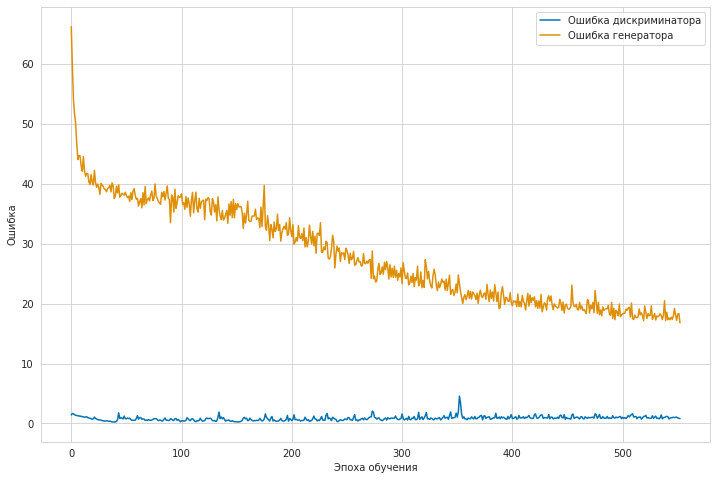

	...epoch 79/100	batch 0/7	D loss: 1.025270	G loss: 17.501274
	...epoch 79/100	batch 1/7	D loss: 1.004920	G loss: 17.916061
	...epoch 79/100	batch 2/7	D loss: 1.266905	G loss: 17.260754
	...epoch 79/100	batch 3/7	D loss: 1.181285	G loss: 17.290842
	...epoch 79/100	batch 4/7	D loss: 1.057132	G loss: 17.339903
	...epoch 79/100	batch 5/7	D loss: 0.930579	G loss: 19.457760
	...epoch 79/100	batch 6/7	D loss: 1.587081	G loss: 17.736622


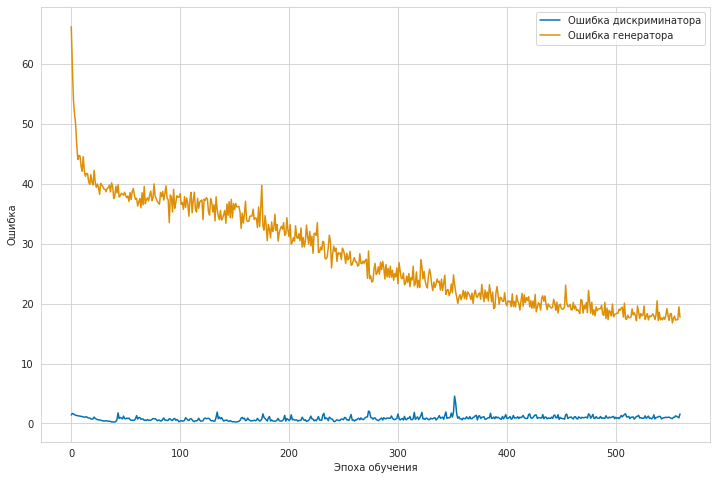

	...epoch 80/100	batch 0/7	D loss: 0.822077	G loss: 17.180660
	...epoch 80/100	batch 1/7	D loss: 0.854414	G loss: 18.962458
	...epoch 80/100	batch 2/7	D loss: 1.078339	G loss: 16.813181
	...epoch 80/100	batch 3/7	D loss: 0.829823	G loss: 17.643623
	...epoch 80/100	batch 4/7	D loss: 1.176654	G loss: 17.392918
	...epoch 80/100	batch 5/7	D loss: 0.854906	G loss: 16.904840
	...epoch 80/100	batch 6/7	D loss: 0.777807	G loss: 17.445969


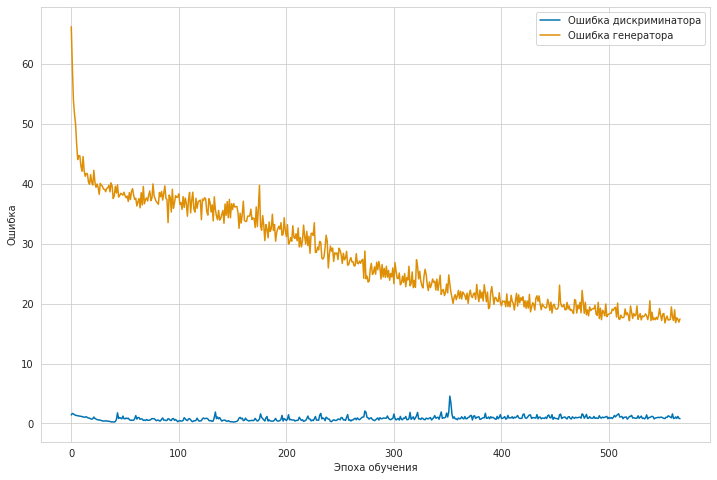

	...epoch 81/100	batch 0/7	D loss: 0.844604	G loss: 17.255573
	...epoch 81/100	batch 1/7	D loss: 0.959631	G loss: 19.168901
	...epoch 81/100	batch 2/7	D loss: 1.074141	G loss: 17.633776
	...epoch 81/100	batch 3/7	D loss: 0.956586	G loss: 16.661730
	...epoch 81/100	batch 4/7	D loss: 0.986483	G loss: 18.518826
	...epoch 81/100	batch 5/7	D loss: 1.150923	G loss: 17.171032
	...epoch 81/100	batch 6/7	D loss: 1.102618	G loss: 18.791874


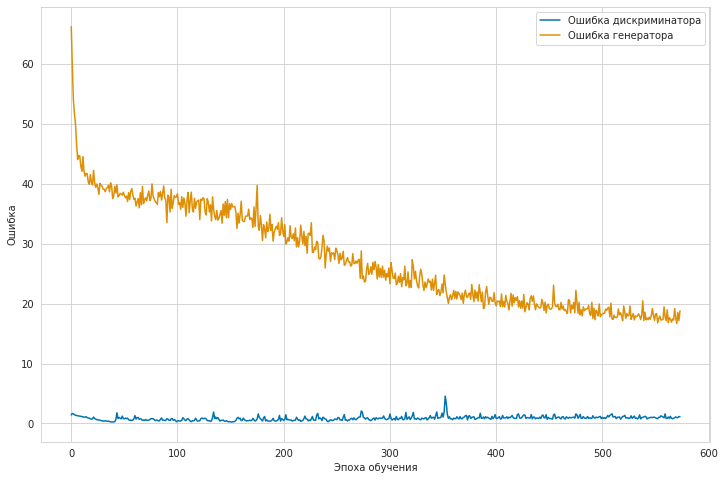

	...epoch 82/100	batch 0/7	D loss: 0.997782	G loss: 17.480381
	...epoch 82/100	batch 1/7	D loss: 0.795731	G loss: 16.993511
	...epoch 82/100	batch 2/7	D loss: 1.061711	G loss: 17.896904
	...epoch 82/100	batch 3/7	D loss: 0.979532	G loss: 18.060442
	...epoch 82/100	batch 4/7	D loss: 1.023314	G loss: 16.856968
	...epoch 82/100	batch 5/7	D loss: 1.054566	G loss: 18.073624
	...epoch 82/100	batch 6/7	D loss: 1.120740	G loss: 16.055017


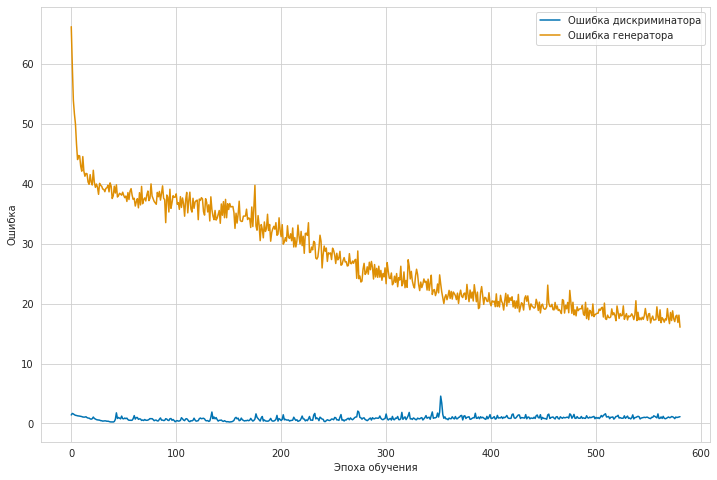

	...epoch 83/100	batch 0/7	D loss: 0.955929	G loss: 18.501989
	...epoch 83/100	batch 1/7	D loss: 0.848291	G loss: 17.233395
	...epoch 83/100	batch 2/7	D loss: 0.794978	G loss: 17.180531
	...epoch 83/100	batch 3/7	D loss: 1.017650	G loss: 17.897440
	...epoch 83/100	batch 4/7	D loss: 1.129628	G loss: 16.615761
	...epoch 83/100	batch 5/7	D loss: 1.076530	G loss: 18.006445
	...epoch 83/100	batch 6/7	D loss: 1.684367	G loss: 18.716558


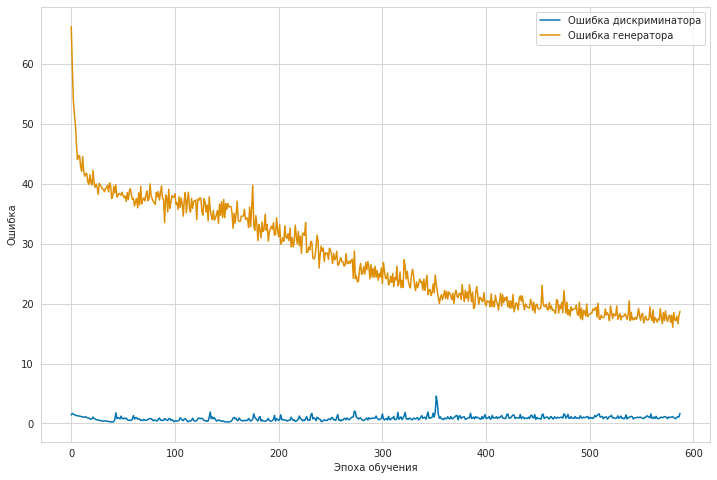

	...epoch 84/100	batch 0/7	D loss: 1.124718	G loss: 17.182564
	...epoch 84/100	batch 1/7	D loss: 1.236879	G loss: 18.764103
	...epoch 84/100	batch 2/7	D loss: 0.938306	G loss: 17.401472
	...epoch 84/100	batch 3/7	D loss: 0.966015	G loss: 17.154192
	...epoch 84/100	batch 4/7	D loss: 0.961484	G loss: 16.738945
	...epoch 84/100	batch 5/7	D loss: 0.902439	G loss: 16.444048
	...epoch 84/100	batch 6/7	D loss: 0.728318	G loss: 17.126877


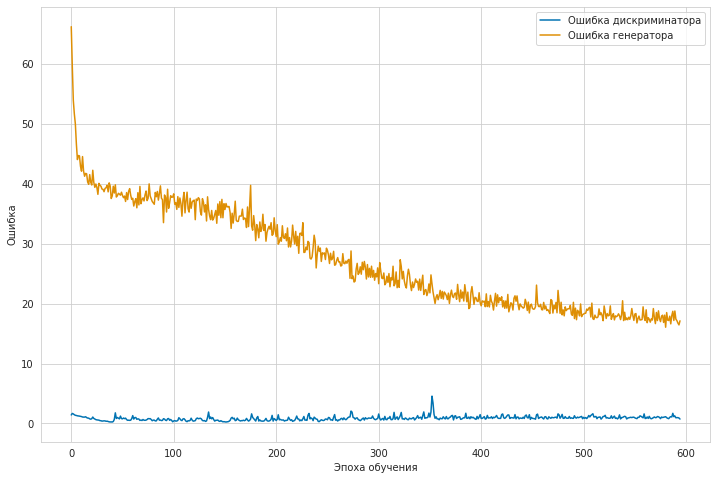

	...epoch 85/100	batch 0/7	D loss: 1.255554	G loss: 19.672607
	...epoch 85/100	batch 1/7	D loss: 1.498670	G loss: 17.566189
	...epoch 85/100	batch 2/7	D loss: 0.956475	G loss: 17.128155
	...epoch 85/100	batch 3/7	D loss: 0.960310	G loss: 17.703127
	...epoch 85/100	batch 4/7	D loss: 1.159802	G loss: 17.178183
	...epoch 85/100	batch 5/7	D loss: 0.892111	G loss: 16.513048
	...epoch 85/100	batch 6/7	D loss: 1.250716	G loss: 19.103191


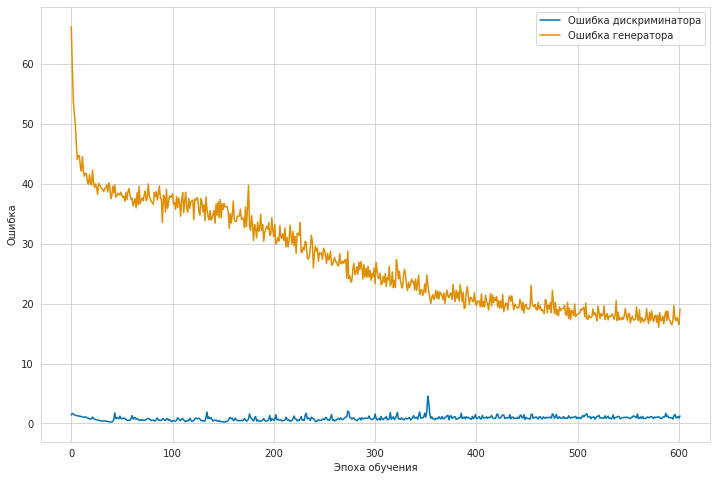

	...epoch 86/100	batch 0/7	D loss: 1.856402	G loss: 17.827049
	...epoch 86/100	batch 1/7	D loss: 1.095792	G loss: 15.837452
	...epoch 86/100	batch 2/7	D loss: 1.697120	G loss: 18.087238
	...epoch 86/100	batch 3/7	D loss: 0.949465	G loss: 17.296761
	...epoch 86/100	batch 4/7	D loss: 0.947604	G loss: 15.869860
	...epoch 86/100	batch 5/7	D loss: 0.895174	G loss: 17.418299
	...epoch 86/100	batch 6/7	D loss: 0.917434	G loss: 17.175133


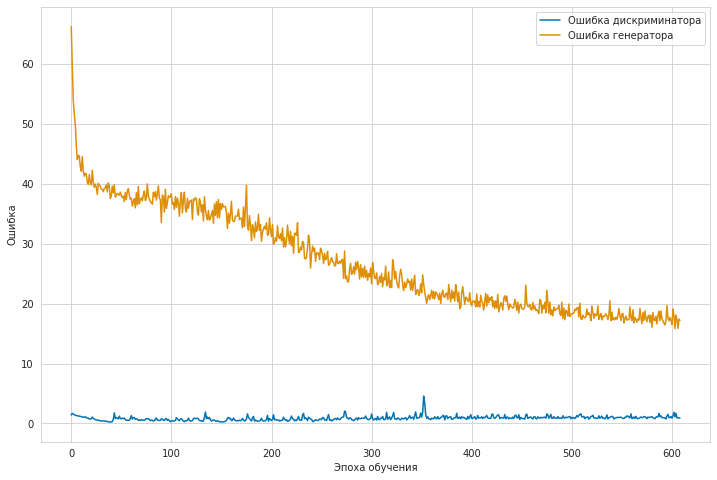

	...epoch 87/100	batch 0/7	D loss: 1.063813	G loss: 17.336908
	...epoch 87/100	batch 1/7	D loss: 0.767717	G loss: 16.792732
	...epoch 87/100	batch 2/7	D loss: 0.729529	G loss: 16.423706
	...epoch 87/100	batch 3/7	D loss: 0.838322	G loss: 16.510298
	...epoch 87/100	batch 4/7	D loss: 0.847978	G loss: 16.311676
	...epoch 87/100	batch 5/7	D loss: 1.114401	G loss: 17.781050
	...epoch 87/100	batch 6/7	D loss: 1.111105	G loss: 16.776842


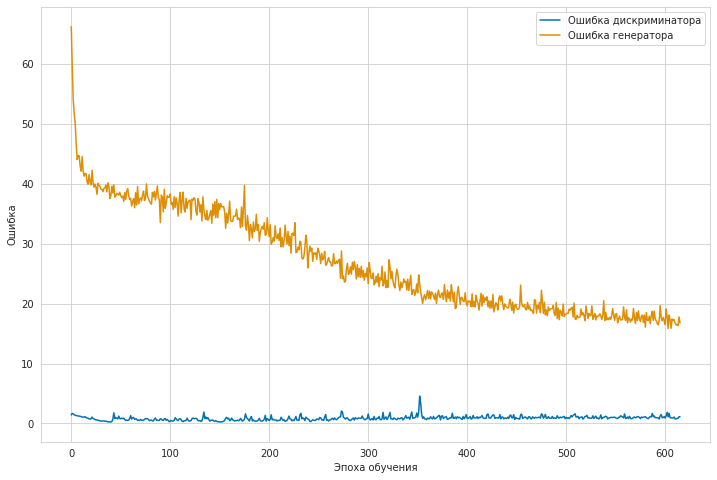

	...epoch 88/100	batch 0/7	D loss: 0.742758	G loss: 17.451717
	...epoch 88/100	batch 1/7	D loss: 0.950836	G loss: 18.751308
	...epoch 88/100	batch 2/7	D loss: 1.738077	G loss: 16.427839
	...epoch 88/100	batch 3/7	D loss: 0.870995	G loss: 16.020678
	...epoch 88/100	batch 4/7	D loss: 1.047808	G loss: 16.466145
	...epoch 88/100	batch 5/7	D loss: 1.040959	G loss: 16.073565
	...epoch 88/100	batch 6/7	D loss: 0.955601	G loss: 15.171926


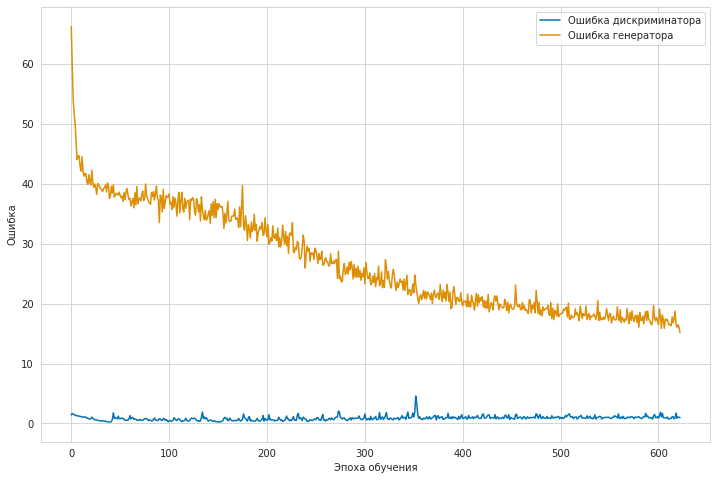

	...epoch 89/100	batch 0/7	D loss: 0.909769	G loss: 17.149130
	...epoch 89/100	batch 1/7	D loss: 1.044902	G loss: 16.110561
	...epoch 89/100	batch 2/7	D loss: 0.882310	G loss: 15.540108
	...epoch 89/100	batch 3/7	D loss: 0.941885	G loss: 16.782751
	...epoch 89/100	batch 4/7	D loss: 0.782709	G loss: 17.245674
	...epoch 89/100	batch 5/7	D loss: 1.305090	G loss: 16.334131
	...epoch 89/100	batch 6/7	D loss: 1.015076	G loss: 17.226843


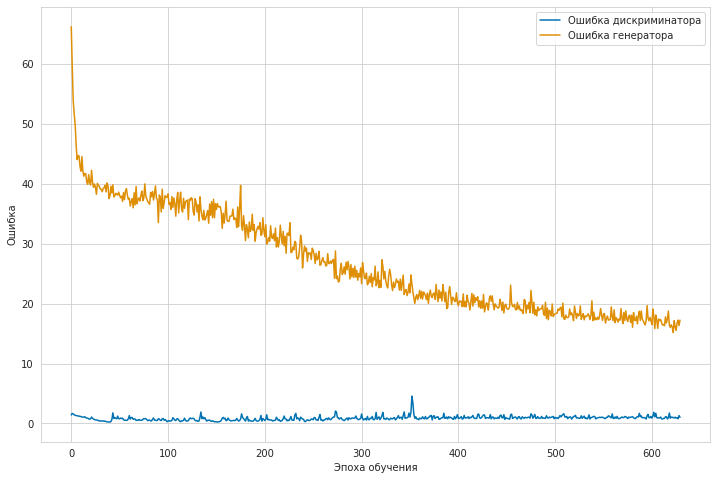

	...epoch 90/100	batch 0/7	D loss: 0.610568	G loss: 17.890749
	...epoch 90/100	batch 1/7	D loss: 0.884384	G loss: 16.420197
	...epoch 90/100	batch 2/7	D loss: 1.045403	G loss: 16.356550
	...epoch 90/100	batch 3/7	D loss: 0.862833	G loss: 15.734278
	...epoch 90/100	batch 4/7	D loss: 0.987450	G loss: 17.103415
	...epoch 90/100	batch 5/7	D loss: 1.080669	G loss: 16.729357
	...epoch 90/100	batch 6/7	D loss: 1.278666	G loss: 15.976233


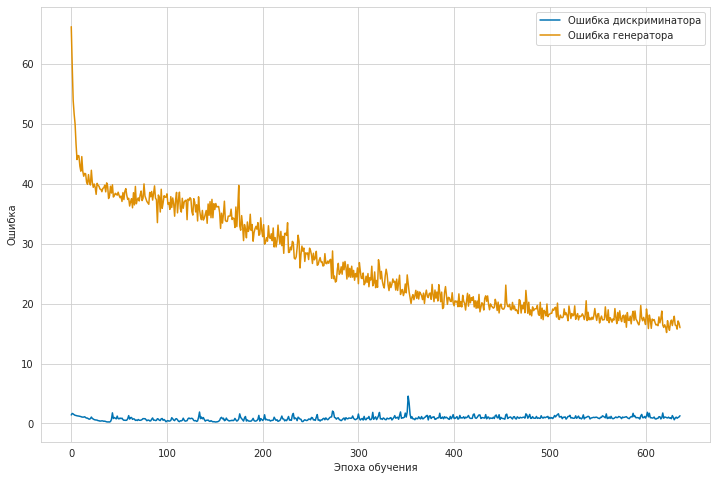

	...epoch 91/100	batch 0/7	D loss: 0.750451	G loss: 17.071424
	...epoch 91/100	batch 1/7	D loss: 0.955266	G loss: 15.880862
	...epoch 91/100	batch 2/7	D loss: 0.889483	G loss: 16.882162
	...epoch 91/100	batch 3/7	D loss: 0.963117	G loss: 15.885971
	...epoch 91/100	batch 4/7	D loss: 0.974463	G loss: 16.580084
	...epoch 91/100	batch 5/7	D loss: 1.105414	G loss: 16.130108
	...epoch 91/100	batch 6/7	D loss: 1.129044	G loss: 17.885950


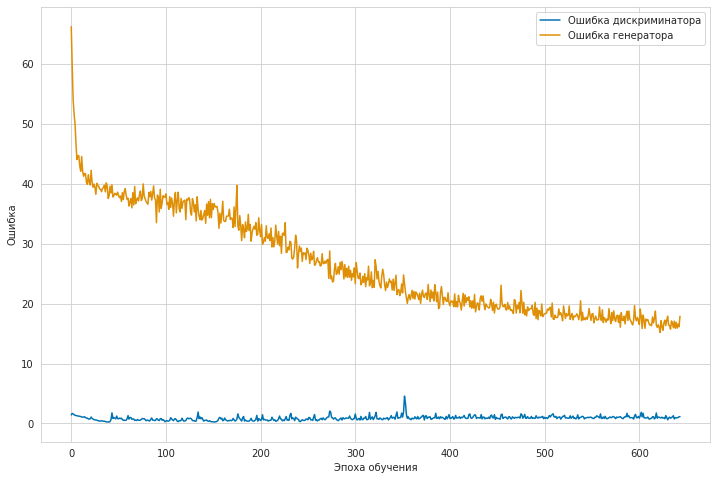

	...epoch 92/100	batch 0/7	D loss: 1.528364	G loss: 15.519213
	...epoch 92/100	batch 1/7	D loss: 0.925133	G loss: 16.724258
	...epoch 92/100	batch 2/7	D loss: 0.864632	G loss: 16.510422
	...epoch 92/100	batch 3/7	D loss: 1.018294	G loss: 16.188276
	...epoch 92/100	batch 4/7	D loss: 0.930022	G loss: 15.842211
	...epoch 92/100	batch 5/7	D loss: 0.869031	G loss: 17.887182
	...epoch 92/100	batch 6/7	D loss: 0.881334	G loss: 16.775602


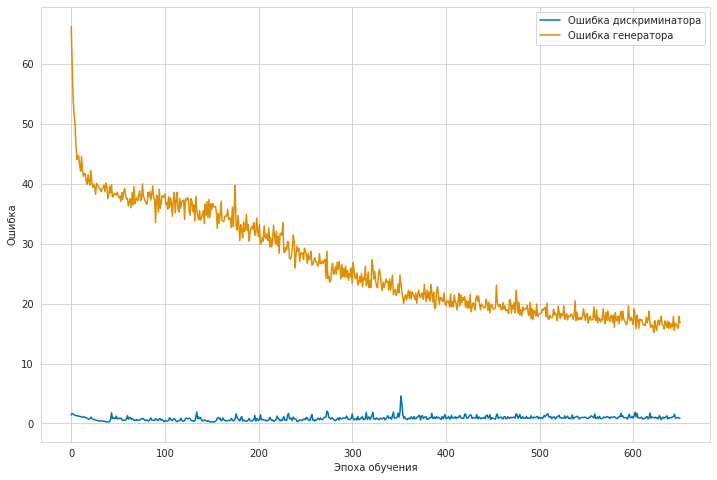

	...epoch 93/100	batch 0/7	D loss: 1.078762	G loss: 15.889717
	...epoch 93/100	batch 1/7	D loss: 1.008391	G loss: 17.099785
	...epoch 93/100	batch 2/7	D loss: 1.339761	G loss: 15.203522
	...epoch 93/100	batch 3/7	D loss: 0.905963	G loss: 16.625425
	...epoch 93/100	batch 4/7	D loss: 0.922111	G loss: 16.204573
	...epoch 93/100	batch 5/7	D loss: 0.951365	G loss: 16.282894
	...epoch 93/100	batch 6/7	D loss: 0.826791	G loss: 17.872231


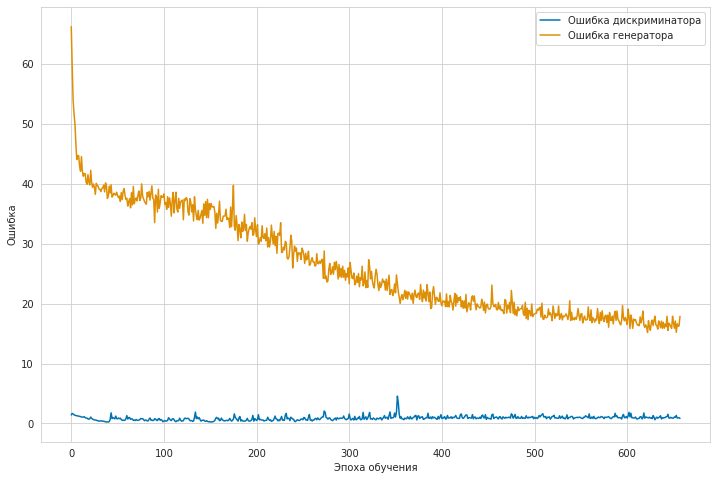

	...epoch 94/100	batch 0/7	D loss: 1.214235	G loss: 16.461199
	...epoch 94/100	batch 1/7	D loss: 0.867092	G loss: 15.366770
	...epoch 94/100	batch 2/7	D loss: 0.879409	G loss: 16.326044
	...epoch 94/100	batch 3/7	D loss: 0.888448	G loss: 15.742128
	...epoch 94/100	batch 4/7	D loss: 0.845450	G loss: 15.566548
	...epoch 94/100	batch 5/7	D loss: 1.075118	G loss: 16.356138
	...epoch 94/100	batch 6/7	D loss: 0.821897	G loss: 15.466869


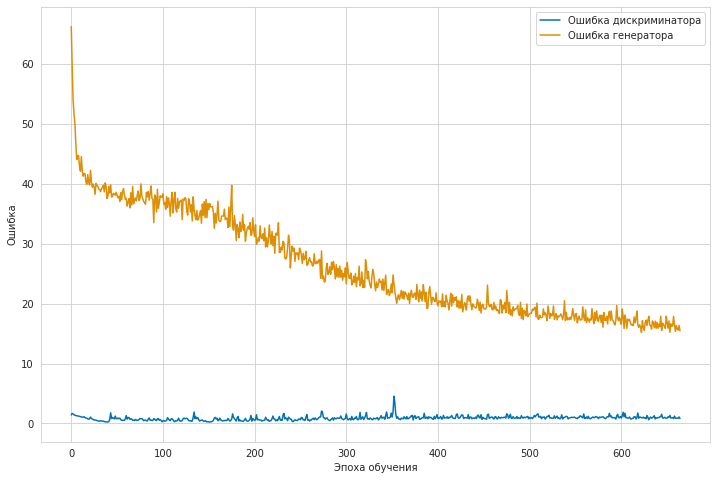

	...epoch 95/100	batch 0/7	D loss: 1.231178	G loss: 16.787447
	...epoch 95/100	batch 1/7	D loss: 1.061187	G loss: 16.377520
	...epoch 95/100	batch 2/7	D loss: 1.189952	G loss: 17.113194
	...epoch 95/100	batch 3/7	D loss: 1.021606	G loss: 16.337442
	...epoch 95/100	batch 4/7	D loss: 1.050681	G loss: 15.584070
	...epoch 95/100	batch 5/7	D loss: 1.107549	G loss: 16.567144
	...epoch 95/100	batch 6/7	D loss: 0.994668	G loss: 15.982113


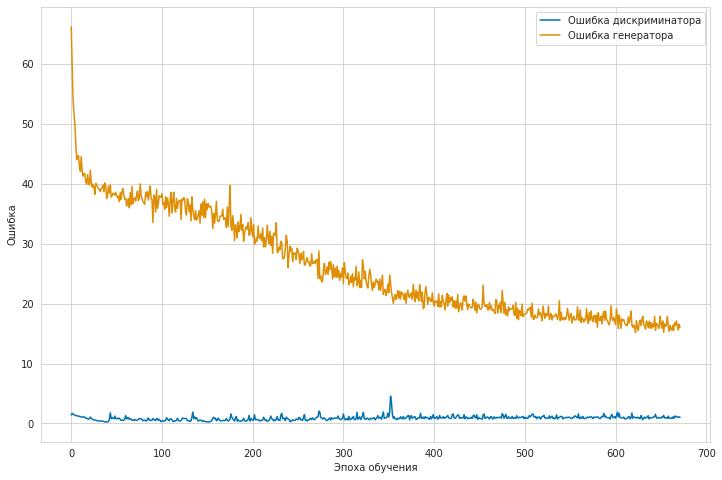

	...epoch 96/100	batch 0/7	D loss: 1.065674	G loss: 16.234251
	...epoch 96/100	batch 1/7	D loss: 1.068328	G loss: 17.209244
	...epoch 96/100	batch 2/7	D loss: 1.512967	G loss: 15.232154
	...epoch 96/100	batch 3/7	D loss: 1.006689	G loss: 16.617203
	...epoch 96/100	batch 4/7	D loss: 1.028660	G loss: 16.033428
	...epoch 96/100	batch 5/7	D loss: 1.043240	G loss: 16.292824
	...epoch 96/100	batch 6/7	D loss: 1.213401	G loss: 14.484960


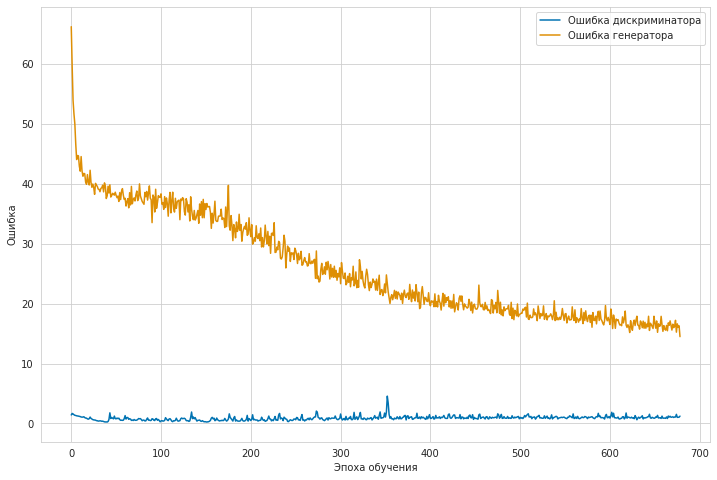

	...epoch 97/100	batch 0/7	D loss: 1.106073	G loss: 16.762909
	...epoch 97/100	batch 1/7	D loss: 0.774205	G loss: 16.618839
	...epoch 97/100	batch 2/7	D loss: 1.003125	G loss: 15.147404
	...epoch 97/100	batch 3/7	D loss: 1.050281	G loss: 16.060871
	...epoch 97/100	batch 4/7	D loss: 0.828380	G loss: 15.549755
	...epoch 97/100	batch 5/7	D loss: 0.981207	G loss: 15.597945
	...epoch 97/100	batch 6/7	D loss: 1.029823	G loss: 17.922585


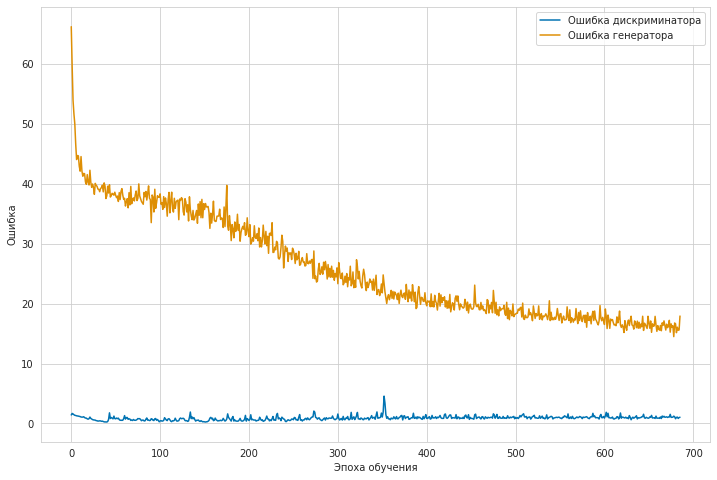

	...epoch 98/100	batch 0/7	D loss: 1.350212	G loss: 17.044558
	...epoch 98/100	batch 1/7	D loss: 0.830461	G loss: 15.884724
	...epoch 98/100	batch 2/7	D loss: 0.971802	G loss: 15.961872
	...epoch 98/100	batch 3/7	D loss: 1.086251	G loss: 16.068333
	...epoch 98/100	batch 4/7	D loss: 0.771976	G loss: 15.627179
	...epoch 98/100	batch 5/7	D loss: 1.088877	G loss: 15.943207
	...epoch 98/100	batch 6/7	D loss: 0.696590	G loss: 16.190277


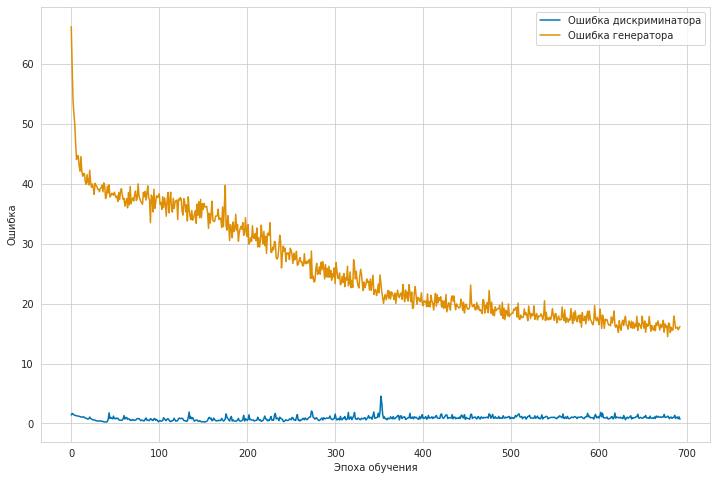

	...epoch 99/100	batch 0/7	D loss: 1.271434	G loss: 15.474136
	...epoch 99/100	batch 1/7	D loss: 1.026333	G loss: 16.624609
	...epoch 99/100	batch 2/7	D loss: 1.232851	G loss: 15.078913
	...epoch 99/100	batch 3/7	D loss: 0.833262	G loss: 15.659742
	...epoch 99/100	batch 4/7	D loss: 0.899919	G loss: 15.916793
	...epoch 99/100	batch 5/7	D loss: 1.037087	G loss: 15.631557
	...epoch 99/100	batch 6/7	D loss: 1.346669	G loss: 17.773870


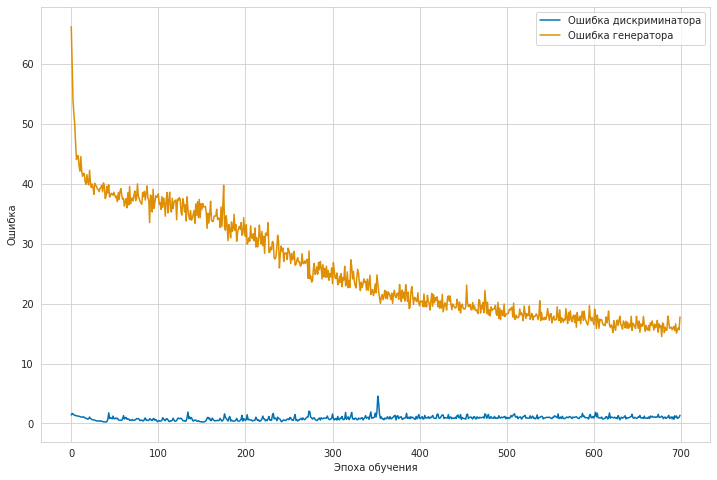

In [ ]:
from torchvision.utils import save_image


batch_size = 64

transform = transforms.Compose([
                  transforms.ToTensor(),
                 transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))])

path_to_data = '/content/drive/MyDrive/datasets/facades/'

train_data = loadData(path_to_data, 'train', transform)

train_data_loader = torch.utils.data.DataLoader(dataset=train_data,
                                                batch_size=batch_size,
                                                shuffle=True)

test_data = loadData(path_to_data, 'test', transform)
test_data_loader = torch.utils.data.DataLoader(dataset=test_data,
                                               batch_size=batch_size,
                                               shuffle=False)


G = Generator(3, 3)
D = Discriminator(6)
G.cuda()
D.cuda()

BCE_loss = torch.nn.BCELoss().cuda()
L1_loss = torch.nn.L1Loss().cuda()

lr, beta1, beta2 = 0.0002, 0.5, 0.999
G_optimizer = torch.optim.Adam(G.parameters(), lr=lr, betas=(beta1, beta2))
D_optimizer = torch.optim.Adam(D.parameters(), lr=lr, betas=(beta1, beta2))

batches_done = 0

num_epochs = 100

D_losses = []
G_losses = []

for epoch in range(num_epochs):


    for i, (input, target) in enumerate(train_data_loader):

        x_ = Variable(input.cuda())
        y_ = Variable(target.cuda())

        # подаем реальные данные
        D_real = D(x_, y_).squeeze()
        real_ = Variable(torch.ones(D_real.size()).cuda())
        D_real_loss = BCE_loss(D_real, real_)

        # подаем сгенерированные данные
        gen_image = G(x_)
        D_fake = D(x_, gen_image).squeeze()
        fake_ = Variable(torch.zeros(D_fake.size()).cuda())
        D_fake_loss = BCE_loss(D_fake, fake_)

        # пропагиируем дискриминатор
        D_loss = D_real_loss + D_fake_loss
        D.zero_grad()
        D_loss.backward()
        D_optimizer.step()

        # тренеруем генератор
        gen_image = G(x_)
        D_fake_decision = D(x_, gen_image).squeeze()
        G_fake_loss = BCE_loss(D_fake_decision, real_)

        l1_loss = 100 * L1_loss(gen_image, y_)

        # пропагиируем генератор
        G_loss = G_fake_loss + l1_loss
        G.zero_grad()
        G_loss.backward()
        G_optimizer.step()

        D_losses.append(D_loss.data.item())
        G_losses.append(G_loss.data.item())
        print("\t...epoch %d/%d\tbatch %d/%d\tD loss: %.6f\tG loss: %.6f" % \
                      (epoch, num_epochs, i, len(train_data_loader),  D_loss.data.item(), G_loss.data.item()))

        batches_done += 1

        if batches_done % 100 == 0:
                gen_imgs = G(x_)
                gen_imgs = gen_image.cpu().data
                save_image(gen_imgs.data[:5], "%s/%05d.png" % (path_to_data + "/out/", batches_done), nrow=5, normalize=True)

    plot_losses(D_losses,G_losses )

for i, (input, target) in enumerate(test_data_loader):
          x_ = Variable(input.cuda())
          y_ = Variable(target.cuda())
          gen_imgs = G(x_)
          gen_imgs = gen_imgs.cpu().data
          save_image(gen_imgs.data, "%s/%05d.png" % (path_to_data + "/result/", batches_done), nrow=5, normalize=True)



In [41]:
torch.cuda.empty_cache()

## CycleGAN

In [7]:
class Discriminator(torch.nn.Module):
    def __init__(self, input_dim):
        super(Discriminator, self).__init__()

        self.conv1 = ConvBlock(input_dim, 64, activation=False, batch_norm=False)
        self.conv2 = ConvBlock(64, 128)
        self.conv3 = ConvBlock(128, 256)
        self.conv4 = ConvBlock(256, 512, stride=1)
        self.conv5 = ConvBlock(512, 1, stride=1, batch_norm=False)

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        out = torch.nn.Sigmoid()(x)
        return out

    def normal_weight_init(self, mean=0.0, std=0.02):
        for m in self.children():
            if isinstance(m, ConvBlock):
                torch.nn.init.normal(m.conv.weight, mean, std)


In [8]:
from torchsummary import summary

In [9]:
summary(Discriminator(3).cuda(),(3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
         ConvBlock-2         [-1, 64, 128, 128]               0
         LeakyReLU-3         [-1, 64, 128, 128]               0
            Conv2d-4          [-1, 128, 64, 64]         131,200
       BatchNorm2d-5          [-1, 128, 64, 64]             256
         ConvBlock-6          [-1, 128, 64, 64]               0
         LeakyReLU-7          [-1, 128, 64, 64]               0
            Conv2d-8          [-1, 256, 32, 32]         524,544
       BatchNorm2d-9          [-1, 256, 32, 32]             512
        ConvBlock-10          [-1, 256, 32, 32]               0
        LeakyReLU-11          [-1, 256, 32, 32]               0
           Conv2d-12          [-1, 512, 31, 31]       2,097,664
      BatchNorm2d-13          [-1, 512, 31, 31]           1,024
        ConvBlock-14          [-1, 512,

надо переопределить DataLoader, картинки нельзя подавать в паре

In [8]:
import torch.utils.data as data
import os
from PIL import Image

class loadData_templ(data.Dataset):
    def __init__(self, image_dir, subfolder, transform):
        super(loadData_templ, self).__init__()
        self.input_path = os.path.join(image_dir, subfolder)
        self.image_filenames = [x for x in sorted(os.listdir(self.input_path))]
        self.transform = transform

    def __getitem__(self, index):
        fileim = os.path.join(self.input_path, self.image_filenames[index])
        img = Image.open(fileim)
        templ = img.crop((img.width // 2, 0, img.width, img.height))
        return self.transform(templ)

    def __len__(self):
        return len(self.image_filenames)


class loadData_img(data.Dataset):
    def __init__(self, image_dir, subfolder, transform):
        super(loadData_img, self).__init__()
        self.input_path = os.path.join(image_dir, subfolder)
        self.image_filenames = [x for x in sorted(os.listdir(self.input_path))]
        self.transform = transform

    def __getitem__(self, index):
        fileim = os.path.join(self.input_path, self.image_filenames[index])
        img = Image.open(fileim)
        image = img.crop((0, 0, img.width // 2, img.height))
        return self.transform(image)

    def __len__(self):
        return len(self.image_filenames)

	...epoch 16 0/2500	batch 31/50	D loss: 1.047734	G loss: 3.463598
	...epoch 16 0/2500	batch 47/50	D loss: 1.031716	G loss: 2.884050


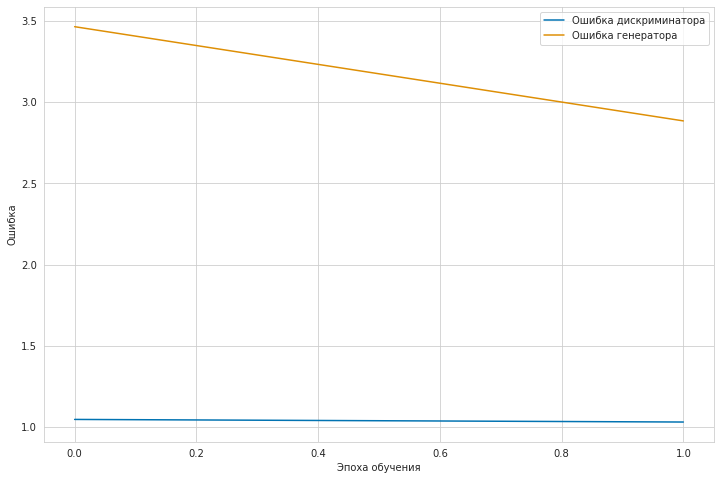

	...epoch 16 1/2500	batch 13/50	D loss: 1.086249	G loss: 2.677774
	...epoch 16 1/2500	batch 29/50	D loss: 0.995301	G loss: 2.862233
	...epoch 16 1/2500	batch 45/50	D loss: 1.008552	G loss: 2.504066


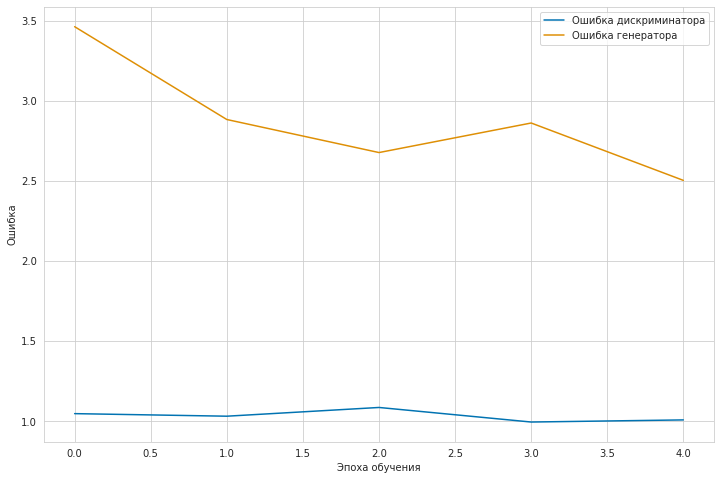

	...epoch 16 2/2500	batch 11/50	D loss: 0.919006	G loss: 2.583447
	...epoch 16 2/2500	batch 27/50	D loss: 0.912835	G loss: 2.596522
	...epoch 16 2/2500	batch 43/50	D loss: 0.889730	G loss: 2.258194


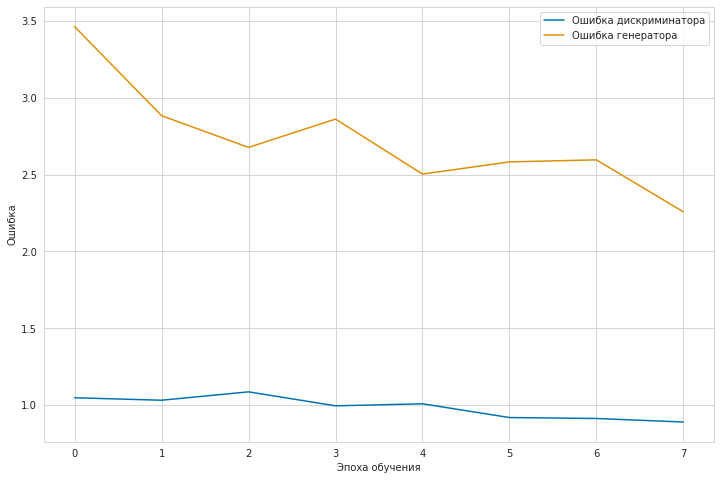

	...epoch 16 3/2500	batch 9/50	D loss: 0.941035	G loss: 2.456487
	...epoch 16 3/2500	batch 25/50	D loss: 0.915209	G loss: 2.303657
	...epoch 16 3/2500	batch 41/50	D loss: 0.836389	G loss: 2.569373


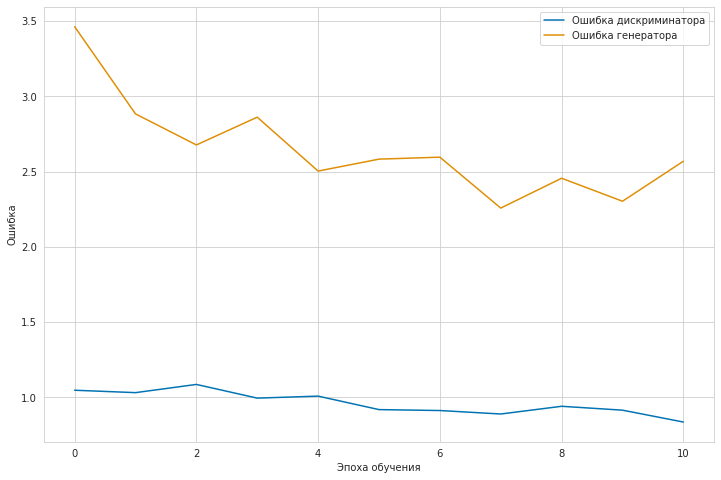

	...epoch 16 4/2500	batch 7/50	D loss: 0.839728	G loss: 2.291401
	...epoch 16 4/2500	batch 23/50	D loss: 0.917975	G loss: 2.288304
	...epoch 16 4/2500	batch 39/50	D loss: 0.987964	G loss: 2.126737


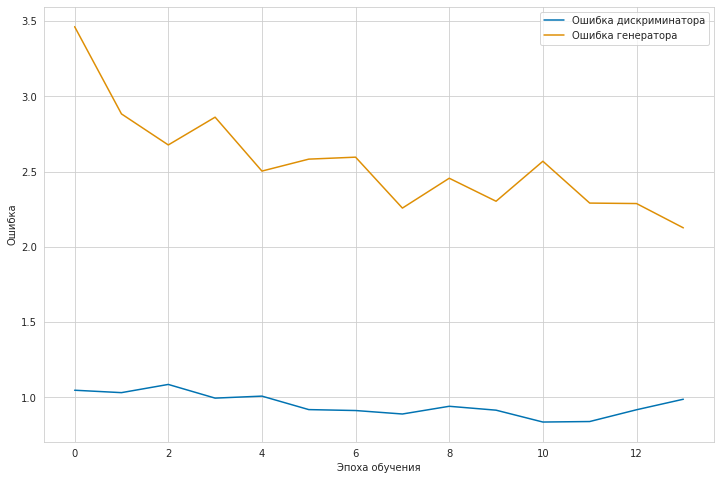

	...epoch 16 5/2500	batch 5/50	D loss: 0.848403	G loss: 3.128000
	...epoch 16 5/2500	batch 21/50	D loss: 0.654879	G loss: 2.535476
	...epoch 16 5/2500	batch 37/50	D loss: 0.627293	G loss: 2.384567


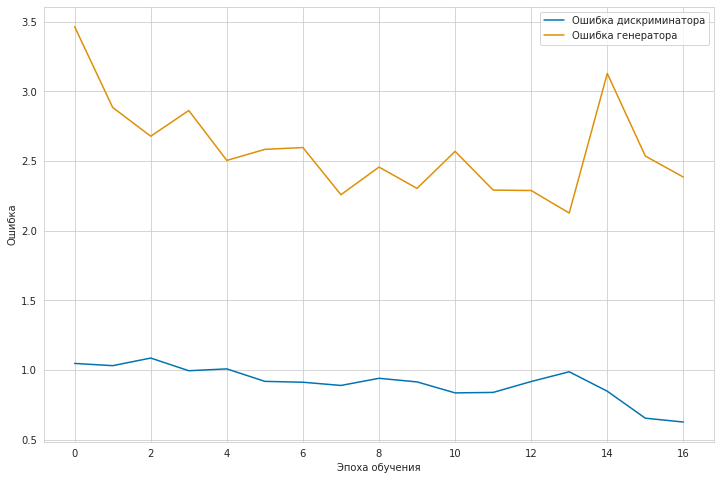

	...epoch 16 6/2500	batch 3/50	D loss: 0.714608	G loss: 2.400728
	...epoch 16 6/2500	batch 19/50	D loss: 0.746180	G loss: 2.324579
	...epoch 16 6/2500	batch 35/50	D loss: 0.936052	G loss: 2.426906


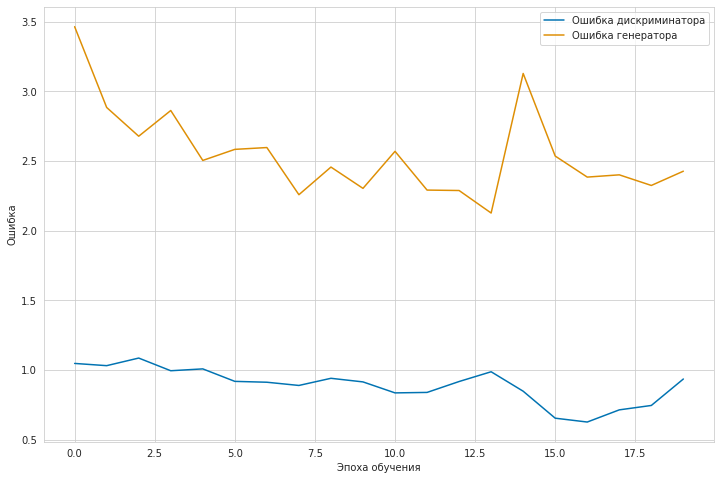

	...epoch 16 7/2500	batch 1/50	D loss: 0.898830	G loss: 2.269737
	...epoch 16 7/2500	batch 17/50	D loss: 0.786752	G loss: 2.347552
	...epoch 16 7/2500	batch 33/50	D loss: 0.806359	G loss: 2.197776
	...epoch 16 7/2500	batch 49/50	D loss: 0.883255	G loss: 2.256789


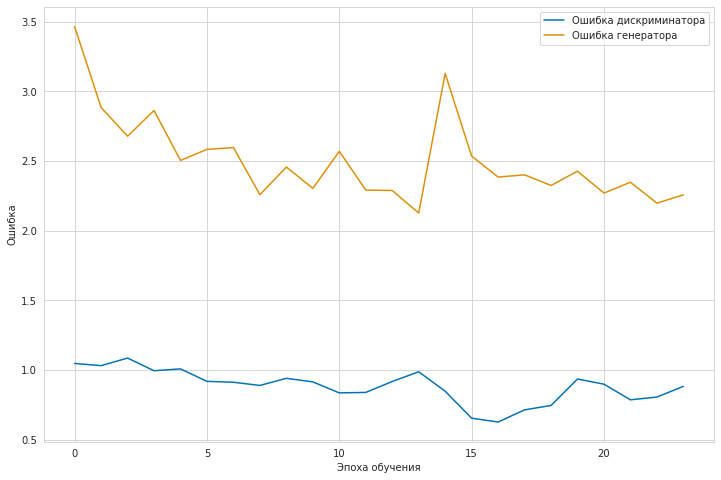

	...epoch 16 8/2500	batch 15/50	D loss: 0.805581	G loss: 2.139848
	...epoch 16 8/2500	batch 31/50	D loss: 0.888830	G loss: 1.961809
	...epoch 16 8/2500	batch 47/50	D loss: 0.855383	G loss: 2.329034


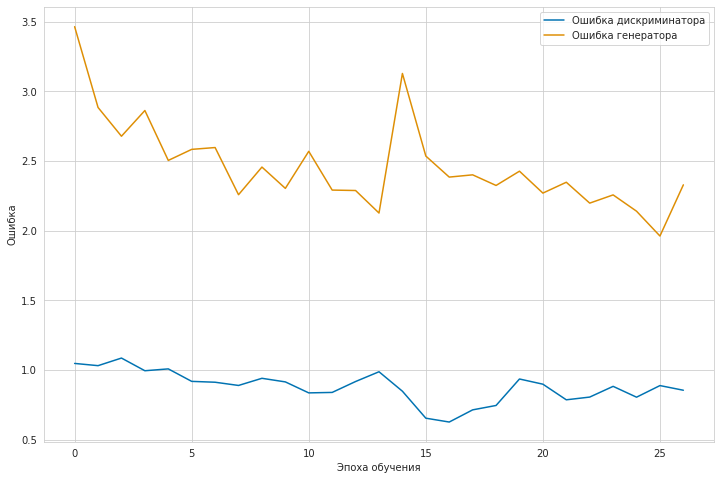

	...epoch 16 9/2500	batch 13/50	D loss: 0.844972	G loss: 2.181553
	...epoch 16 9/2500	batch 29/50	D loss: 0.838587	G loss: 2.070275
	...epoch 16 9/2500	batch 45/50	D loss: 0.864809	G loss: 2.217160


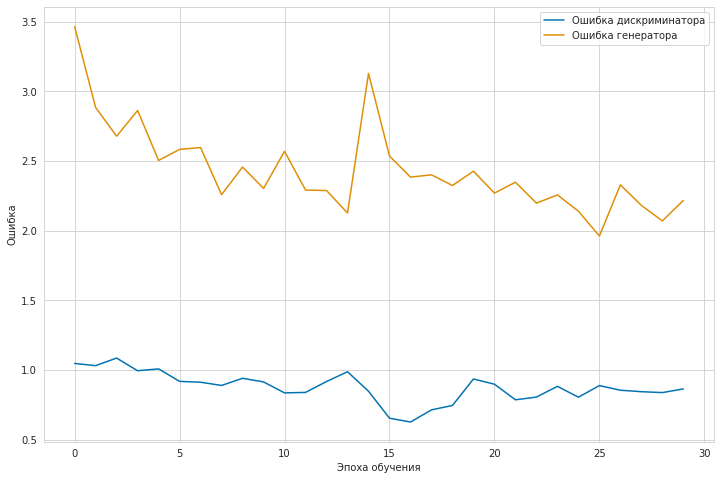

	...epoch 16 10/2500	batch 11/50	D loss: 0.740146	G loss: 2.349037
	...epoch 16 10/2500	batch 27/50	D loss: 0.777770	G loss: 1.987480
	...epoch 16 10/2500	batch 43/50	D loss: 0.855382	G loss: 2.071488


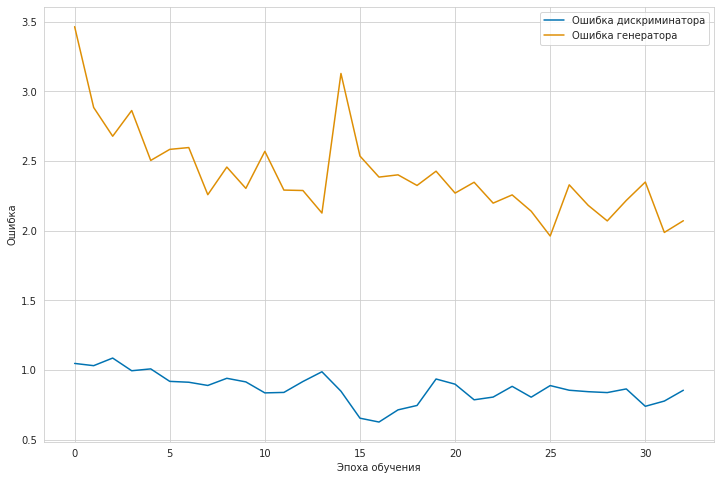

	...epoch 16 11/2500	batch 9/50	D loss: 0.909272	G loss: 1.963783
	...epoch 16 11/2500	batch 25/50	D loss: 0.877387	G loss: 2.512105
	...epoch 16 11/2500	batch 41/50	D loss: 0.841978	G loss: 2.087791


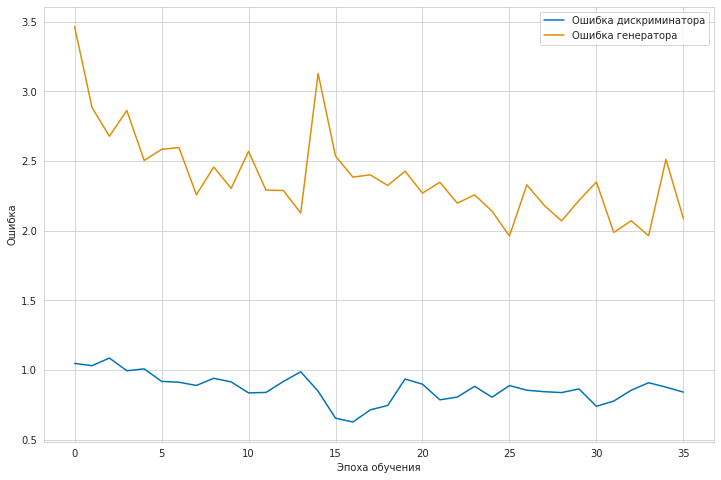

	...epoch 16 12/2500	batch 7/50	D loss: 0.903678	G loss: 2.095134
	...epoch 16 12/2500	batch 23/50	D loss: 0.813977	G loss: 2.129179
	...epoch 16 12/2500	batch 39/50	D loss: 0.881198	G loss: 1.735872


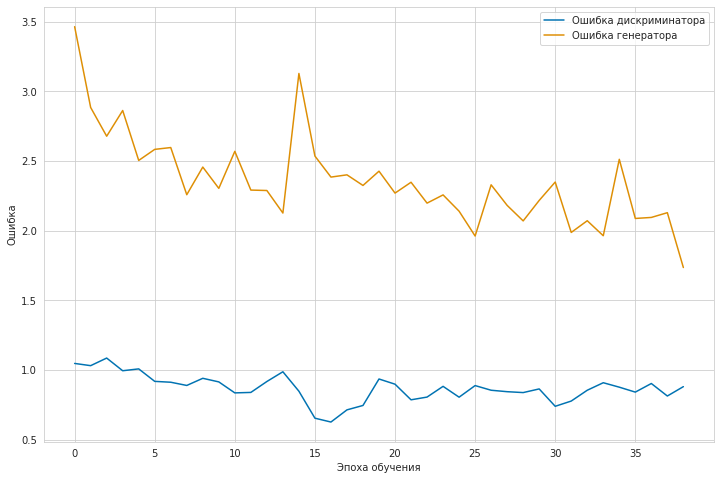

	...epoch 16 13/2500	batch 5/50	D loss: 0.842279	G loss: 2.371913
	...epoch 16 13/2500	batch 21/50	D loss: 0.821182	G loss: 1.951856
	...epoch 16 13/2500	batch 37/50	D loss: 0.669299	G loss: 2.302592


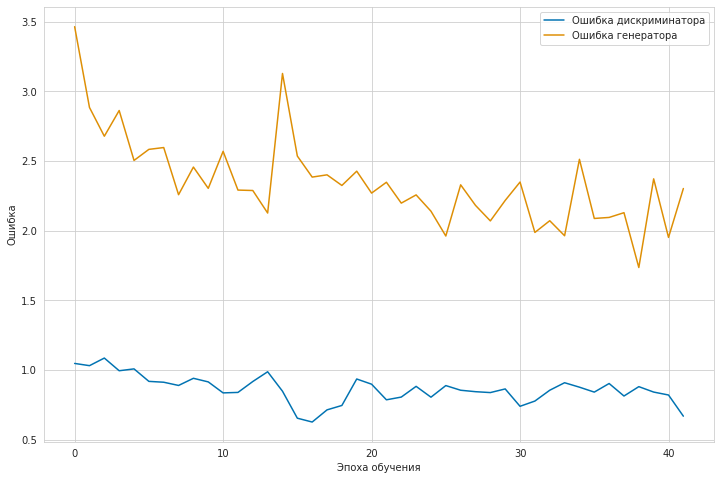

	...epoch 16 14/2500	batch 3/50	D loss: 0.775524	G loss: 2.365366
	...epoch 16 14/2500	batch 19/50	D loss: 0.766530	G loss: 2.165897
	...epoch 16 14/2500	batch 35/50	D loss: 0.925042	G loss: 1.980924


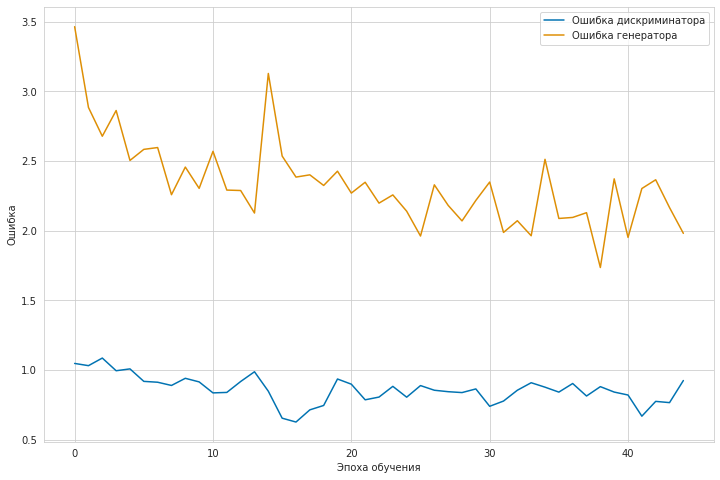

	...epoch 16 15/2500	batch 1/50	D loss: 0.847717	G loss: 1.936867
	...epoch 16 15/2500	batch 17/50	D loss: 0.868034	G loss: 1.991380
	...epoch 16 15/2500	batch 33/50	D loss: 0.879236	G loss: 1.836504
	...epoch 16 15/2500	batch 49/50	D loss: 0.913327	G loss: 1.853539


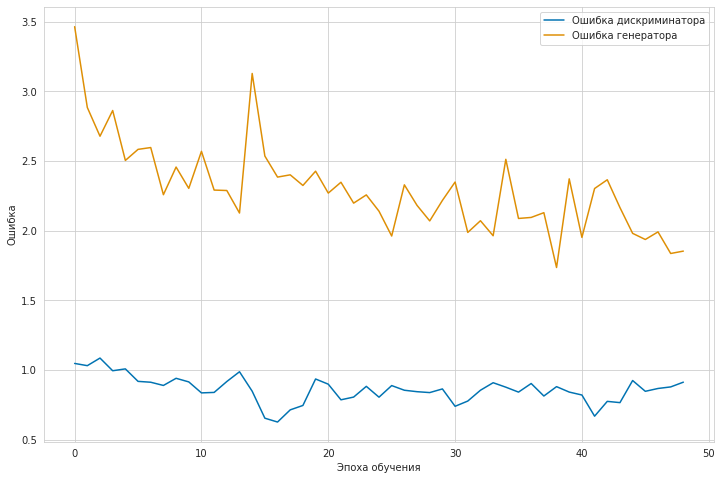

	...epoch 16 16/2500	batch 15/50	D loss: 0.746448	G loss: 2.004966
	...epoch 16 16/2500	batch 31/50	D loss: 0.797692	G loss: 1.999179
	...epoch 16 16/2500	batch 47/50	D loss: 0.804345	G loss: 2.195255


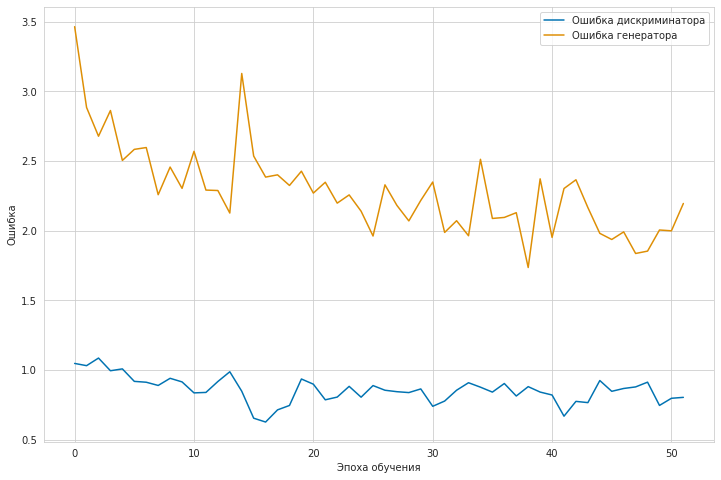

	...epoch 16 17/2500	batch 13/50	D loss: 0.846757	G loss: 1.863915
	...epoch 16 17/2500	batch 29/50	D loss: 0.935835	G loss: 2.119661
	...epoch 16 17/2500	batch 45/50	D loss: 0.757411	G loss: 1.679575


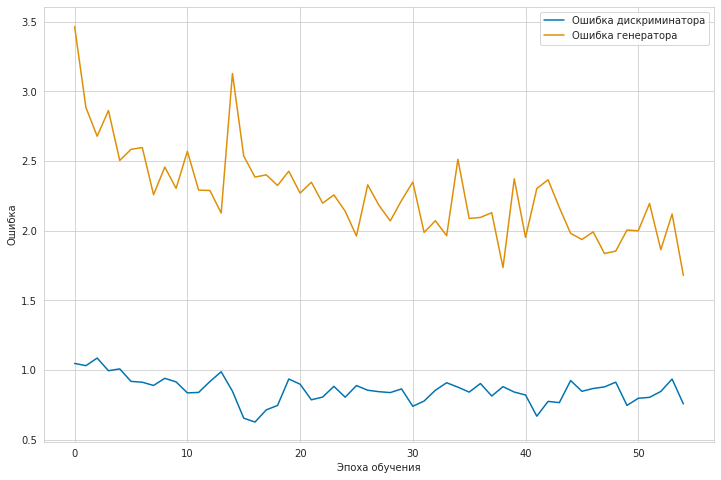

	...epoch 16 18/2500	batch 11/50	D loss: 0.882705	G loss: 1.932258
	...epoch 16 18/2500	batch 27/50	D loss: 0.729159	G loss: 1.976040
	...epoch 16 18/2500	batch 43/50	D loss: 0.768008	G loss: 2.183897


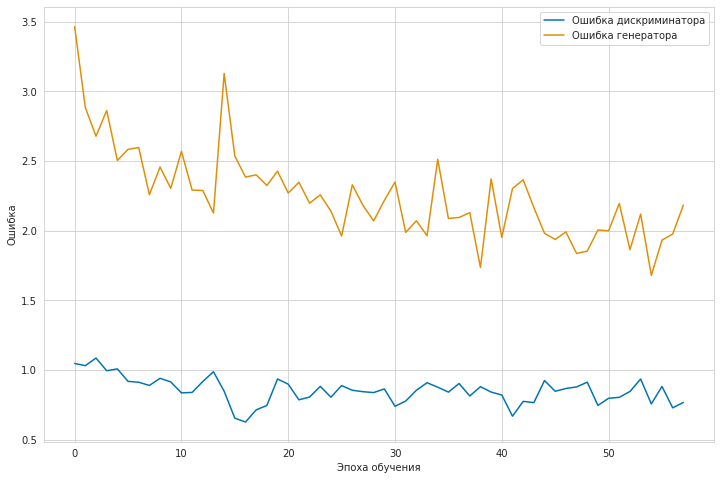

	...epoch 16 19/2500	batch 9/50	D loss: 0.796670	G loss: 1.849498
	...epoch 16 19/2500	batch 25/50	D loss: 0.826003	G loss: 2.020706
	...epoch 16 19/2500	batch 41/50	D loss: 0.783660	G loss: 1.877112


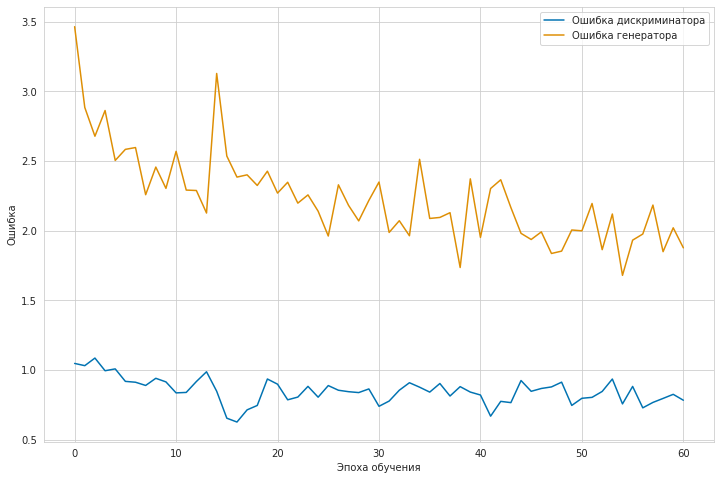

	...epoch 16 20/2500	batch 7/50	D loss: 0.777483	G loss: 1.852619
	...epoch 16 20/2500	batch 23/50	D loss: 0.914080	G loss: 1.625537
	...epoch 16 20/2500	batch 39/50	D loss: 0.791199	G loss: 1.763910


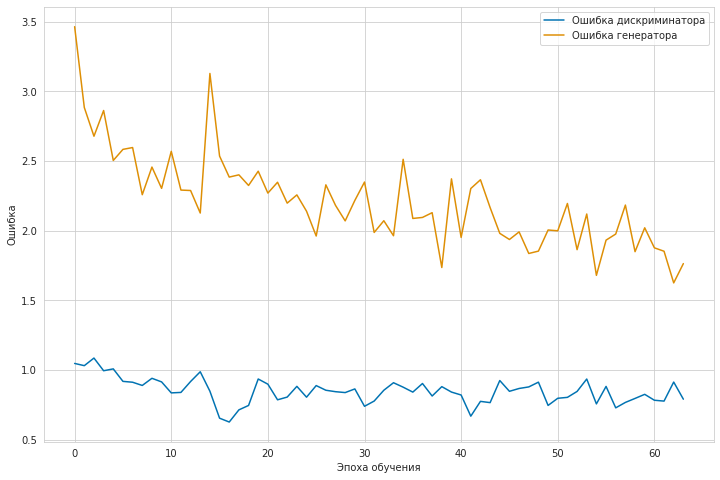

	...epoch 16 21/2500	batch 5/50	D loss: 0.832106	G loss: 1.598369
	...epoch 16 21/2500	batch 21/50	D loss: 0.675925	G loss: 2.098783
	...epoch 16 21/2500	batch 37/50	D loss: 0.726886	G loss: 1.789091


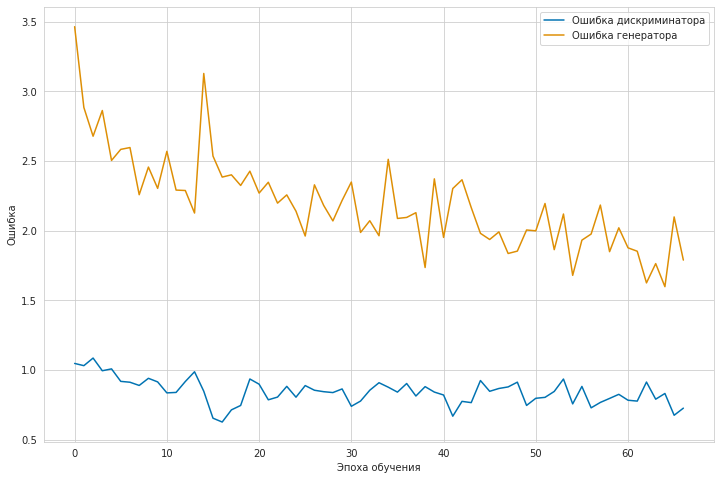

	...epoch 16 22/2500	batch 3/50	D loss: 0.927187	G loss: 1.911556
	...epoch 16 22/2500	batch 19/50	D loss: 0.935418	G loss: 1.725051
	...epoch 16 22/2500	batch 35/50	D loss: 1.099715	G loss: 1.977877


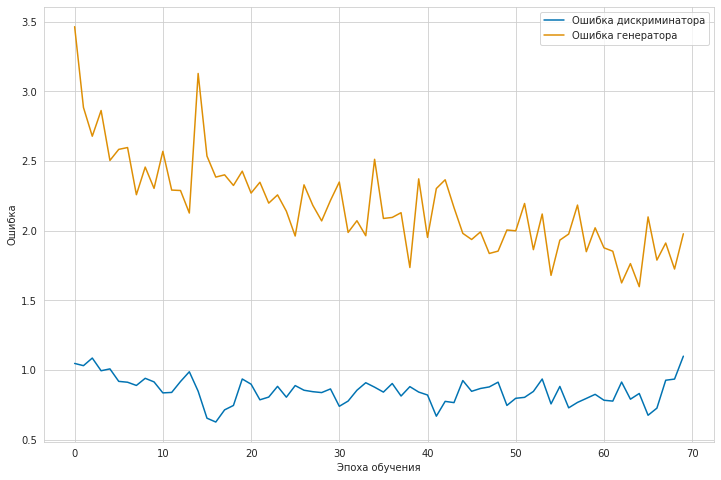

	...epoch 16 23/2500	batch 1/50	D loss: 0.884264	G loss: 2.034682
	...epoch 16 23/2500	batch 17/50	D loss: 0.936638	G loss: 1.807153
	...epoch 16 23/2500	batch 33/50	D loss: 0.933304	G loss: 1.858405
	...epoch 16 23/2500	batch 49/50	D loss: 0.840806	G loss: 1.609104


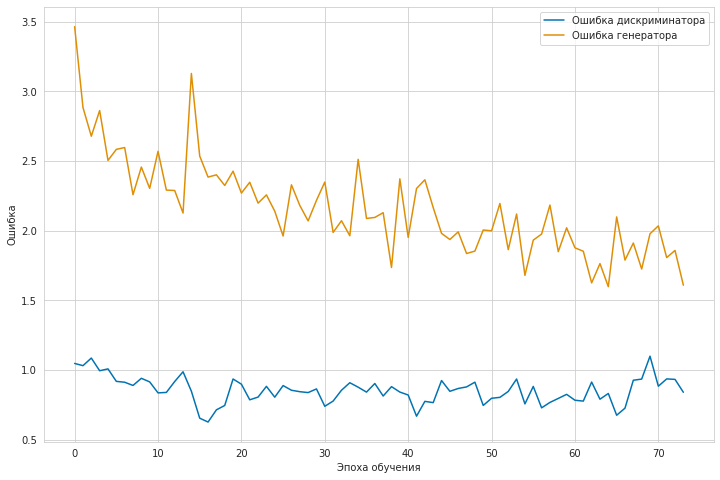

	...epoch 16 24/2500	batch 15/50	D loss: 0.892684	G loss: 2.083429
	...epoch 16 24/2500	batch 31/50	D loss: 0.832997	G loss: 1.768000
	...epoch 16 24/2500	batch 47/50	D loss: 0.835679	G loss: 1.897357


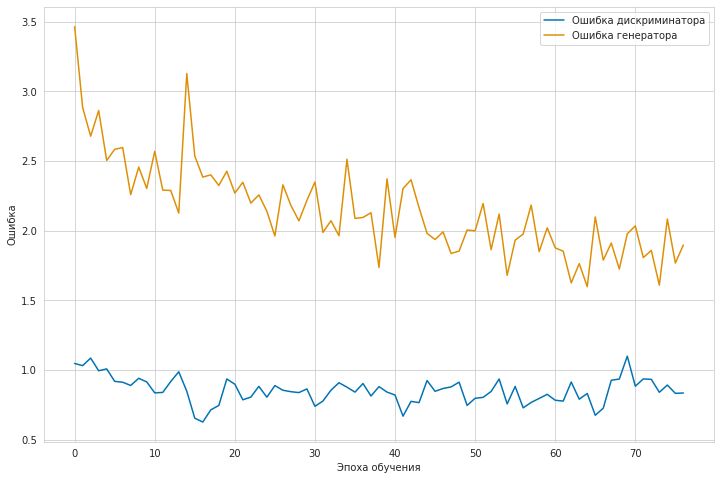

	...epoch 16 25/2500	batch 13/50	D loss: 0.872587	G loss: 1.706479
	...epoch 16 25/2500	batch 29/50	D loss: 0.841811	G loss: 1.571621
	...epoch 16 25/2500	batch 45/50	D loss: 0.968107	G loss: 1.926789


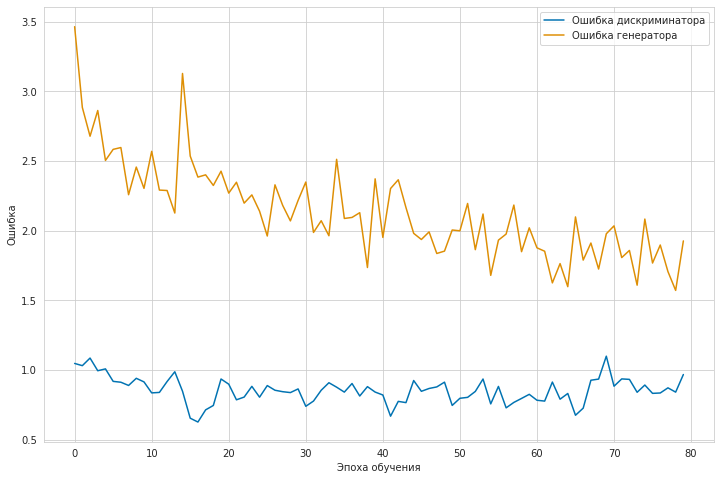

	...epoch 16 26/2500	batch 11/50	D loss: 0.741613	G loss: 1.726983
	...epoch 16 26/2500	batch 27/50	D loss: 0.749789	G loss: 1.777599
	...epoch 16 26/2500	batch 43/50	D loss: 0.810757	G loss: 1.682145


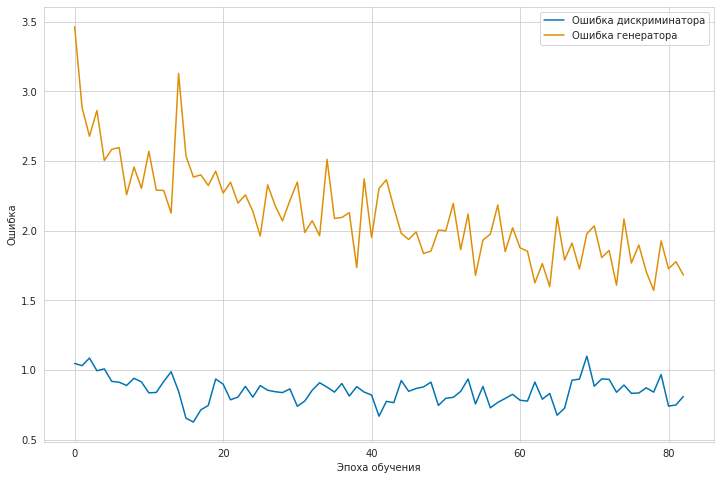

	...epoch 16 27/2500	batch 9/50	D loss: 0.829579	G loss: 2.141824
	...epoch 16 27/2500	batch 25/50	D loss: 0.932706	G loss: 1.840795
	...epoch 16 27/2500	batch 41/50	D loss: 0.834773	G loss: 1.387180


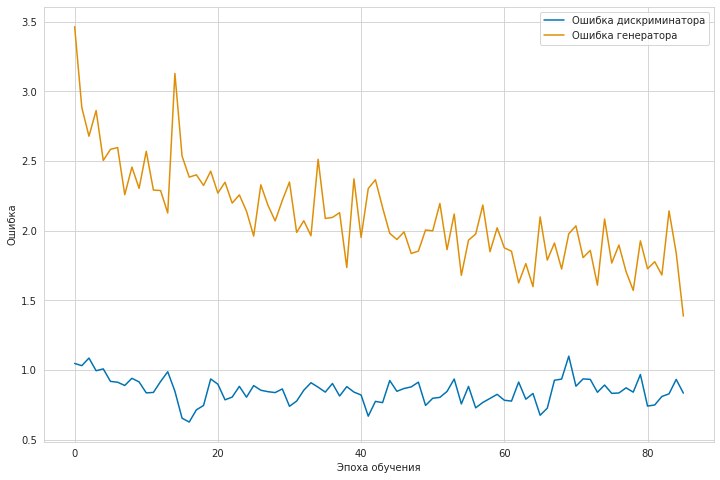

	...epoch 16 28/2500	batch 7/50	D loss: 1.064209	G loss: 2.333350
	...epoch 16 28/2500	batch 23/50	D loss: 0.725632	G loss: 1.856055
	...epoch 16 28/2500	batch 39/50	D loss: 0.806150	G loss: 1.676304


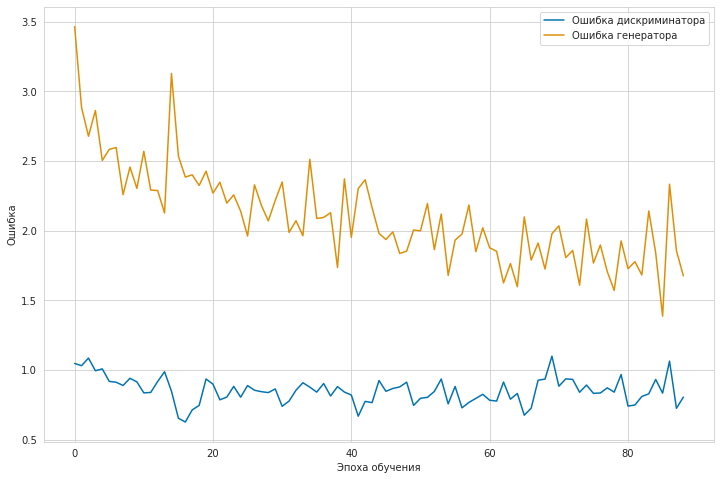

	...epoch 16 29/2500	batch 5/50	D loss: 0.937952	G loss: 1.705534
	...epoch 16 29/2500	batch 21/50	D loss: 1.001137	G loss: 1.642279
	...epoch 16 29/2500	batch 37/50	D loss: 0.810977	G loss: 1.849616


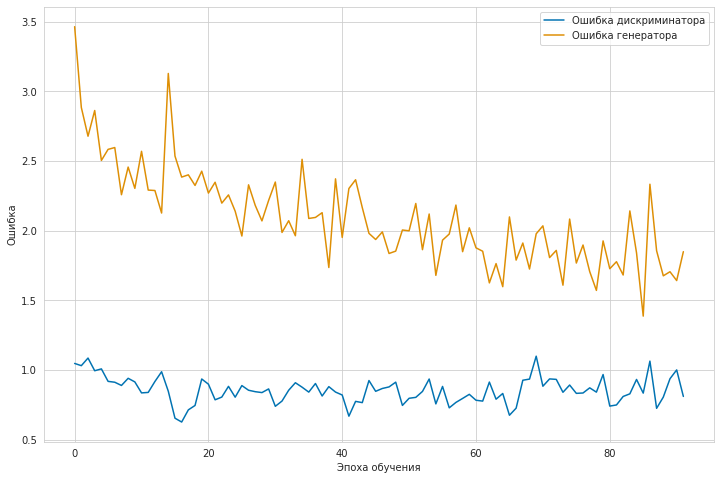

	...epoch 16 30/2500	batch 3/50	D loss: 0.810002	G loss: 1.948727
	...epoch 16 30/2500	batch 19/50	D loss: 0.784631	G loss: 1.964293
	...epoch 16 30/2500	batch 35/50	D loss: 0.796894	G loss: 1.707534


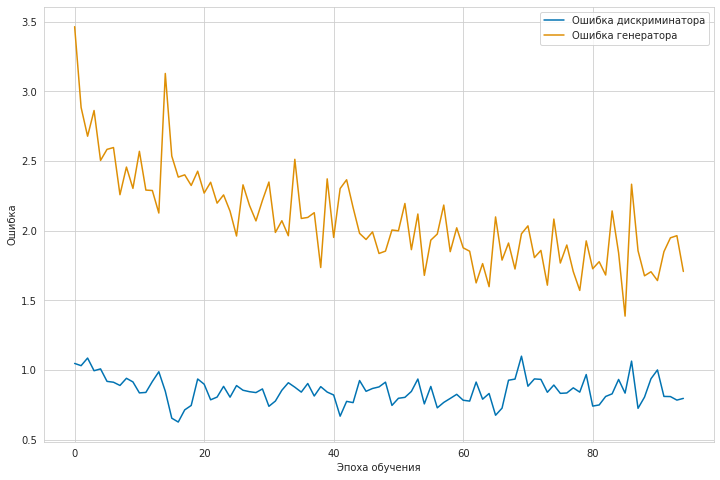

	...epoch 16 31/2500	batch 1/50	D loss: 0.719199	G loss: 1.763446
	...epoch 16 31/2500	batch 17/50	D loss: 0.756943	G loss: 1.814319
	...epoch 16 31/2500	batch 33/50	D loss: 0.754957	G loss: 1.697975
	...epoch 16 31/2500	batch 49/50	D loss: 0.894057	G loss: 1.601732


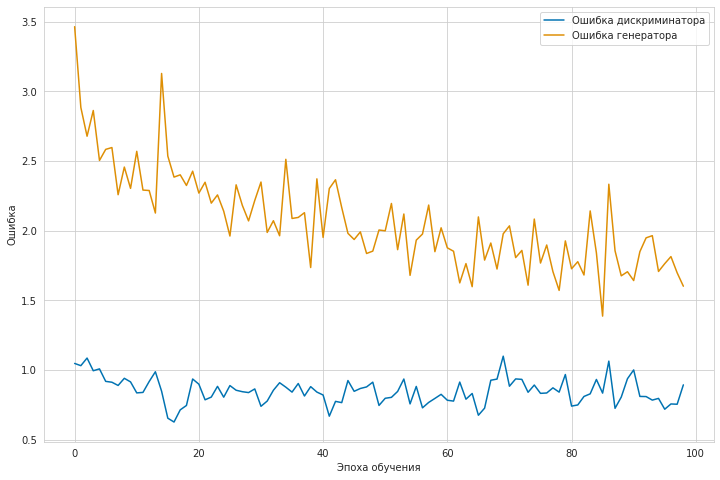

	...epoch 16 32/2500	batch 15/50	D loss: 0.896664	G loss: 1.536591
	...epoch 16 32/2500	batch 31/50	D loss: 0.810513	G loss: 1.927580
	...epoch 16 32/2500	batch 47/50	D loss: 0.835103	G loss: 1.917217


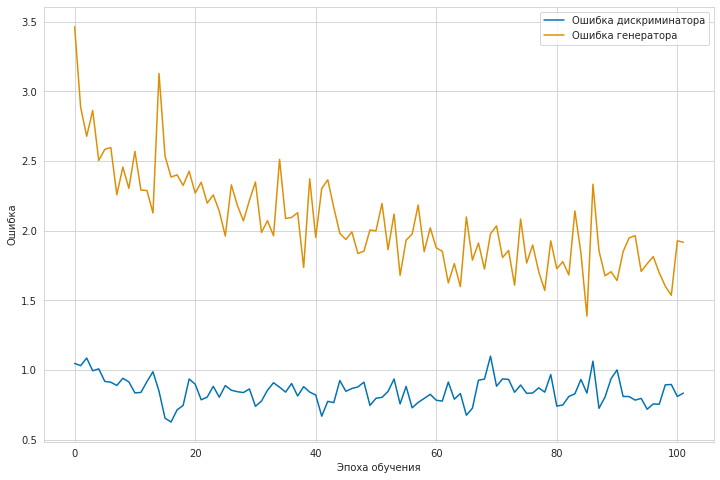

	...epoch 16 33/2500	batch 13/50	D loss: 0.731081	G loss: 1.855667
	...epoch 16 33/2500	batch 29/50	D loss: 0.805866	G loss: 1.991544
	...epoch 16 33/2500	batch 45/50	D loss: 0.723650	G loss: 1.616102


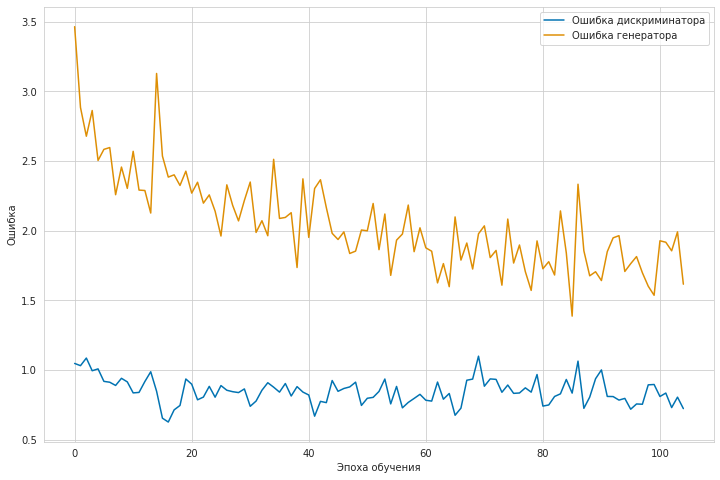

	...epoch 16 34/2500	batch 11/50	D loss: 0.674481	G loss: 1.631510
	...epoch 16 34/2500	batch 27/50	D loss: 0.662811	G loss: 2.085328
	...epoch 16 34/2500	batch 43/50	D loss: 0.698758	G loss: 1.812615


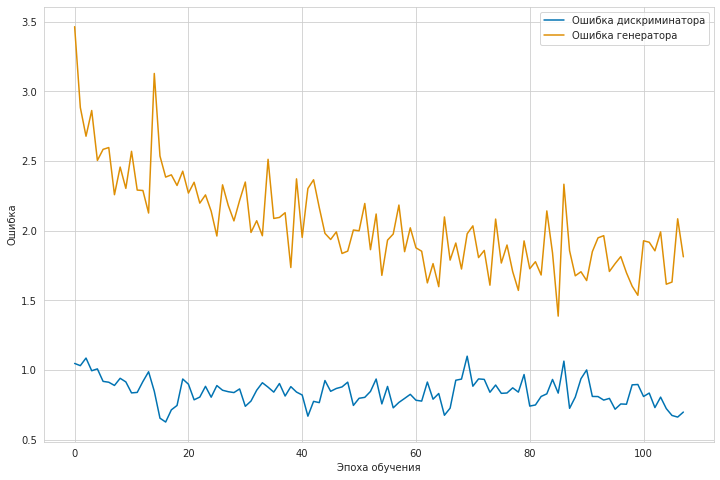

	...epoch 16 35/2500	batch 9/50	D loss: 0.780706	G loss: 1.418078
	...epoch 16 35/2500	batch 25/50	D loss: 0.669470	G loss: 1.736760
	...epoch 16 35/2500	batch 41/50	D loss: 0.718598	G loss: 1.624882


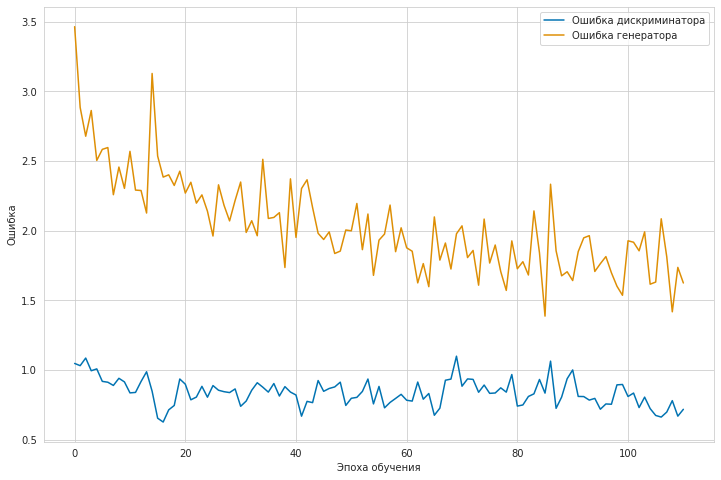

	...epoch 16 36/2500	batch 7/50	D loss: 0.859688	G loss: 1.584598
	...epoch 16 36/2500	batch 23/50	D loss: 0.817132	G loss: 1.420034
	...epoch 16 36/2500	batch 39/50	D loss: 0.880941	G loss: 1.602280


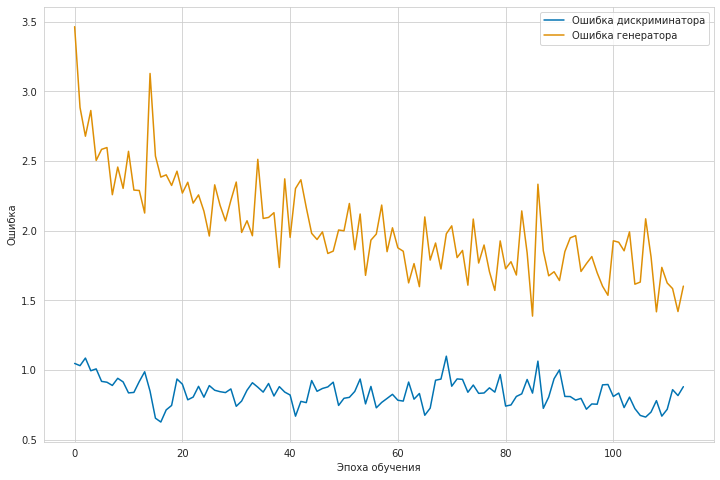

	...epoch 16 37/2500	batch 5/50	D loss: 0.896579	G loss: 2.038523
	...epoch 16 37/2500	batch 21/50	D loss: 0.931640	G loss: 1.610155
	...epoch 16 37/2500	batch 37/50	D loss: 0.947116	G loss: 1.301577


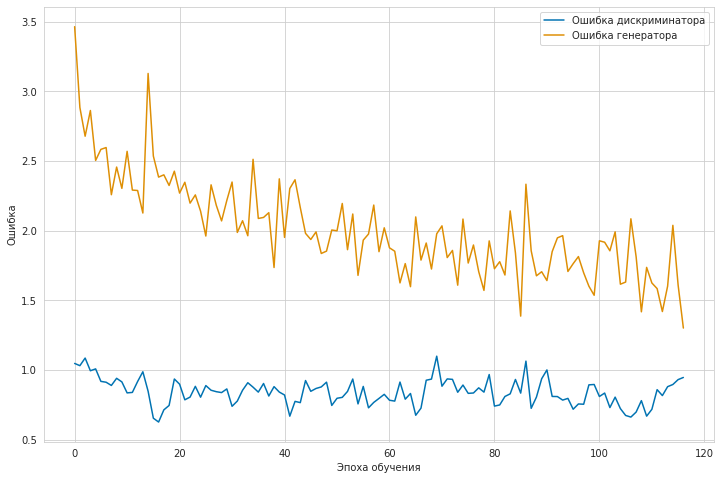

	...epoch 16 38/2500	batch 3/50	D loss: 0.827279	G loss: 1.547385
	...epoch 16 38/2500	batch 19/50	D loss: 0.805622	G loss: 1.519356
	...epoch 16 38/2500	batch 35/50	D loss: 0.915647	G loss: 1.922381


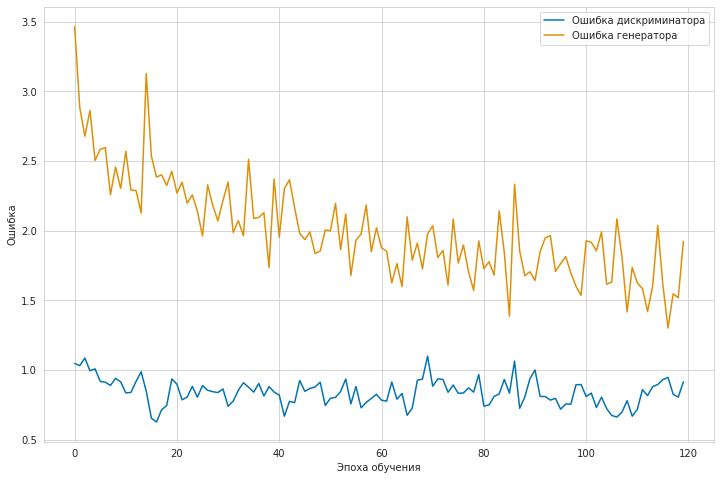

	...epoch 16 39/2500	batch 1/50	D loss: 0.755920	G loss: 1.515315
	...epoch 16 39/2500	batch 17/50	D loss: 0.775384	G loss: 1.579625
	...epoch 16 39/2500	batch 33/50	D loss: 0.742175	G loss: 1.577577
	...epoch 16 39/2500	batch 49/50	D loss: 0.810971	G loss: 1.568452


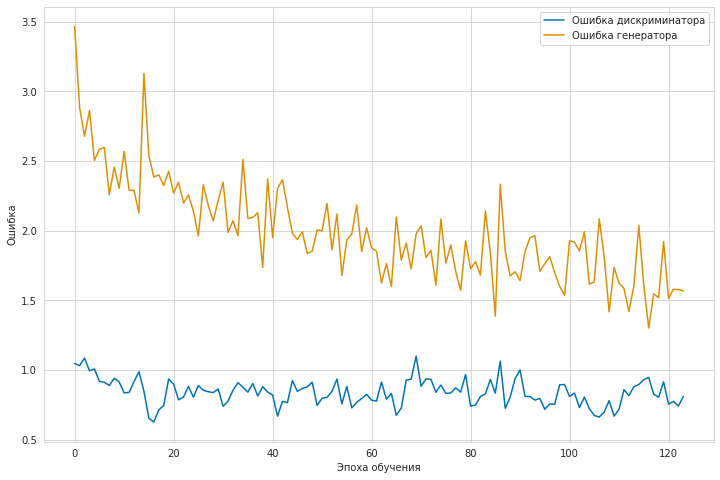

	...epoch 16 40/2500	batch 15/50	D loss: 0.698884	G loss: 1.504701
	...epoch 16 40/2500	batch 31/50	D loss: 0.762959	G loss: 1.978850
	...epoch 16 40/2500	batch 47/50	D loss: 0.942525	G loss: 1.490687


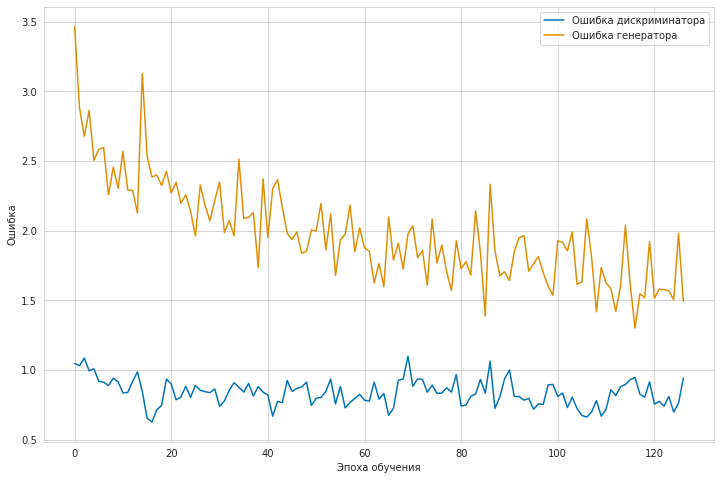

	...epoch 16 41/2500	batch 13/50	D loss: 1.113376	G loss: 1.266221
	...epoch 16 41/2500	batch 29/50	D loss: 1.063717	G loss: 1.726044
	...epoch 16 41/2500	batch 45/50	D loss: 0.832601	G loss: 1.349433


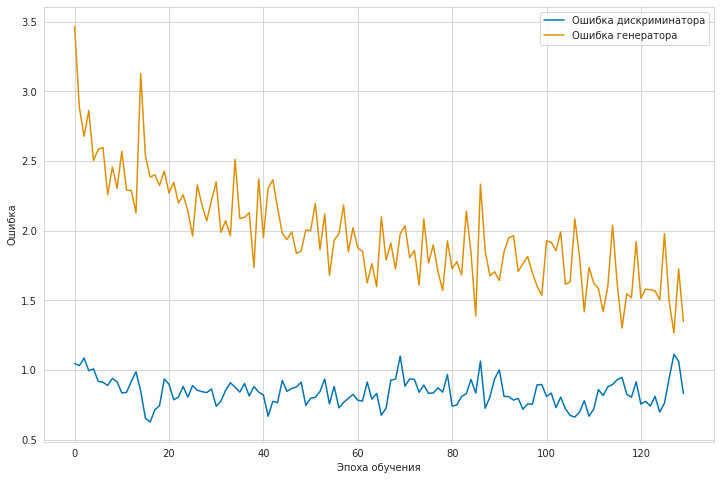

	...epoch 16 42/2500	batch 11/50	D loss: 0.863121	G loss: 1.575704
	...epoch 16 42/2500	batch 27/50	D loss: 0.852220	G loss: 1.625402
	...epoch 16 42/2500	batch 43/50	D loss: 0.786787	G loss: 1.636431


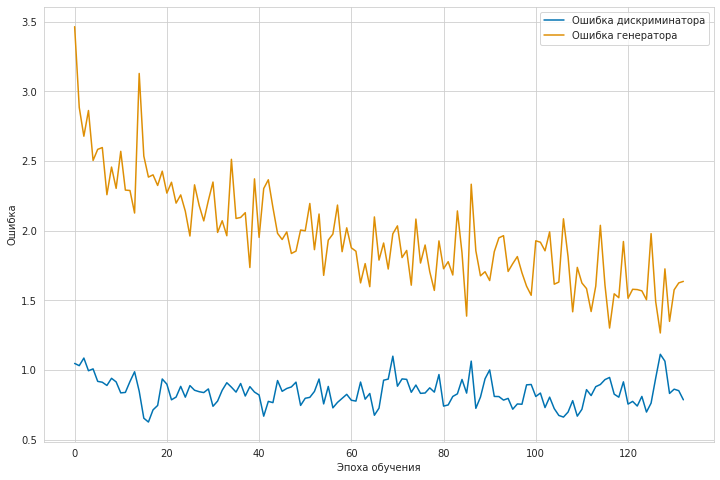

	...epoch 16 43/2500	batch 9/50	D loss: 0.912777	G loss: 2.641679
	...epoch 16 43/2500	batch 25/50	D loss: 0.760716	G loss: 1.610523
	...epoch 16 43/2500	batch 41/50	D loss: 0.774836	G loss: 1.471081


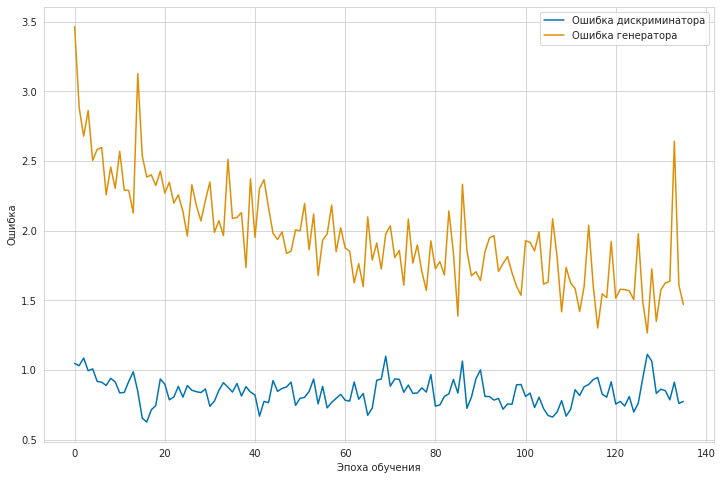

	...epoch 16 44/2500	batch 7/50	D loss: 0.625224	G loss: 1.683838
	...epoch 16 44/2500	batch 23/50	D loss: 0.681468	G loss: 1.675745
	...epoch 16 44/2500	batch 39/50	D loss: 0.711738	G loss: 1.631740


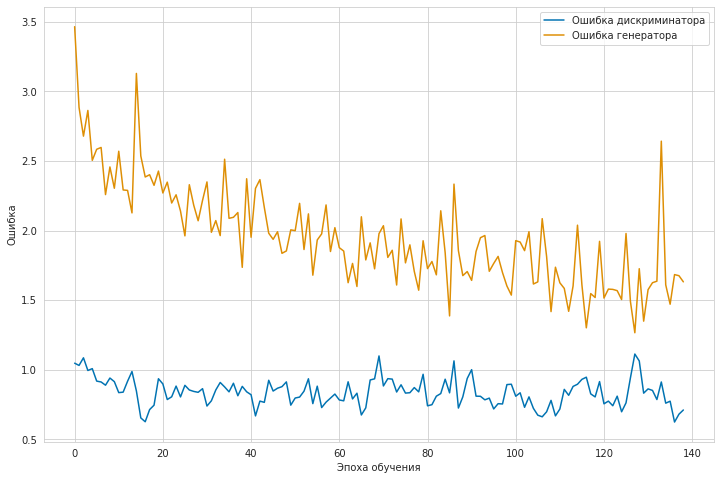

	...epoch 16 45/2500	batch 5/50	D loss: 0.645933	G loss: 1.865398
	...epoch 16 45/2500	batch 21/50	D loss: 0.800890	G loss: 1.647974
	...epoch 16 45/2500	batch 37/50	D loss: 0.803585	G loss: 1.355942


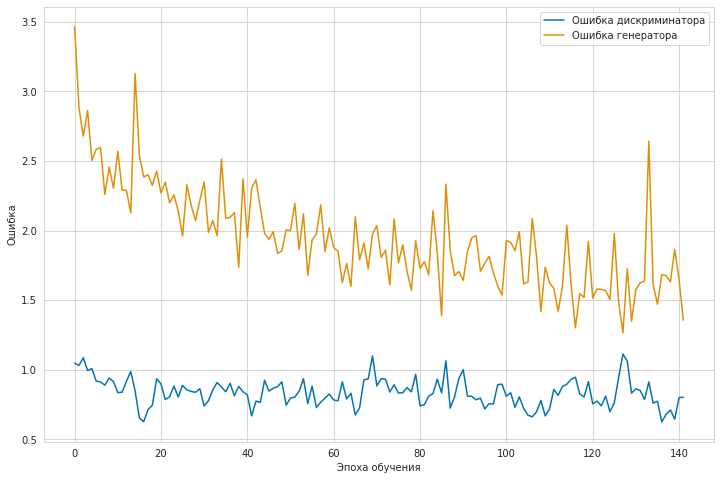

	...epoch 16 46/2500	batch 3/50	D loss: 0.937379	G loss: 1.143988
	...epoch 16 46/2500	batch 19/50	D loss: 0.894970	G loss: 1.770408
	...epoch 16 46/2500	batch 35/50	D loss: 0.921900	G loss: 1.632629


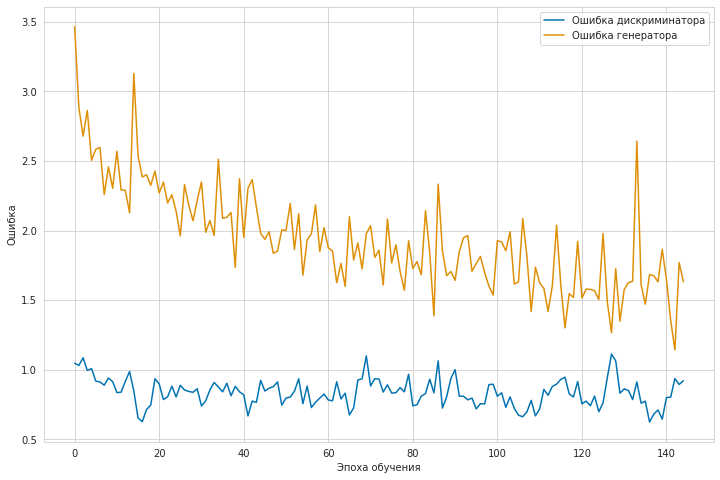

	...epoch 16 47/2500	batch 1/50	D loss: 0.838823	G loss: 1.455644
	...epoch 16 47/2500	batch 17/50	D loss: 0.723984	G loss: 1.421256
	...epoch 16 47/2500	batch 33/50	D loss: 0.623891	G loss: 1.694402
	...epoch 16 47/2500	batch 49/50	D loss: 0.731276	G loss: 1.516342


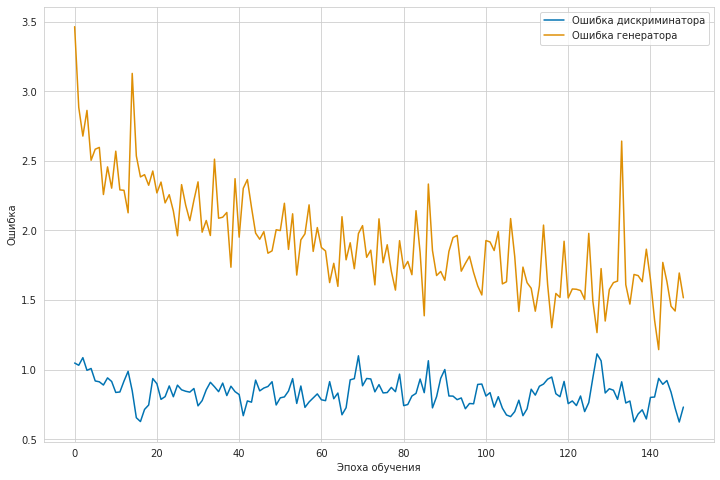

	...epoch 16 48/2500	batch 15/50	D loss: 0.749916	G loss: 1.610389
	...epoch 16 48/2500	batch 31/50	D loss: 0.686791	G loss: 1.536135
	...epoch 16 48/2500	batch 47/50	D loss: 0.758797	G loss: 1.533792


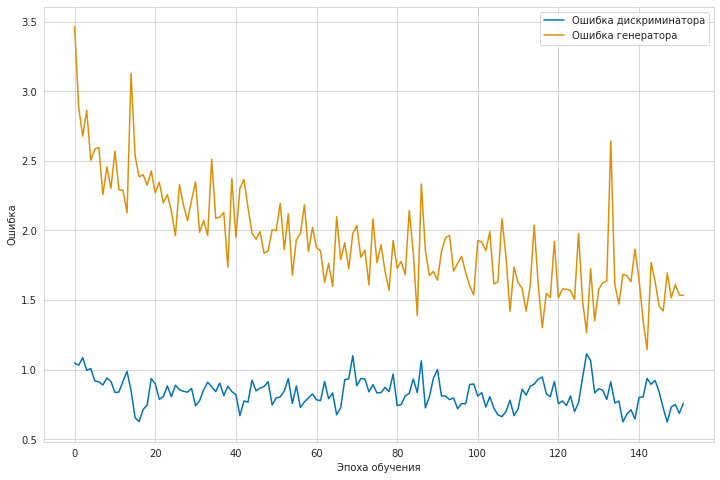

	...epoch 16 49/2500	batch 13/50	D loss: 0.741119	G loss: 1.737422
	...epoch 16 49/2500	batch 29/50	D loss: 0.771470	G loss: 1.338940
	...epoch 16 49/2500	batch 45/50	D loss: 0.732353	G loss: 1.215069


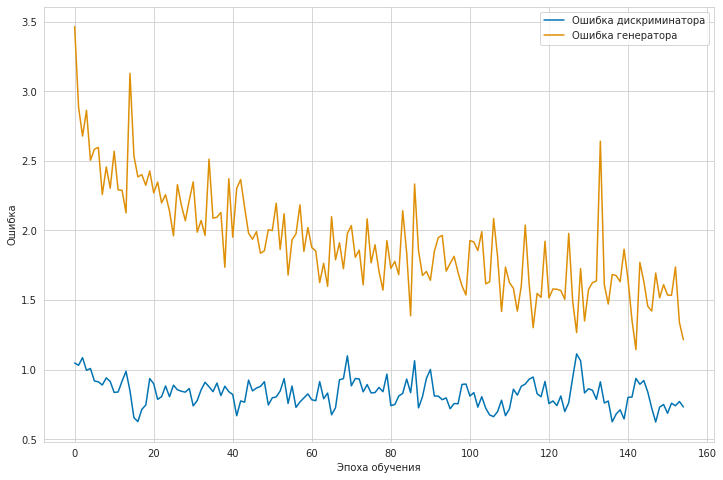

	...epoch 16 50/2500	batch 11/50	D loss: 0.910282	G loss: 1.796287
	...epoch 16 50/2500	batch 27/50	D loss: 0.821001	G loss: 1.433879
	...epoch 16 50/2500	batch 43/50	D loss: 1.074790	G loss: 1.246245


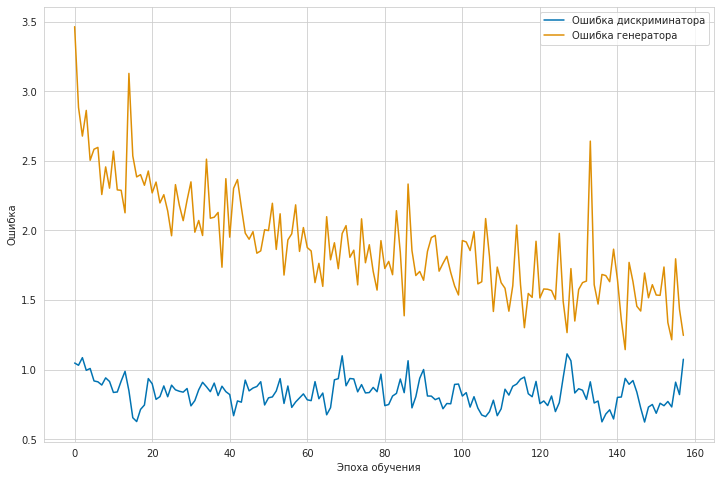

	...epoch 16 51/2500	batch 9/50	D loss: 0.879535	G loss: 1.462341
	...epoch 16 51/2500	batch 25/50	D loss: 0.927112	G loss: 1.794937
	...epoch 16 51/2500	batch 41/50	D loss: 0.678955	G loss: 1.670864


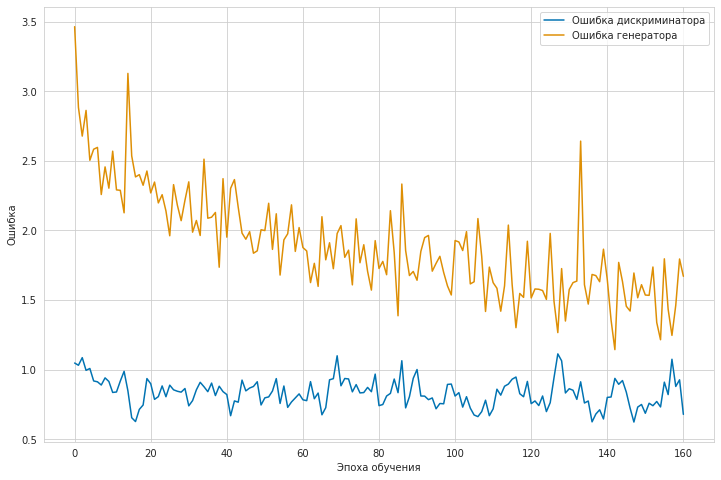

	...epoch 16 52/2500	batch 7/50	D loss: 0.820728	G loss: 1.551761
	...epoch 16 52/2500	batch 23/50	D loss: 0.792474	G loss: 1.462988
	...epoch 16 52/2500	batch 39/50	D loss: 0.658764	G loss: 1.654618


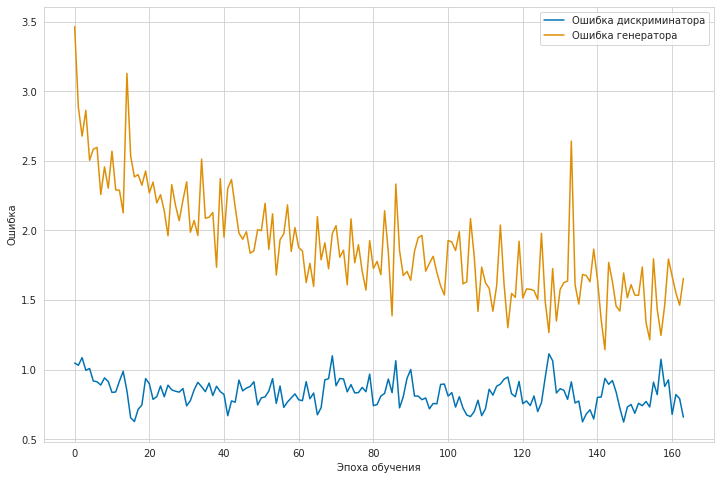

	...epoch 16 53/2500	batch 5/50	D loss: 0.735303	G loss: 1.424245
	...epoch 16 53/2500	batch 21/50	D loss: 0.575974	G loss: 1.564337
	...epoch 16 53/2500	batch 37/50	D loss: 0.515684	G loss: 1.958137


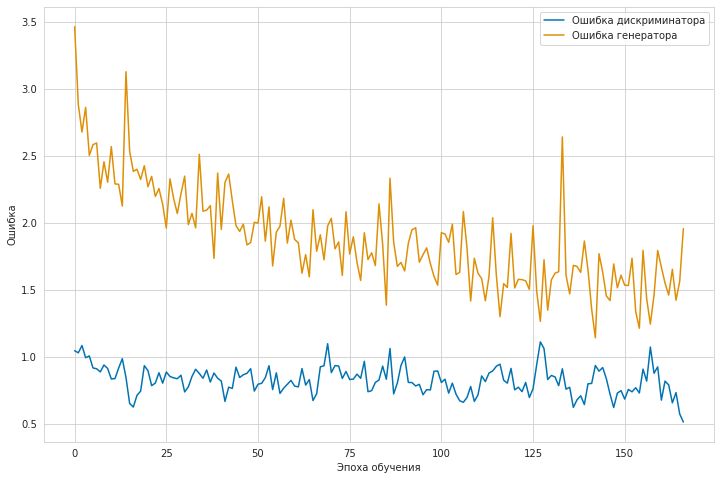

	...epoch 16 54/2500	batch 3/50	D loss: 0.687457	G loss: 1.616211
	...epoch 16 54/2500	batch 19/50	D loss: 0.471098	G loss: 1.684787
	...epoch 16 54/2500	batch 35/50	D loss: 0.705922	G loss: 2.505924


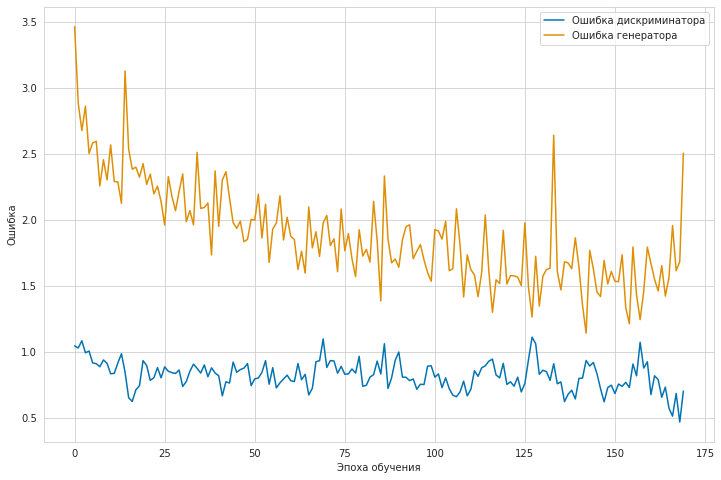

	...epoch 16 55/2500	batch 1/50	D loss: 0.910832	G loss: 1.318735
	...epoch 16 55/2500	batch 17/50	D loss: 1.209169	G loss: 1.318030
	...epoch 16 55/2500	batch 33/50	D loss: 1.011155	G loss: 1.415191
	...epoch 16 55/2500	batch 49/50	D loss: 0.853474	G loss: 1.543613


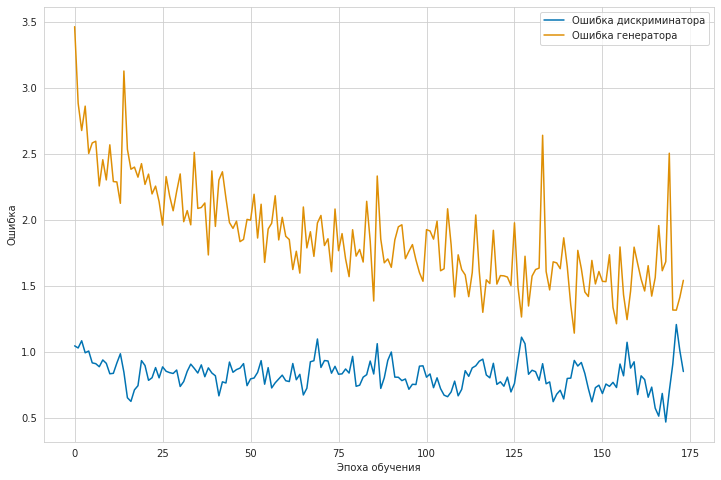

	...epoch 16 56/2500	batch 15/50	D loss: 0.805794	G loss: 1.399285
	...epoch 16 56/2500	batch 31/50	D loss: 0.877863	G loss: 1.840712
	...epoch 16 56/2500	batch 47/50	D loss: 0.871228	G loss: 1.446673


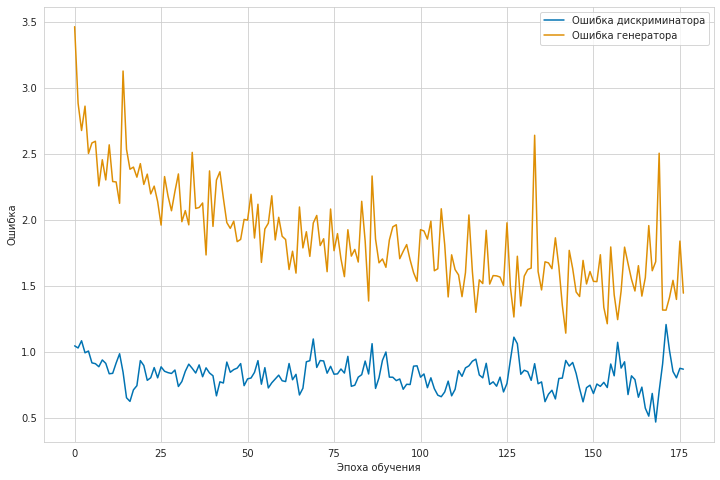

	...epoch 16 57/2500	batch 13/50	D loss: 0.910869	G loss: 1.504811
	...epoch 16 57/2500	batch 29/50	D loss: 0.744774	G loss: 1.316096
	...epoch 16 57/2500	batch 45/50	D loss: 0.671285	G loss: 2.485271


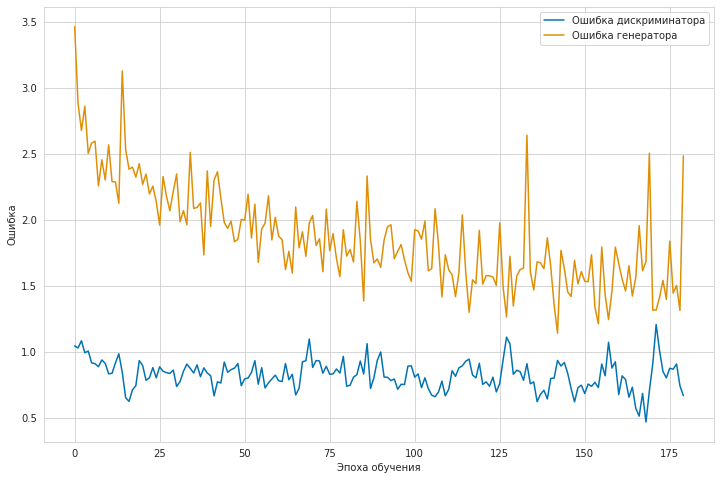

	...epoch 16 58/2500	batch 11/50	D loss: 0.551482	G loss: 1.655927
	...epoch 16 58/2500	batch 27/50	D loss: 0.699844	G loss: 1.374896
	...epoch 16 58/2500	batch 43/50	D loss: 0.593383	G loss: 1.781707


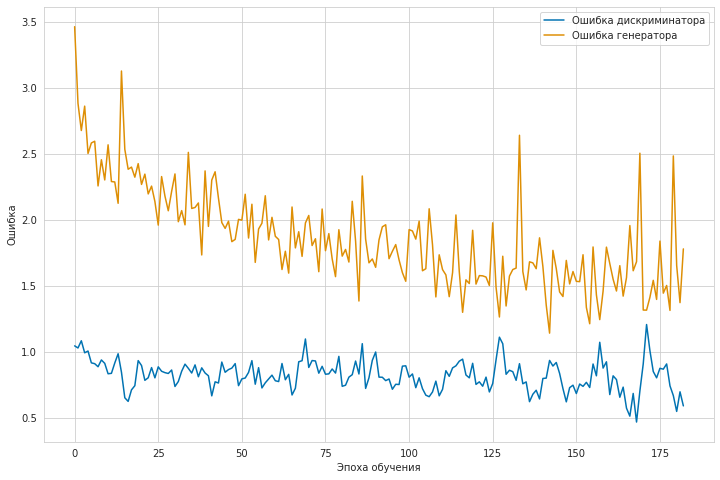

	...epoch 16 59/2500	batch 9/50	D loss: 0.706190	G loss: 1.392354
	...epoch 16 59/2500	batch 25/50	D loss: 0.698261	G loss: 1.405514
	...epoch 16 59/2500	batch 41/50	D loss: 0.660947	G loss: 1.684880


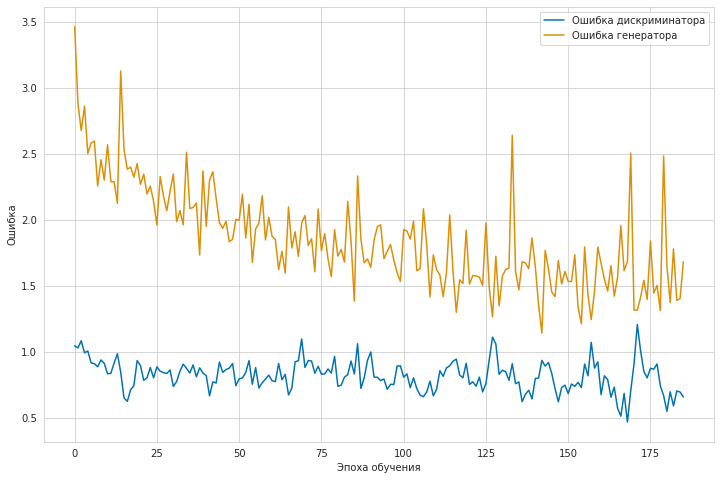

	...epoch 16 60/2500	batch 7/50	D loss: 0.765863	G loss: 1.326628
	...epoch 16 60/2500	batch 23/50	D loss: 1.014746	G loss: 1.602019
	...epoch 16 60/2500	batch 39/50	D loss: 0.960908	G loss: 1.291368


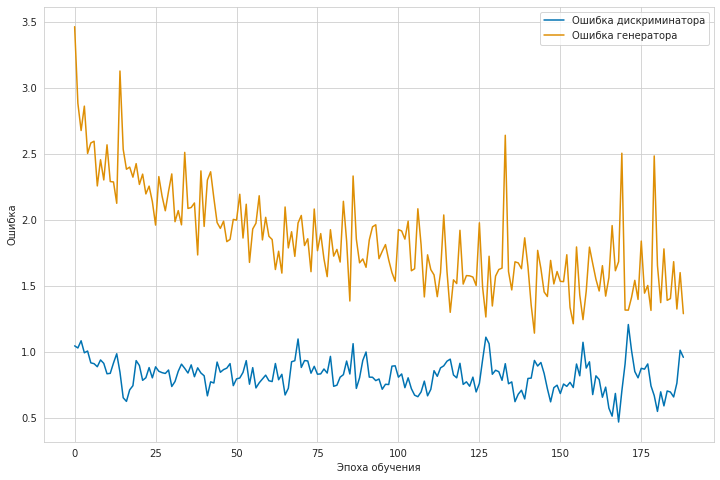

	...epoch 16 61/2500	batch 5/50	D loss: 0.753728	G loss: 1.632155
	...epoch 16 61/2500	batch 21/50	D loss: 0.800630	G loss: 1.435365
	...epoch 16 61/2500	batch 37/50	D loss: 0.798936	G loss: 1.469200


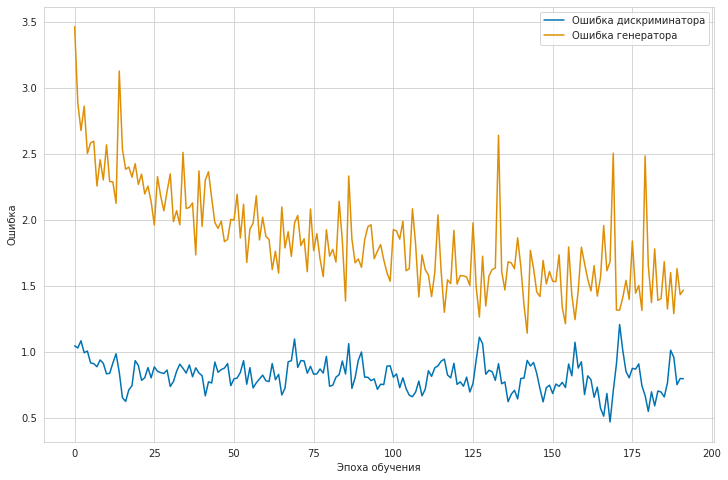

	...epoch 16 62/2500	batch 3/50	D loss: 0.587765	G loss: 1.484636
	...epoch 16 62/2500	batch 19/50	D loss: 0.848917	G loss: 1.375527
	...epoch 16 62/2500	batch 35/50	D loss: 0.658920	G loss: 1.812271


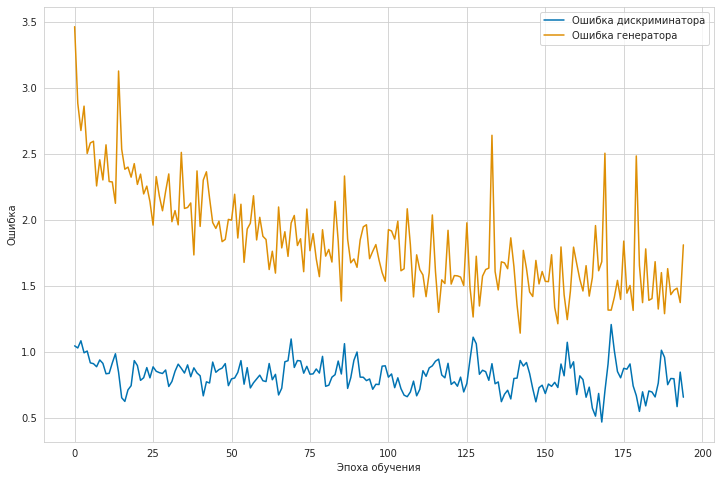

	...epoch 16 63/2500	batch 1/50	D loss: 0.745178	G loss: 1.720789
	...epoch 16 63/2500	batch 17/50	D loss: 0.809757	G loss: 1.409672
	...epoch 16 63/2500	batch 33/50	D loss: 0.732956	G loss: 1.547880
	...epoch 16 63/2500	batch 49/50	D loss: 0.656481	G loss: 1.510005


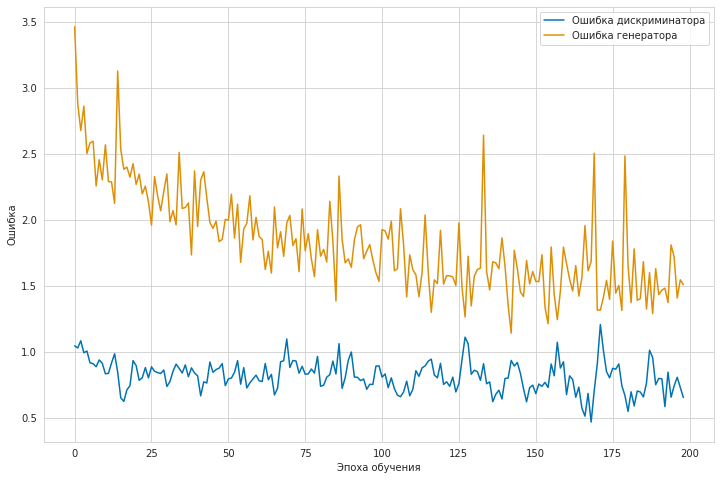

	...epoch 16 64/2500	batch 15/50	D loss: 0.668070	G loss: 1.600001
	...epoch 16 64/2500	batch 31/50	D loss: 0.667844	G loss: 1.700284
	...epoch 16 64/2500	batch 47/50	D loss: 0.976802	G loss: 1.396538


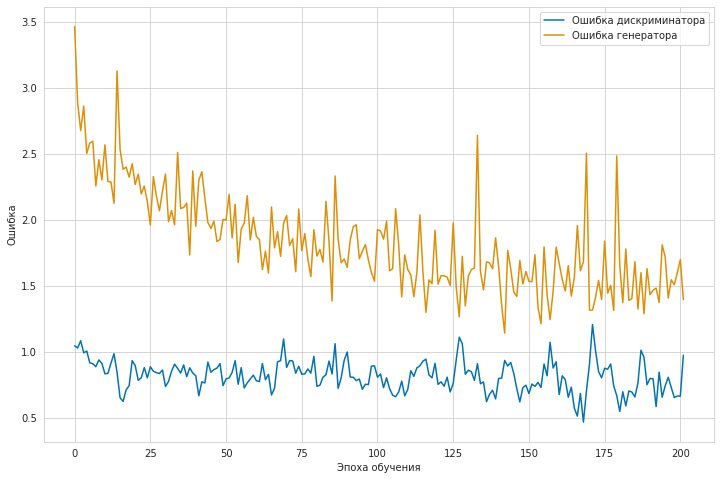

	...epoch 16 65/2500	batch 13/50	D loss: 1.186332	G loss: 1.721740
	...epoch 16 65/2500	batch 29/50	D loss: 0.818777	G loss: 1.325427
	...epoch 16 65/2500	batch 45/50	D loss: 0.725739	G loss: 1.472436


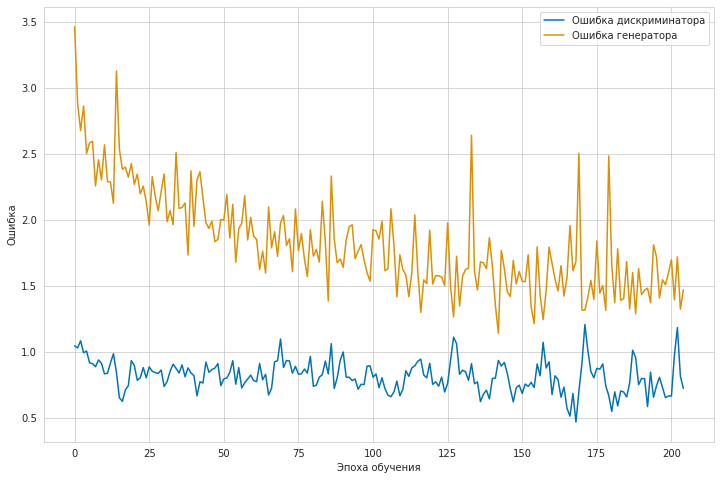

	...epoch 16 66/2500	batch 11/50	D loss: 0.765056	G loss: 1.383713
	...epoch 16 66/2500	batch 27/50	D loss: 0.642145	G loss: 1.523923
	...epoch 16 66/2500	batch 43/50	D loss: 0.885297	G loss: 1.246692


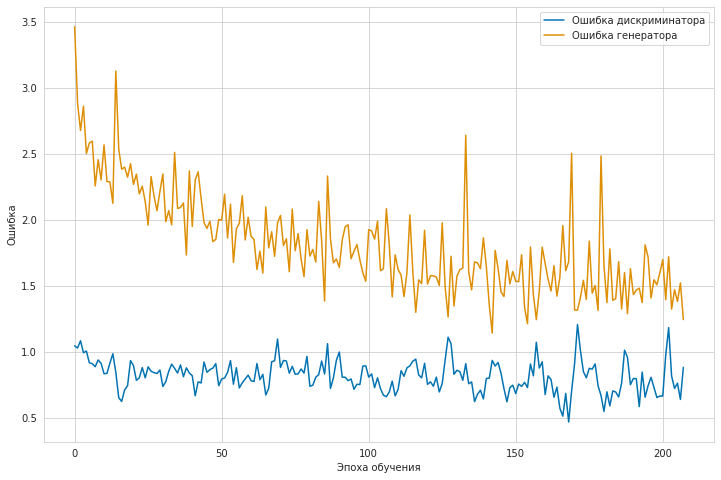

	...epoch 16 67/2500	batch 9/50	D loss: 0.754795	G loss: 1.305649
	...epoch 16 67/2500	batch 25/50	D loss: 0.683348	G loss: 1.976210
	...epoch 16 67/2500	batch 41/50	D loss: 0.668535	G loss: 1.305559


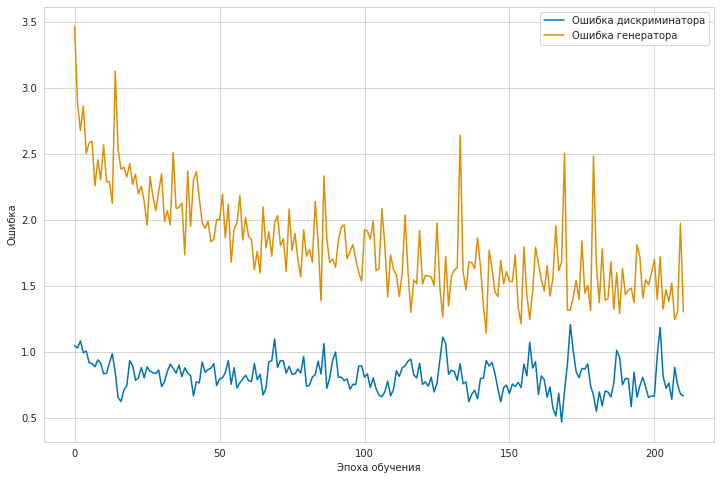

	...epoch 16 68/2500	batch 7/50	D loss: 0.745916	G loss: 1.186139
	...epoch 16 68/2500	batch 23/50	D loss: 0.768210	G loss: 1.566787
	...epoch 16 68/2500	batch 39/50	D loss: 0.548213	G loss: 1.421695


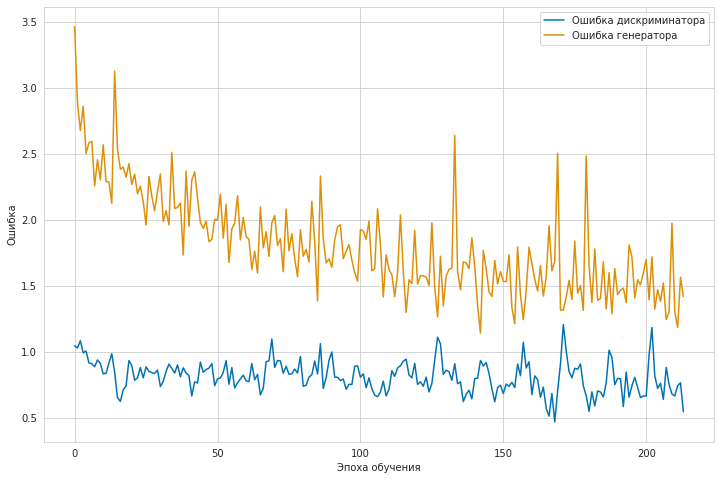

	...epoch 16 69/2500	batch 5/50	D loss: 0.853772	G loss: 1.215764
	...epoch 16 69/2500	batch 21/50	D loss: 0.599448	G loss: 1.572060
	...epoch 16 69/2500	batch 37/50	D loss: 0.889737	G loss: 1.651294


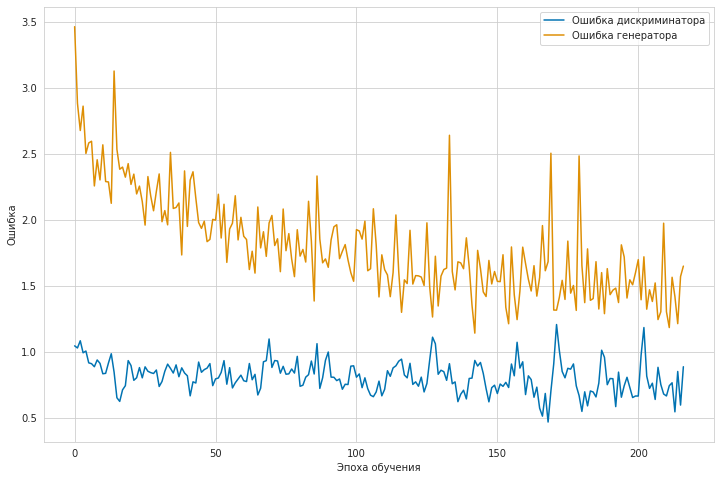

	...epoch 16 70/2500	batch 3/50	D loss: 1.055954	G loss: 1.178096
	...epoch 16 70/2500	batch 19/50	D loss: 0.897517	G loss: 1.886408
	...epoch 16 70/2500	batch 35/50	D loss: 0.830879	G loss: 1.462631


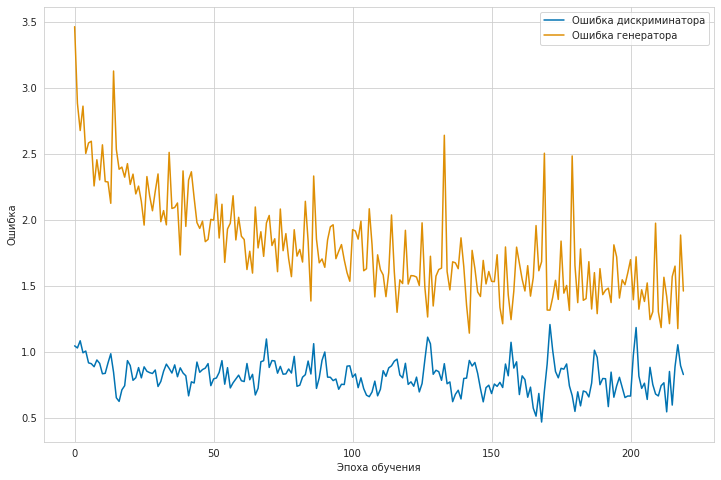

	...epoch 16 71/2500	batch 1/50	D loss: 0.810009	G loss: 1.304090
	...epoch 16 71/2500	batch 17/50	D loss: 0.748529	G loss: 1.794276
	...epoch 16 71/2500	batch 33/50	D loss: 0.754806	G loss: 1.437174
	...epoch 16 71/2500	batch 49/50	D loss: 0.602533	G loss: 1.465774


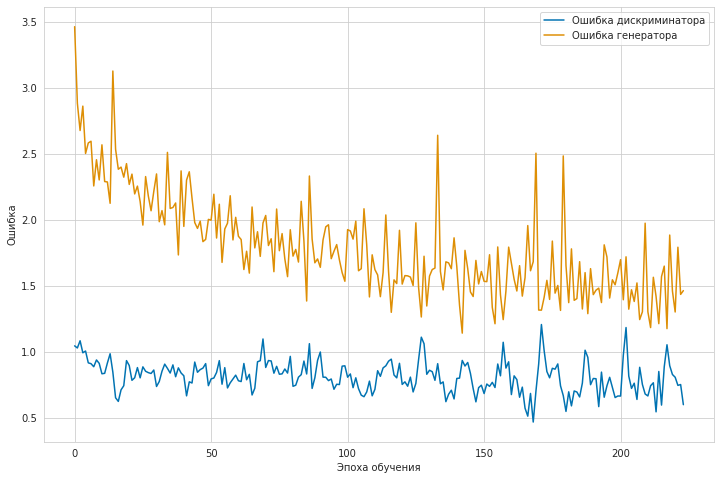

	...epoch 16 72/2500	batch 15/50	D loss: 0.679915	G loss: 2.018109
	...epoch 16 72/2500	batch 31/50	D loss: 0.847650	G loss: 1.343803
	...epoch 16 72/2500	batch 47/50	D loss: 0.716578	G loss: 1.073888


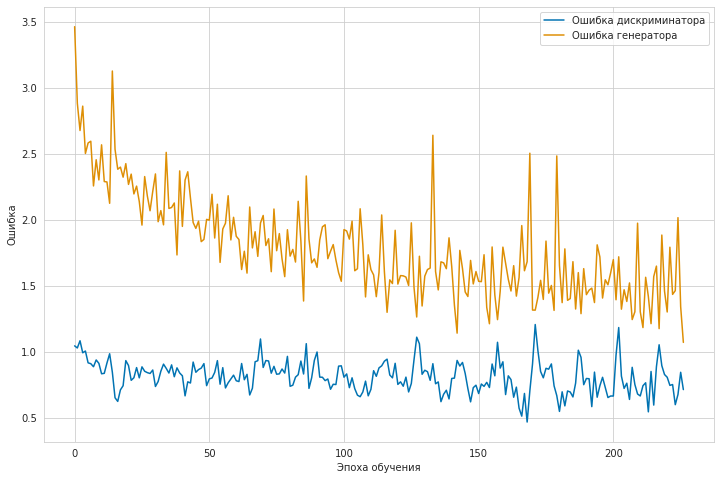

	...epoch 16 73/2500	batch 13/50	D loss: 0.595806	G loss: 1.550910
	...epoch 16 73/2500	batch 29/50	D loss: 0.513188	G loss: 1.656416
	...epoch 16 73/2500	batch 45/50	D loss: 0.519202	G loss: 1.234945


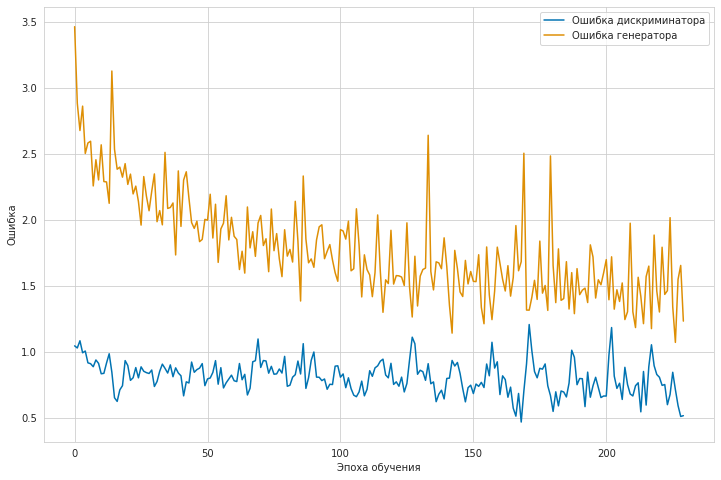

	...epoch 16 74/2500	batch 11/50	D loss: 0.472973	G loss: 1.765696
	...epoch 16 74/2500	batch 27/50	D loss: 0.608294	G loss: 1.331137
	...epoch 16 74/2500	batch 43/50	D loss: 0.502682	G loss: 1.514315


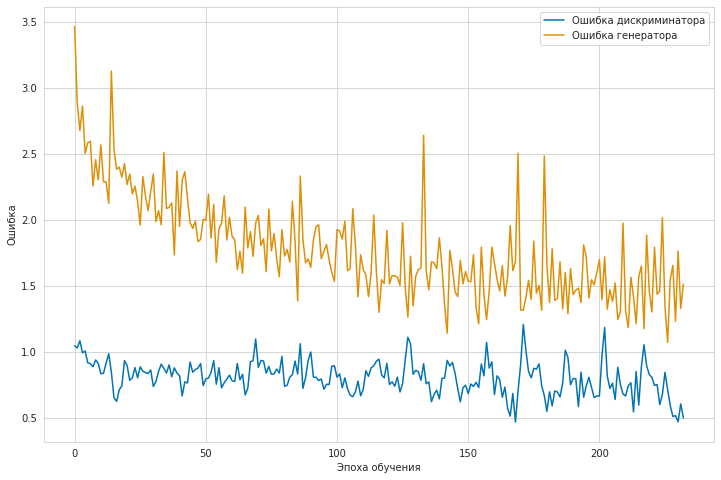

	...epoch 16 75/2500	batch 9/50	D loss: 0.589966	G loss: 1.330171
	...epoch 16 75/2500	batch 25/50	D loss: 0.652049	G loss: 1.386086
	...epoch 16 75/2500	batch 41/50	D loss: 0.424041	G loss: 1.398731


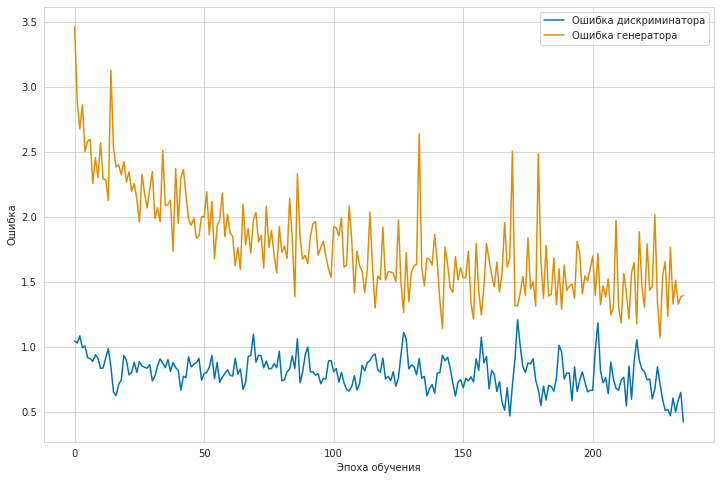

	...epoch 16 76/2500	batch 7/50	D loss: 0.392940	G loss: 1.554773
	...epoch 16 76/2500	batch 23/50	D loss: 0.410082	G loss: 1.557177
	...epoch 16 76/2500	batch 39/50	D loss: 0.476485	G loss: 1.186713


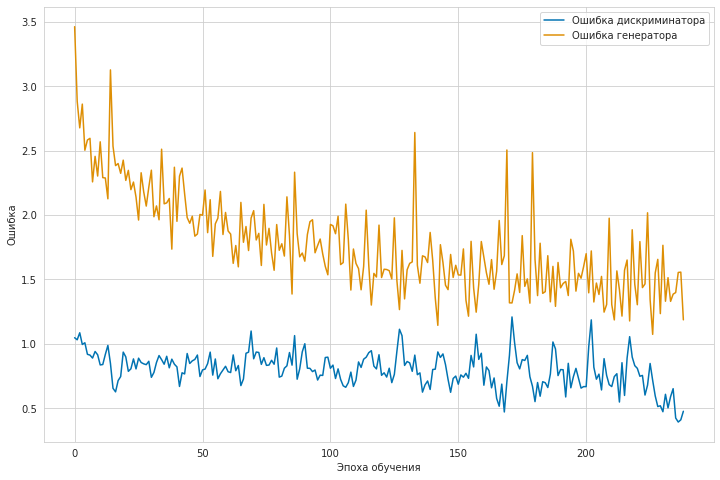

	...epoch 16 77/2500	batch 5/50	D loss: 0.679348	G loss: 1.291105
	...epoch 16 77/2500	batch 21/50	D loss: 1.062987	G loss: 1.044282
	...epoch 16 77/2500	batch 37/50	D loss: 0.852122	G loss: 1.053395


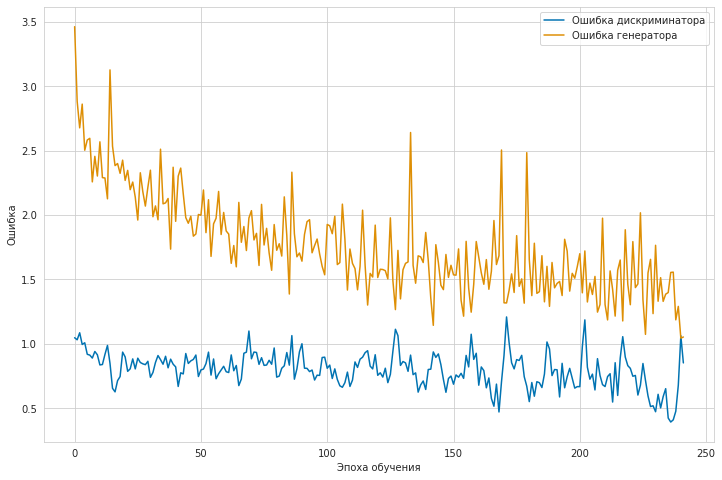

	...epoch 16 78/2500	batch 3/50	D loss: 1.278031	G loss: 1.383723
	...epoch 16 78/2500	batch 19/50	D loss: 1.219893	G loss: 1.421697
	...epoch 16 78/2500	batch 35/50	D loss: 1.102367	G loss: 1.509637


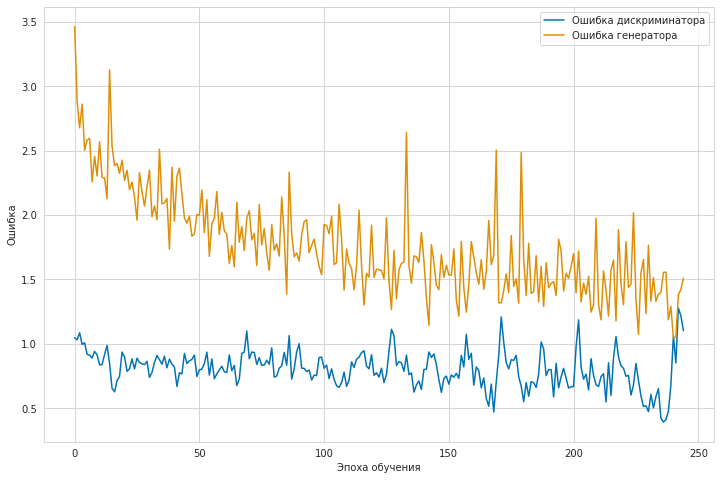

	...epoch 16 79/2500	batch 1/50	D loss: 0.853088	G loss: 1.480842
	...epoch 16 79/2500	batch 17/50	D loss: 0.936495	G loss: 1.583566
	...epoch 16 79/2500	batch 33/50	D loss: 0.717091	G loss: 1.276526
	...epoch 16 79/2500	batch 49/50	D loss: 0.797742	G loss: 1.407964


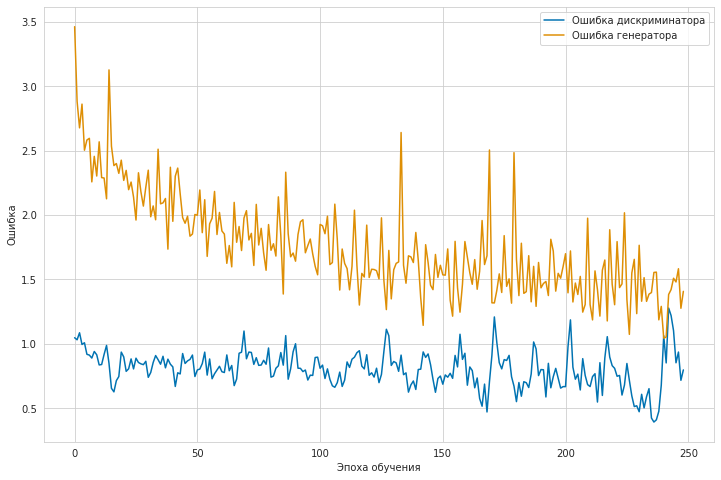

	...epoch 16 80/2500	batch 15/50	D loss: 0.847120	G loss: 1.422177
	...epoch 16 80/2500	batch 31/50	D loss: 0.924727	G loss: 1.464294
	...epoch 16 80/2500	batch 47/50	D loss: 1.028215	G loss: 1.154983


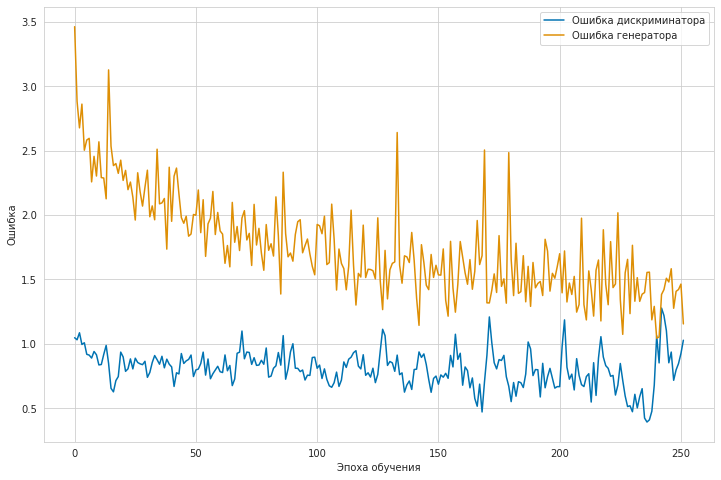

	...epoch 16 81/2500	batch 13/50	D loss: 0.865776	G loss: 1.390607
	...epoch 16 81/2500	batch 29/50	D loss: 0.681532	G loss: 1.258295
	...epoch 16 81/2500	batch 45/50	D loss: 0.813742	G loss: 1.539856


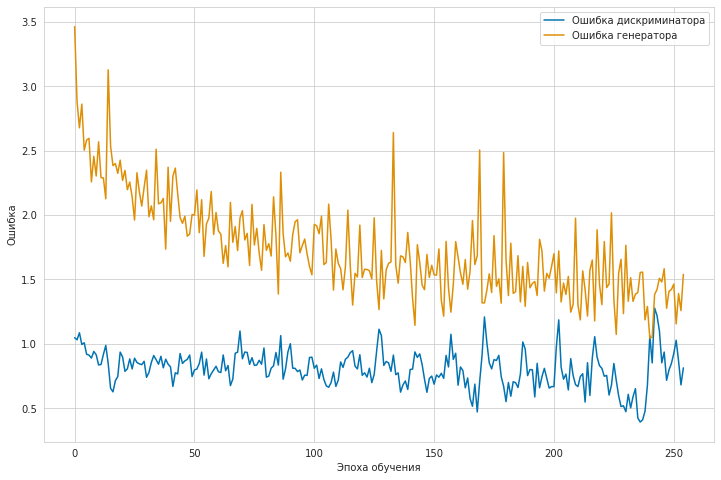

	...epoch 16 82/2500	batch 11/50	D loss: 0.637156	G loss: 1.289911
	...epoch 16 82/2500	batch 27/50	D loss: 0.800713	G loss: 1.439218
	...epoch 16 82/2500	batch 43/50	D loss: 0.642027	G loss: 1.544407


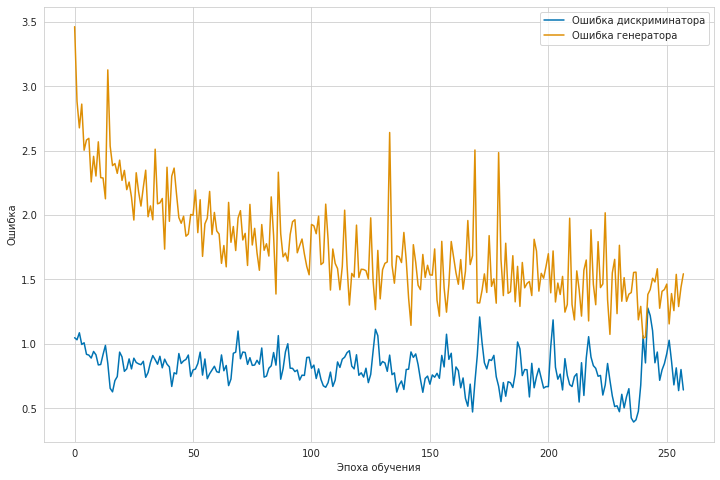

	...epoch 16 83/2500	batch 9/50	D loss: 0.681900	G loss: 1.171988
	...epoch 16 83/2500	batch 25/50	D loss: 0.804476	G loss: 1.165580
	...epoch 16 83/2500	batch 41/50	D loss: 1.052462	G loss: 1.385357


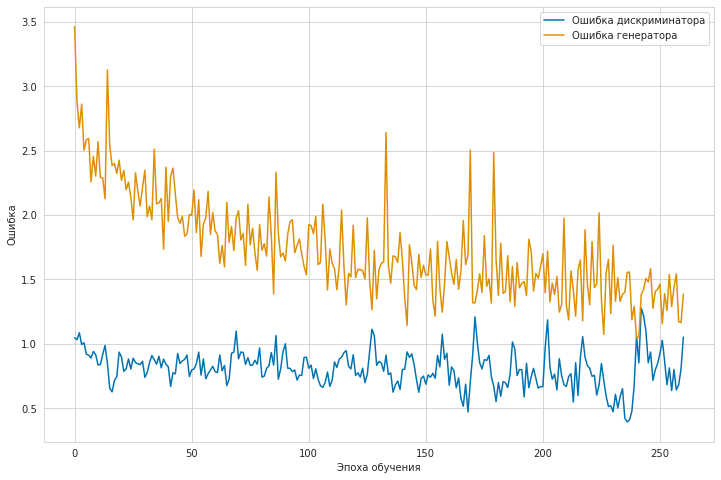

	...epoch 16 84/2500	batch 7/50	D loss: 0.838360	G loss: 1.242847
	...epoch 16 84/2500	batch 23/50	D loss: 0.895660	G loss: 1.111944
	...epoch 16 84/2500	batch 39/50	D loss: 0.556458	G loss: 1.407225


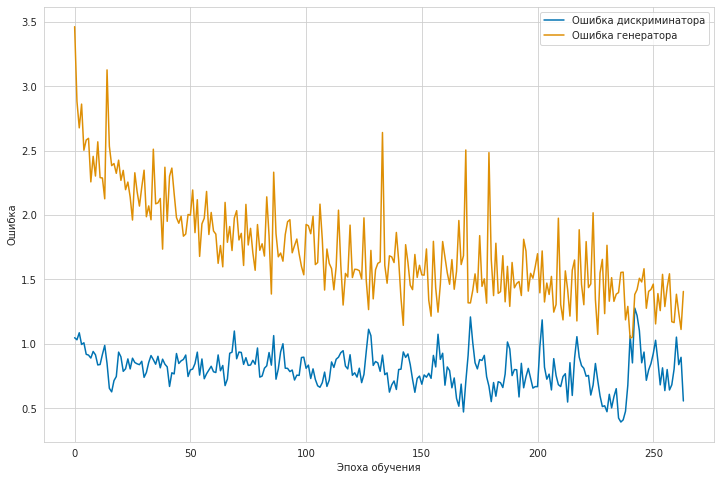

	...epoch 16 85/2500	batch 5/50	D loss: 0.562118	G loss: 1.398289
	...epoch 16 85/2500	batch 21/50	D loss: 0.774625	G loss: 1.340525
	...epoch 16 85/2500	batch 37/50	D loss: 0.628986	G loss: 1.462591


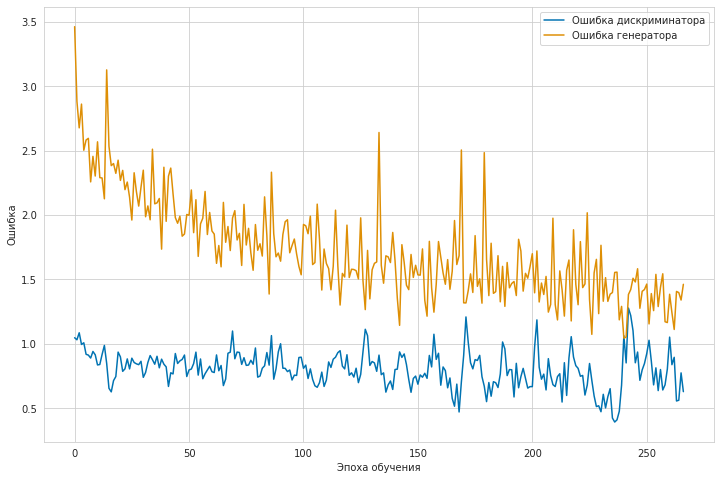

	...epoch 16 86/2500	batch 3/50	D loss: 0.786131	G loss: 1.558796
	...epoch 16 86/2500	batch 19/50	D loss: 0.745624	G loss: 1.332413
	...epoch 16 86/2500	batch 35/50	D loss: 1.003710	G loss: 1.033962


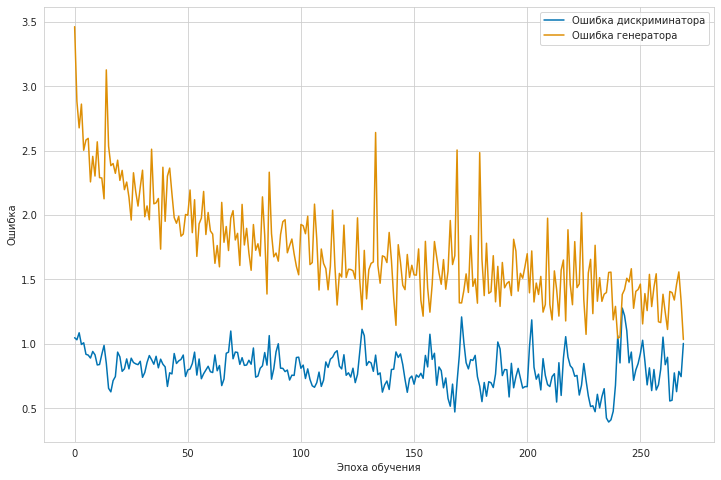

	...epoch 16 87/2500	batch 1/50	D loss: 0.652417	G loss: 1.418486
	...epoch 16 87/2500	batch 17/50	D loss: 0.514814	G loss: 1.288149
	...epoch 16 87/2500	batch 33/50	D loss: 0.458423	G loss: 2.533524
	...epoch 16 87/2500	batch 49/50	D loss: 0.578684	G loss: 1.373907


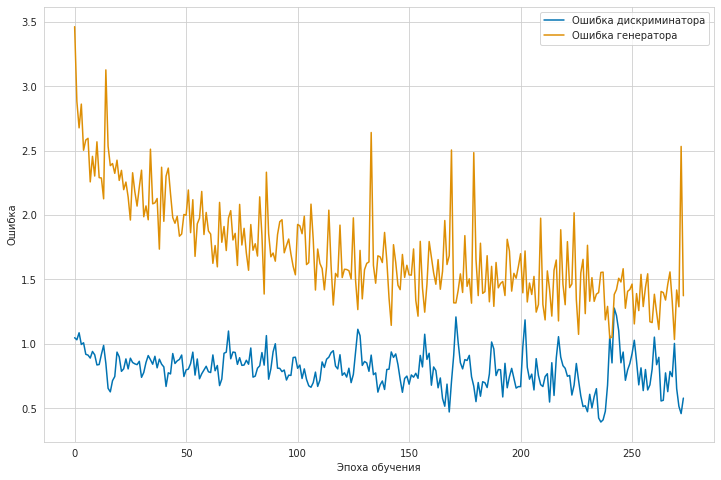

	...epoch 16 88/2500	batch 15/50	D loss: 0.689226	G loss: 1.436336
	...epoch 16 88/2500	batch 31/50	D loss: 1.110021	G loss: 2.307280
	...epoch 16 88/2500	batch 47/50	D loss: 0.812220	G loss: 1.511557


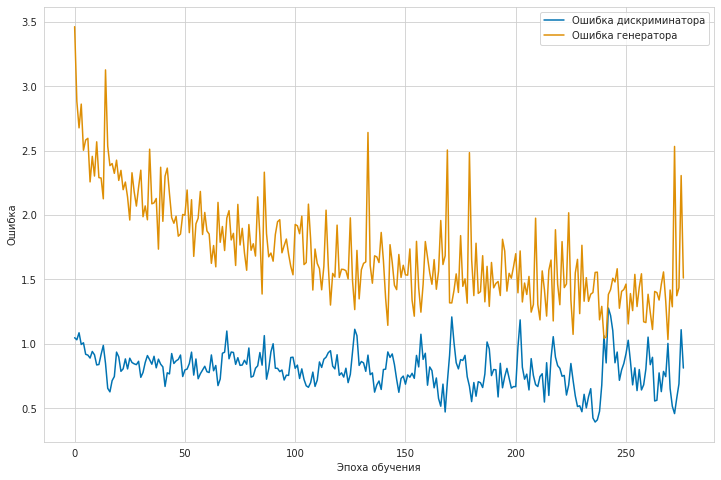

	...epoch 16 89/2500	batch 13/50	D loss: 0.957229	G loss: 1.254723
	...epoch 16 89/2500	batch 29/50	D loss: 0.747981	G loss: 1.367035
	...epoch 16 89/2500	batch 45/50	D loss: 0.747254	G loss: 1.382769


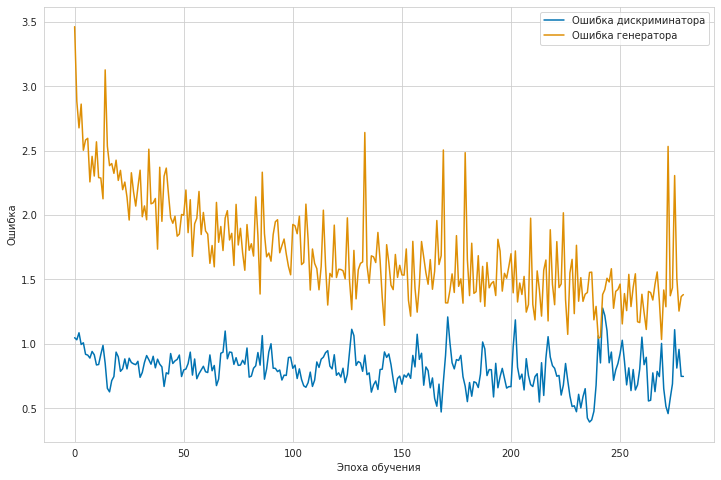

	...epoch 16 90/2500	batch 11/50	D loss: 0.621037	G loss: 1.457583
	...epoch 16 90/2500	batch 27/50	D loss: 0.556985	G loss: 1.299353
	...epoch 16 90/2500	batch 43/50	D loss: 0.539604	G loss: 1.574320


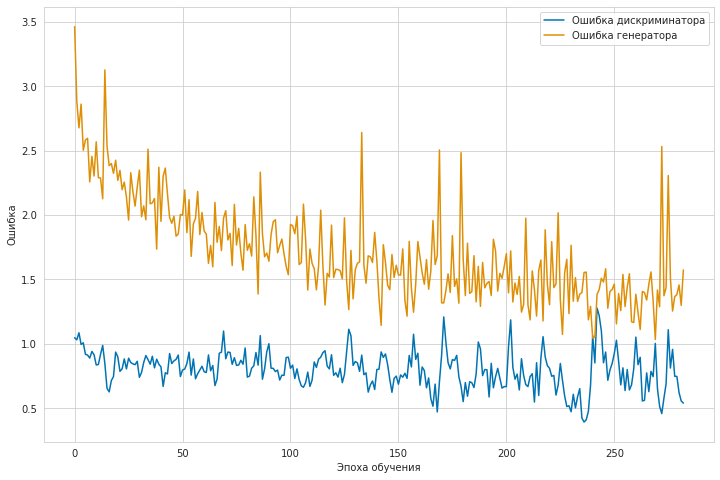

	...epoch 16 91/2500	batch 9/50	D loss: 0.469432	G loss: 1.627329
	...epoch 16 91/2500	batch 25/50	D loss: 0.844954	G loss: 1.142941
	...epoch 16 91/2500	batch 41/50	D loss: 0.663706	G loss: 1.090847


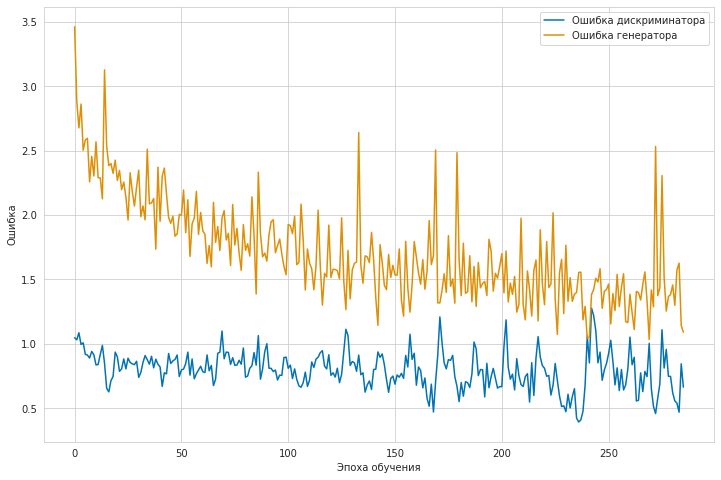

	...epoch 16 92/2500	batch 7/50	D loss: 0.913463	G loss: 1.658013
	...epoch 16 92/2500	batch 23/50	D loss: 0.775413	G loss: 1.103179
	...epoch 16 92/2500	batch 39/50	D loss: 0.933527	G loss: 1.191943


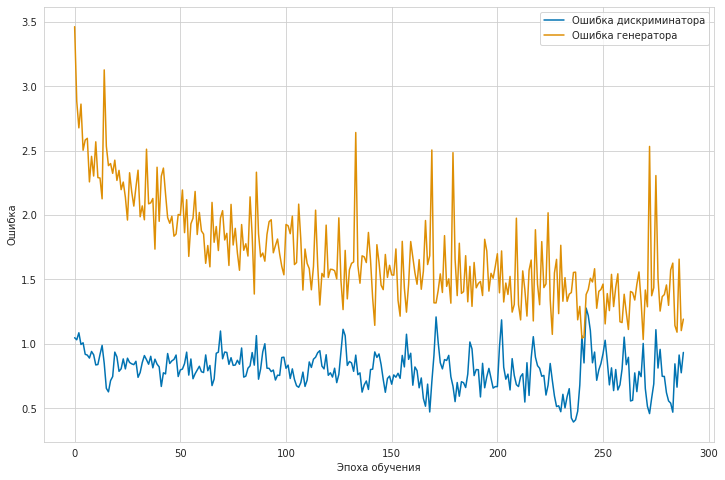

	...epoch 16 93/2500	batch 5/50	D loss: 0.702399	G loss: 1.106539
	...epoch 16 93/2500	batch 21/50	D loss: 0.757969	G loss: 1.513845
	...epoch 16 93/2500	batch 37/50	D loss: 0.992376	G loss: 1.436793


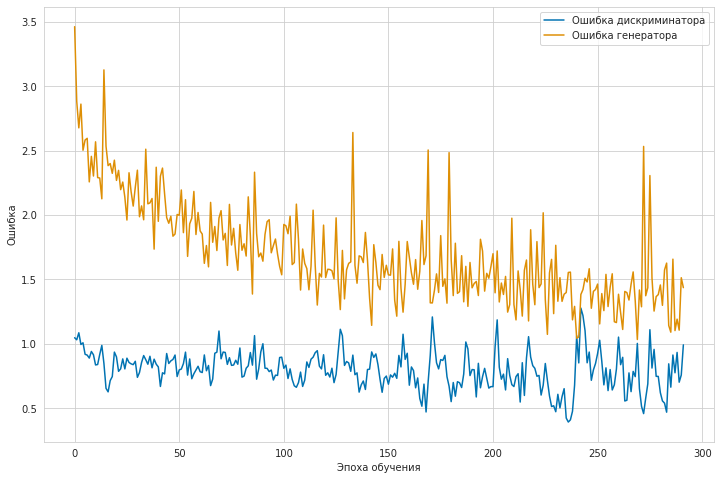

	...epoch 16 94/2500	batch 3/50	D loss: 0.931189	G loss: 1.719092
	...epoch 16 94/2500	batch 19/50	D loss: 0.865291	G loss: 1.167017
	...epoch 16 94/2500	batch 35/50	D loss: 0.805974	G loss: 1.119092


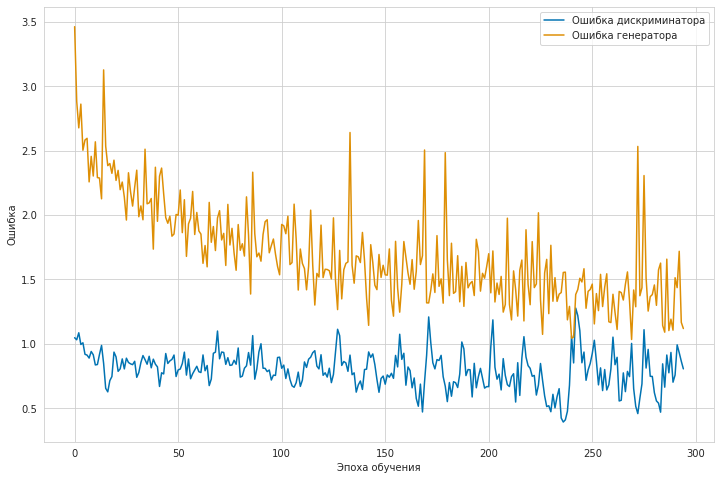

	...epoch 16 95/2500	batch 1/50	D loss: 0.685862	G loss: 1.173421
	...epoch 16 95/2500	batch 17/50	D loss: 0.849190	G loss: 1.424026
	...epoch 16 95/2500	batch 33/50	D loss: 0.781796	G loss: 1.384945
	...epoch 16 95/2500	batch 49/50	D loss: 0.559159	G loss: 1.862152


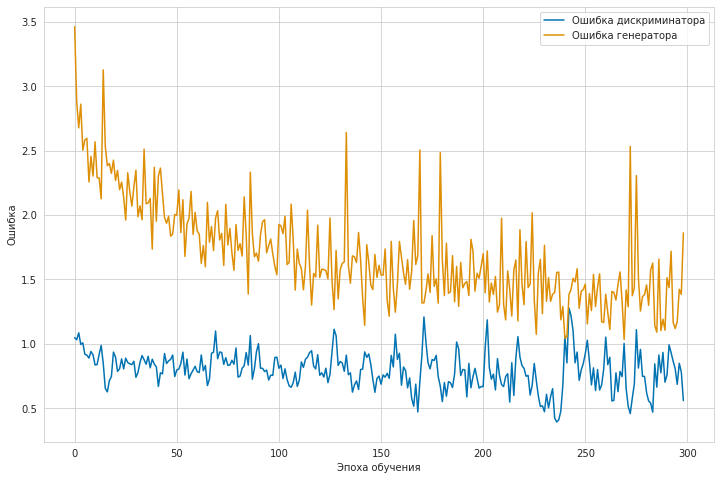

	...epoch 16 96/2500	batch 15/50	D loss: 0.981520	G loss: 1.020157
	...epoch 16 96/2500	batch 31/50	D loss: 0.788496	G loss: 1.649093
	...epoch 16 96/2500	batch 47/50	D loss: 0.536169	G loss: 1.486789


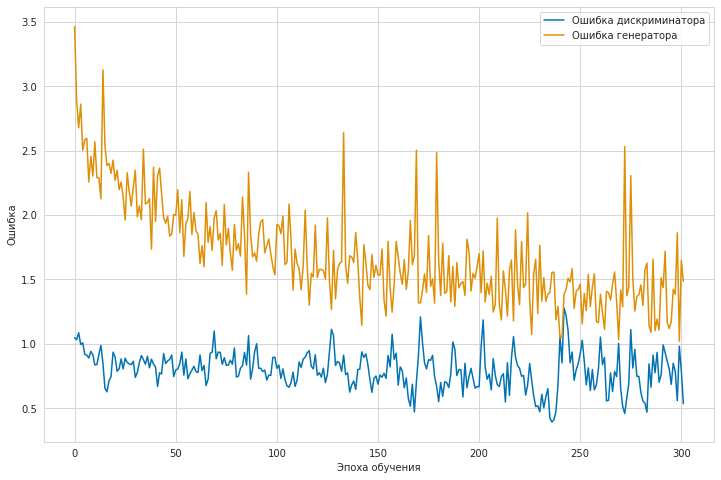

	...epoch 16 97/2500	batch 13/50	D loss: 0.705988	G loss: 1.131906
	...epoch 16 97/2500	batch 29/50	D loss: 0.769805	G loss: 1.203676
	...epoch 16 97/2500	batch 45/50	D loss: 0.685542	G loss: 1.262068


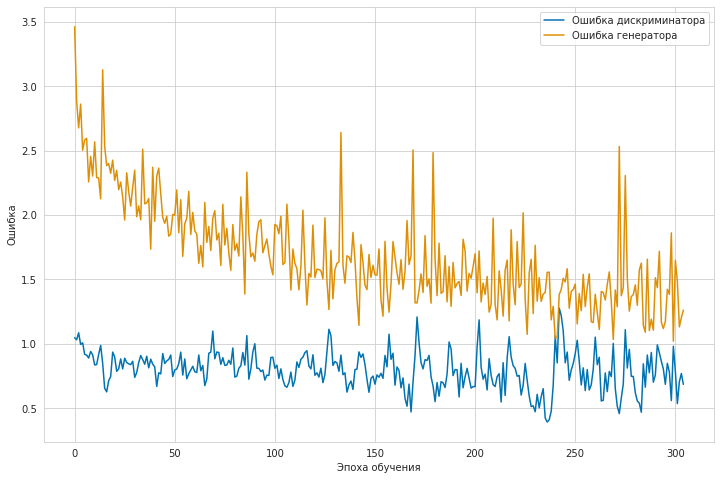

	...epoch 16 98/2500	batch 11/50	D loss: 0.707668	G loss: 1.062755
	...epoch 16 98/2500	batch 27/50	D loss: 0.481998	G loss: 1.154491
	...epoch 16 98/2500	batch 43/50	D loss: 0.499516	G loss: 1.473011


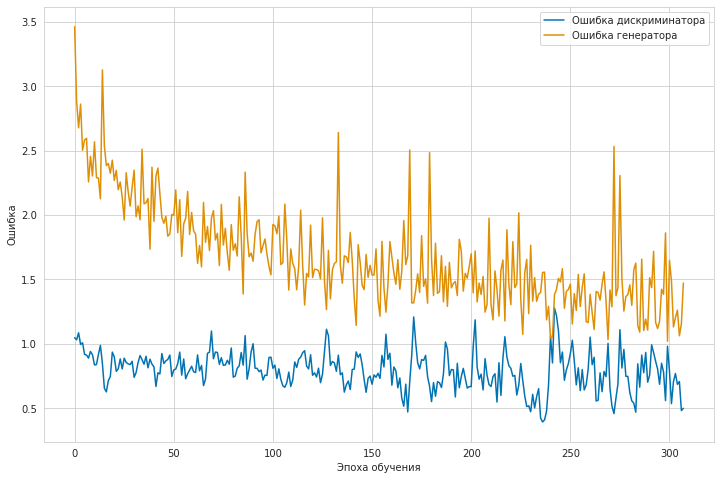

	...epoch 16 99/2500	batch 9/50	D loss: 0.620182	G loss: 1.157627
	...epoch 16 99/2500	batch 25/50	D loss: 0.395481	G loss: 1.651306
	...epoch 16 99/2500	batch 41/50	D loss: 0.603489	G loss: 1.206650


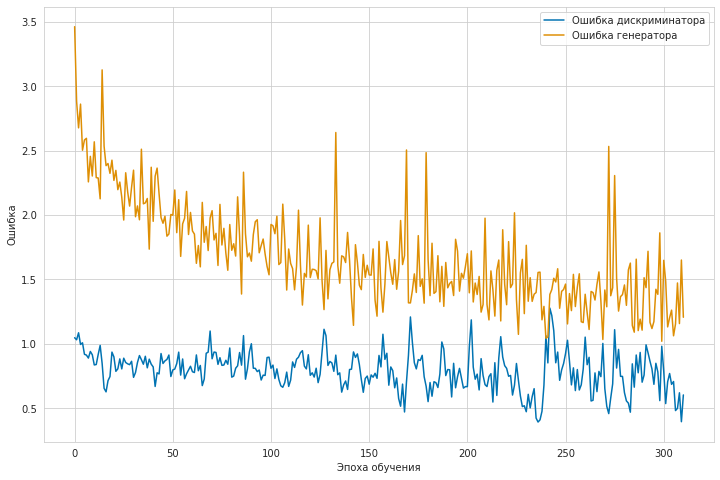

	...epoch 16 100/2500	batch 7/50	D loss: 0.838697	G loss: 1.226879
	...epoch 16 100/2500	batch 23/50	D loss: 1.032691	G loss: 1.492043
	...epoch 16 100/2500	batch 39/50	D loss: 0.843055	G loss: 1.065411


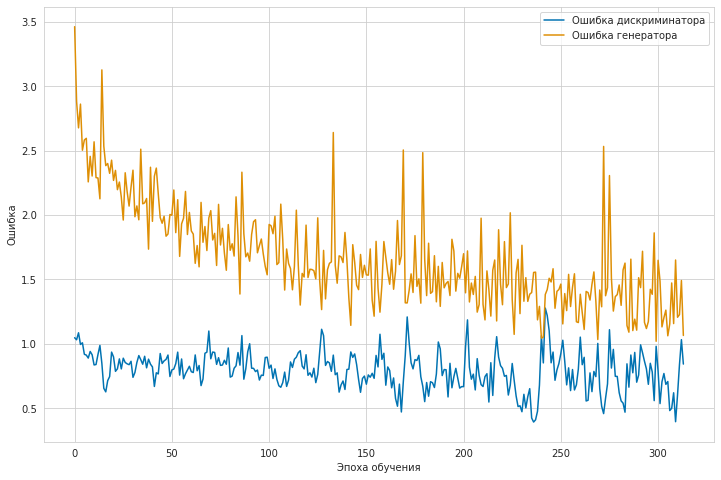

	...epoch 16 101/2500	batch 5/50	D loss: 0.856644	G loss: 1.011232
	...epoch 16 101/2500	batch 21/50	D loss: 0.643750	G loss: 1.667536
	...epoch 16 101/2500	batch 37/50	D loss: 0.738344	G loss: 1.123672


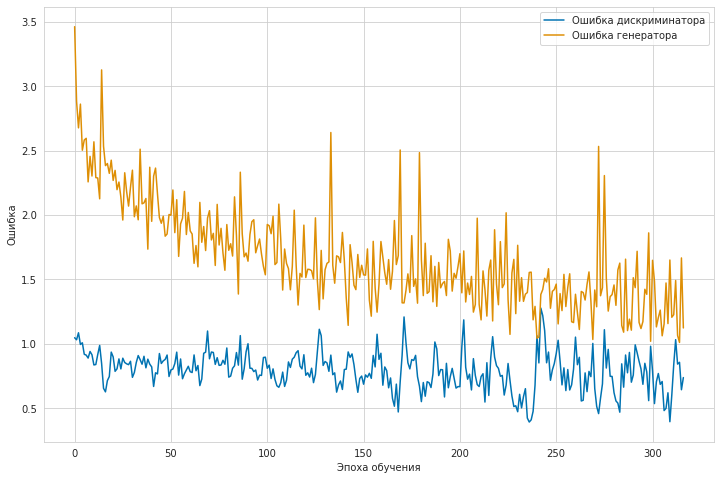

	...epoch 16 102/2500	batch 3/50	D loss: 0.555087	G loss: 1.717318
	...epoch 16 102/2500	batch 19/50	D loss: 0.417168	G loss: 1.375577
	...epoch 16 102/2500	batch 35/50	D loss: 0.570931	G loss: 1.175412


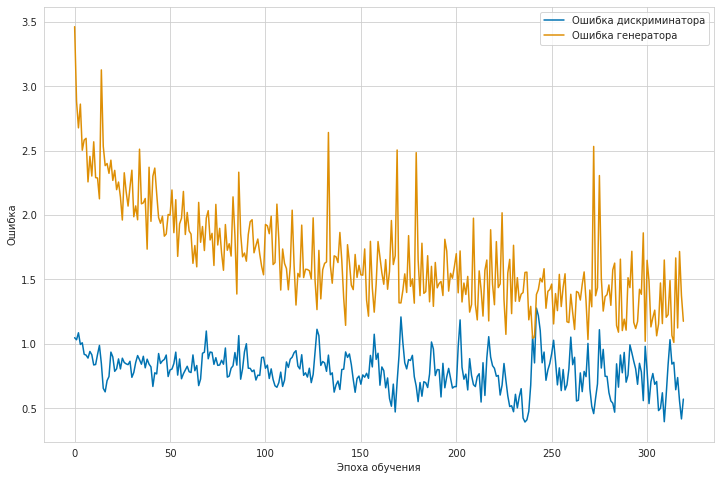

	...epoch 16 103/2500	batch 1/50	D loss: 0.557458	G loss: 1.594284
	...epoch 16 103/2500	batch 17/50	D loss: 0.869042	G loss: 1.089701
	...epoch 16 103/2500	batch 33/50	D loss: 1.059168	G loss: 0.903025
	...epoch 16 103/2500	batch 49/50	D loss: 0.901675	G loss: 1.059997


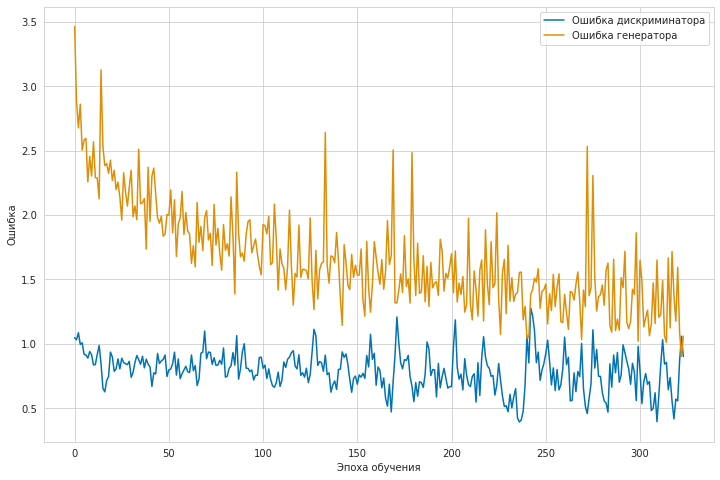

	...epoch 16 104/2500	batch 15/50	D loss: 0.651160	G loss: 1.130436
	...epoch 16 104/2500	batch 31/50	D loss: 0.563210	G loss: 1.278429
	...epoch 16 104/2500	batch 47/50	D loss: 0.685049	G loss: 1.392653


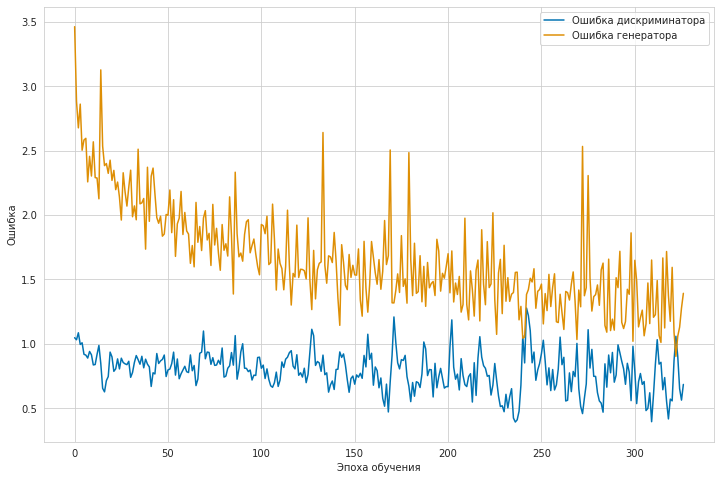

	...epoch 16 105/2500	batch 13/50	D loss: 0.855868	G loss: 1.218905
	...epoch 16 105/2500	batch 29/50	D loss: 0.574448	G loss: 1.441991
	...epoch 16 105/2500	batch 45/50	D loss: 0.856571	G loss: 1.097364


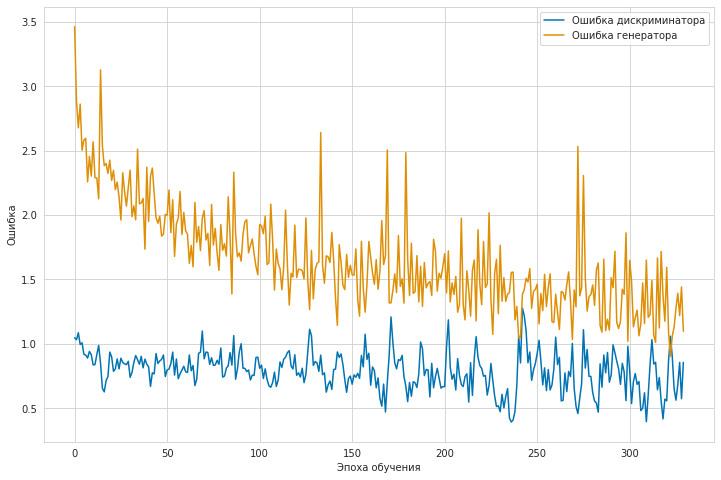

	...epoch 16 106/2500	batch 11/50	D loss: 0.429568	G loss: 1.388670
	...epoch 16 106/2500	batch 27/50	D loss: 0.601495	G loss: 1.060221
	...epoch 16 106/2500	batch 43/50	D loss: 0.510670	G loss: 1.447842


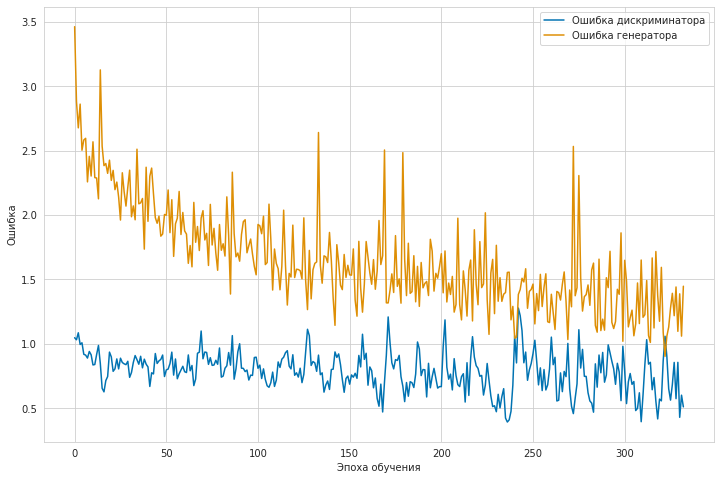

	...epoch 16 107/2500	batch 9/50	D loss: 0.436724	G loss: 5.269489
	...epoch 16 107/2500	batch 25/50	D loss: 0.476966	G loss: 1.986094
	...epoch 16 107/2500	batch 41/50	D loss: 0.444001	G loss: 1.747905


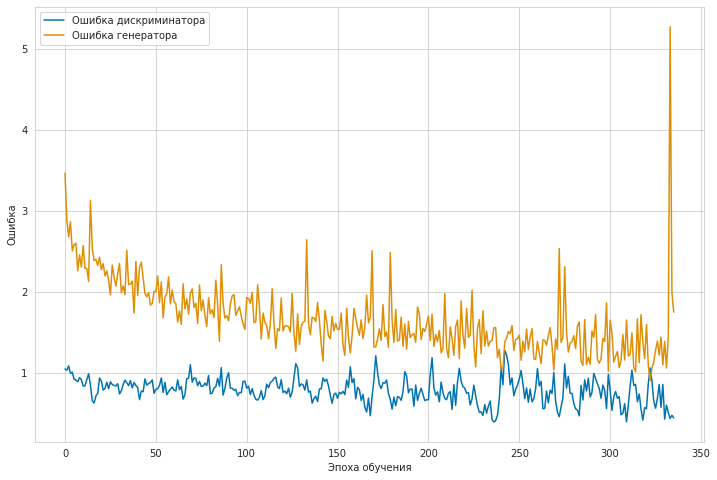

	...epoch 16 108/2500	batch 7/50	D loss: 0.362678	G loss: 2.135665
	...epoch 16 108/2500	batch 23/50	D loss: 0.337648	G loss: 1.919896
	...epoch 16 108/2500	batch 39/50	D loss: 0.318784	G loss: 1.910023


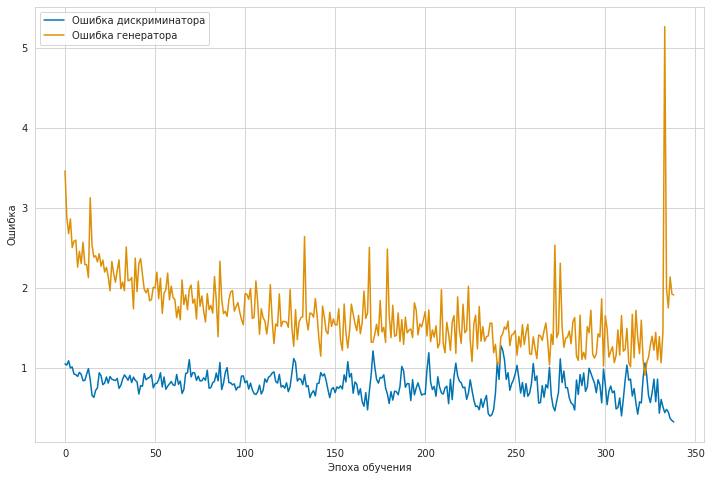

	...epoch 16 109/2500	batch 5/50	D loss: 0.290518	G loss: 2.363061
	...epoch 16 109/2500	batch 21/50	D loss: 0.343535	G loss: 1.455009
	...epoch 16 109/2500	batch 37/50	D loss: 0.257920	G loss: 1.273793


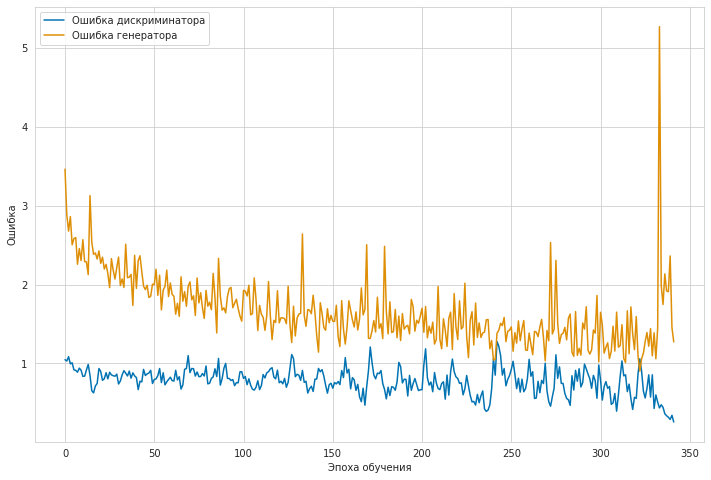

	...epoch 16 110/2500	batch 3/50	D loss: 0.271368	G loss: 1.230485
	...epoch 16 110/2500	batch 19/50	D loss: 0.265022	G loss: 1.387490
	...epoch 16 110/2500	batch 35/50	D loss: 0.587429	G loss: 1.777829


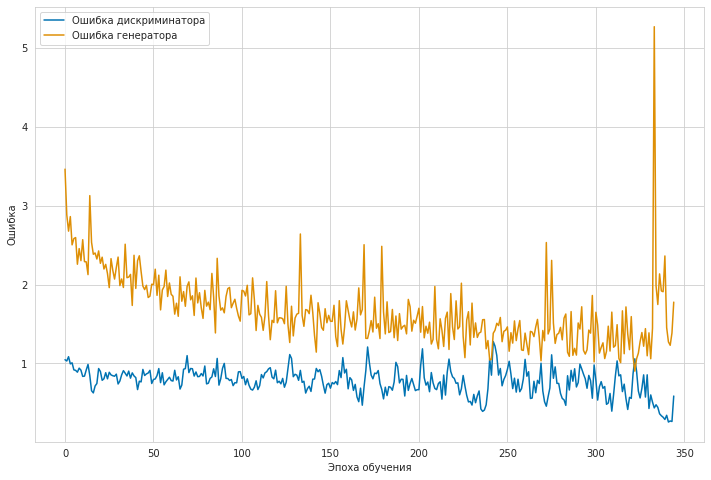

	...epoch 16 111/2500	batch 1/50	D loss: 0.468823	G loss: 1.709427
	...epoch 16 111/2500	batch 17/50	D loss: 0.871627	G loss: 1.563236
	...epoch 16 111/2500	batch 33/50	D loss: 1.078530	G loss: 1.485116
	...epoch 16 111/2500	batch 49/50	D loss: 1.020569	G loss: 1.331778


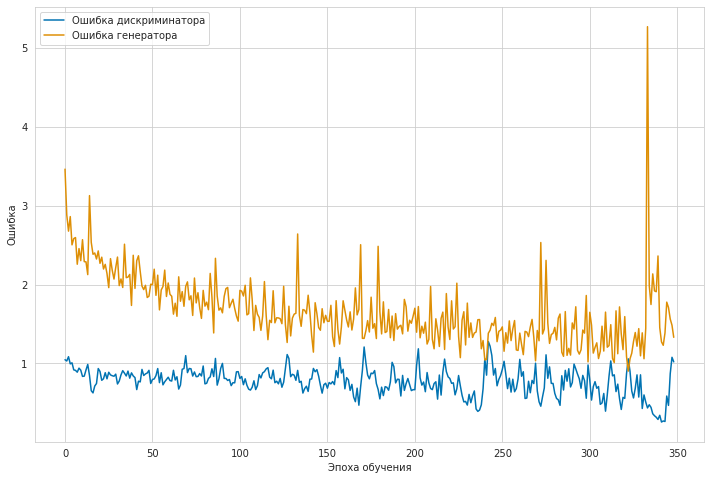

	...epoch 16 112/2500	batch 15/50	D loss: 0.678827	G loss: 1.867860
	...epoch 16 112/2500	batch 31/50	D loss: 0.738380	G loss: 1.126665
	...epoch 16 112/2500	batch 47/50	D loss: 0.730486	G loss: 1.302895


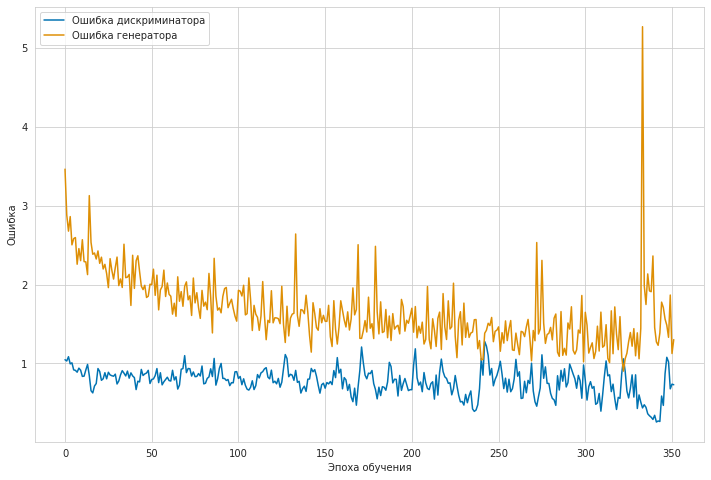

	...epoch 16 113/2500	batch 13/50	D loss: 0.572095	G loss: 1.935495
	...epoch 16 113/2500	batch 29/50	D loss: 0.565864	G loss: 1.153815
	...epoch 16 113/2500	batch 45/50	D loss: 0.941242	G loss: 1.171388


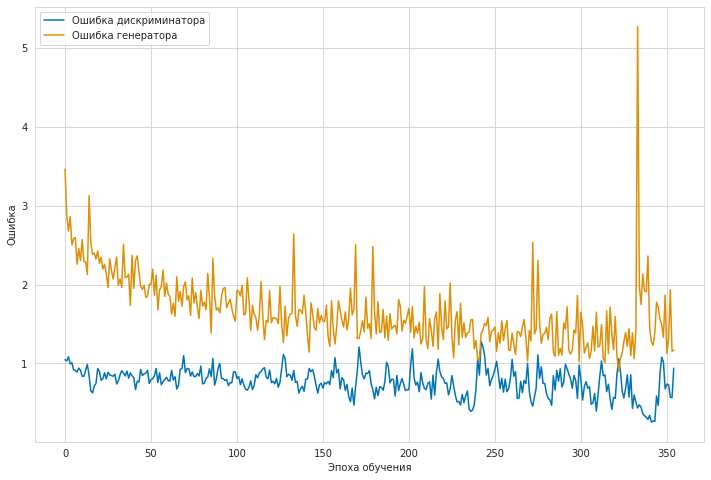

	...epoch 16 114/2500	batch 11/50	D loss: 1.164869	G loss: 1.382530
	...epoch 16 114/2500	batch 27/50	D loss: 1.231774	G loss: 1.316149
	...epoch 16 114/2500	batch 43/50	D loss: 1.316776	G loss: 1.542849


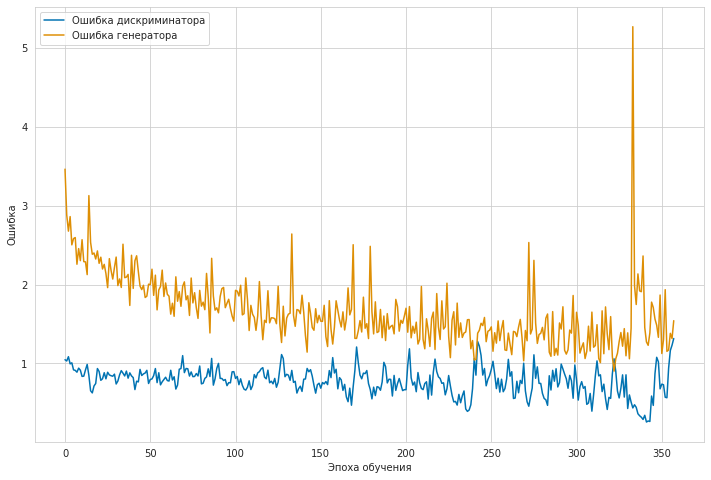

	...epoch 16 115/2500	batch 9/50	D loss: 1.319971	G loss: 1.626995
	...epoch 16 115/2500	batch 25/50	D loss: 1.572627	G loss: 1.332525
	...epoch 16 115/2500	batch 41/50	D loss: 1.348520	G loss: 1.295518


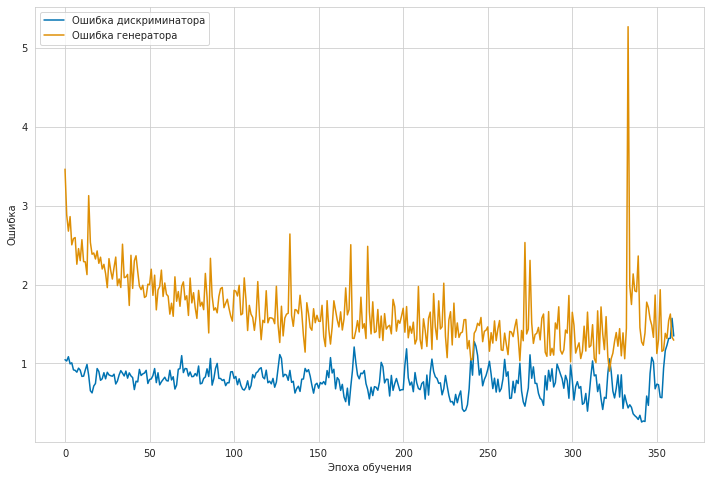

	...epoch 16 116/2500	batch 7/50	D loss: 1.037271	G loss: 1.576032
	...epoch 16 116/2500	batch 23/50	D loss: 1.158652	G loss: 1.391285
	...epoch 16 116/2500	batch 39/50	D loss: 1.013439	G loss: 1.429423


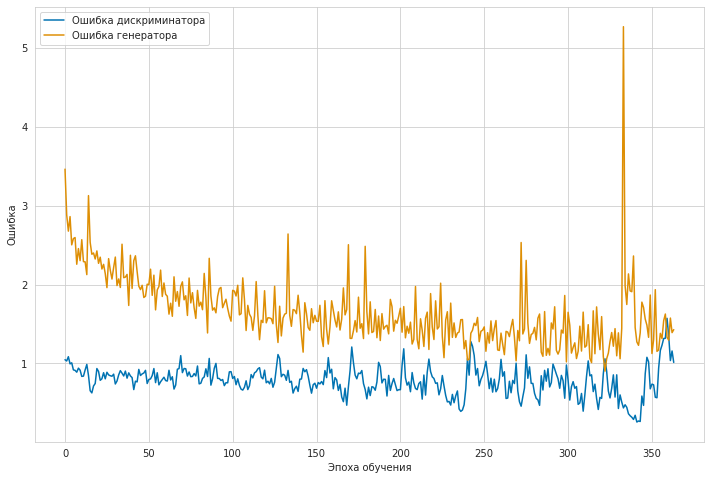

	...epoch 16 117/2500	batch 5/50	D loss: 1.005528	G loss: 1.607758
	...epoch 16 117/2500	batch 21/50	D loss: 0.938569	G loss: 1.371512
	...epoch 16 117/2500	batch 37/50	D loss: 0.853098	G loss: 1.486117


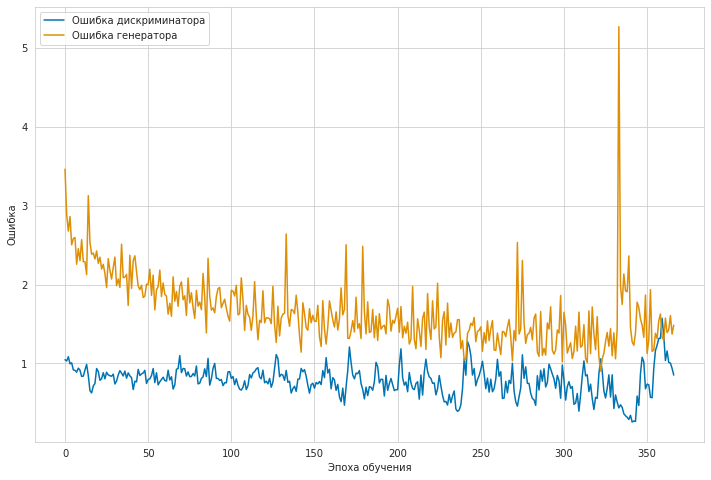

	...epoch 16 118/2500	batch 3/50	D loss: 0.963300	G loss: 1.313346
	...epoch 16 118/2500	batch 19/50	D loss: 0.990450	G loss: 1.301378
	...epoch 16 118/2500	batch 35/50	D loss: 0.683969	G loss: 1.333030


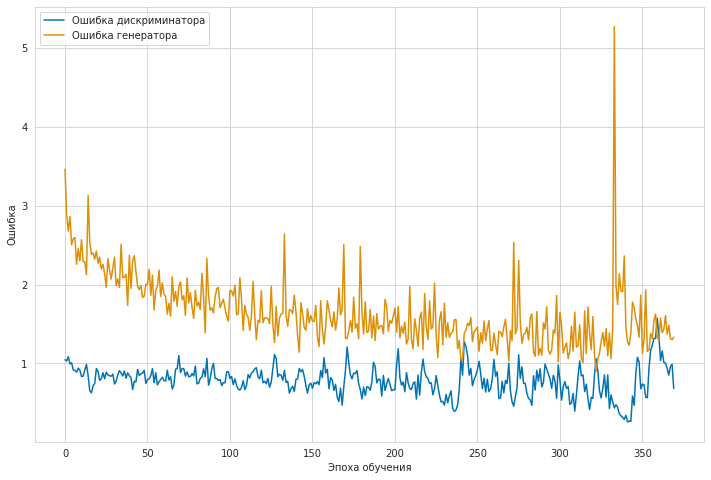

	...epoch 16 119/2500	batch 1/50	D loss: 0.765100	G loss: 1.499098
	...epoch 16 119/2500	batch 17/50	D loss: 1.083897	G loss: 1.426547
	...epoch 16 119/2500	batch 33/50	D loss: 0.837528	G loss: 1.145634
	...epoch 16 119/2500	batch 49/50	D loss: 1.030916	G loss: 1.297205


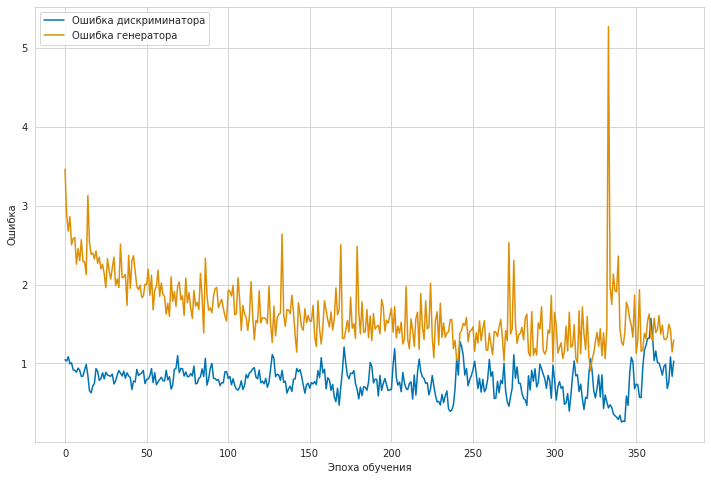

	...epoch 16 120/2500	batch 15/50	D loss: 0.728805	G loss: 1.346090
	...epoch 16 120/2500	batch 31/50	D loss: 0.654273	G loss: 1.136585
	...epoch 16 120/2500	batch 47/50	D loss: 0.772768	G loss: 1.382585


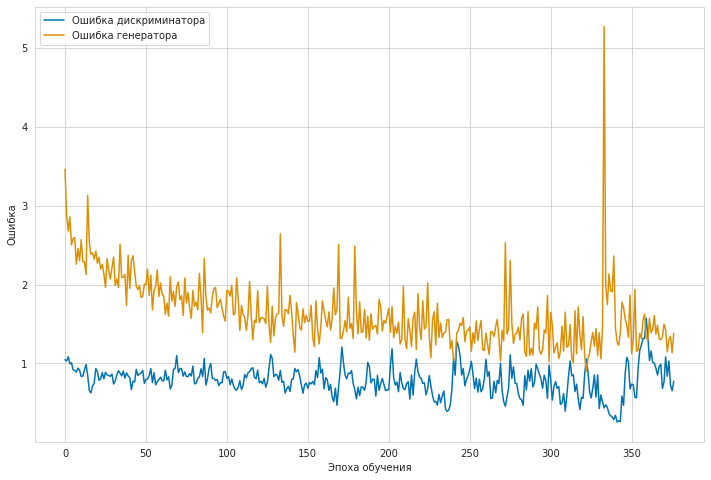

	...epoch 16 121/2500	batch 13/50	D loss: 0.598530	G loss: 1.251803
	...epoch 16 121/2500	batch 29/50	D loss: 0.656251	G loss: 1.342870
	...epoch 16 121/2500	batch 45/50	D loss: 0.880813	G loss: 1.353820


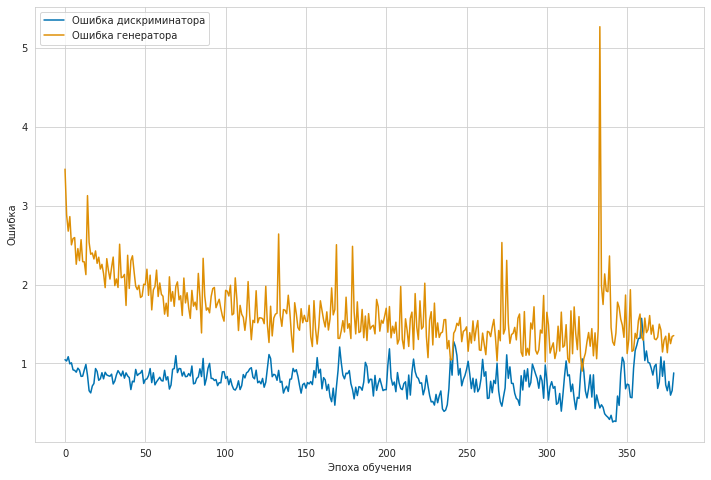

	...epoch 16 122/2500	batch 11/50	D loss: 0.811719	G loss: 1.161945
	...epoch 16 122/2500	batch 27/50	D loss: 0.892660	G loss: 1.307378
	...epoch 16 122/2500	batch 43/50	D loss: 1.016345	G loss: 1.106362


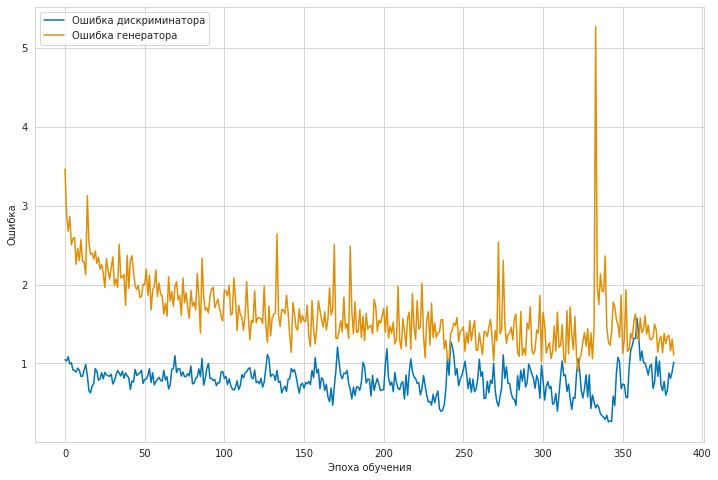

	...epoch 16 123/2500	batch 9/50	D loss: 0.909894	G loss: 1.339392
	...epoch 16 123/2500	batch 25/50	D loss: 0.917497	G loss: 1.316808
	...epoch 16 123/2500	batch 41/50	D loss: 0.815737	G loss: 1.295872


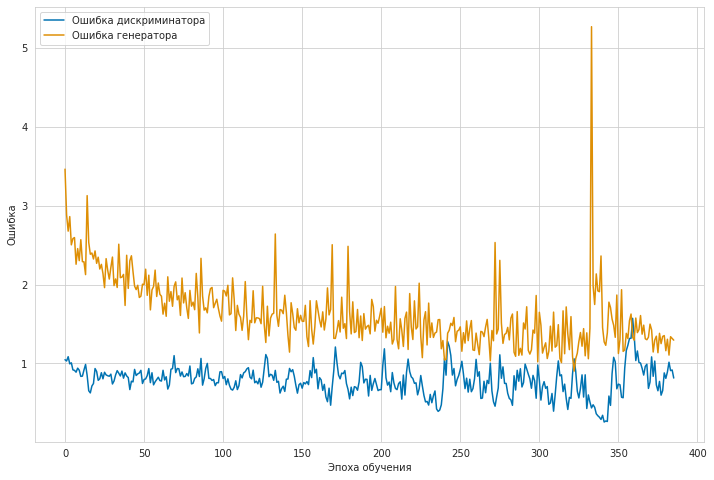

	...epoch 16 124/2500	batch 7/50	D loss: 0.703142	G loss: 1.349537
	...epoch 16 124/2500	batch 23/50	D loss: 0.648736	G loss: 1.145642
	...epoch 16 124/2500	batch 39/50	D loss: 0.743270	G loss: 1.680165


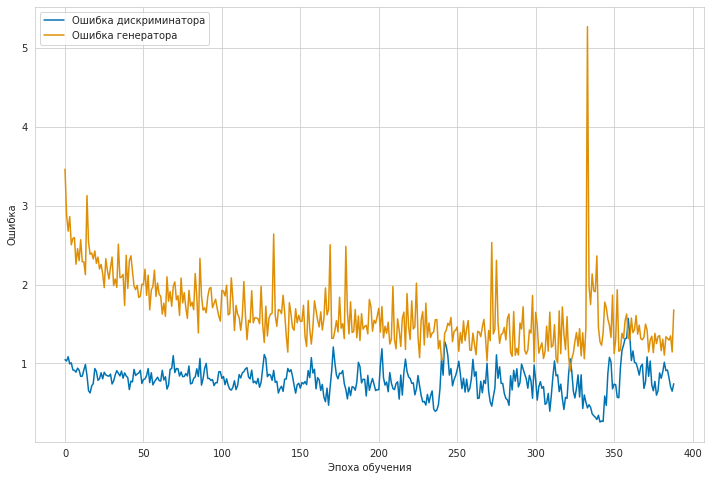

	...epoch 16 125/2500	batch 5/50	D loss: 0.673126	G loss: 1.089345
	...epoch 16 125/2500	batch 21/50	D loss: 0.807856	G loss: 1.171835
	...epoch 16 125/2500	batch 37/50	D loss: 0.808048	G loss: 1.569498


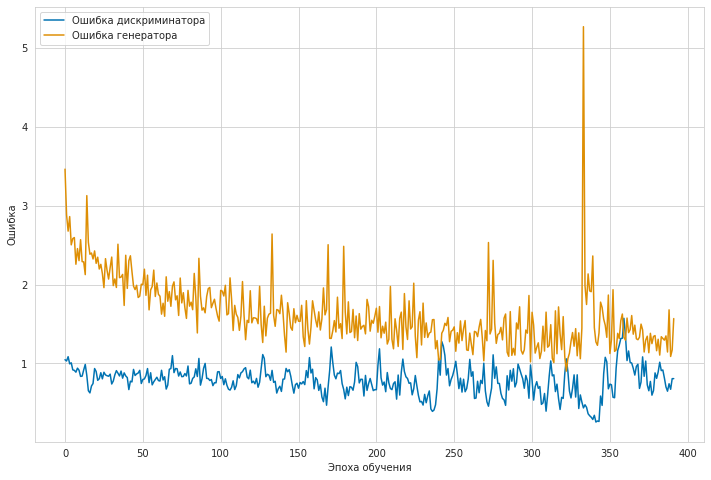

	...epoch 16 126/2500	batch 3/50	D loss: 0.789557	G loss: 1.263697
	...epoch 16 126/2500	batch 19/50	D loss: 0.714453	G loss: 1.205759
	...epoch 16 126/2500	batch 35/50	D loss: 0.748809	G loss: 1.842256


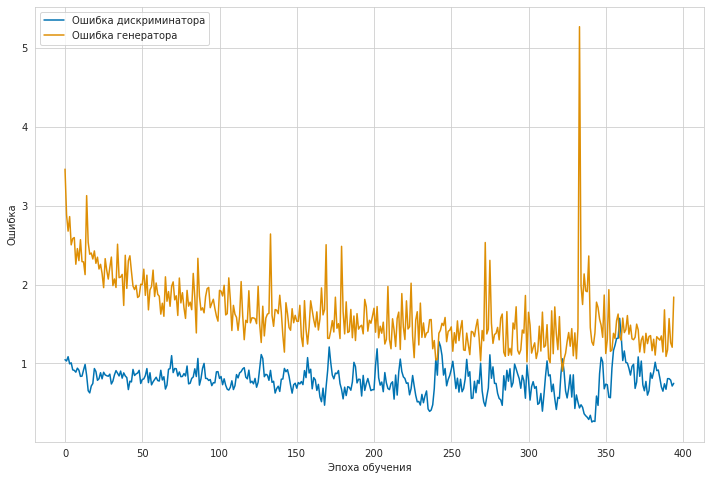

	...epoch 16 127/2500	batch 1/50	D loss: 0.624640	G loss: 1.119278
	...epoch 16 127/2500	batch 17/50	D loss: 1.057588	G loss: 1.232158
	...epoch 16 127/2500	batch 33/50	D loss: 0.712276	G loss: 1.072650
	...epoch 16 127/2500	batch 49/50	D loss: 0.810069	G loss: 1.348627


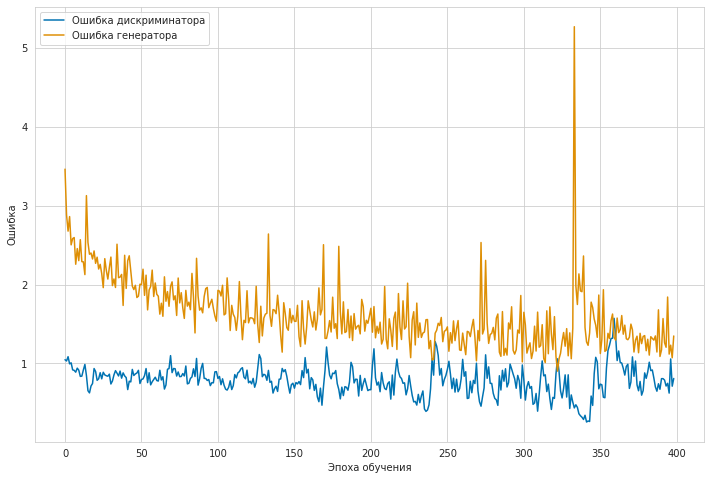

	...epoch 16 128/2500	batch 15/50	D loss: 0.661225	G loss: 1.191038
	...epoch 16 128/2500	batch 31/50	D loss: 0.916351	G loss: 1.334274
	...epoch 16 128/2500	batch 47/50	D loss: 0.796763	G loss: 1.070030


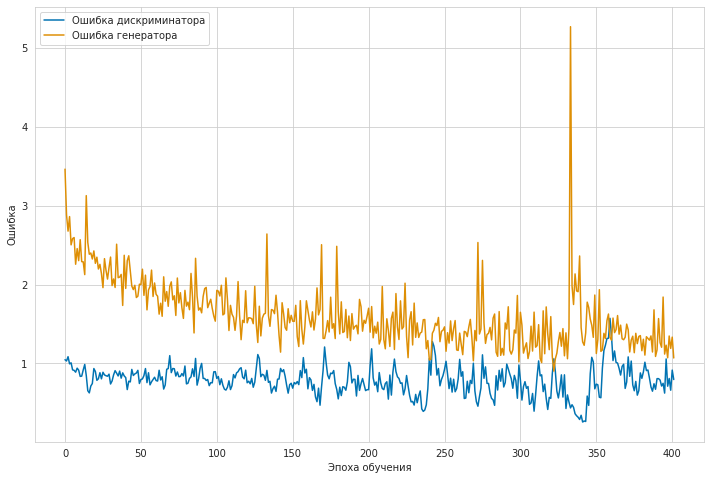

	...epoch 16 129/2500	batch 13/50	D loss: 0.963209	G loss: 1.267883
	...epoch 16 129/2500	batch 29/50	D loss: 0.724270	G loss: 1.221963
	...epoch 16 129/2500	batch 45/50	D loss: 0.875204	G loss: 1.187079


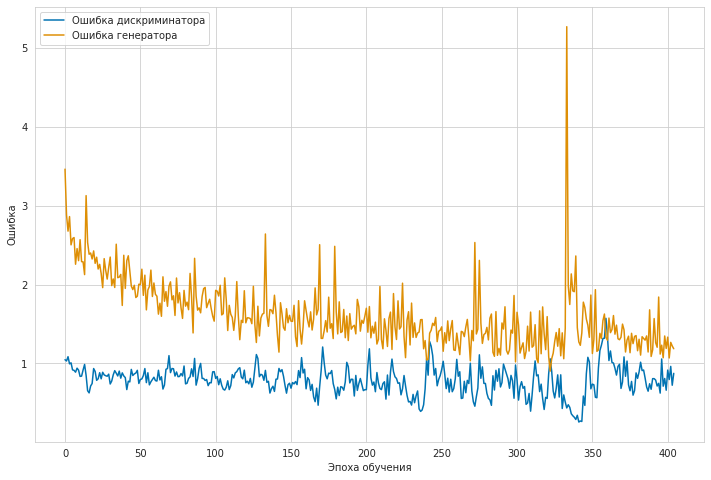

	...epoch 16 130/2500	batch 11/50	D loss: 0.918712	G loss: 1.479953
	...epoch 16 130/2500	batch 27/50	D loss: 0.883740	G loss: 0.983992
	...epoch 16 130/2500	batch 43/50	D loss: 0.644137	G loss: 1.413555


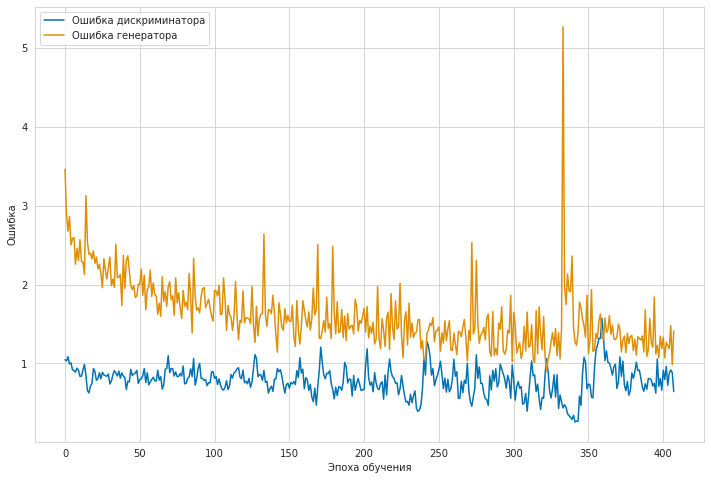

	...epoch 16 131/2500	batch 9/50	D loss: 0.578399	G loss: 1.242009
	...epoch 16 131/2500	batch 25/50	D loss: 0.774679	G loss: 1.191083
	...epoch 16 131/2500	batch 41/50	D loss: 0.663800	G loss: 1.468665


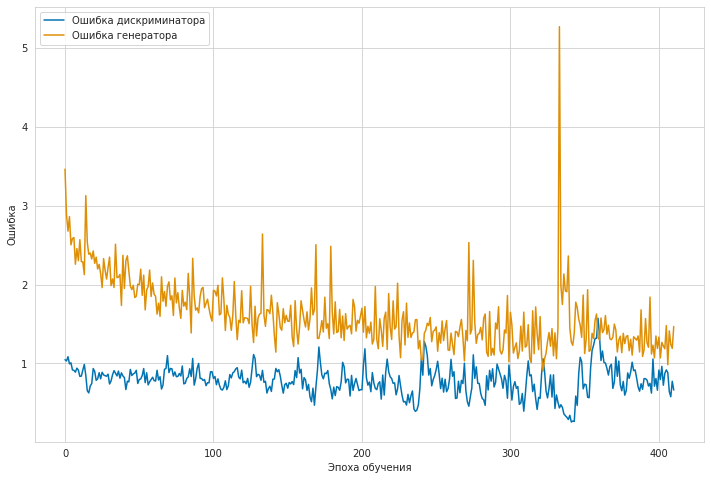

	...epoch 16 132/2500	batch 7/50	D loss: 0.543819	G loss: 1.301008
	...epoch 16 132/2500	batch 23/50	D loss: 0.839407	G loss: 1.148414
	...epoch 16 132/2500	batch 39/50	D loss: 0.613658	G loss: 1.880927


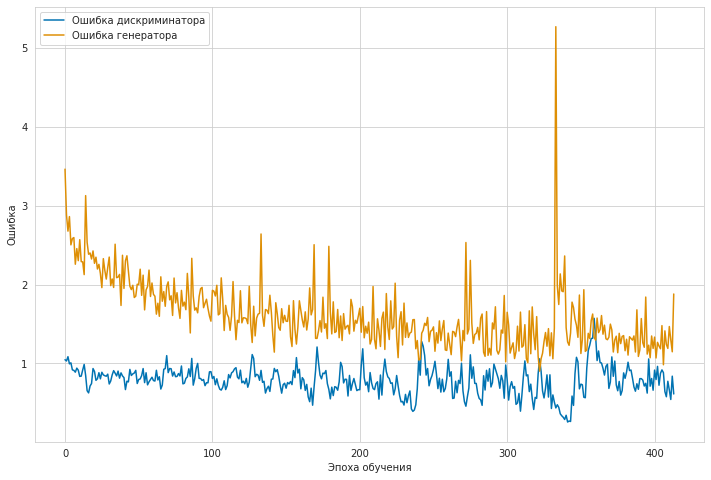

	...epoch 16 133/2500	batch 5/50	D loss: 0.678520	G loss: 1.193726
	...epoch 16 133/2500	batch 21/50	D loss: 0.762571	G loss: 1.193200
	...epoch 16 133/2500	batch 37/50	D loss: 0.814785	G loss: 1.192451


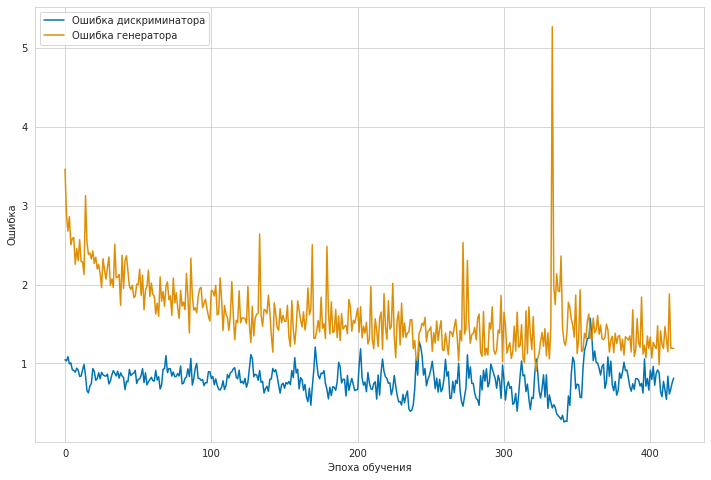

	...epoch 16 134/2500	batch 3/50	D loss: 0.884200	G loss: 1.299860
	...epoch 16 134/2500	batch 19/50	D loss: 0.650593	G loss: 1.336502
	...epoch 16 134/2500	batch 35/50	D loss: 0.545103	G loss: 1.362850


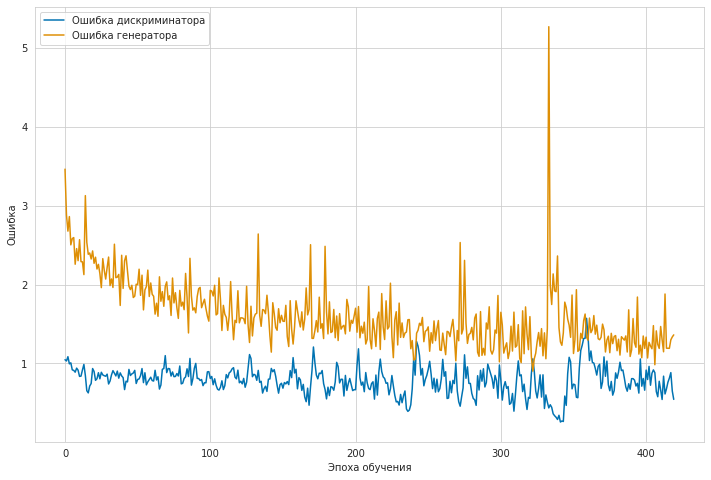

	...epoch 16 135/2500	batch 1/50	D loss: 0.584801	G loss: 1.099195
	...epoch 16 135/2500	batch 17/50	D loss: 0.839311	G loss: 1.288882
	...epoch 16 135/2500	batch 33/50	D loss: 0.510274	G loss: 1.148937
	...epoch 16 135/2500	batch 49/50	D loss: 0.874453	G loss: 0.963793


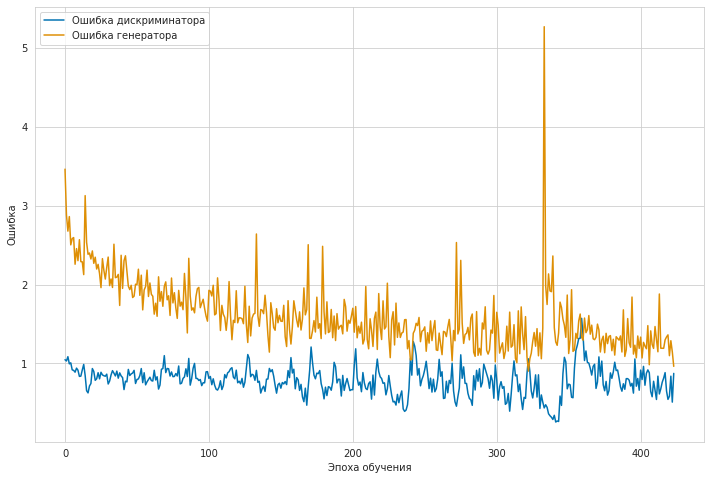

	...epoch 16 136/2500	batch 15/50	D loss: 0.612067	G loss: 1.422185
	...epoch 16 136/2500	batch 31/50	D loss: 0.524580	G loss: 1.447395
	...epoch 16 136/2500	batch 47/50	D loss: 0.545900	G loss: 1.226092


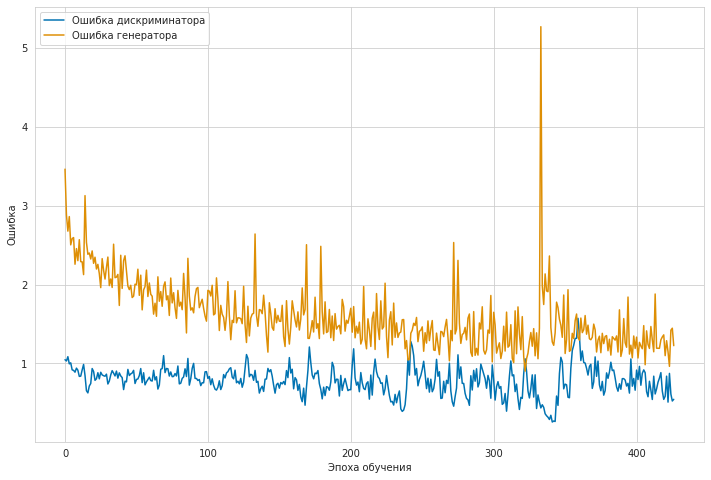

	...epoch 16 137/2500	batch 13/50	D loss: 0.405724	G loss: 1.508678
	...epoch 16 137/2500	batch 29/50	D loss: 0.627470	G loss: 1.149153
	...epoch 16 137/2500	batch 45/50	D loss: 0.625837	G loss: 1.358814


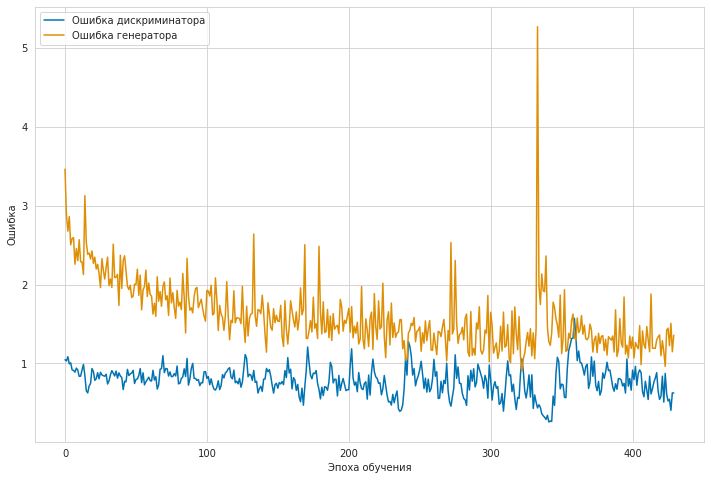

	...epoch 16 138/2500	batch 11/50	D loss: 0.974293	G loss: 1.071319
	...epoch 16 138/2500	batch 27/50	D loss: 0.923655	G loss: 1.057410
	...epoch 16 138/2500	batch 43/50	D loss: 0.795935	G loss: 1.328572


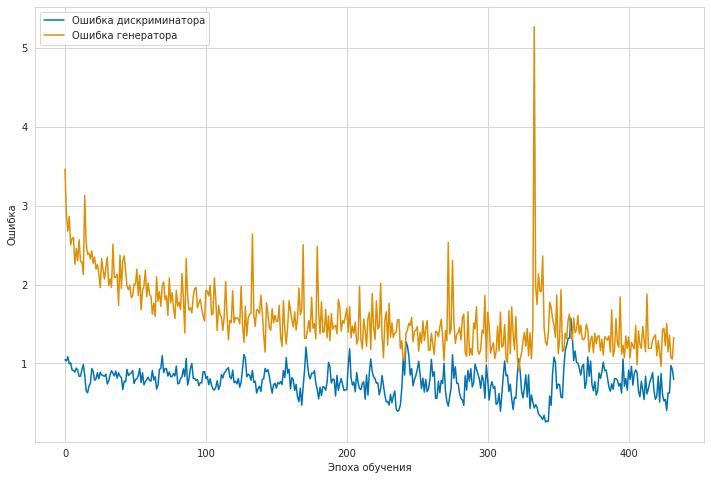

	...epoch 16 139/2500	batch 9/50	D loss: 0.902064	G loss: 1.128119
	...epoch 16 139/2500	batch 25/50	D loss: 0.726445	G loss: 1.515034
	...epoch 16 139/2500	batch 41/50	D loss: 0.661906	G loss: 1.248944


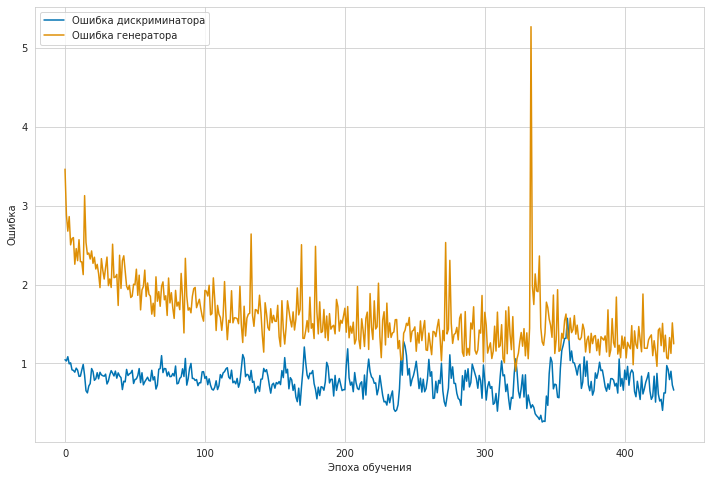

	...epoch 16 140/2500	batch 7/50	D loss: 0.677826	G loss: 1.246539
	...epoch 16 140/2500	batch 23/50	D loss: 0.550622	G loss: 1.125962
	...epoch 16 140/2500	batch 39/50	D loss: 0.422916	G loss: 1.561033


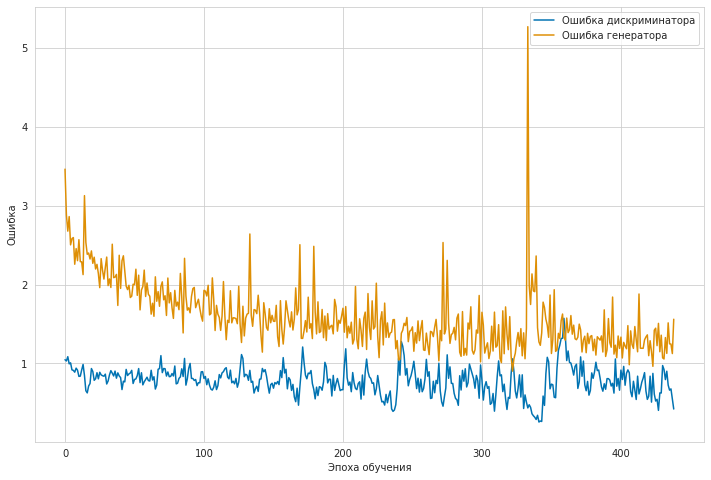

	...epoch 16 141/2500	batch 5/50	D loss: 0.388785	G loss: 1.310641
	...epoch 16 141/2500	batch 21/50	D loss: 0.659777	G loss: 1.095345
	...epoch 16 141/2500	batch 37/50	D loss: 0.583611	G loss: 1.311525


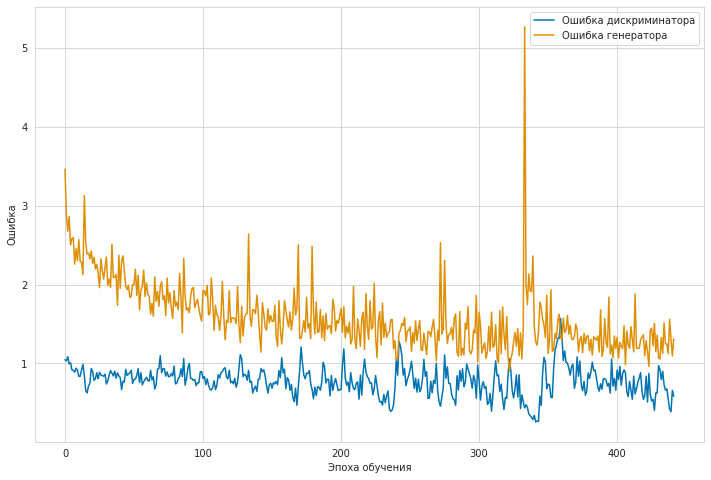

	...epoch 16 142/2500	batch 3/50	D loss: 0.667045	G loss: 1.132880
	...epoch 16 142/2500	batch 19/50	D loss: 0.455056	G loss: 1.285197
	...epoch 16 142/2500	batch 35/50	D loss: 0.459141	G loss: 1.286268


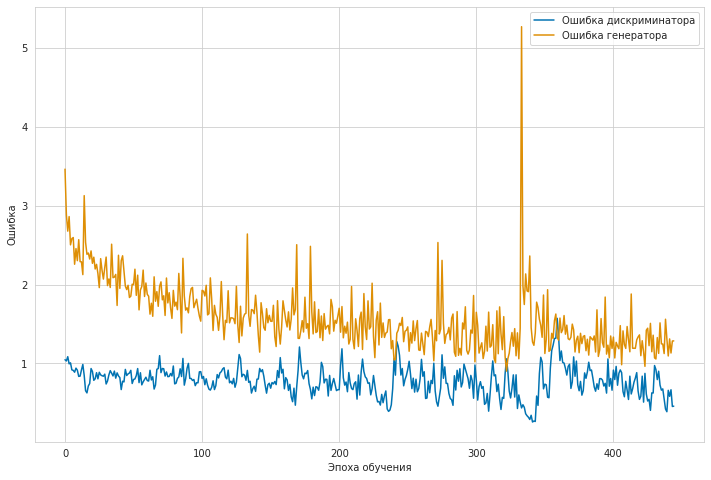

	...epoch 16 143/2500	batch 1/50	D loss: 0.406940	G loss: 1.319871
	...epoch 16 143/2500	batch 17/50	D loss: 0.397358	G loss: 1.036620
	...epoch 16 143/2500	batch 33/50	D loss: 0.326652	G loss: 1.249767
	...epoch 16 143/2500	batch 49/50	D loss: 0.432419	G loss: 1.633342


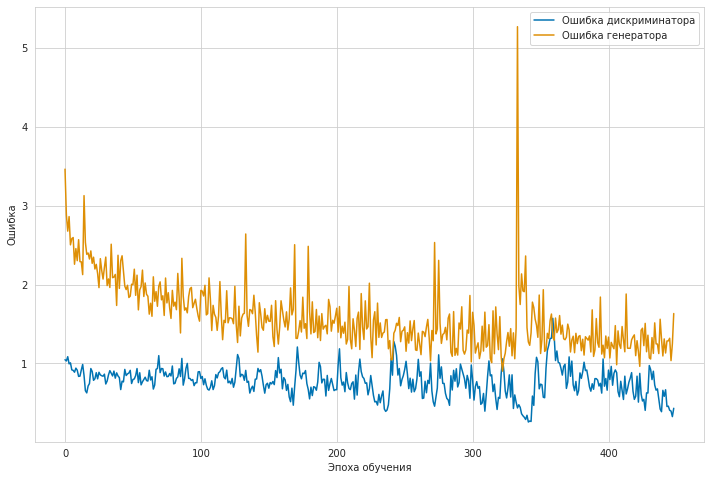

	...epoch 16 144/2500	batch 15/50	D loss: 0.442644	G loss: 1.156855
	...epoch 16 144/2500	batch 31/50	D loss: 0.310406	G loss: 1.837725
	...epoch 16 144/2500	batch 47/50	D loss: 0.322830	G loss: 1.168063


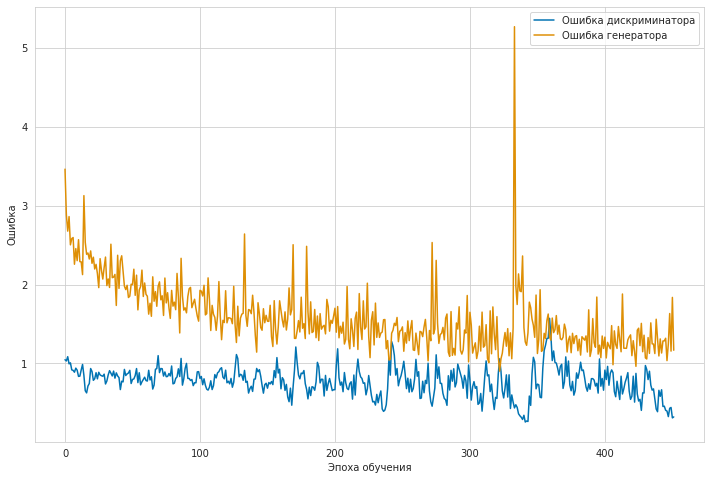

	...epoch 16 145/2500	batch 13/50	D loss: 0.407401	G loss: 1.055464
	...epoch 16 145/2500	batch 29/50	D loss: 0.279933	G loss: 1.301352
	...epoch 16 145/2500	batch 45/50	D loss: 0.357447	G loss: 1.258544


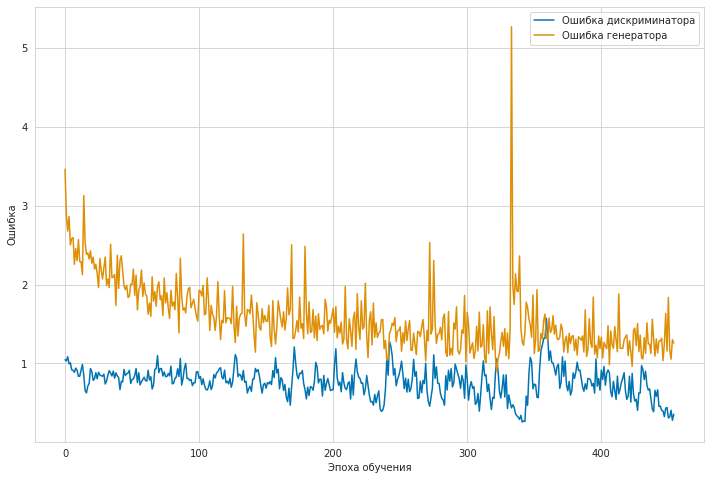

	...epoch 16 146/2500	batch 11/50	D loss: 0.331002	G loss: 1.699659
	...epoch 16 146/2500	batch 27/50	D loss: 0.484476	G loss: 1.052661
	...epoch 16 146/2500	batch 43/50	D loss: 0.767069	G loss: 1.447760


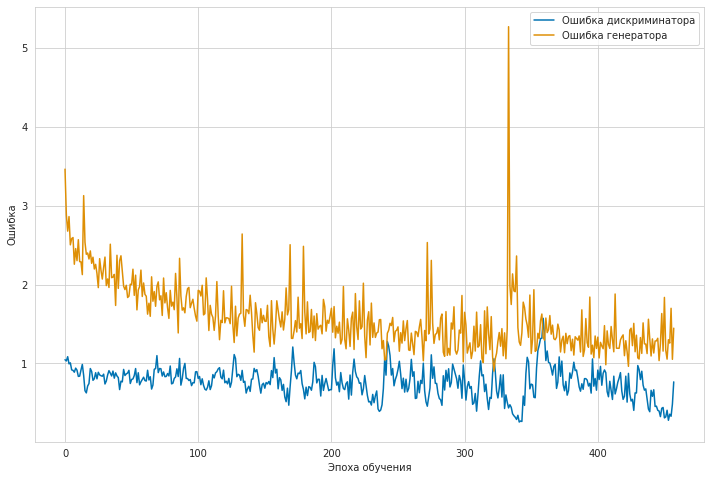

	...epoch 16 147/2500	batch 9/50	D loss: 0.420292	G loss: 1.145054
	...epoch 16 147/2500	batch 25/50	D loss: 0.993407	G loss: 0.883152
	...epoch 16 147/2500	batch 41/50	D loss: 0.980574	G loss: 1.291383


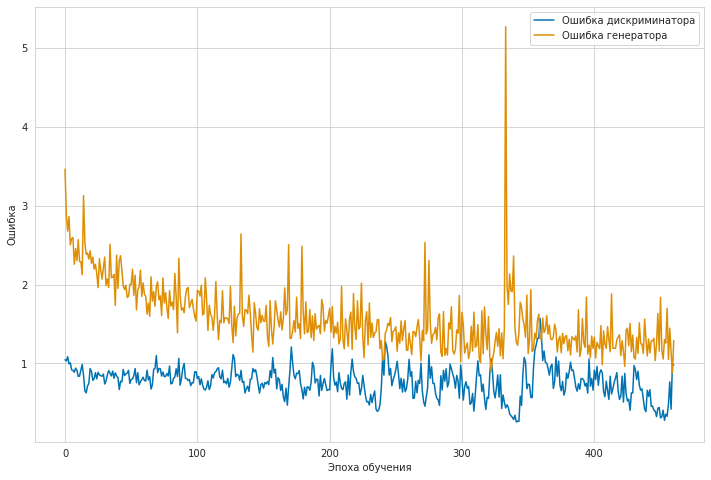

	...epoch 16 148/2500	batch 7/50	D loss: 0.876580	G loss: 1.206083
	...epoch 16 148/2500	batch 23/50	D loss: 1.215813	G loss: 1.112388
	...epoch 16 148/2500	batch 39/50	D loss: 0.886763	G loss: 0.941949


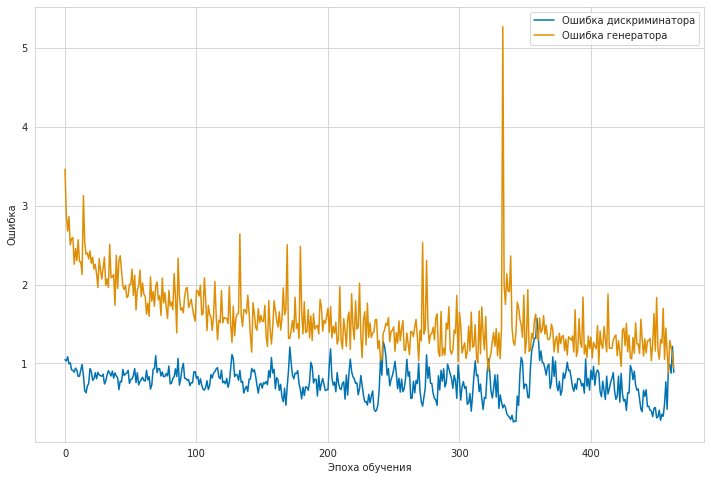

	...epoch 16 149/2500	batch 5/50	D loss: 1.408367	G loss: 1.127062
	...epoch 16 149/2500	batch 21/50	D loss: 1.156079	G loss: 1.122232
	...epoch 16 149/2500	batch 37/50	D loss: 0.843812	G loss: 1.400354


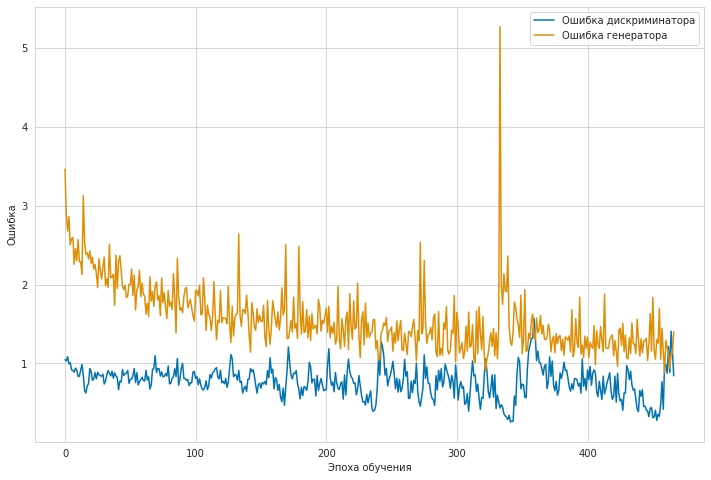

	...epoch 16 150/2500	batch 3/50	D loss: 0.802232	G loss: 1.199031
	...epoch 16 150/2500	batch 19/50	D loss: 0.732397	G loss: 1.207950
	...epoch 16 150/2500	batch 35/50	D loss: 0.696663	G loss: 1.436687


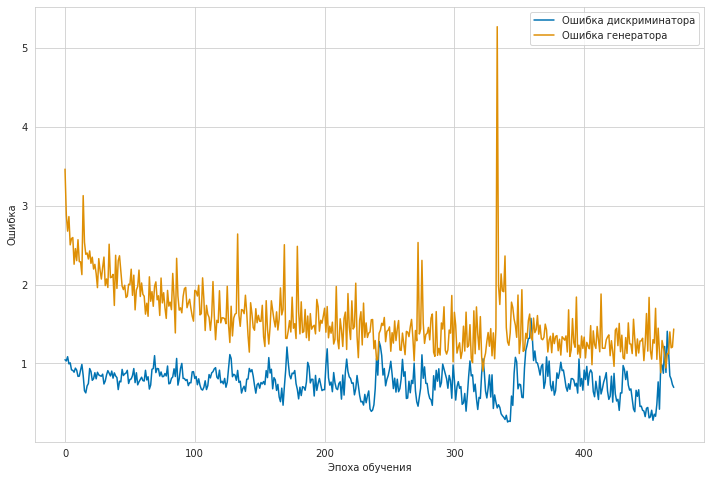

	...epoch 16 151/2500	batch 1/50	D loss: 0.834730	G loss: 1.172480
	...epoch 16 151/2500	batch 17/50	D loss: 0.687372	G loss: 1.490529
	...epoch 16 151/2500	batch 33/50	D loss: 0.612697	G loss: 1.258269
	...epoch 16 151/2500	batch 49/50	D loss: 0.889497	G loss: 1.166266


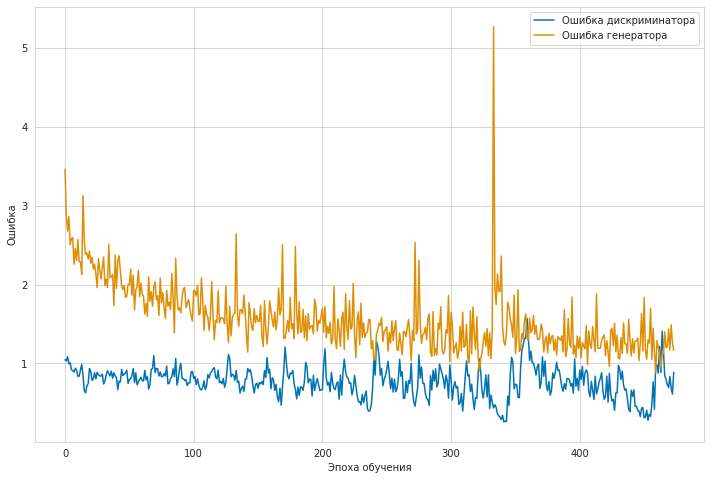

	...epoch 16 152/2500	batch 15/50	D loss: 0.824479	G loss: 1.692628
	...epoch 16 152/2500	batch 31/50	D loss: 1.236425	G loss: 1.633091
	...epoch 16 152/2500	batch 47/50	D loss: 1.209065	G loss: 1.271226


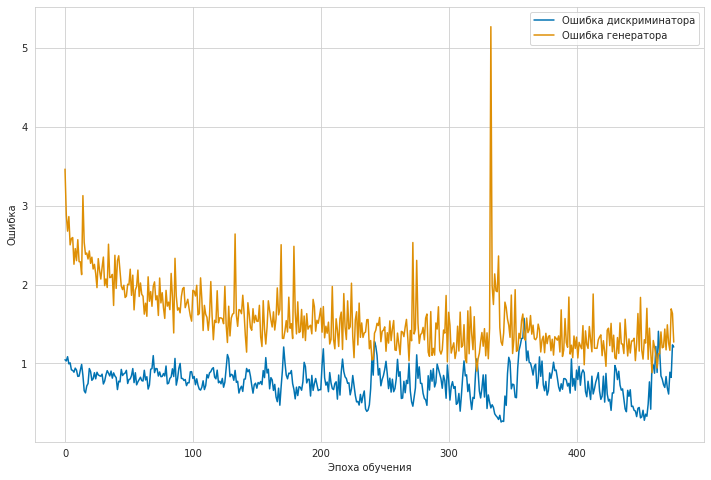

	...epoch 16 153/2500	batch 13/50	D loss: 1.191184	G loss: 1.305757
	...epoch 16 153/2500	batch 29/50	D loss: 0.976788	G loss: 1.179157
	...epoch 16 153/2500	batch 45/50	D loss: 0.800836	G loss: 1.369842


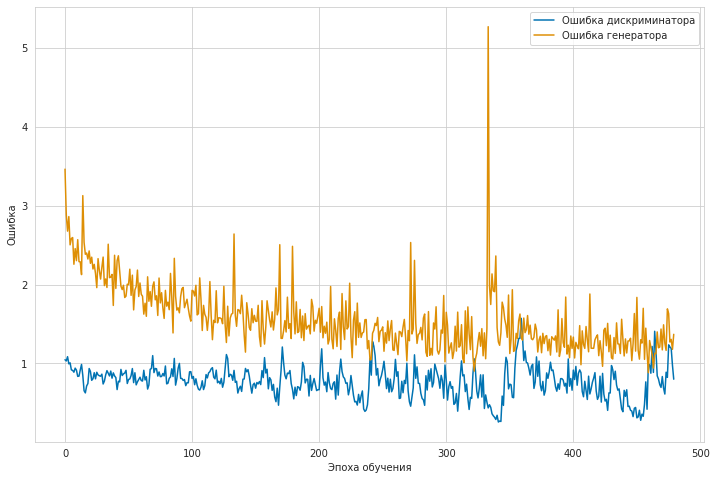

	...epoch 16 154/2500	batch 11/50	D loss: 0.795645	G loss: 1.175465
	...epoch 16 154/2500	batch 27/50	D loss: 0.808984	G loss: 1.055227
	...epoch 16 154/2500	batch 43/50	D loss: 0.822958	G loss: 1.211339


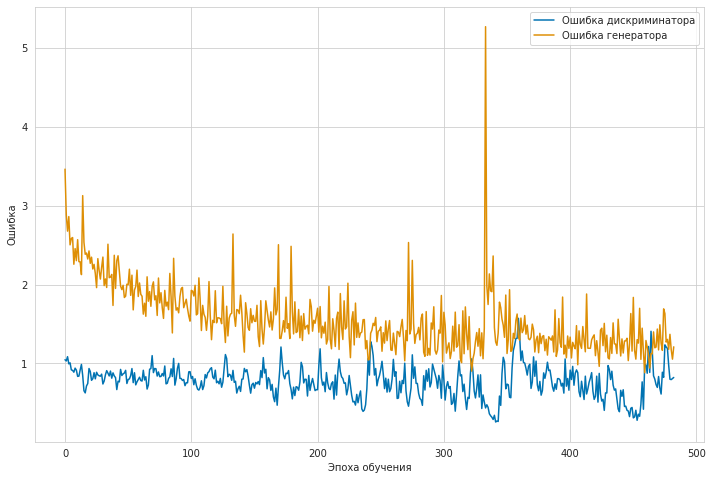

	...epoch 16 155/2500	batch 9/50	D loss: 1.049537	G loss: 1.632889
	...epoch 16 155/2500	batch 25/50	D loss: 1.021448	G loss: 1.239785
	...epoch 16 155/2500	batch 41/50	D loss: 1.265915	G loss: 1.158945


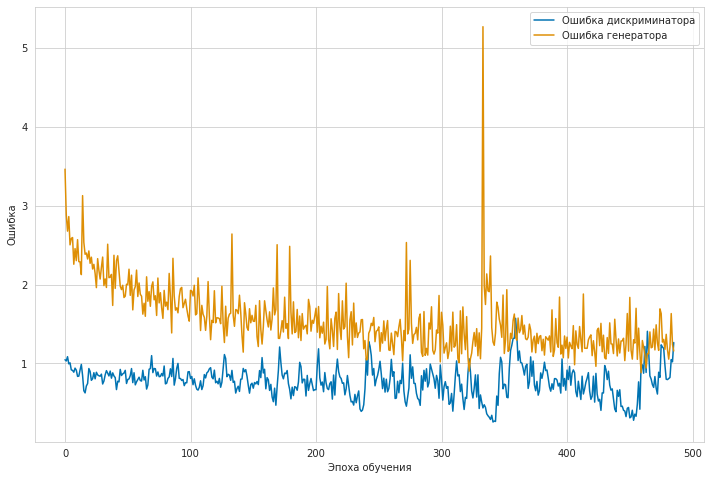

	...epoch 16 156/2500	batch 7/50	D loss: 1.270854	G loss: 1.055421
	...epoch 16 156/2500	batch 23/50	D loss: 1.201474	G loss: 1.302994
	...epoch 16 156/2500	batch 39/50	D loss: 1.136034	G loss: 1.174579


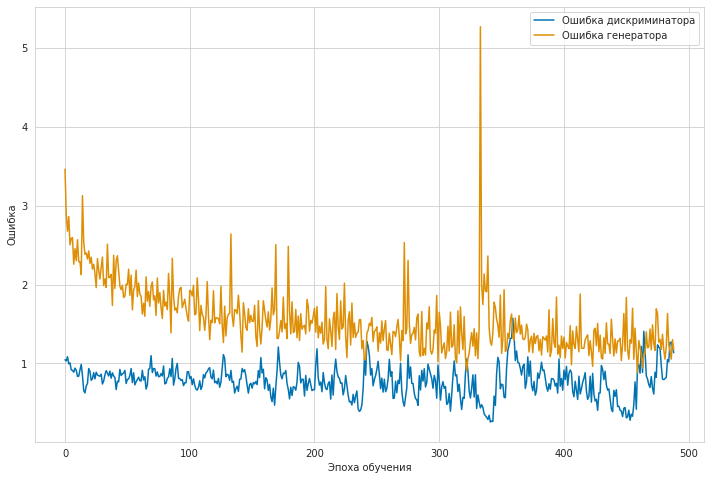

	...epoch 16 157/2500	batch 5/50	D loss: 1.022185	G loss: 1.238819
	...epoch 16 157/2500	batch 21/50	D loss: 1.063818	G loss: 1.320003
	...epoch 16 157/2500	batch 37/50	D loss: 1.018939	G loss: 1.571738


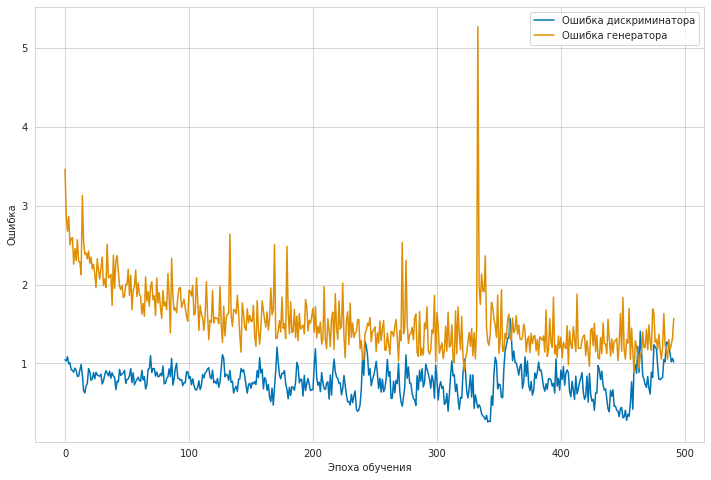

	...epoch 16 158/2500	batch 3/50	D loss: 1.098179	G loss: 1.353315
	...epoch 16 158/2500	batch 19/50	D loss: 1.075862	G loss: 1.324254
	...epoch 16 158/2500	batch 35/50	D loss: 0.936300	G loss: 1.414045


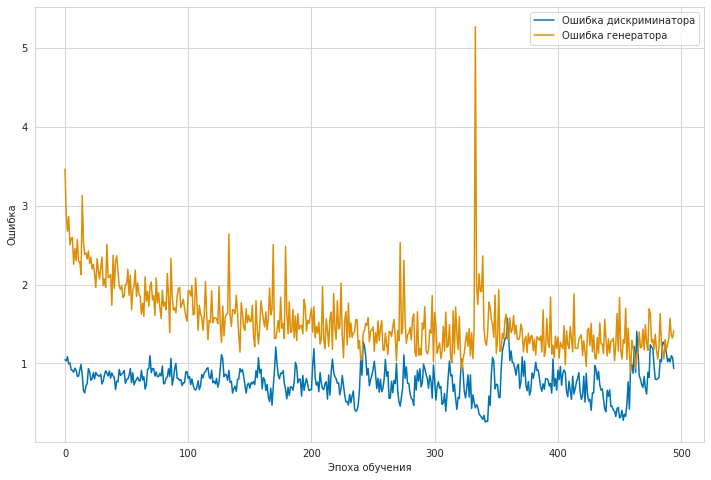

	...epoch 16 159/2500	batch 1/50	D loss: 0.921362	G loss: 1.430400
	...epoch 16 159/2500	batch 17/50	D loss: 1.033241	G loss: 1.380697
	...epoch 16 159/2500	batch 33/50	D loss: 1.054190	G loss: 1.437830
	...epoch 16 159/2500	batch 49/50	D loss: 0.928417	G loss: 1.221290


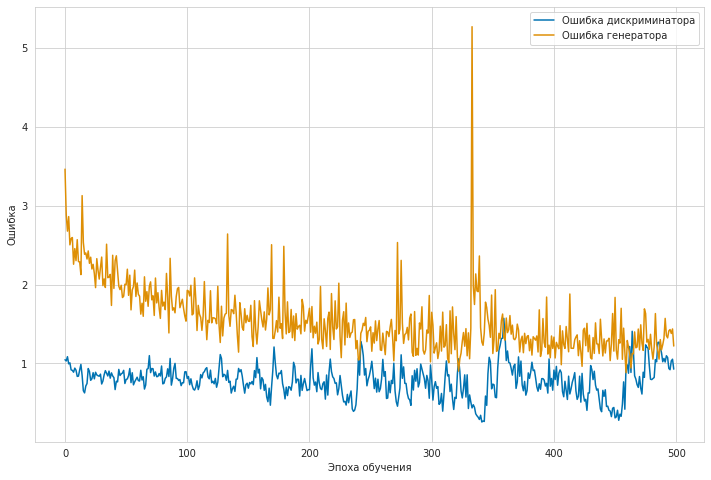

	...epoch 16 160/2500	batch 15/50	D loss: 0.955950	G loss: 1.192154
	...epoch 16 160/2500	batch 31/50	D loss: 0.837066	G loss: 1.380731
	...epoch 16 160/2500	batch 47/50	D loss: 0.797182	G loss: 1.318475


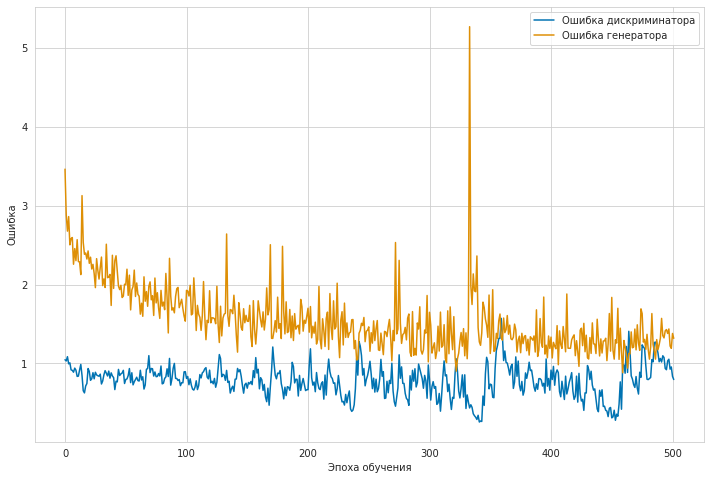

	...epoch 16 161/2500	batch 13/50	D loss: 0.856886	G loss: 1.294175
	...epoch 16 161/2500	batch 29/50	D loss: 0.795704	G loss: 1.505996
	...epoch 16 161/2500	batch 45/50	D loss: 0.992024	G loss: 1.137830


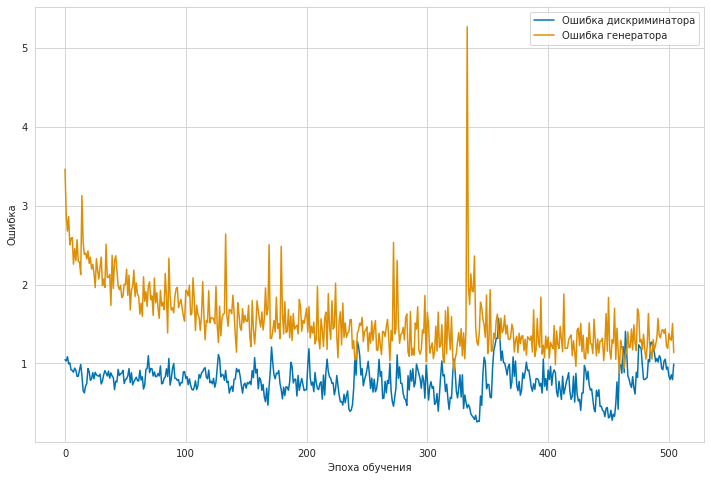

	...epoch 16 162/2500	batch 11/50	D loss: 0.984460	G loss: 1.396349
	...epoch 16 162/2500	batch 27/50	D loss: 0.711977	G loss: 1.257377
	...epoch 16 162/2500	batch 43/50	D loss: 0.985171	G loss: 1.250493


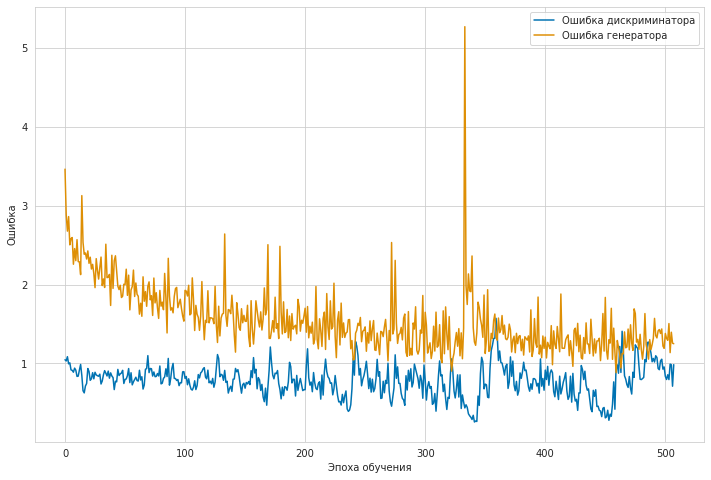

	...epoch 16 163/2500	batch 9/50	D loss: 1.023363	G loss: 1.690824
	...epoch 16 163/2500	batch 25/50	D loss: 0.847498	G loss: 1.310207
	...epoch 16 163/2500	batch 41/50	D loss: 0.875251	G loss: 1.293897


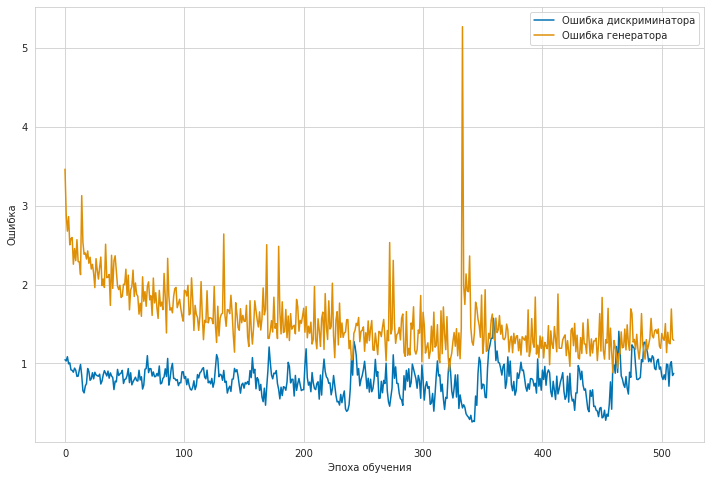

	...epoch 16 164/2500	batch 7/50	D loss: 0.817736	G loss: 1.335996
	...epoch 16 164/2500	batch 23/50	D loss: 0.764871	G loss: 1.219037
	...epoch 16 164/2500	batch 39/50	D loss: 0.932611	G loss: 1.258974


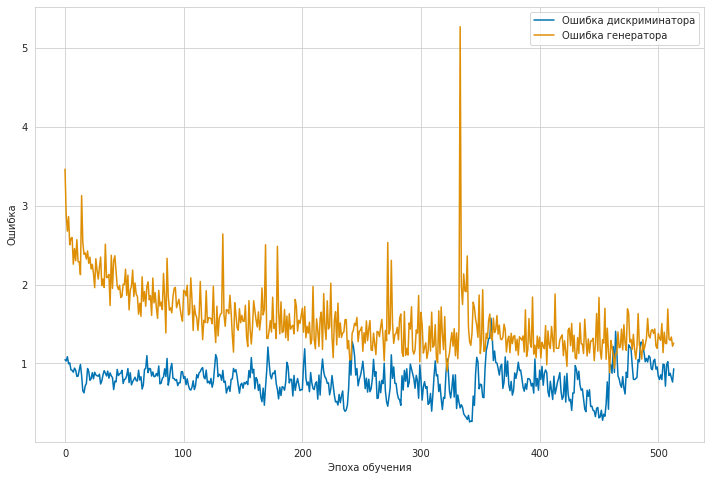

	...epoch 16 165/2500	batch 5/50	D loss: 0.893899	G loss: 1.360487
	...epoch 16 165/2500	batch 21/50	D loss: 0.865868	G loss: 1.222342
	...epoch 16 165/2500	batch 37/50	D loss: 0.999018	G loss: 1.193283


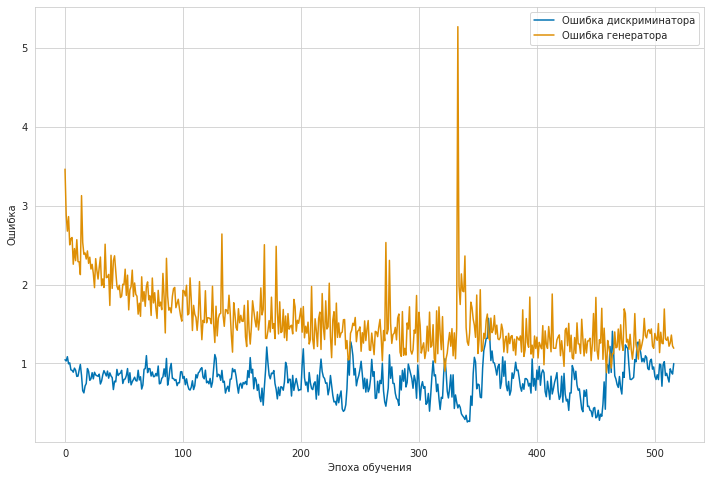

	...epoch 16 166/2500	batch 3/50	D loss: 0.824190	G loss: 1.404773
	...epoch 16 166/2500	batch 19/50	D loss: 0.798971	G loss: 1.391715
	...epoch 16 166/2500	batch 35/50	D loss: 0.819554	G loss: 1.340134


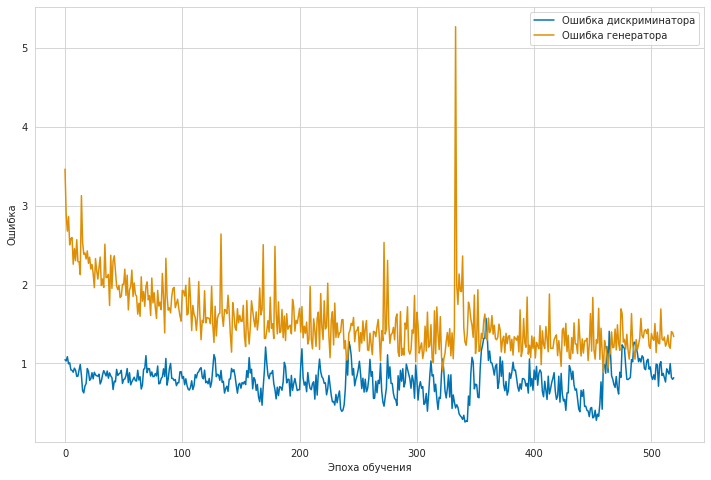

	...epoch 16 167/2500	batch 1/50	D loss: 0.718539	G loss: 1.296034
	...epoch 16 167/2500	batch 17/50	D loss: 0.749330	G loss: 1.454170
	...epoch 16 167/2500	batch 33/50	D loss: 0.741013	G loss: 1.510429
	...epoch 16 167/2500	batch 49/50	D loss: 0.885322	G loss: 1.235170


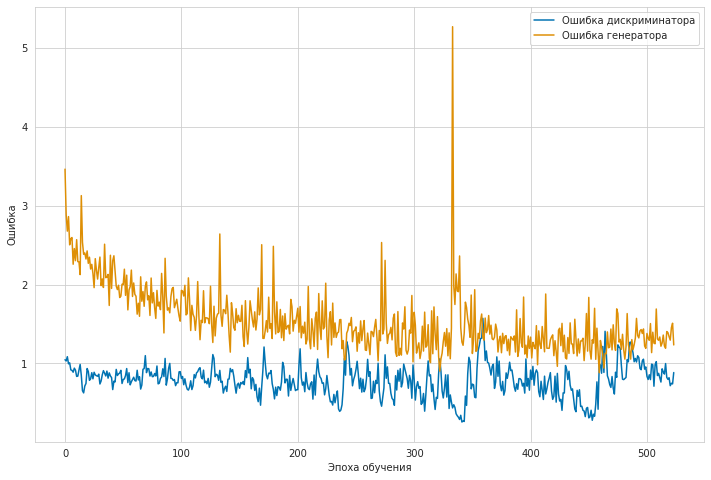

	...epoch 16 168/2500	batch 15/50	D loss: 0.982552	G loss: 1.668058
	...epoch 16 168/2500	batch 31/50	D loss: 1.007730	G loss: 1.174221
	...epoch 16 168/2500	batch 47/50	D loss: 1.319089	G loss: 1.127566


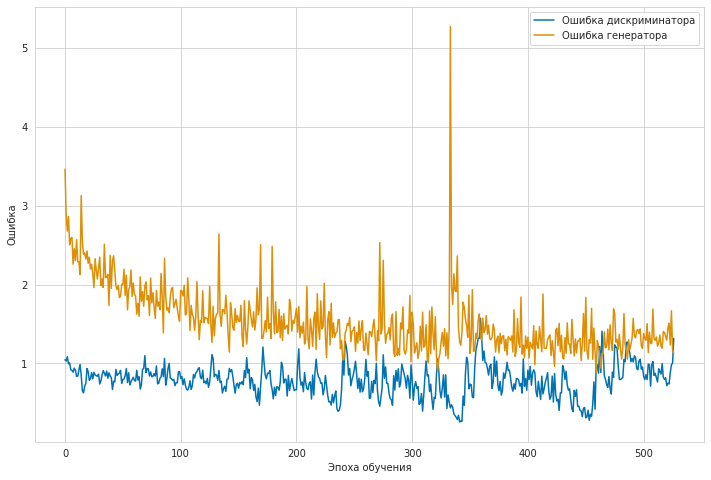

	...epoch 16 169/2500	batch 13/50	D loss: 1.195872	G loss: 1.230200
	...epoch 16 169/2500	batch 29/50	D loss: 1.132992	G loss: 1.218234
	...epoch 16 169/2500	batch 45/50	D loss: 1.064863	G loss: 1.426450


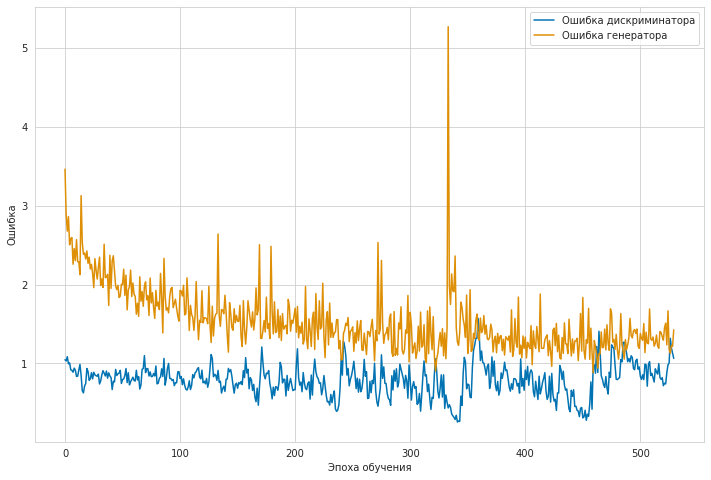

	...epoch 16 170/2500	batch 11/50	D loss: 1.041595	G loss: 1.327984
	...epoch 16 170/2500	batch 27/50	D loss: 0.973910	G loss: 1.365357
	...epoch 16 170/2500	batch 43/50	D loss: 1.026412	G loss: 1.305925


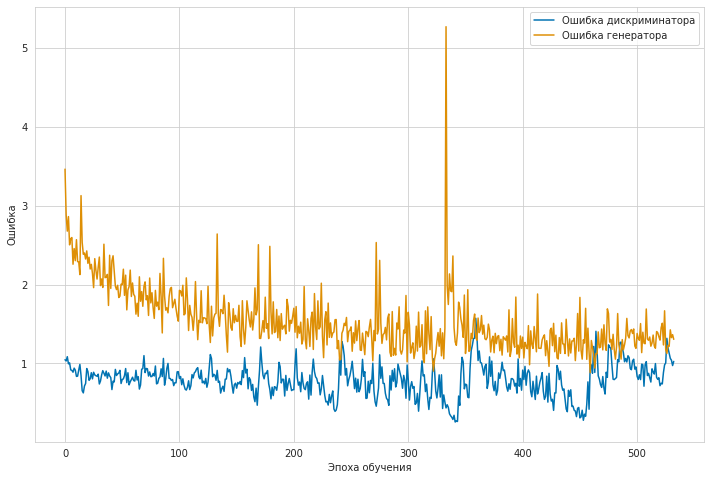

	...epoch 16 171/2500	batch 9/50	D loss: 1.021305	G loss: 1.287804
	...epoch 16 171/2500	batch 25/50	D loss: 0.986634	G loss: 1.383615
	...epoch 16 171/2500	batch 41/50	D loss: 0.968233	G loss: 1.344255


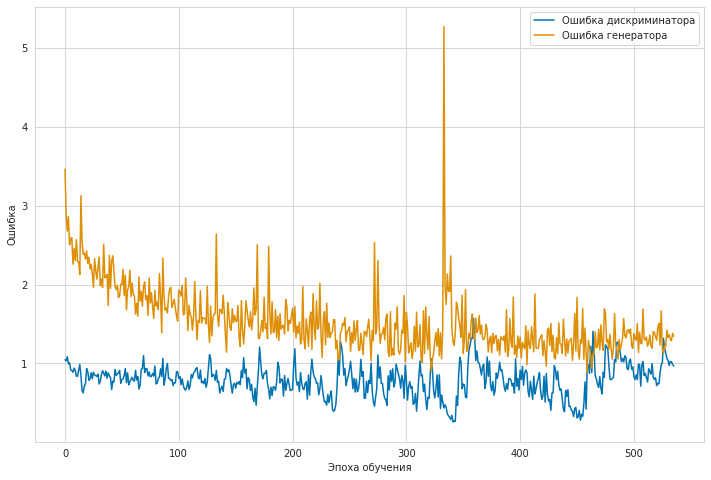

	...epoch 16 172/2500	batch 7/50	D loss: 0.910601	G loss: 1.330757
	...epoch 16 172/2500	batch 23/50	D loss: 0.855030	G loss: 1.308872
	...epoch 16 172/2500	batch 39/50	D loss: 0.852224	G loss: 1.466844


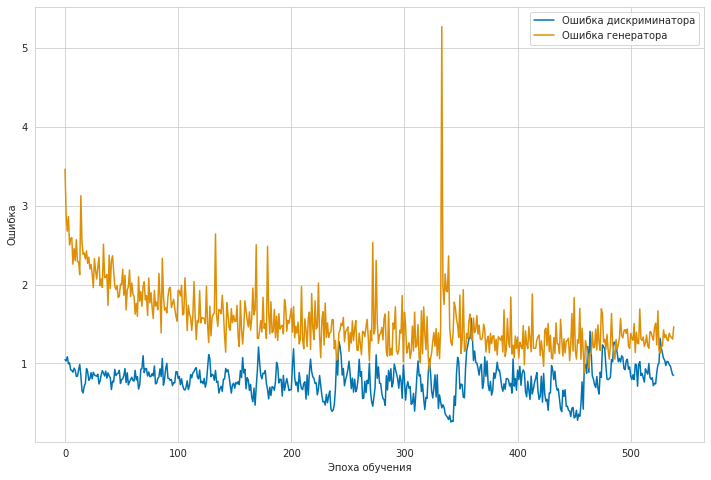

	...epoch 16 173/2500	batch 5/50	D loss: 0.754228	G loss: 1.554667
	...epoch 16 173/2500	batch 21/50	D loss: 0.835585	G loss: 1.128360
	...epoch 16 173/2500	batch 37/50	D loss: 0.767595	G loss: 1.260037


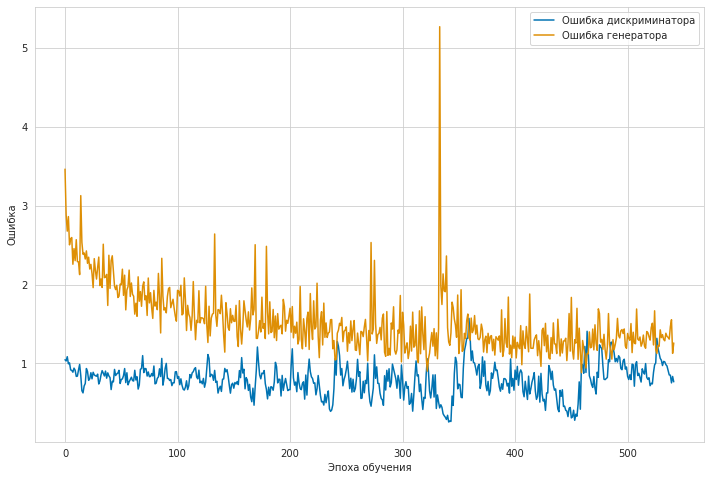

	...epoch 16 174/2500	batch 3/50	D loss: 0.791190	G loss: 1.392349
	...epoch 16 174/2500	batch 19/50	D loss: 0.869241	G loss: 1.327178
	...epoch 16 174/2500	batch 35/50	D loss: 0.824960	G loss: 1.280210


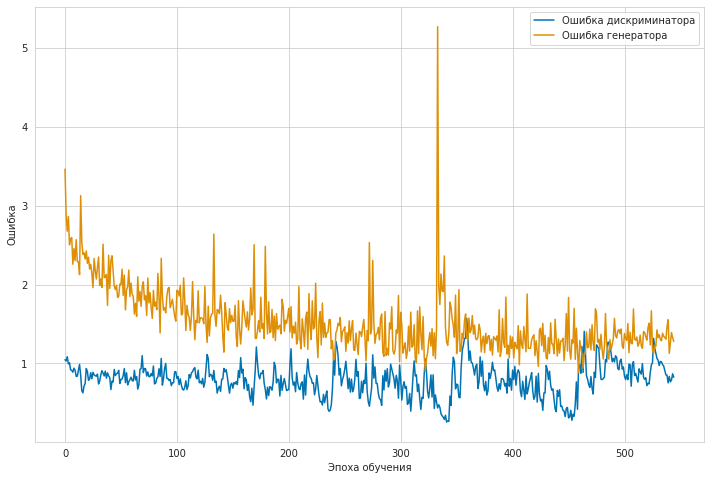

	...epoch 16 175/2500	batch 1/50	D loss: 0.880911	G loss: 1.313874
	...epoch 16 175/2500	batch 17/50	D loss: 0.706480	G loss: 1.361630
	...epoch 16 175/2500	batch 33/50	D loss: 0.667925	G loss: 1.265972
	...epoch 16 175/2500	batch 49/50	D loss: 0.795078	G loss: 1.145304


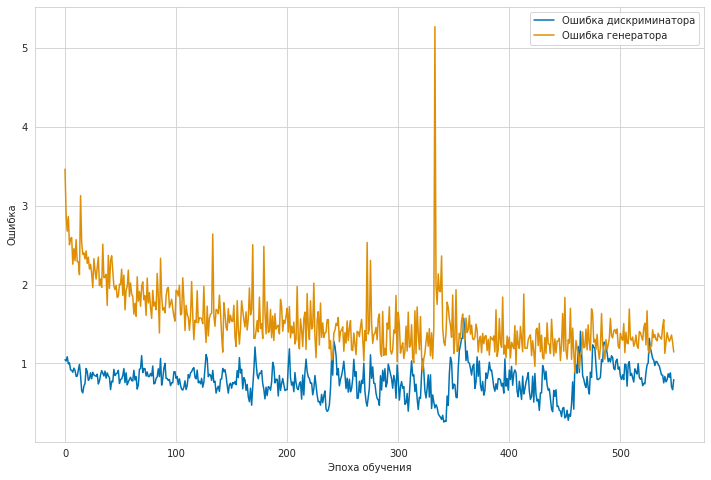

	...epoch 16 176/2500	batch 15/50	D loss: 0.838171	G loss: 1.627700
	...epoch 16 176/2500	batch 31/50	D loss: 0.827320	G loss: 1.083221
	...epoch 16 176/2500	batch 47/50	D loss: 0.991448	G loss: 1.139636


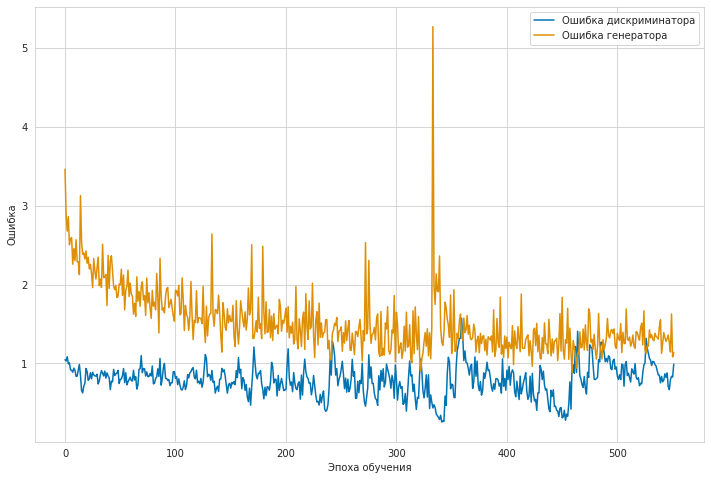

	...epoch 16 177/2500	batch 13/50	D loss: 0.782878	G loss: 1.500342
	...epoch 16 177/2500	batch 29/50	D loss: 0.770626	G loss: 1.173389
	...epoch 16 177/2500	batch 45/50	D loss: 1.019292	G loss: 1.126564


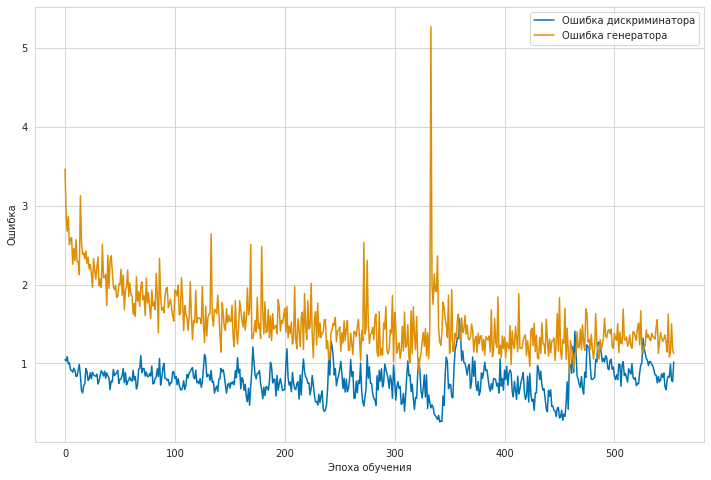

	...epoch 16 178/2500	batch 11/50	D loss: 0.918675	G loss: 1.400895
	...epoch 16 178/2500	batch 27/50	D loss: 0.776591	G loss: 1.210692
	...epoch 16 178/2500	batch 43/50	D loss: 0.829640	G loss: 1.297158


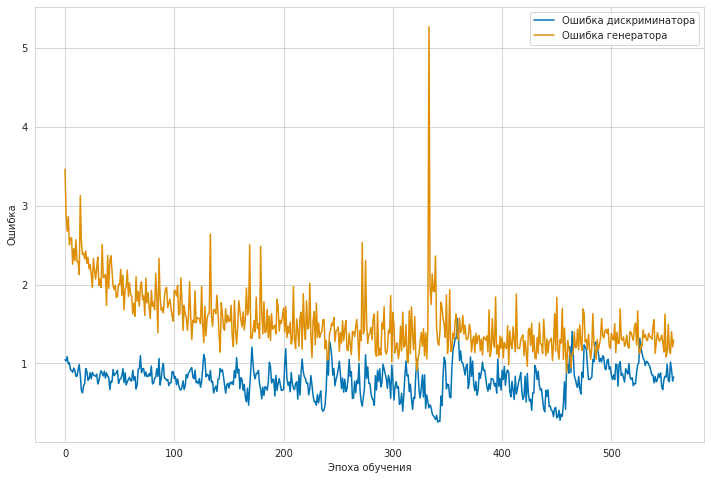

	...epoch 16 179/2500	batch 9/50	D loss: 0.953511	G loss: 1.459661
	...epoch 16 179/2500	batch 25/50	D loss: 0.810758	G loss: 1.351951
	...epoch 16 179/2500	batch 41/50	D loss: 0.807194	G loss: 1.401183


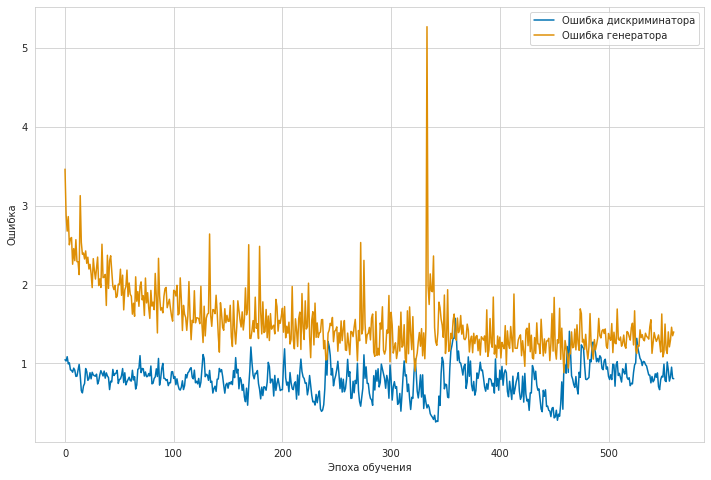

	...epoch 16 180/2500	batch 7/50	D loss: 0.678469	G loss: 1.498768
	...epoch 16 180/2500	batch 23/50	D loss: 0.658055	G loss: 1.383203
	...epoch 16 180/2500	batch 39/50	D loss: 0.628376	G loss: 1.452124


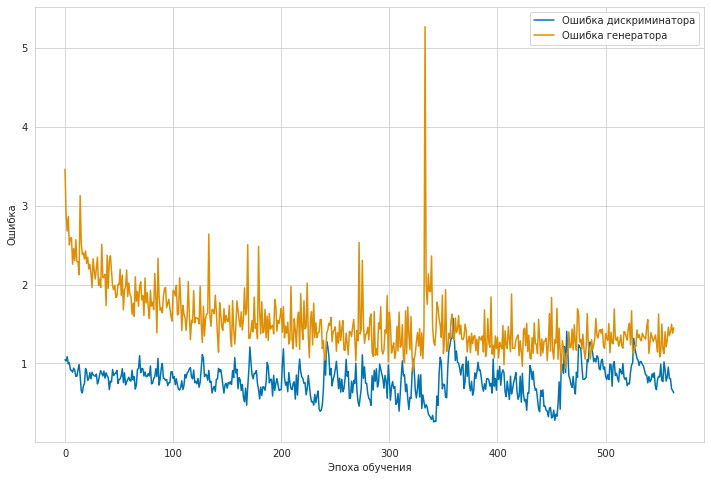

	...epoch 16 181/2500	batch 5/50	D loss: 0.634928	G loss: 1.330543
	...epoch 16 181/2500	batch 21/50	D loss: 0.776676	G loss: 1.278781
	...epoch 16 181/2500	batch 37/50	D loss: 0.686986	G loss: 1.697811


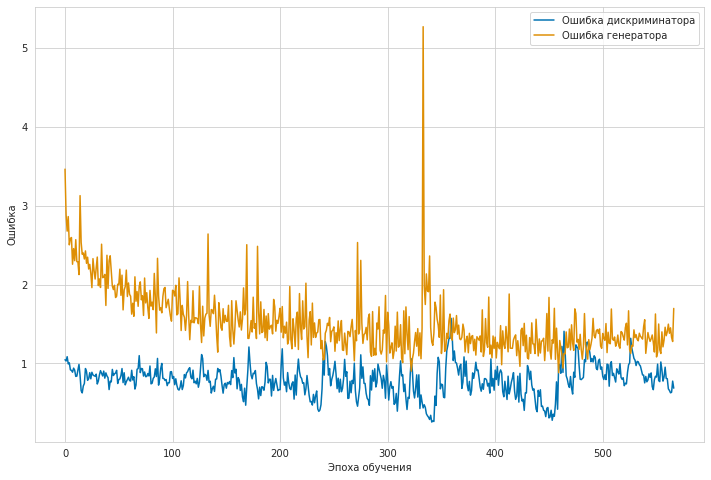

	...epoch 16 182/2500	batch 3/50	D loss: 0.642497	G loss: 1.209635
	...epoch 16 182/2500	batch 19/50	D loss: 0.690070	G loss: 1.128017
	...epoch 16 182/2500	batch 35/50	D loss: 0.713868	G loss: 1.683699


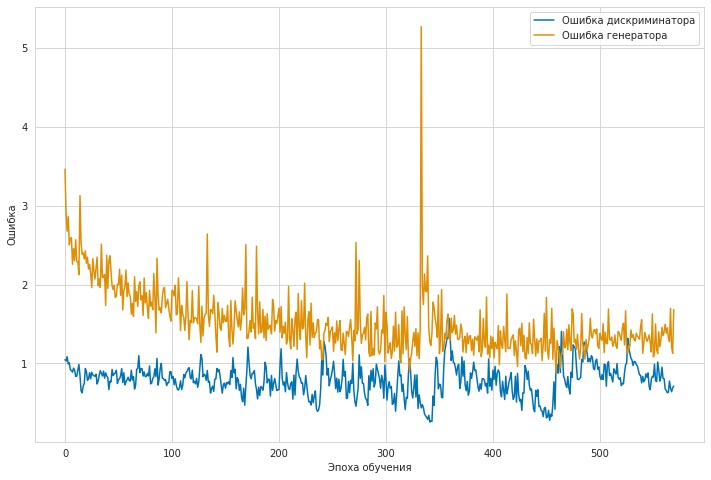

	...epoch 16 183/2500	batch 1/50	D loss: 0.945090	G loss: 1.214271
	...epoch 16 183/2500	batch 17/50	D loss: 1.124554	G loss: 1.111834
	...epoch 16 183/2500	batch 33/50	D loss: 0.901502	G loss: 1.191957
	...epoch 16 183/2500	batch 49/50	D loss: 0.815407	G loss: 1.306293


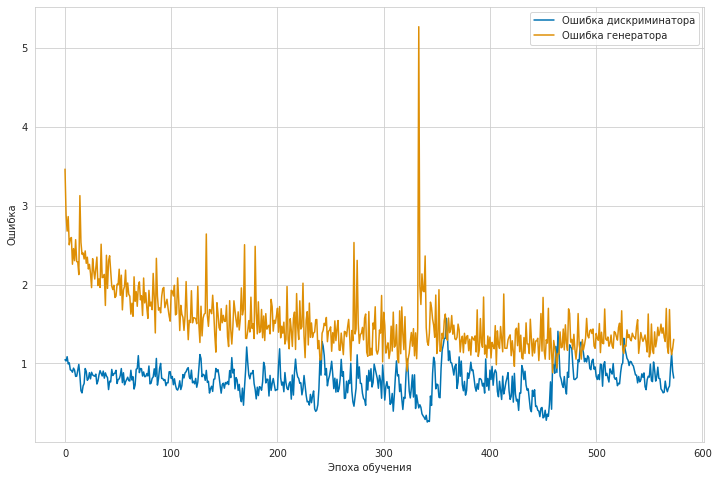

	...epoch 16 184/2500	batch 15/50	D loss: 0.918850	G loss: 1.168161
	...epoch 16 184/2500	batch 31/50	D loss: 0.741185	G loss: 1.461511
	...epoch 16 184/2500	batch 47/50	D loss: 0.727453	G loss: 1.035987


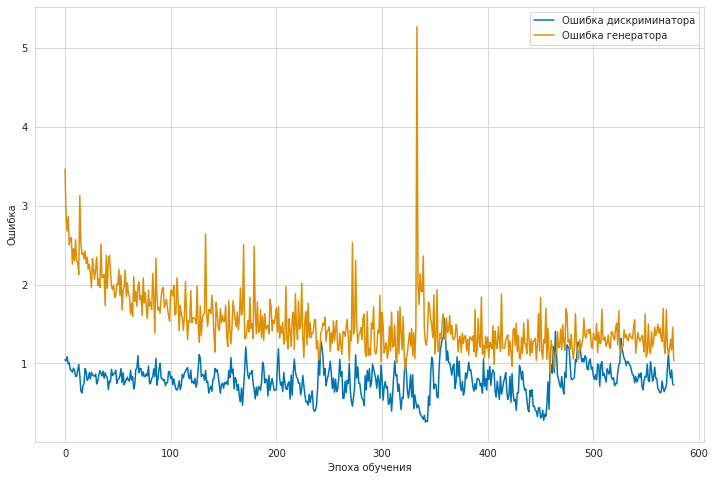

	...epoch 16 185/2500	batch 13/50	D loss: 0.740888	G loss: 1.517597
	...epoch 16 185/2500	batch 29/50	D loss: 0.815132	G loss: 1.786203
	...epoch 16 185/2500	batch 45/50	D loss: 0.746591	G loss: 1.116434


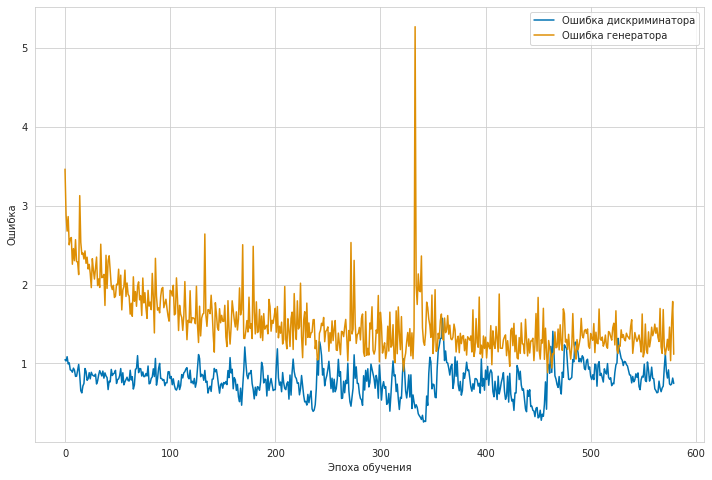

	...epoch 16 186/2500	batch 11/50	D loss: 0.651803	G loss: 1.242793
	...epoch 16 186/2500	batch 27/50	D loss: 0.611605	G loss: 1.367613
	...epoch 16 186/2500	batch 43/50	D loss: 0.649023	G loss: 1.134086


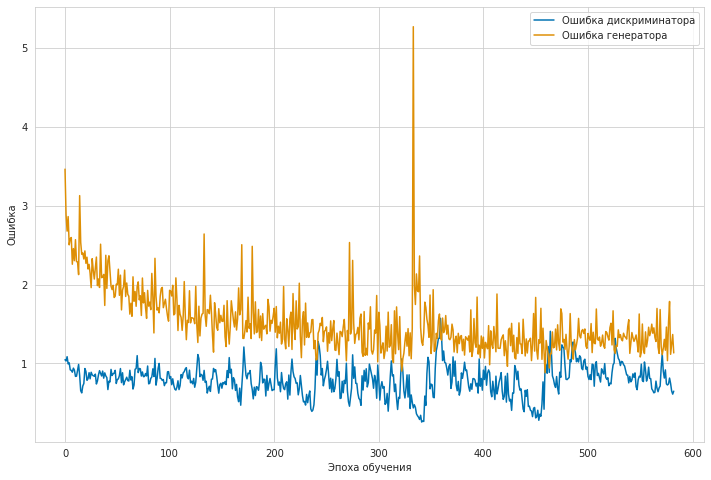

	...epoch 16 187/2500	batch 9/50	D loss: 0.561172	G loss: 0.996632
	...epoch 16 187/2500	batch 25/50	D loss: 0.638424	G loss: 1.495744
	...epoch 16 187/2500	batch 41/50	D loss: 0.617197	G loss: 0.979995


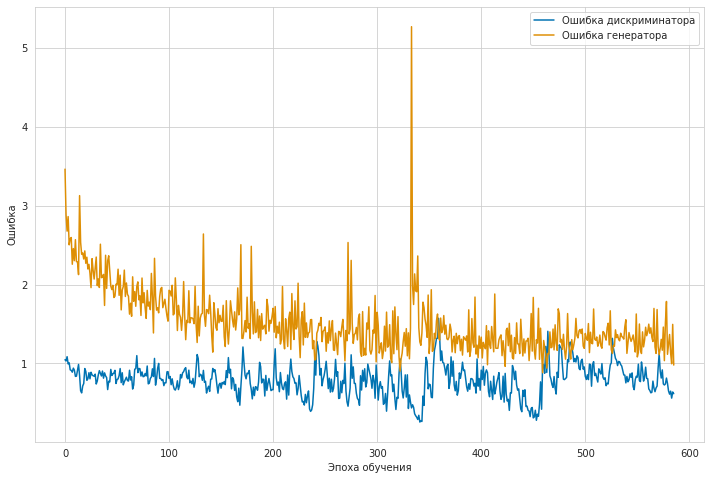

	...epoch 16 188/2500	batch 7/50	D loss: 0.605993	G loss: 1.079662
	...epoch 16 188/2500	batch 23/50	D loss: 0.572680	G loss: 1.153307
	...epoch 16 188/2500	batch 39/50	D loss: 0.982850	G loss: 0.883389


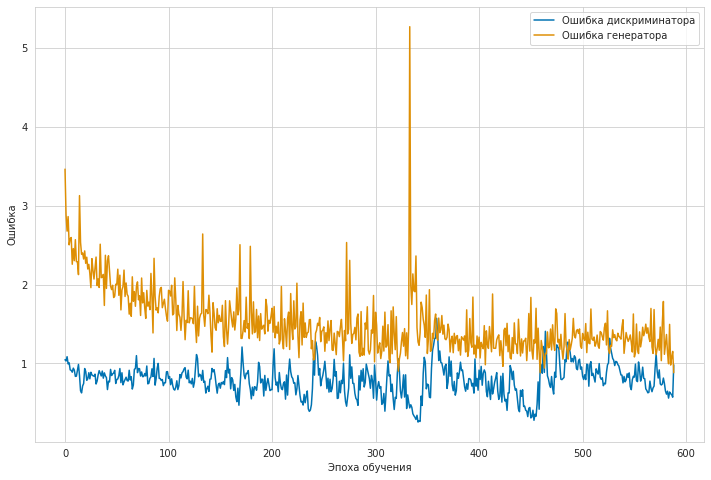

	...epoch 16 189/2500	batch 5/50	D loss: 0.784852	G loss: 1.609848
	...epoch 16 189/2500	batch 21/50	D loss: 0.999077	G loss: 1.368106
	...epoch 16 189/2500	batch 37/50	D loss: 1.041353	G loss: 1.365999


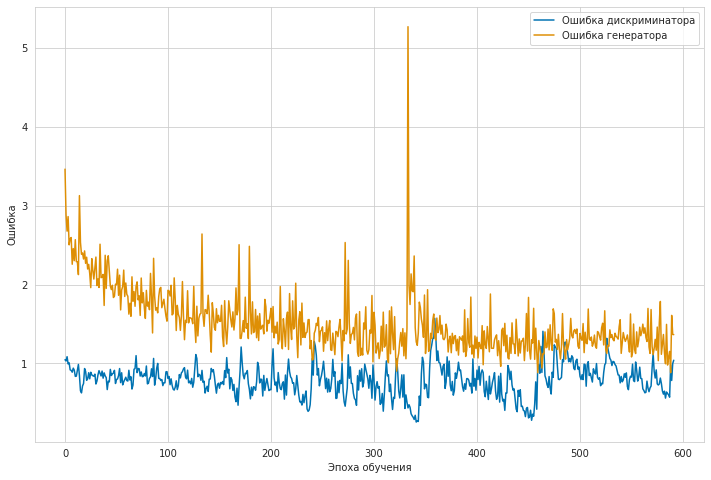

	...epoch 16 190/2500	batch 3/50	D loss: 1.052768	G loss: 0.904323
	...epoch 16 190/2500	batch 19/50	D loss: 0.920414	G loss: 1.204863
	...epoch 16 190/2500	batch 35/50	D loss: 0.899225	G loss: 1.134841


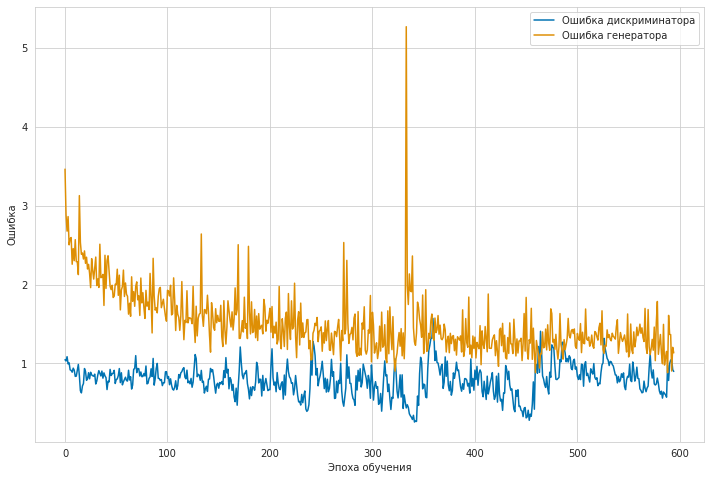

	...epoch 16 191/2500	batch 1/50	D loss: 0.916679	G loss: 1.360165
	...epoch 16 191/2500	batch 17/50	D loss: 0.944973	G loss: 1.287941
	...epoch 16 191/2500	batch 33/50	D loss: 0.700120	G loss: 1.288805
	...epoch 16 191/2500	batch 49/50	D loss: 0.751528	G loss: 1.199780


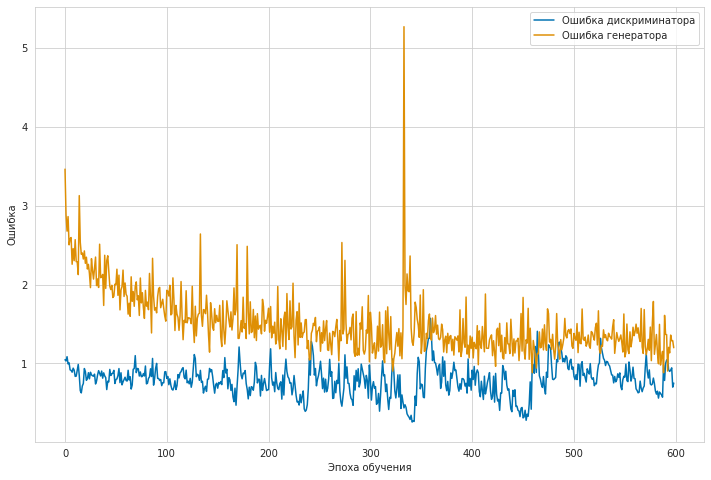

	...epoch 16 192/2500	batch 15/50	D loss: 0.740407	G loss: 1.274299
	...epoch 16 192/2500	batch 31/50	D loss: 0.855971	G loss: 1.244865
	...epoch 16 192/2500	batch 47/50	D loss: 0.836317	G loss: 1.678041


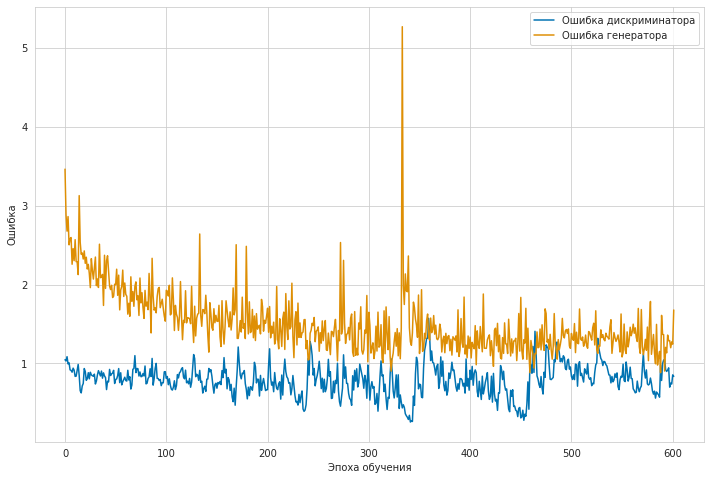

	...epoch 16 193/2500	batch 13/50	D loss: 0.989506	G loss: 1.123150
	...epoch 16 193/2500	batch 29/50	D loss: 0.859308	G loss: 1.232963
	...epoch 16 193/2500	batch 45/50	D loss: 0.752404	G loss: 1.374484


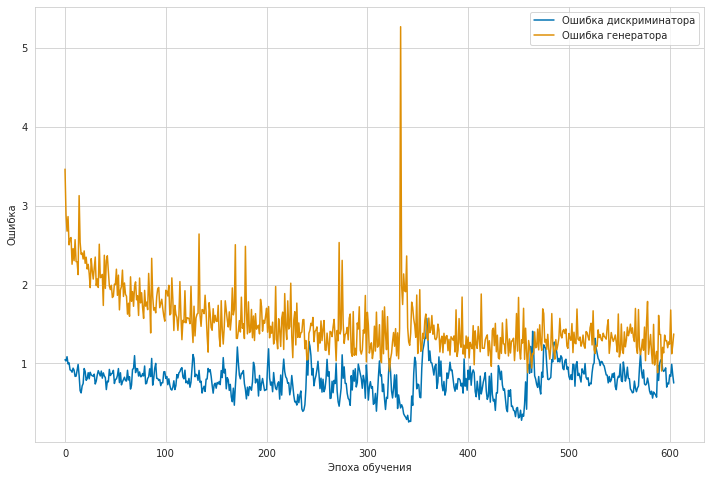

	...epoch 16 194/2500	batch 11/50	D loss: 0.965564	G loss: 1.186220
	...epoch 16 194/2500	batch 27/50	D loss: 0.794490	G loss: 1.551919
	...epoch 16 194/2500	batch 43/50	D loss: 0.722066	G loss: 1.232619


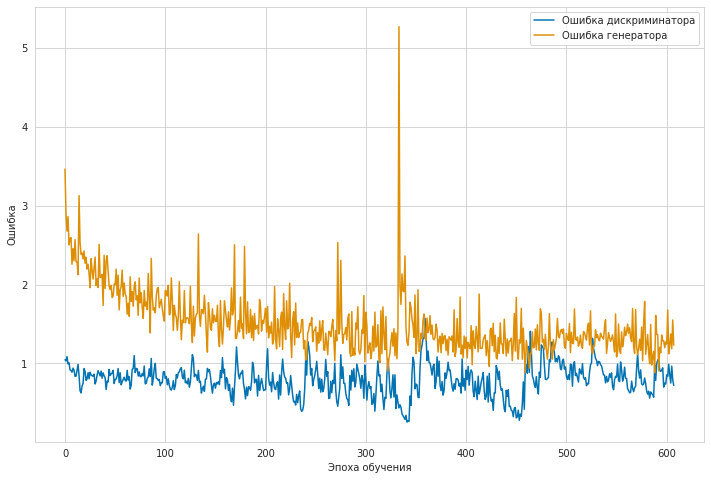

	...epoch 16 195/2500	batch 9/50	D loss: 0.662505	G loss: 1.337849
	...epoch 16 195/2500	batch 25/50	D loss: 0.667043	G loss: 1.102365
	...epoch 16 195/2500	batch 41/50	D loss: 0.659768	G loss: 1.297396


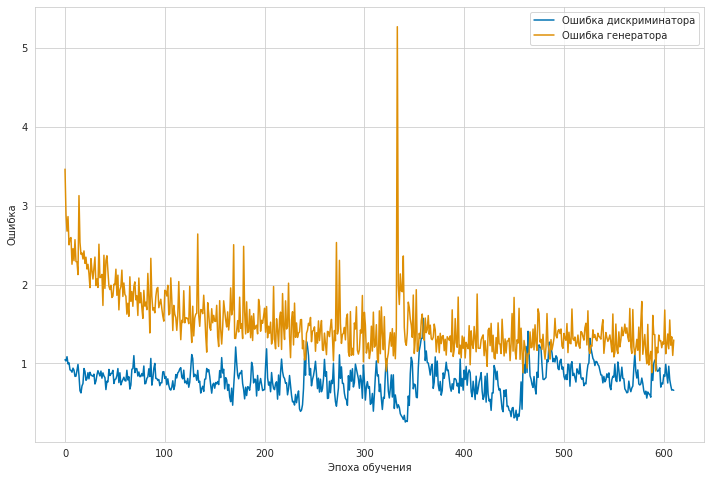

	...epoch 16 196/2500	batch 7/50	D loss: 0.593523	G loss: 1.227231
	...epoch 16 196/2500	batch 23/50	D loss: 0.606238	G loss: 1.252754
	...epoch 16 196/2500	batch 39/50	D loss: 0.587765	G loss: 1.257103


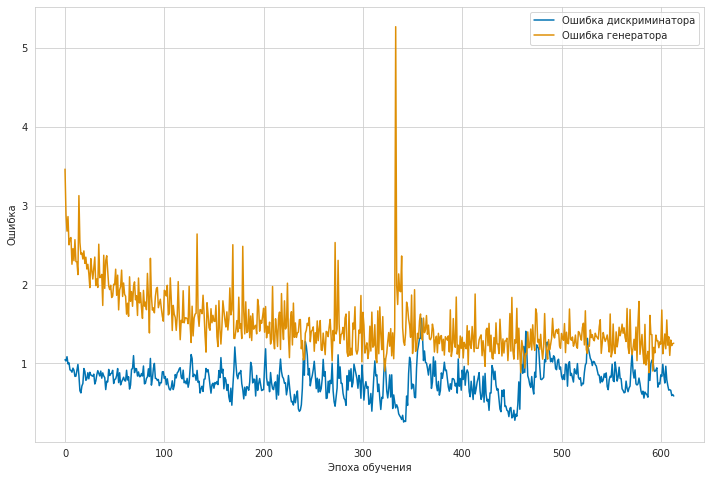

	...epoch 16 197/2500	batch 5/50	D loss: 0.525496	G loss: 1.295542
	...epoch 16 197/2500	batch 21/50	D loss: 0.764107	G loss: 1.159169
	...epoch 16 197/2500	batch 37/50	D loss: 0.887063	G loss: 1.542150


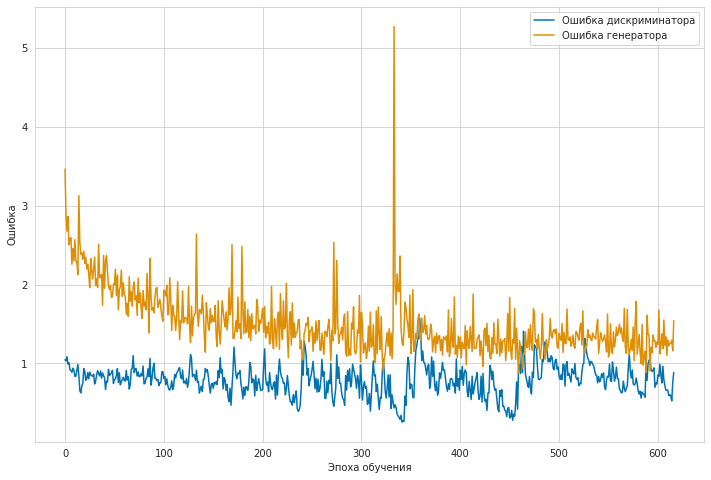

	...epoch 16 198/2500	batch 3/50	D loss: 0.962654	G loss: 1.018619
	...epoch 16 198/2500	batch 19/50	D loss: 1.118111	G loss: 0.936836
	...epoch 16 198/2500	batch 35/50	D loss: 0.895994	G loss: 0.984192


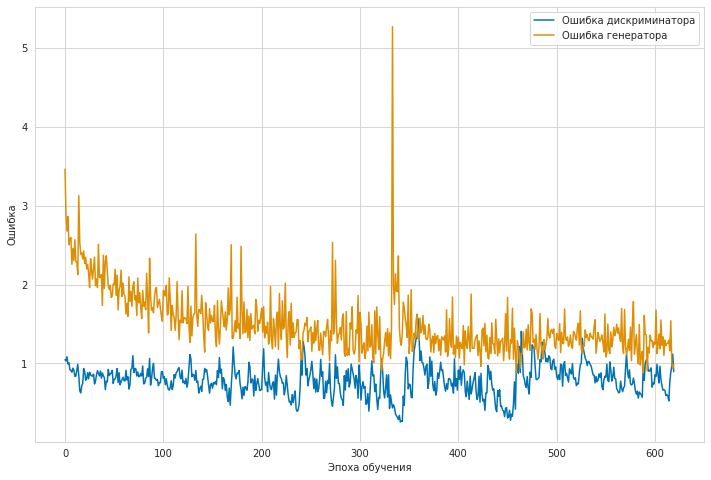

	...epoch 16 199/2500	batch 1/50	D loss: 0.880136	G loss: 1.113076
	...epoch 16 199/2500	batch 17/50	D loss: 0.737979	G loss: 1.273584
	...epoch 16 199/2500	batch 33/50	D loss: 0.682654	G loss: 1.214507
	...epoch 16 199/2500	batch 49/50	D loss: 1.055891	G loss: 1.167411


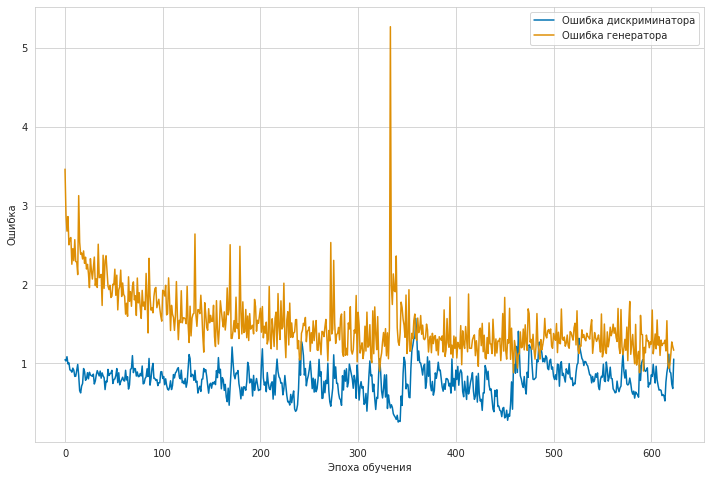

	...epoch 16 200/2500	batch 15/50	D loss: 0.937896	G loss: 1.506682
	...epoch 16 200/2500	batch 31/50	D loss: 1.109826	G loss: 1.622071
	...epoch 16 200/2500	batch 47/50	D loss: 1.124438	G loss: 1.187491


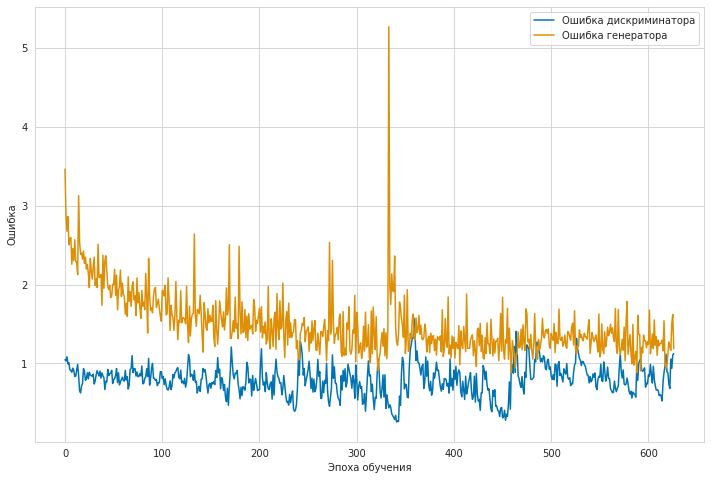

	...epoch 16 201/2500	batch 13/50	D loss: 1.057137	G loss: 1.062127
	...epoch 16 201/2500	batch 29/50	D loss: 0.986976	G loss: 1.286153
	...epoch 16 201/2500	batch 45/50	D loss: 0.727193	G loss: 1.241451


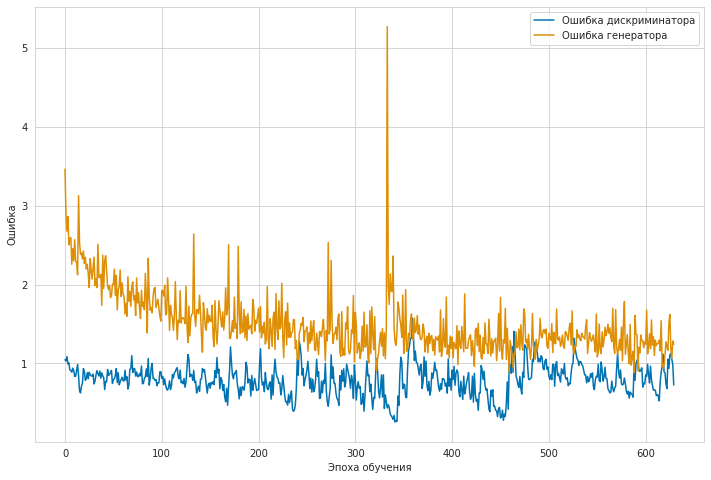

	...epoch 16 202/2500	batch 11/50	D loss: 0.837247	G loss: 1.267283
	...epoch 16 202/2500	batch 27/50	D loss: 0.685228	G loss: 1.444096
	...epoch 16 202/2500	batch 43/50	D loss: 0.599919	G loss: 1.543998


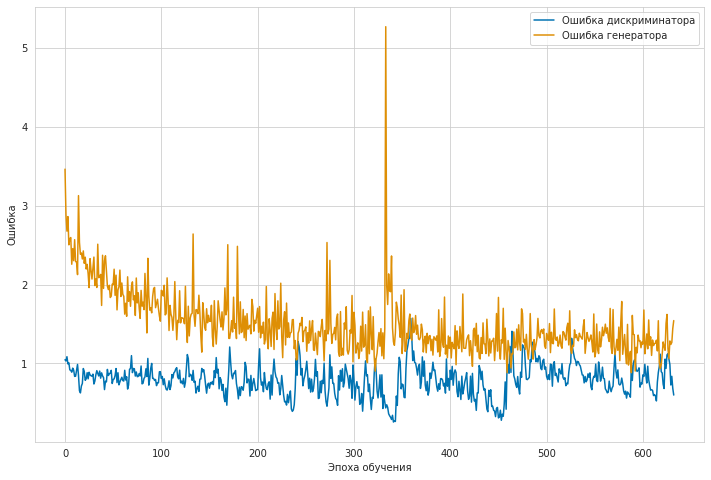

	...epoch 16 203/2500	batch 9/50	D loss: 0.583707	G loss: 1.331293
	...epoch 16 203/2500	batch 25/50	D loss: 0.693047	G loss: 1.247224
	...epoch 16 203/2500	batch 41/50	D loss: 0.662744	G loss: 1.305271


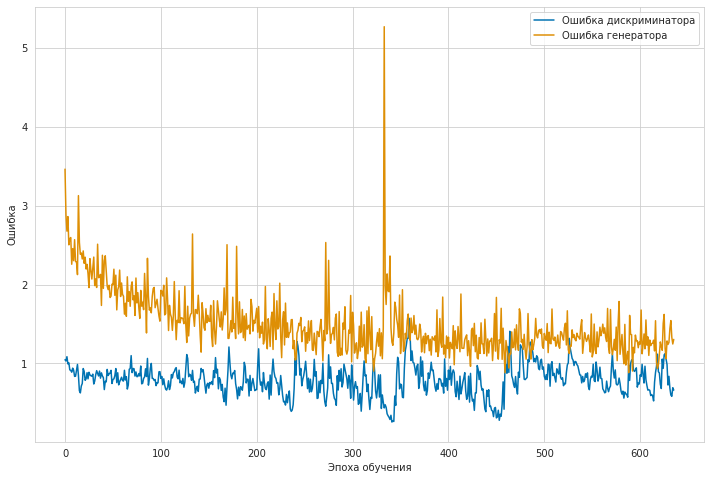

	...epoch 16 204/2500	batch 7/50	D loss: 0.578954	G loss: 1.239709
	...epoch 16 204/2500	batch 23/50	D loss: 0.821904	G loss: 1.369533
	...epoch 16 204/2500	batch 39/50	D loss: 0.809769	G loss: 1.798643


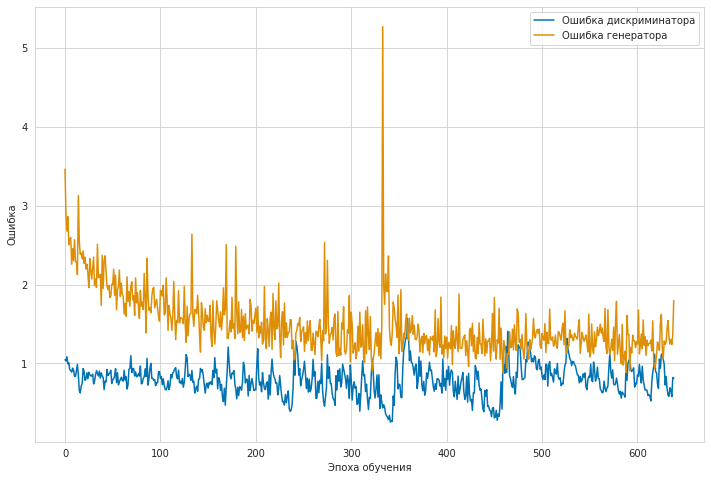

	...epoch 16 205/2500	batch 5/50	D loss: 1.161322	G loss: 1.726549
	...epoch 16 205/2500	batch 21/50	D loss: 1.132453	G loss: 1.350434
	...epoch 16 205/2500	batch 37/50	D loss: 1.319351	G loss: 1.185491


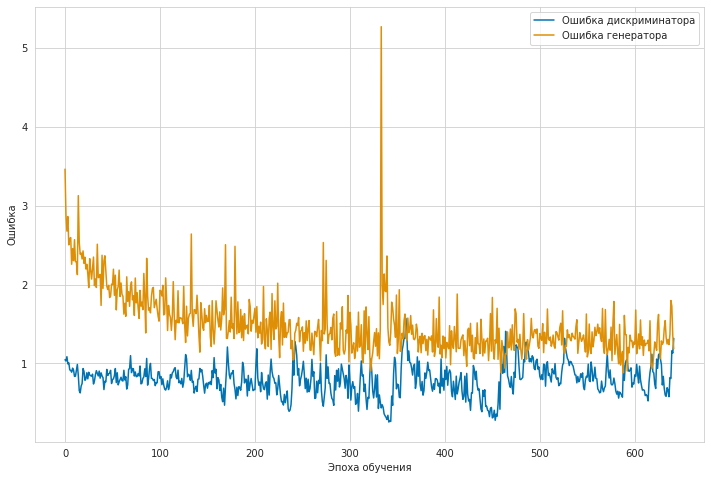

	...epoch 16 206/2500	batch 3/50	D loss: 0.945233	G loss: 1.306291
	...epoch 16 206/2500	batch 19/50	D loss: 0.941141	G loss: 1.312211
	...epoch 16 206/2500	batch 35/50	D loss: 0.874626	G loss: 1.320174


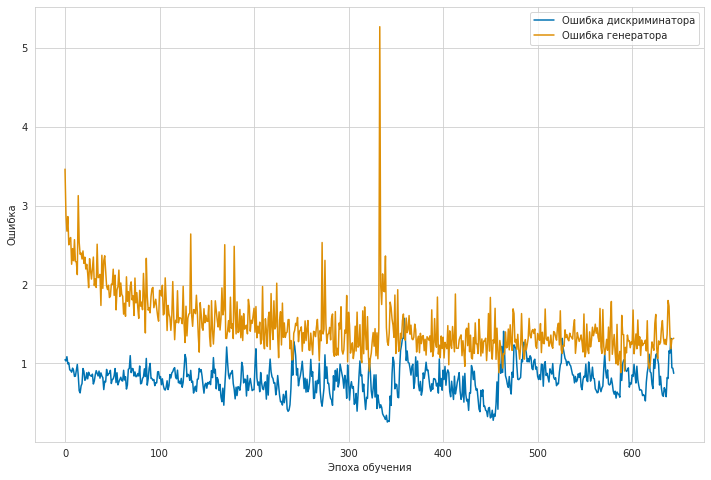

	...epoch 16 207/2500	batch 1/50	D loss: 0.773962	G loss: 1.201659
	...epoch 16 207/2500	batch 17/50	D loss: 0.856690	G loss: 1.311634
	...epoch 16 207/2500	batch 33/50	D loss: 0.896291	G loss: 1.284775
	...epoch 16 207/2500	batch 49/50	D loss: 0.876113	G loss: 1.181235


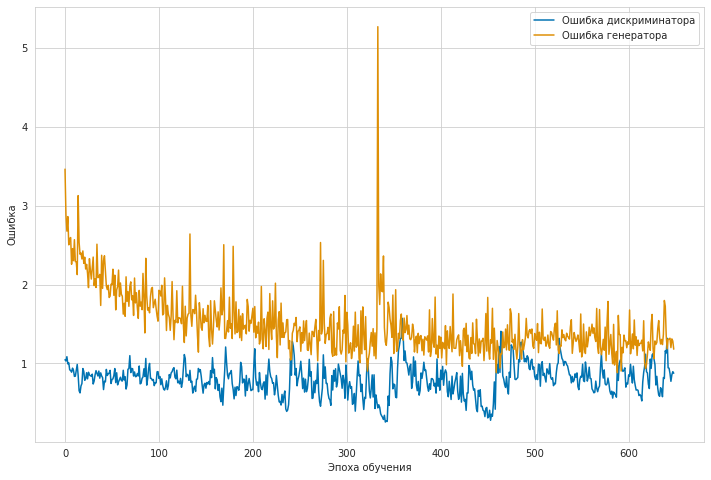

	...epoch 16 208/2500	batch 15/50	D loss: 0.923590	G loss: 1.647137
	...epoch 16 208/2500	batch 31/50	D loss: 0.765385	G loss: 1.084441
	...epoch 16 208/2500	batch 47/50	D loss: 0.955654	G loss: 1.332791


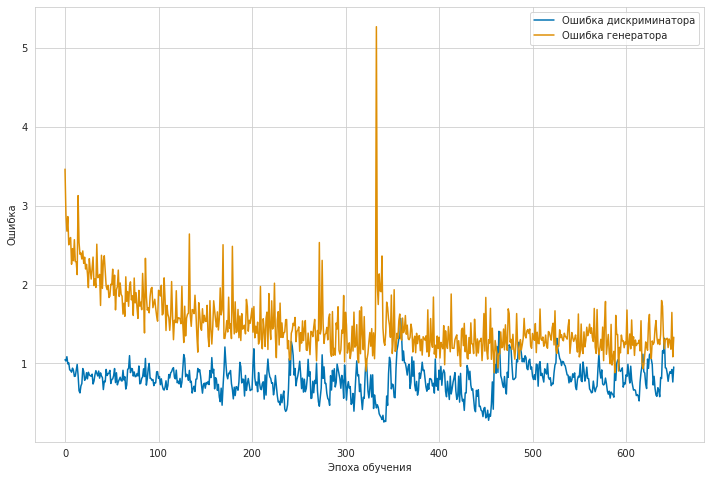

	...epoch 16 209/2500	batch 13/50	D loss: 0.755744	G loss: 1.057317
	...epoch 16 209/2500	batch 29/50	D loss: 0.893427	G loss: 1.448448
	...epoch 16 209/2500	batch 45/50	D loss: 1.010443	G loss: 1.134938


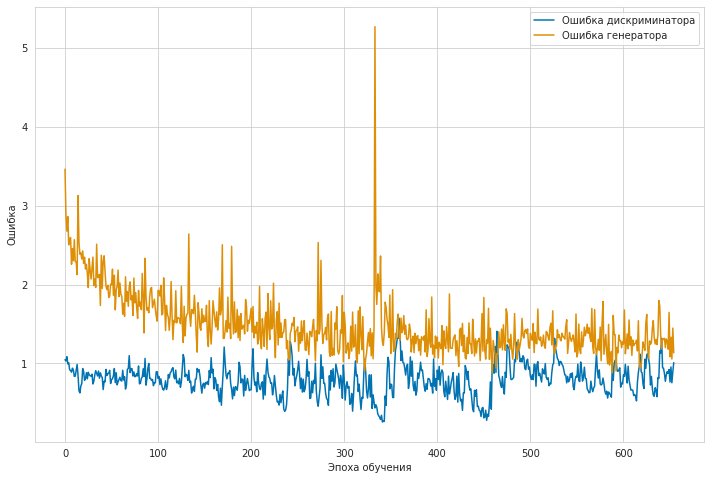

	...epoch 16 210/2500	batch 11/50	D loss: 0.870911	G loss: 1.308412
	...epoch 16 210/2500	batch 27/50	D loss: 0.667596	G loss: 1.214200
	...epoch 16 210/2500	batch 43/50	D loss: 0.432181	G loss: 2.848011


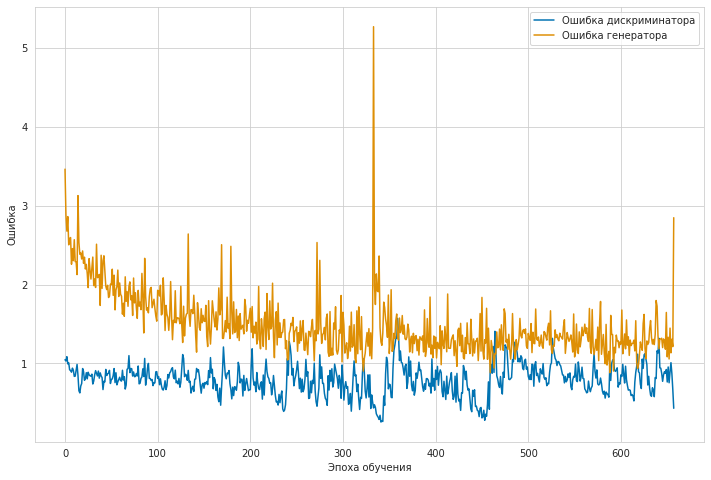

	...epoch 16 211/2500	batch 9/50	D loss: 0.442035	G loss: 2.372716
	...epoch 16 211/2500	batch 25/50	D loss: 0.469976	G loss: 1.826124
	...epoch 16 211/2500	batch 41/50	D loss: 0.348826	G loss: 1.908475


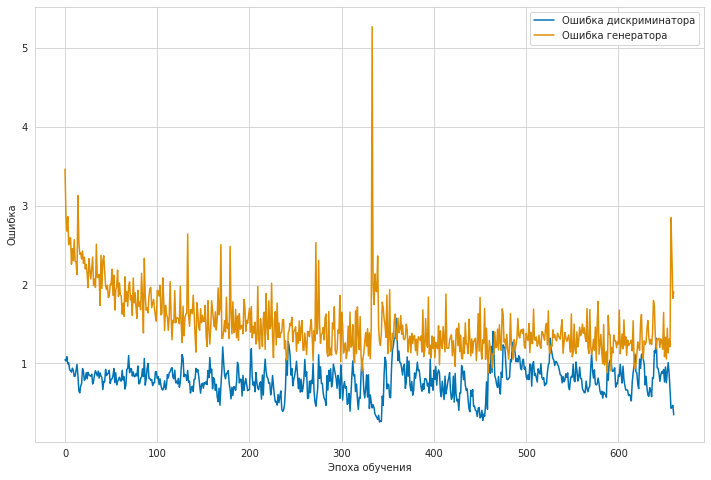

	...epoch 16 212/2500	batch 7/50	D loss: 0.341940	G loss: 1.666937
	...epoch 16 212/2500	batch 23/50	D loss: 0.384141	G loss: 1.695886
	...epoch 16 212/2500	batch 39/50	D loss: 0.514338	G loss: 1.540469


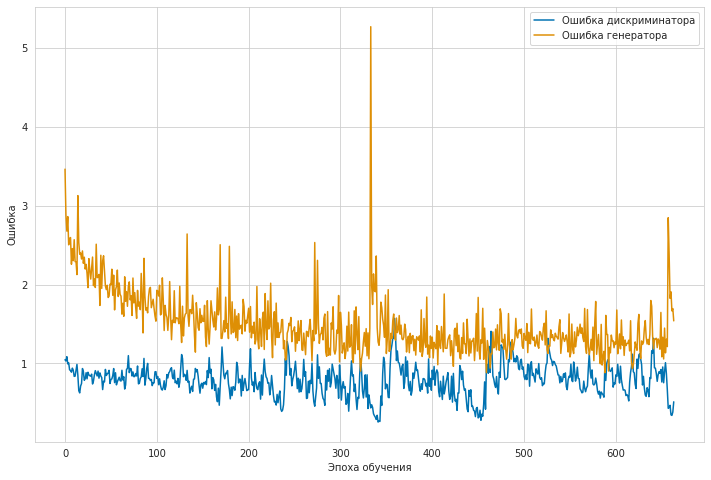

	...epoch 16 213/2500	batch 5/50	D loss: 0.404188	G loss: 1.280964
	...epoch 16 213/2500	batch 21/50	D loss: 0.499935	G loss: 1.377771
	...epoch 16 213/2500	batch 37/50	D loss: 0.625288	G loss: 1.564670


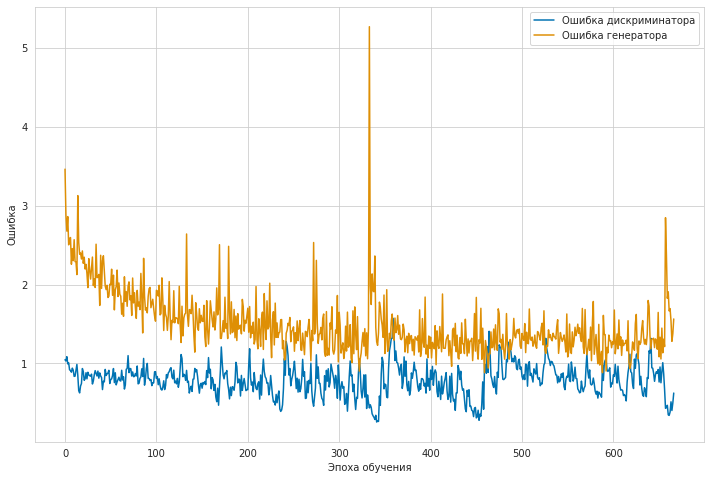

	...epoch 16 214/2500	batch 3/50	D loss: 0.854578	G loss: 1.028944
	...epoch 16 214/2500	batch 19/50	D loss: 0.772466	G loss: 1.774570
	...epoch 16 214/2500	batch 35/50	D loss: 0.802771	G loss: 1.113534


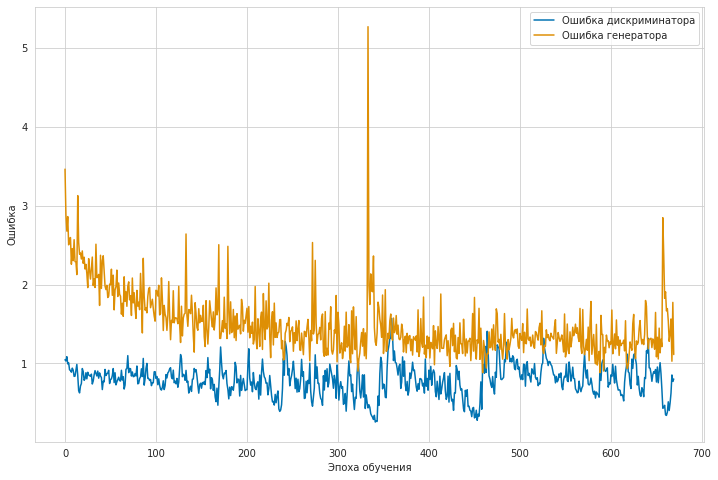

	...epoch 16 215/2500	batch 1/50	D loss: 0.892801	G loss: 0.974671
	...epoch 16 215/2500	batch 17/50	D loss: 0.877159	G loss: 1.060347
	...epoch 16 215/2500	batch 33/50	D loss: 0.564750	G loss: 1.326715
	...epoch 16 215/2500	batch 49/50	D loss: 0.712626	G loss: 0.948469


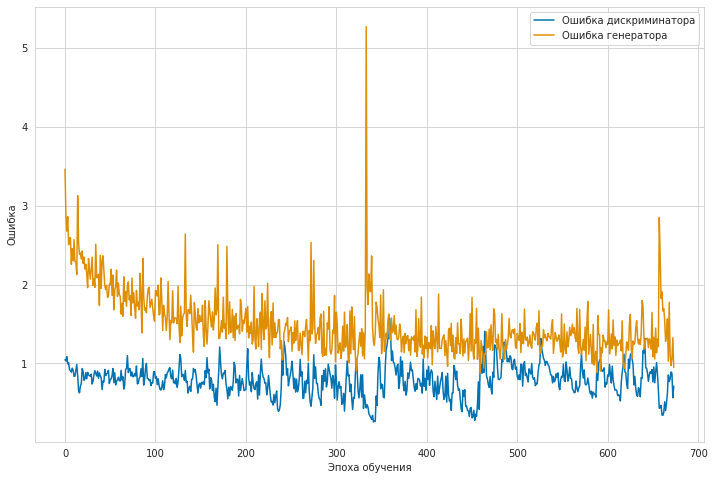

	...epoch 16 216/2500	batch 15/50	D loss: 0.570068	G loss: 0.959829
	...epoch 16 216/2500	batch 31/50	D loss: 0.733713	G loss: 0.840091
	...epoch 16 216/2500	batch 47/50	D loss: 0.846260	G loss: 1.861337


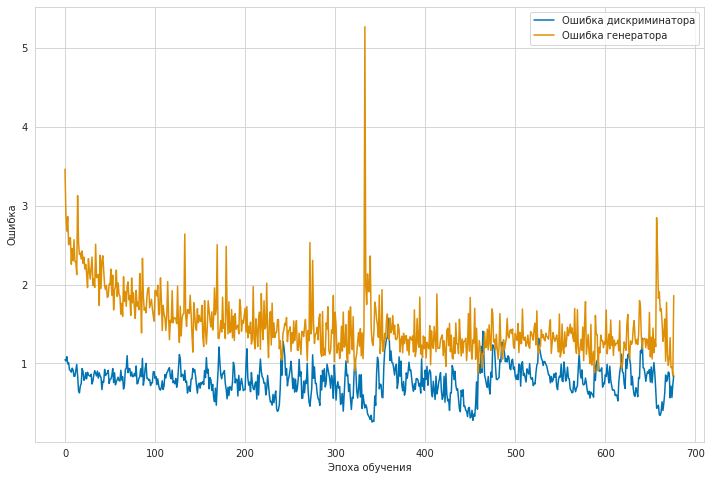

	...epoch 16 217/2500	batch 13/50	D loss: 0.947762	G loss: 1.246946
	...epoch 16 217/2500	batch 29/50	D loss: 0.782877	G loss: 0.874704
	...epoch 16 217/2500	batch 45/50	D loss: 0.827727	G loss: 1.172061


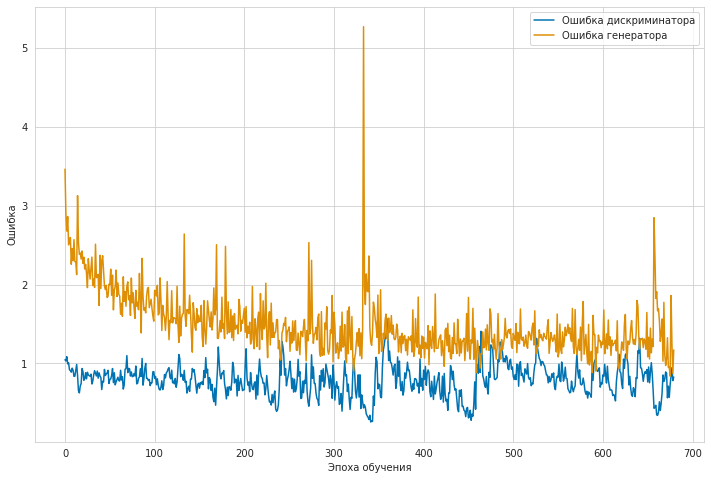

	...epoch 16 218/2500	batch 11/50	D loss: 0.562134	G loss: 1.040629
	...epoch 16 218/2500	batch 27/50	D loss: 0.539134	G loss: 1.017236
	...epoch 16 218/2500	batch 43/50	D loss: 0.513566	G loss: 1.269367


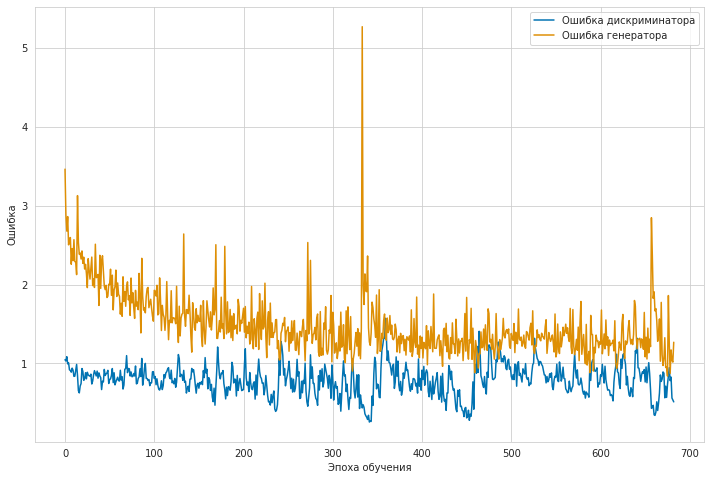

	...epoch 16 219/2500	batch 9/50	D loss: 0.428301	G loss: 1.179836
	...epoch 16 219/2500	batch 25/50	D loss: 0.429399	G loss: 1.449861
	...epoch 16 219/2500	batch 41/50	D loss: 0.784132	G loss: 0.907164


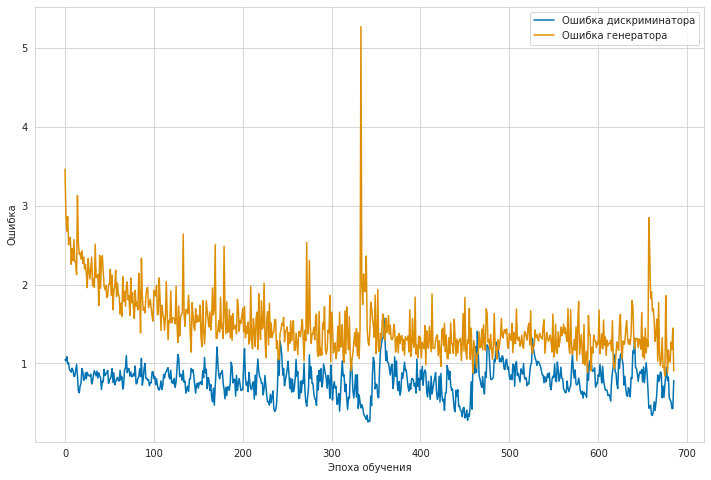

	...epoch 16 220/2500	batch 7/50	D loss: 0.739269	G loss: 1.354699
	...epoch 16 220/2500	batch 23/50	D loss: 0.593673	G loss: 1.230307
	...epoch 16 220/2500	batch 39/50	D loss: 1.041078	G loss: 0.974011


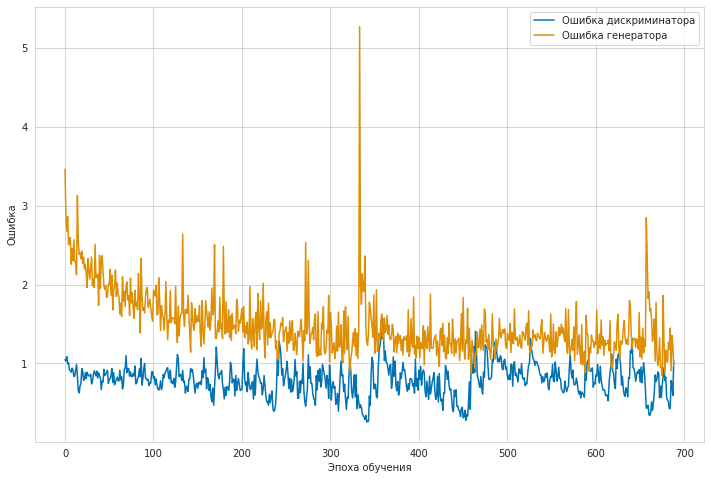

	...epoch 16 221/2500	batch 5/50	D loss: 0.841819	G loss: 1.164440
	...epoch 16 221/2500	batch 21/50	D loss: 0.473654	G loss: 0.995018
	...epoch 16 221/2500	batch 37/50	D loss: 0.660701	G loss: 0.998328


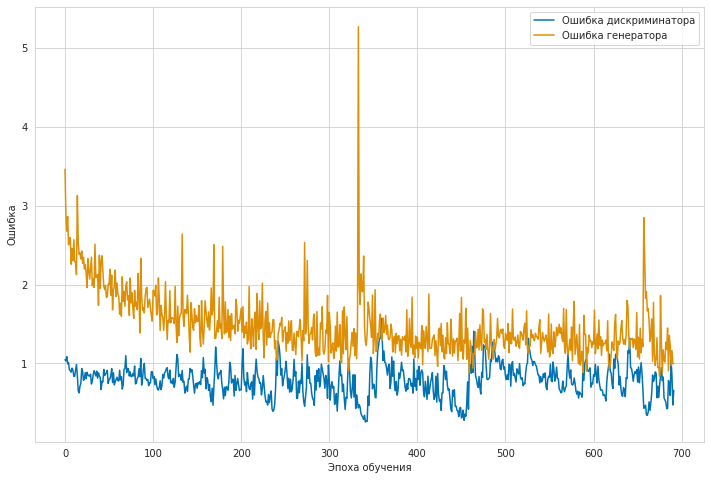

	...epoch 16 222/2500	batch 3/50	D loss: 0.626874	G loss: 1.564839
	...epoch 16 222/2500	batch 19/50	D loss: 0.619755	G loss: 0.993496
	...epoch 16 222/2500	batch 35/50	D loss: 0.619087	G loss: 1.215927


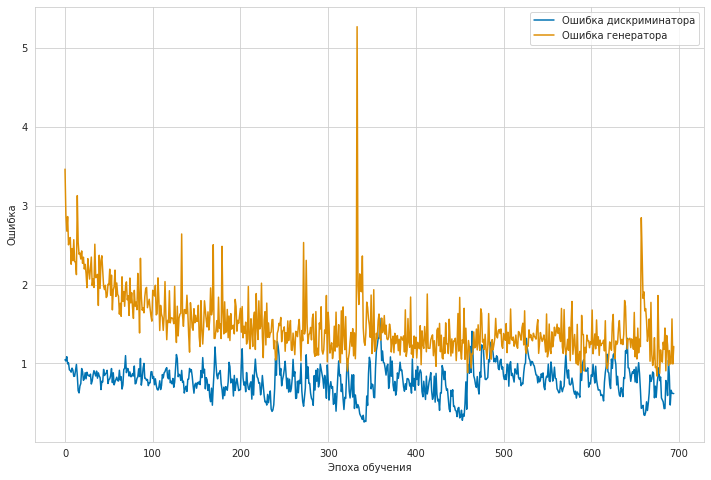

	...epoch 16 223/2500	batch 1/50	D loss: 0.686167	G loss: 1.090123
	...epoch 16 223/2500	batch 17/50	D loss: 0.936331	G loss: 0.999291
	...epoch 16 223/2500	batch 33/50	D loss: 1.009778	G loss: 0.902313
	...epoch 16 223/2500	batch 49/50	D loss: 0.740123	G loss: 1.077202


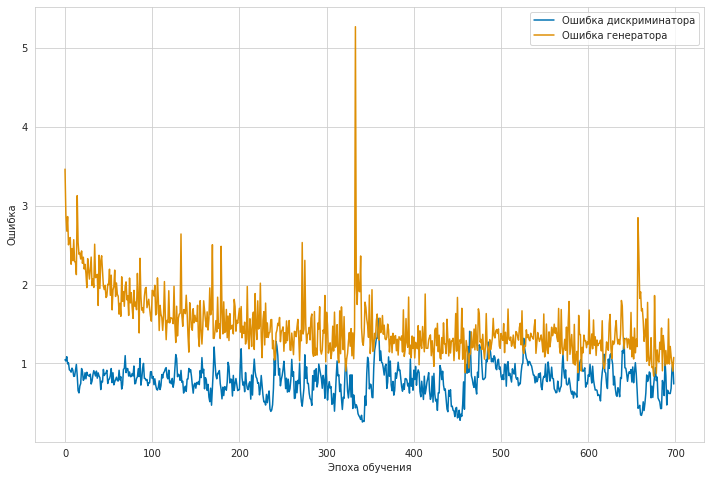

	...epoch 16 224/2500	batch 15/50	D loss: 0.850439	G loss: 1.444788
	...epoch 16 224/2500	batch 31/50	D loss: 0.620553	G loss: 1.089499
	...epoch 16 224/2500	batch 47/50	D loss: 0.862368	G loss: 1.175078


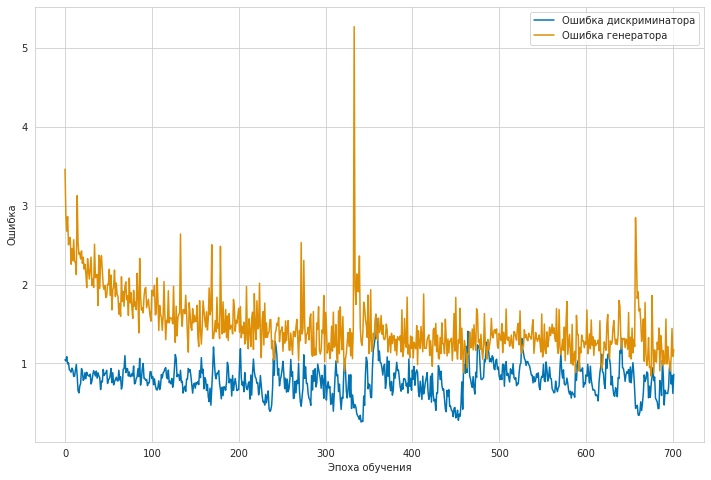

	...epoch 16 225/2500	batch 13/50	D loss: 0.626616	G loss: 1.245638
	...epoch 16 225/2500	batch 29/50	D loss: 0.503900	G loss: 1.216192
	...epoch 16 225/2500	batch 45/50	D loss: 0.650329	G loss: 1.183895


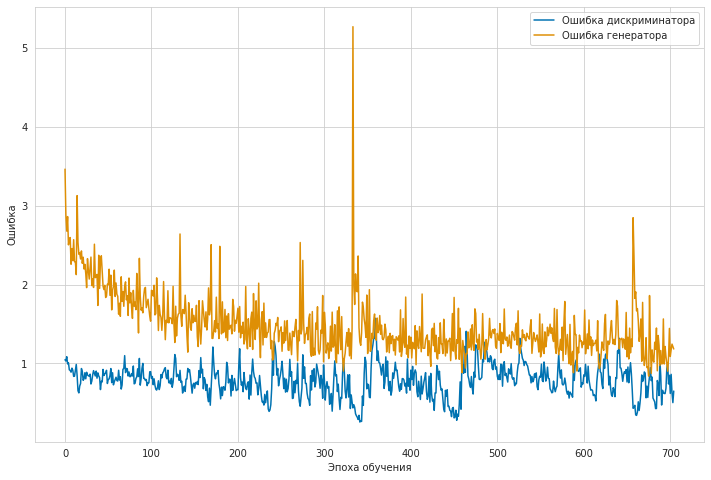

	...epoch 16 226/2500	batch 11/50	D loss: 0.645187	G loss: 1.099881
	...epoch 16 226/2500	batch 27/50	D loss: 0.793016	G loss: 1.464486
	...epoch 16 226/2500	batch 43/50	D loss: 0.890317	G loss: 0.941268


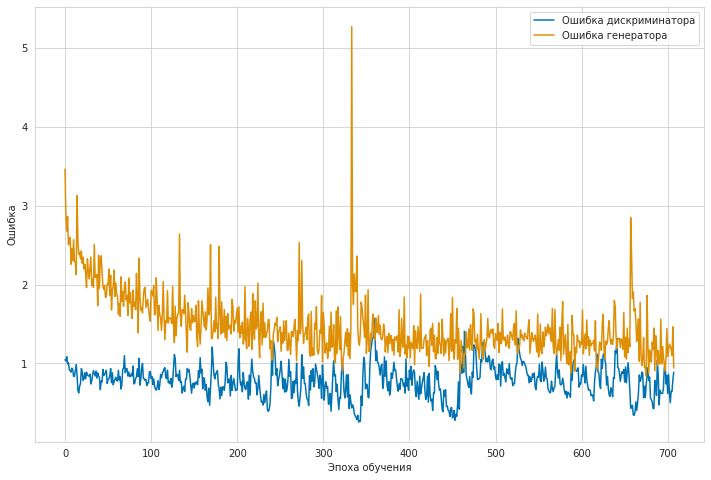

	...epoch 16 227/2500	batch 9/50	D loss: 0.627667	G loss: 1.306627
	...epoch 16 227/2500	batch 25/50	D loss: 0.661921	G loss: 1.141514
	...epoch 16 227/2500	batch 41/50	D loss: 0.816779	G loss: 0.955506


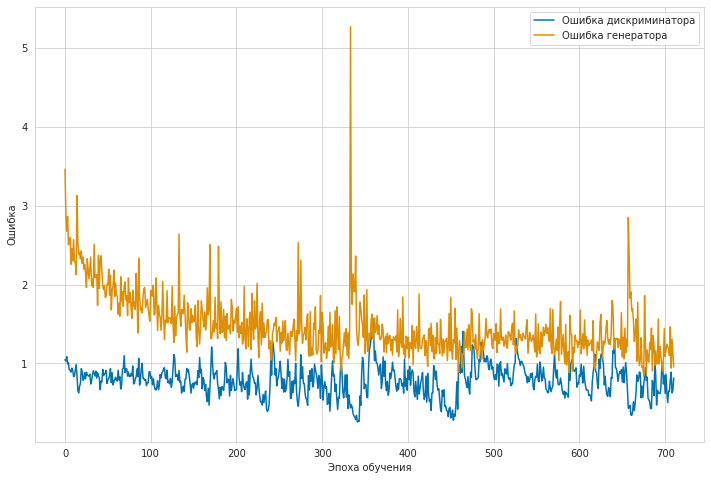

	...epoch 16 228/2500	batch 7/50	D loss: 0.744185	G loss: 0.975822
	...epoch 16 228/2500	batch 23/50	D loss: 0.704201	G loss: 1.349846
	...epoch 16 228/2500	batch 39/50	D loss: 0.545467	G loss: 0.968211


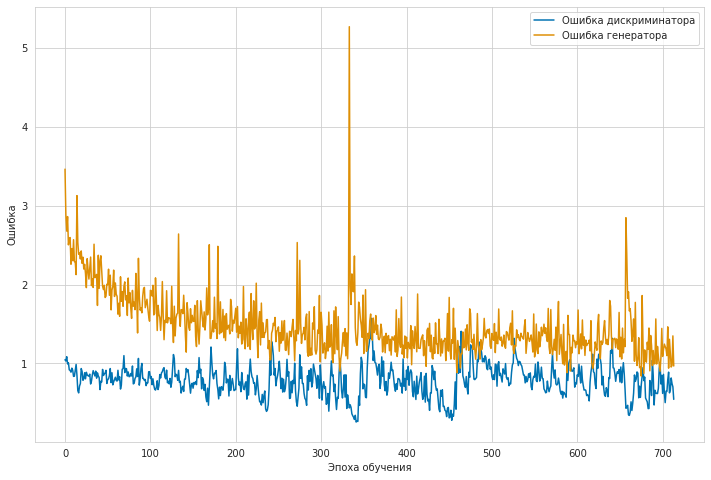

	...epoch 16 229/2500	batch 5/50	D loss: 0.882653	G loss: 1.150271
	...epoch 16 229/2500	batch 21/50	D loss: 1.123241	G loss: 1.448340
	...epoch 16 229/2500	batch 37/50	D loss: 0.681687	G loss: 1.202276


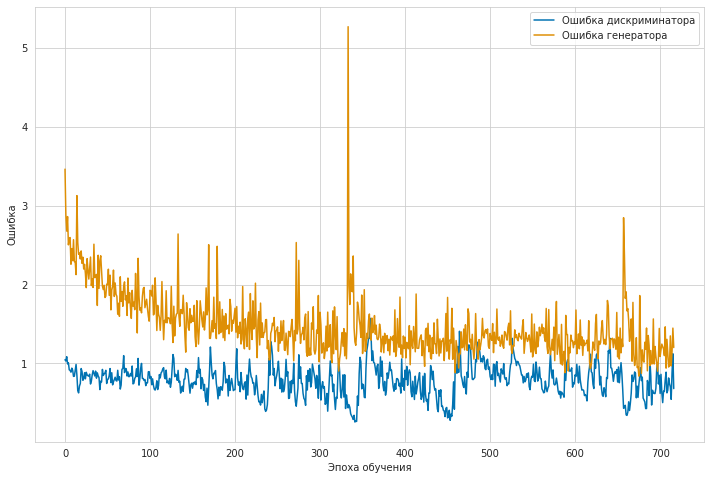

	...epoch 16 230/2500	batch 3/50	D loss: 0.857032	G loss: 1.143259
	...epoch 16 230/2500	batch 19/50	D loss: 0.847536	G loss: 1.081600
	...epoch 16 230/2500	batch 35/50	D loss: 1.038129	G loss: 0.815960


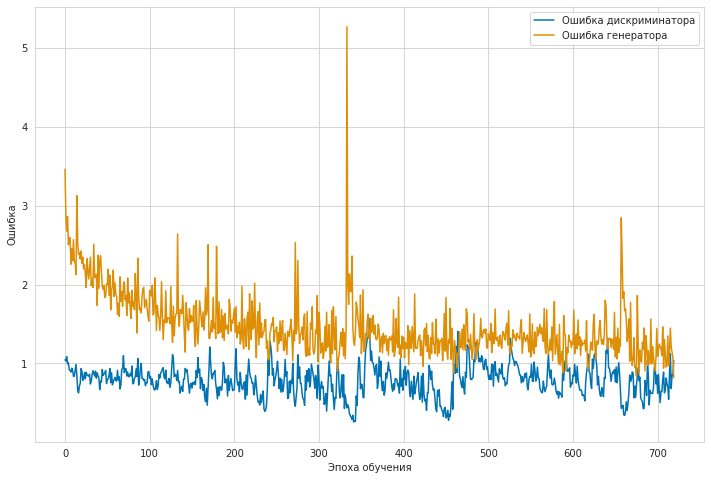

	...epoch 16 231/2500	batch 1/50	D loss: 0.988208	G loss: 0.947084
	...epoch 16 231/2500	batch 17/50	D loss: 0.816946	G loss: 1.209720
	...epoch 16 231/2500	batch 33/50	D loss: 0.691243	G loss: 1.079813
	...epoch 16 231/2500	batch 49/50	D loss: 0.597210	G loss: 1.453113


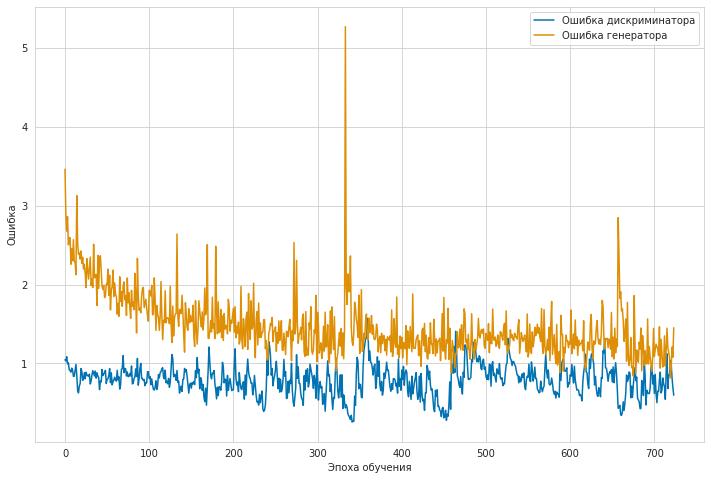

	...epoch 16 232/2500	batch 15/50	D loss: 0.617766	G loss: 1.031644
	...epoch 16 232/2500	batch 31/50	D loss: 0.538531	G loss: 1.089292
	...epoch 16 232/2500	batch 47/50	D loss: 0.568699	G loss: 1.315003


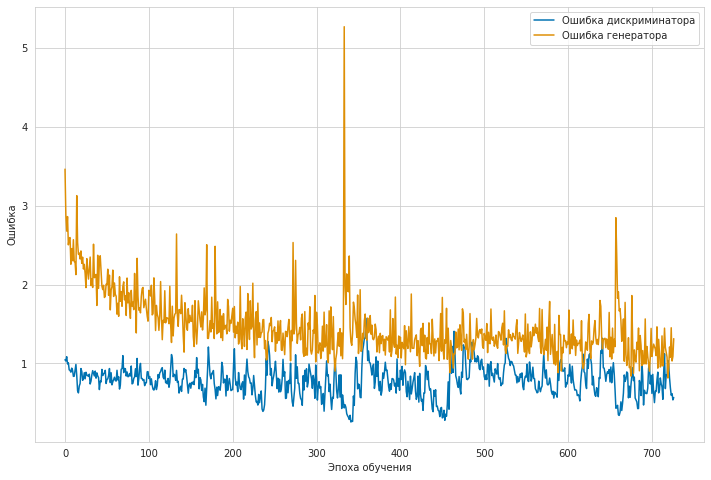

	...epoch 16 233/2500	batch 13/50	D loss: 0.456428	G loss: 1.037333
	...epoch 16 233/2500	batch 29/50	D loss: 0.653765	G loss: 1.120191
	...epoch 16 233/2500	batch 45/50	D loss: 0.796626	G loss: 1.109821


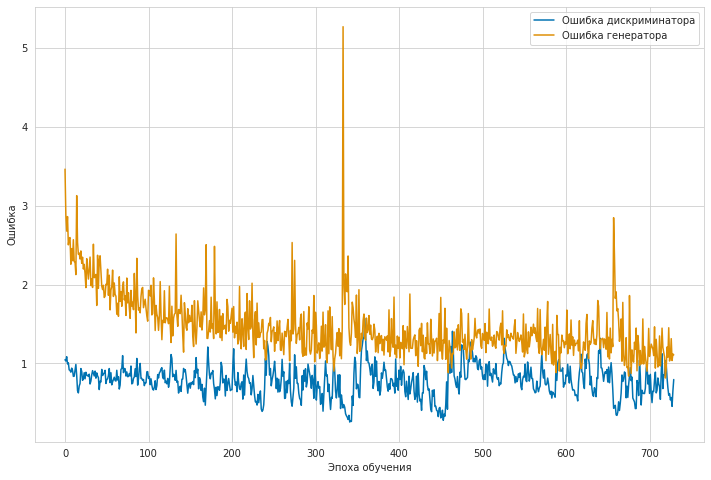

	...epoch 16 234/2500	batch 11/50	D loss: 0.423834	G loss: 1.213024
	...epoch 16 234/2500	batch 27/50	D loss: 0.780383	G loss: 1.212188
	...epoch 16 234/2500	batch 43/50	D loss: 0.911753	G loss: 0.925418


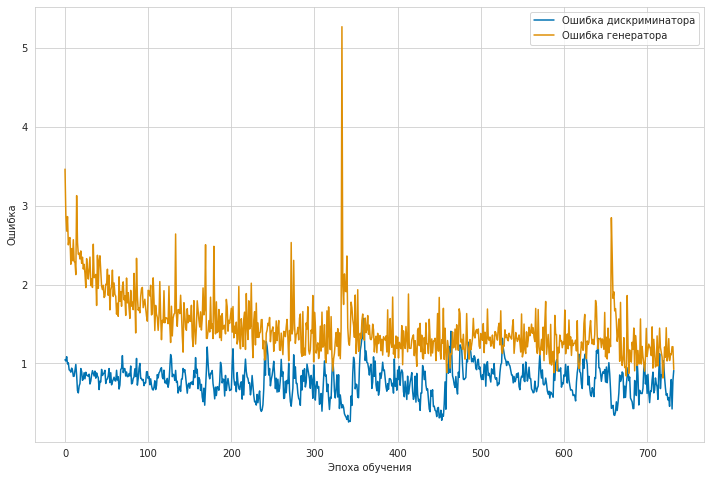

	...epoch 16 235/2500	batch 9/50	D loss: 0.557264	G loss: 1.309328
	...epoch 16 235/2500	batch 25/50	D loss: 0.608011	G loss: 1.015521
	...epoch 16 235/2500	batch 41/50	D loss: 0.633268	G loss: 0.849978


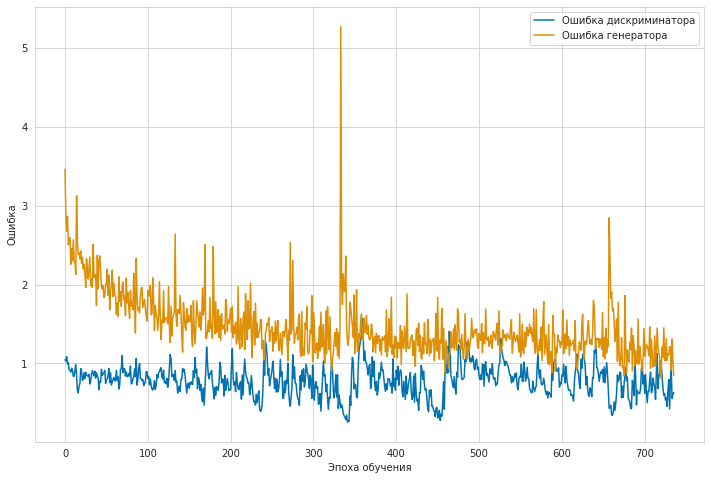

	...epoch 16 236/2500	batch 7/50	D loss: 0.622041	G loss: 0.943185
	...epoch 16 236/2500	batch 23/50	D loss: 0.583482	G loss: 1.054938
	...epoch 16 236/2500	batch 39/50	D loss: 0.465033	G loss: 1.003412


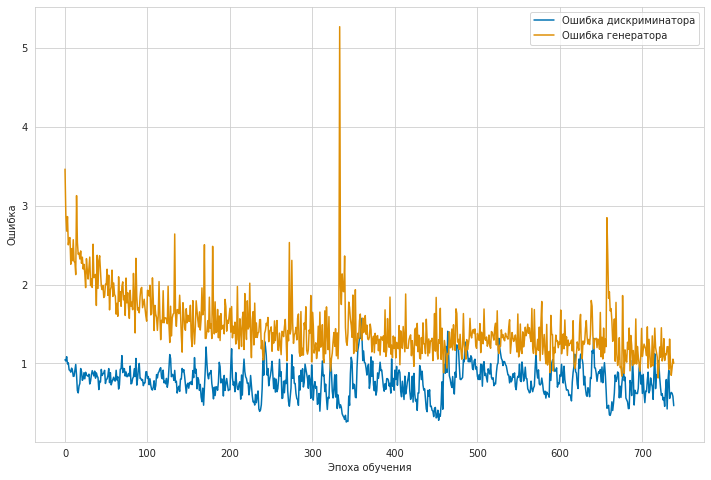

	...epoch 16 237/2500	batch 5/50	D loss: 0.719152	G loss: 1.214709
	...epoch 16 237/2500	batch 21/50	D loss: 0.574102	G loss: 1.118912
	...epoch 16 237/2500	batch 37/50	D loss: 0.886180	G loss: 0.896683


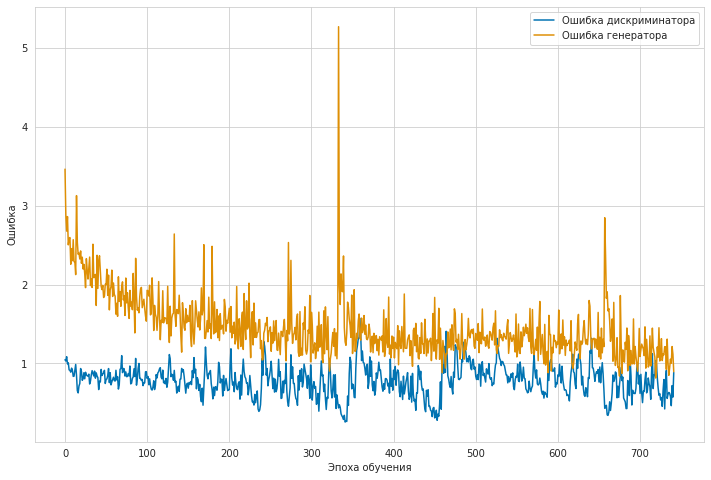

	...epoch 16 238/2500	batch 3/50	D loss: 0.611589	G loss: 0.981516
	...epoch 16 238/2500	batch 19/50	D loss: 0.781389	G loss: 1.074136
	...epoch 16 238/2500	batch 35/50	D loss: 0.459841	G loss: 1.100676


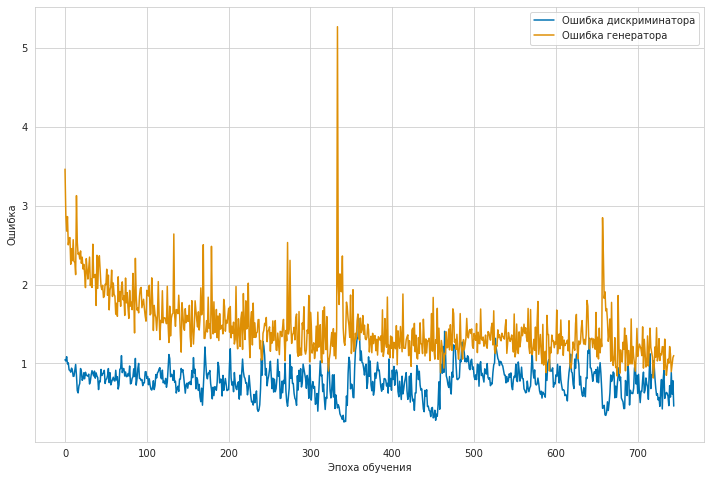

	...epoch 16 239/2500	batch 1/50	D loss: 0.450592	G loss: 0.998562
	...epoch 16 239/2500	batch 17/50	D loss: 0.830863	G loss: 1.365239
	...epoch 16 239/2500	batch 33/50	D loss: 0.486128	G loss: 1.194414
	...epoch 16 239/2500	batch 49/50	D loss: 0.549151	G loss: 1.320475


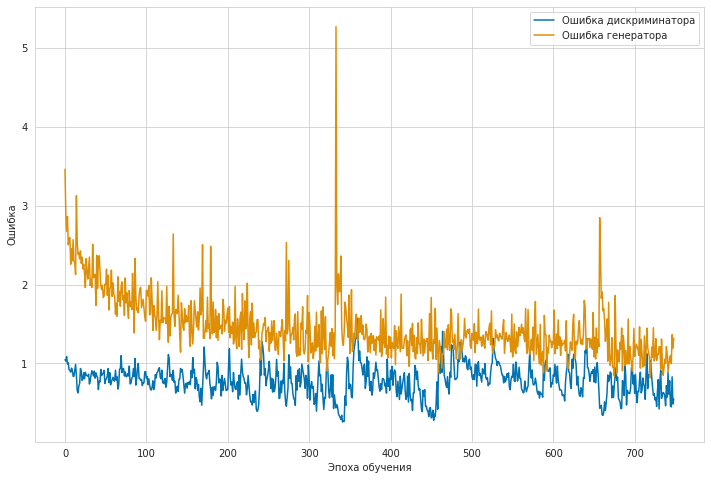

	...epoch 16 240/2500	batch 15/50	D loss: 0.491018	G loss: 1.295573
	...epoch 16 240/2500	batch 31/50	D loss: 0.589063	G loss: 1.463811
	...epoch 16 240/2500	batch 47/50	D loss: 0.533252	G loss: 0.951696


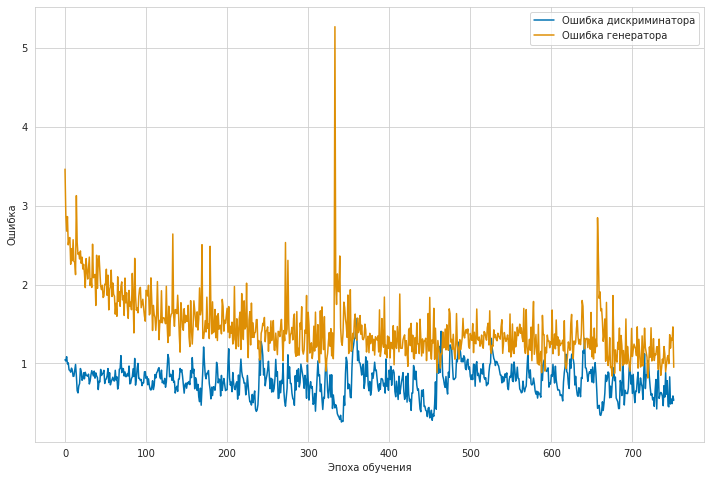

	...epoch 16 241/2500	batch 13/50	D loss: 1.087446	G loss: 0.855034
	...epoch 16 241/2500	batch 29/50	D loss: 0.733482	G loss: 1.249721
	...epoch 16 241/2500	batch 45/50	D loss: 0.670524	G loss: 1.526532


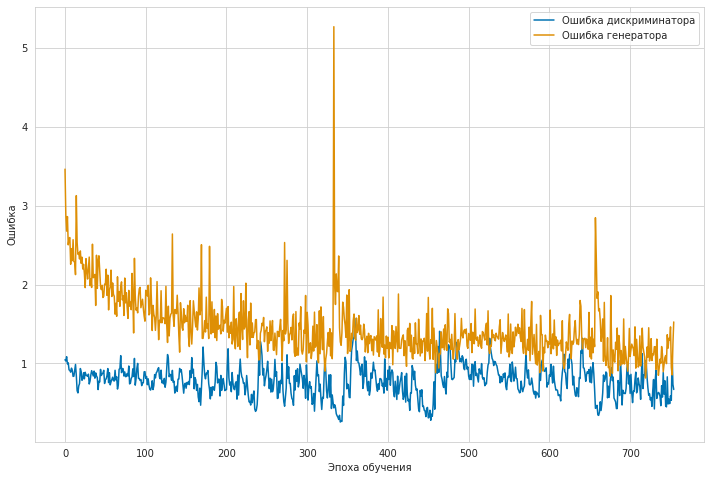

	...epoch 16 242/2500	batch 11/50	D loss: 0.766440	G loss: 1.018098
	...epoch 16 242/2500	batch 27/50	D loss: 0.828679	G loss: 0.906753
	...epoch 16 242/2500	batch 43/50	D loss: 0.668524	G loss: 0.898523


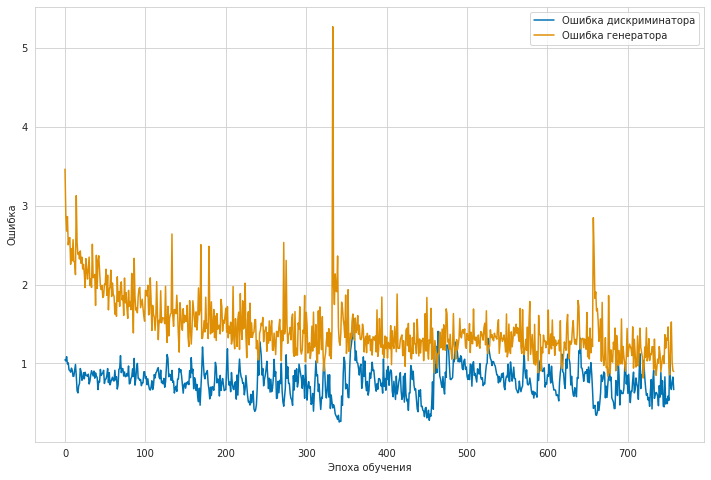

	...epoch 16 243/2500	batch 9/50	D loss: 0.723923	G loss: 0.867126
	...epoch 16 243/2500	batch 25/50	D loss: 1.050177	G loss: 1.468045
	...epoch 16 243/2500	batch 41/50	D loss: 0.950356	G loss: 1.195024


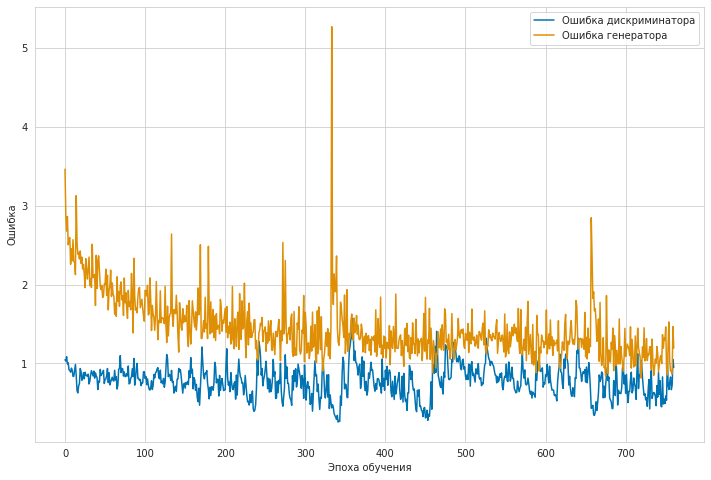

	...epoch 16 244/2500	batch 7/50	D loss: 0.992778	G loss: 1.085574
	...epoch 16 244/2500	batch 23/50	D loss: 0.832790	G loss: 1.164298
	...epoch 16 244/2500	batch 39/50	D loss: 0.926320	G loss: 1.144751


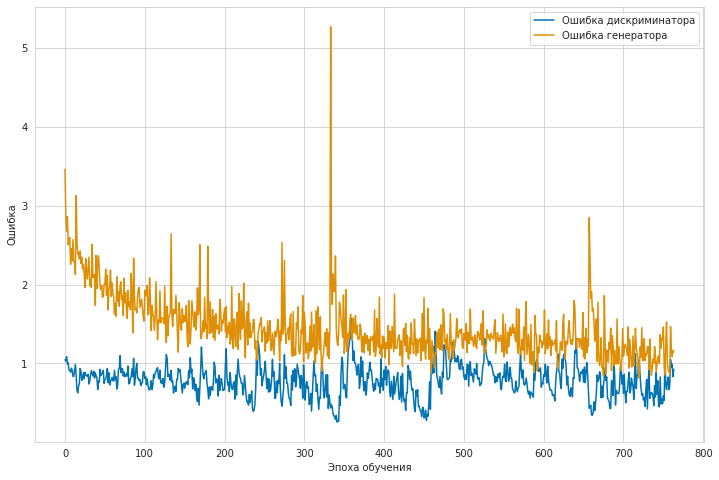

	...epoch 16 245/2500	batch 5/50	D loss: 0.735746	G loss: 1.360831
	...epoch 16 245/2500	batch 21/50	D loss: 0.561319	G loss: 0.962167
	...epoch 16 245/2500	batch 37/50	D loss: 0.737754	G loss: 0.977412


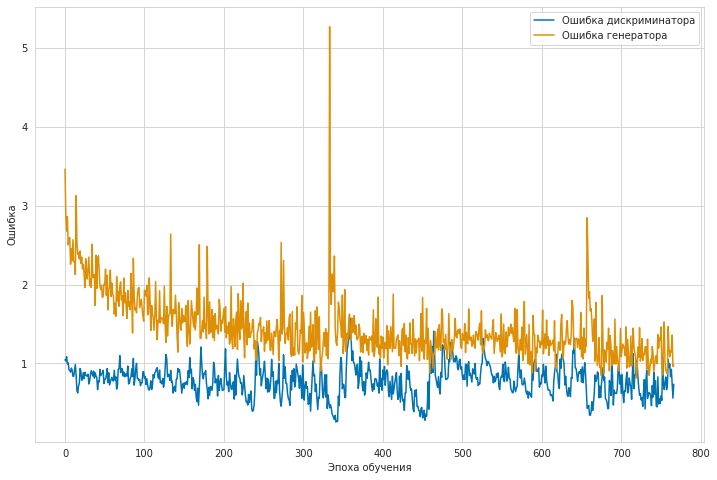

	...epoch 16 246/2500	batch 3/50	D loss: 0.703087	G loss: 1.393597
	...epoch 16 246/2500	batch 19/50	D loss: 0.631133	G loss: 1.110501
	...epoch 16 246/2500	batch 35/50	D loss: 0.622633	G loss: 1.024898


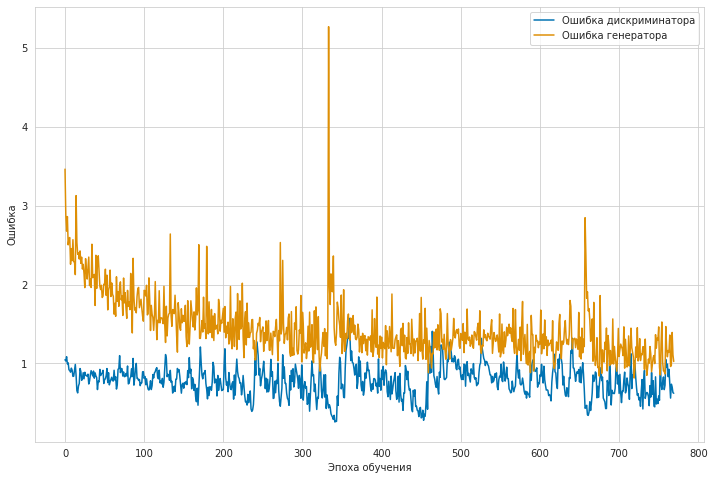

	...epoch 16 247/2500	batch 1/50	D loss: 0.857258	G loss: 1.255021
	...epoch 16 247/2500	batch 17/50	D loss: 0.624302	G loss: 1.264919
	...epoch 16 247/2500	batch 33/50	D loss: 0.648606	G loss: 1.059685
	...epoch 16 247/2500	batch 49/50	D loss: 0.657029	G loss: 0.950454


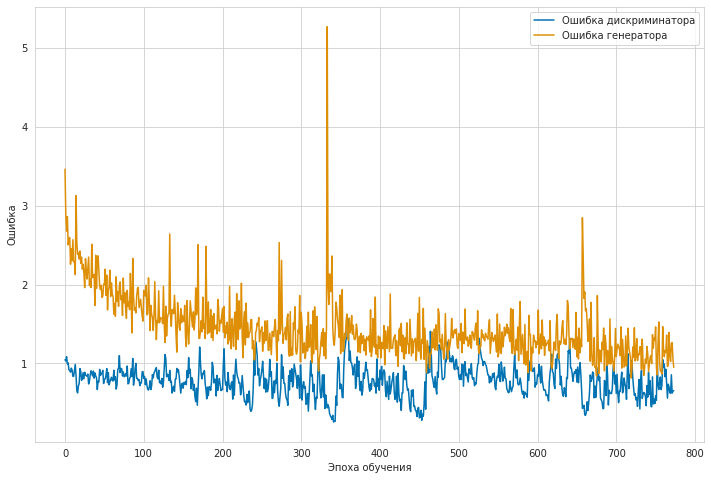

	...epoch 16 248/2500	batch 15/50	D loss: 0.713884	G loss: 1.272960
	...epoch 16 248/2500	batch 31/50	D loss: 0.572857	G loss: 1.060429
	...epoch 16 248/2500	batch 47/50	D loss: 0.535423	G loss: 1.205038


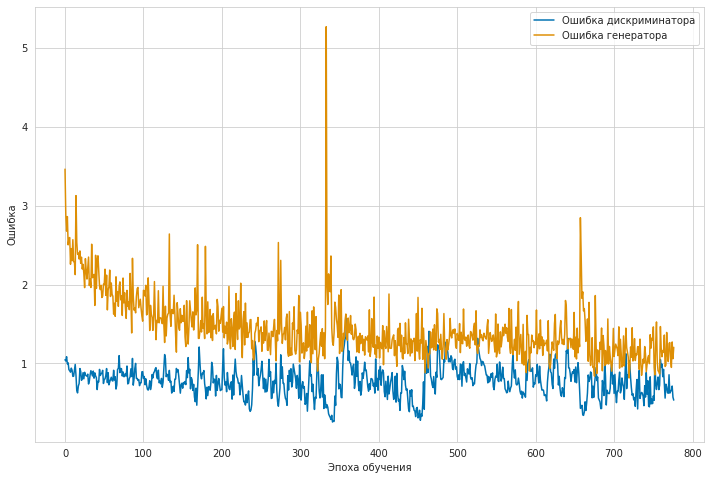

	...epoch 16 249/2500	batch 13/50	D loss: 0.389202	G loss: 1.011336
	...epoch 16 249/2500	batch 29/50	D loss: 0.376377	G loss: 1.075464
	...epoch 16 249/2500	batch 45/50	D loss: 0.436812	G loss: 1.341854


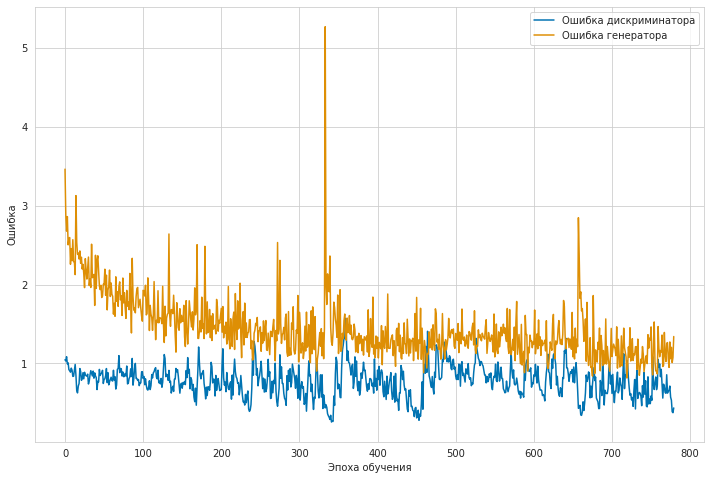

	...epoch 16 250/2500	batch 11/50	D loss: 0.443752	G loss: 0.916602
	...epoch 16 250/2500	batch 27/50	D loss: 0.407340	G loss: 1.523864
	...epoch 16 250/2500	batch 43/50	D loss: 0.468837	G loss: 1.077723


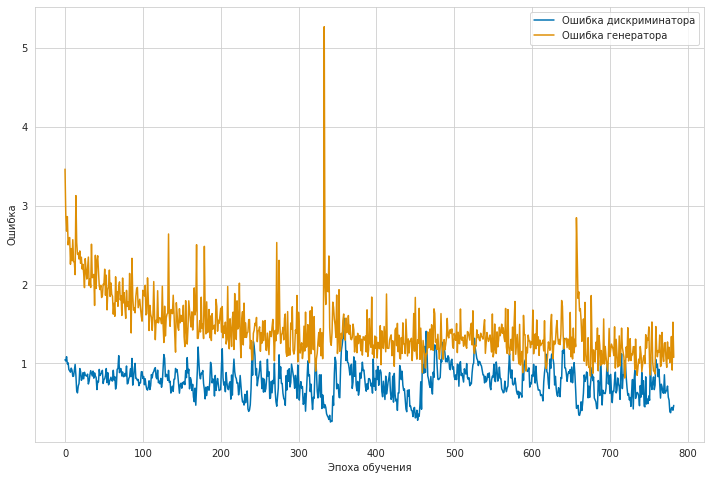

	...epoch 16 251/2500	batch 9/50	D loss: 0.464985	G loss: 1.096893
	...epoch 16 251/2500	batch 25/50	D loss: 0.463043	G loss: 1.497444
	...epoch 16 251/2500	batch 41/50	D loss: 0.364004	G loss: 1.021929


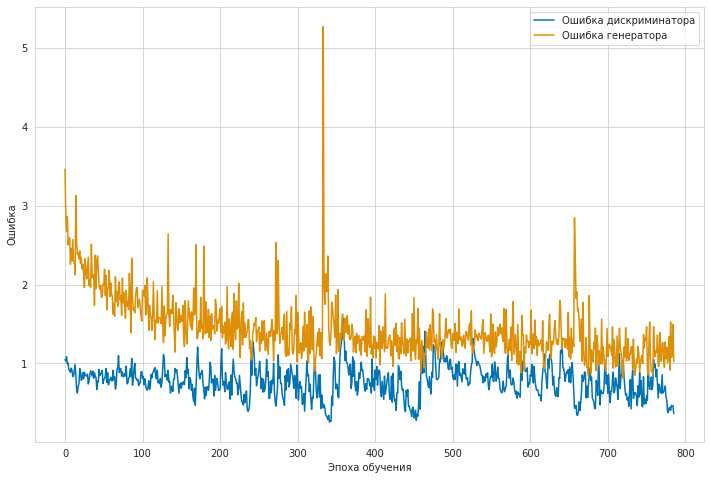

	...epoch 16 252/2500	batch 7/50	D loss: 0.364207	G loss: 0.918326
	...epoch 16 252/2500	batch 23/50	D loss: 0.497520	G loss: 1.082682
	...epoch 16 252/2500	batch 39/50	D loss: 0.484259	G loss: 0.874661


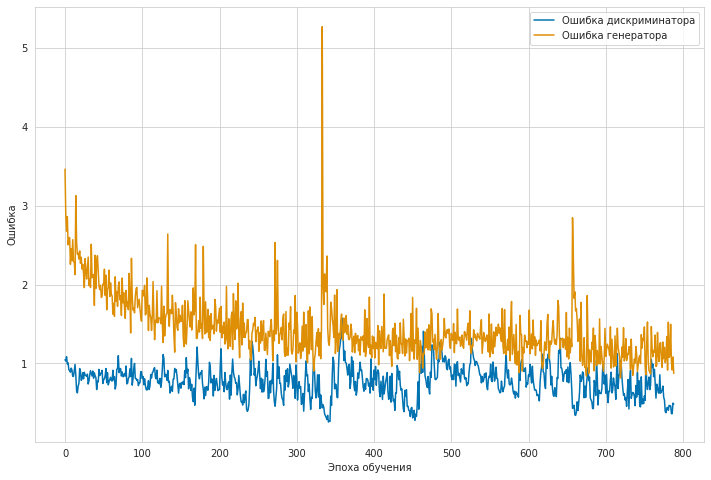

	...epoch 16 253/2500	batch 5/50	D loss: 0.527159	G loss: 1.336754
	...epoch 16 253/2500	batch 21/50	D loss: 0.701307	G loss: 0.851689
	...epoch 16 253/2500	batch 37/50	D loss: 0.741561	G loss: 1.003615


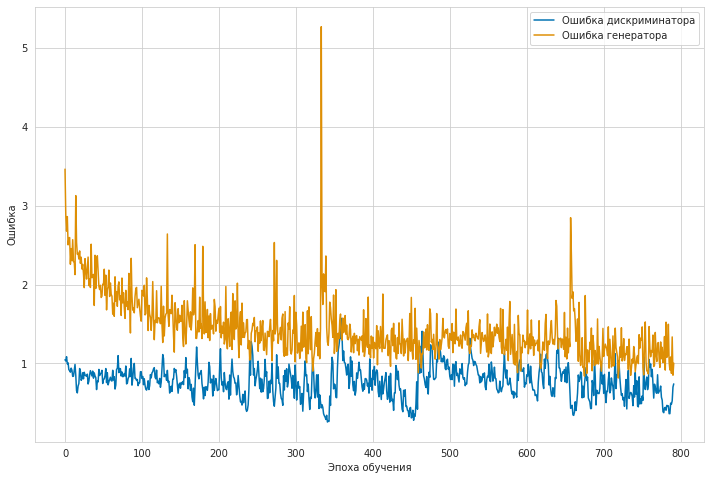

	...epoch 16 254/2500	batch 3/50	D loss: 0.608616	G loss: 0.997872
	...epoch 16 254/2500	batch 19/50	D loss: 0.663978	G loss: 0.906625
	...epoch 16 254/2500	batch 35/50	D loss: 0.916719	G loss: 1.161323


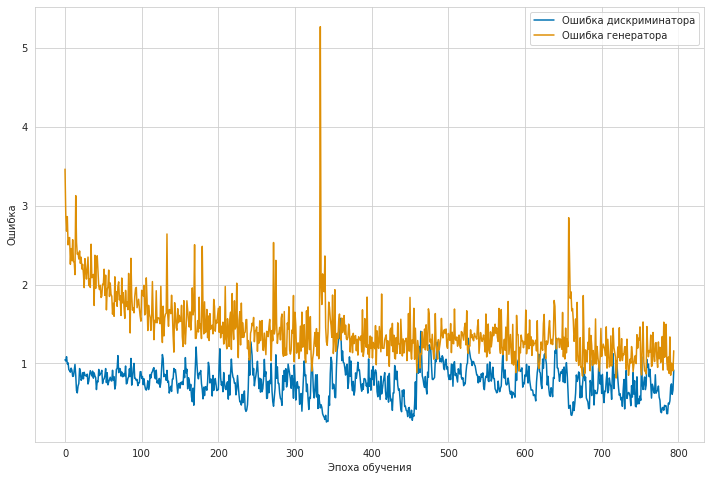

	...epoch 16 255/2500	batch 1/50	D loss: 0.570861	G loss: 0.914148
	...epoch 16 255/2500	batch 17/50	D loss: 0.608567	G loss: 1.262920
	...epoch 16 255/2500	batch 33/50	D loss: 0.809234	G loss: 1.534025
	...epoch 16 255/2500	batch 49/50	D loss: 0.584238	G loss: 0.883665


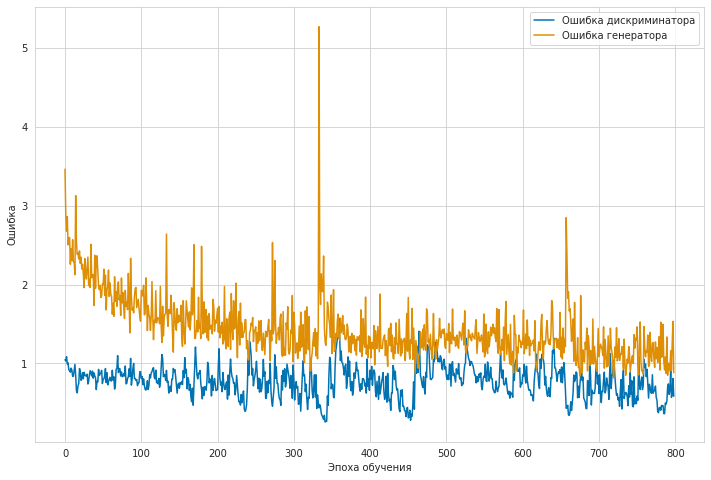

	...epoch 16 256/2500	batch 15/50	D loss: 0.512254	G loss: 1.133160
	...epoch 16 256/2500	batch 31/50	D loss: 0.615097	G loss: 0.909679
	...epoch 16 256/2500	batch 47/50	D loss: 0.963373	G loss: 0.914833


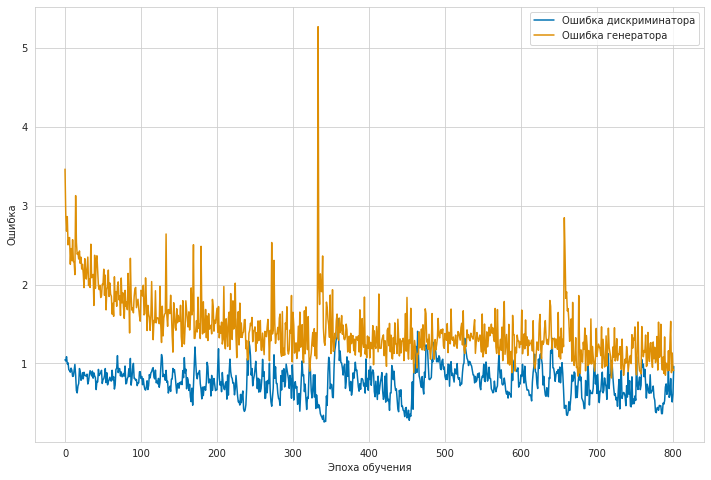

	...epoch 16 257/2500	batch 13/50	D loss: 0.566178	G loss: 1.432685
	...epoch 16 257/2500	batch 29/50	D loss: 0.526364	G loss: 0.992417
	...epoch 16 257/2500	batch 45/50	D loss: 0.944892	G loss: 1.078074


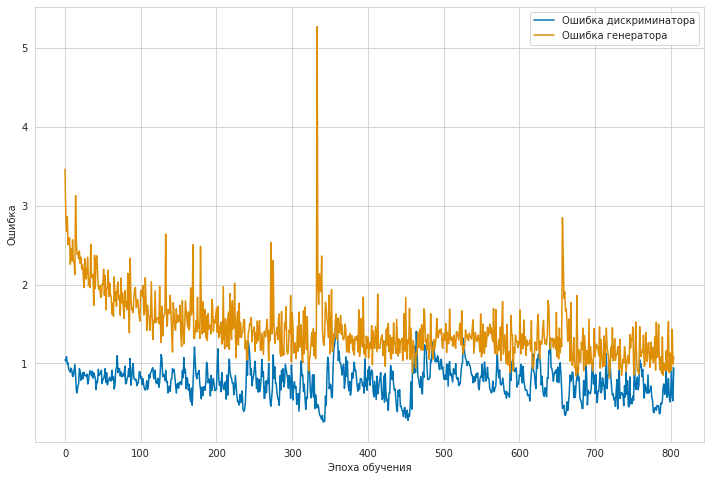

	...epoch 16 258/2500	batch 11/50	D loss: 0.526142	G loss: 1.156873
	...epoch 16 258/2500	batch 27/50	D loss: 0.719629	G loss: 1.094000
	...epoch 16 258/2500	batch 43/50	D loss: 0.416019	G loss: 1.497705


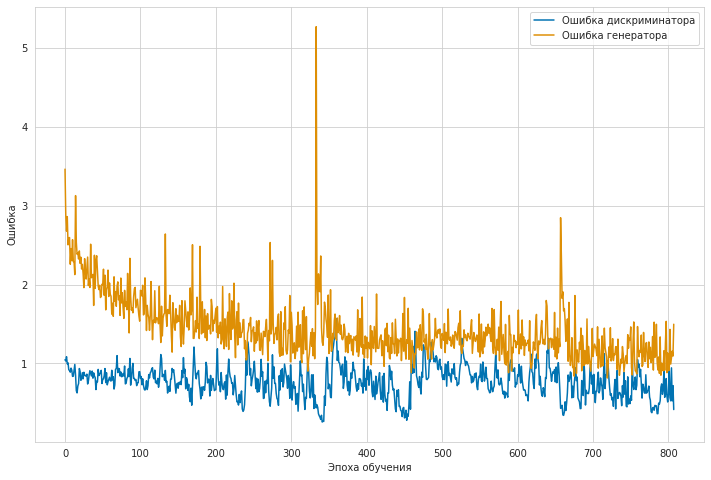

	...epoch 16 259/2500	batch 9/50	D loss: 0.467586	G loss: 0.919385
	...epoch 16 259/2500	batch 25/50	D loss: 0.413868	G loss: 1.043374
	...epoch 16 259/2500	batch 41/50	D loss: 0.458884	G loss: 0.968244


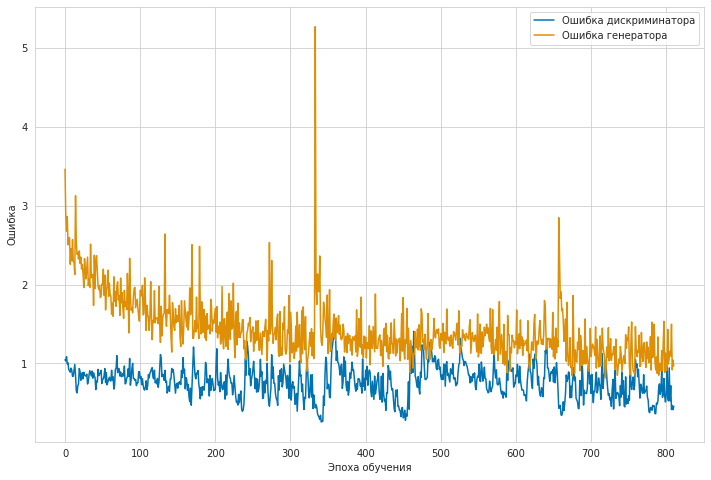

	...epoch 16 260/2500	batch 7/50	D loss: 0.416057	G loss: 1.206512
	...epoch 16 260/2500	batch 23/50	D loss: 0.910224	G loss: 1.077386
	...epoch 16 260/2500	batch 39/50	D loss: 1.033400	G loss: 1.017477


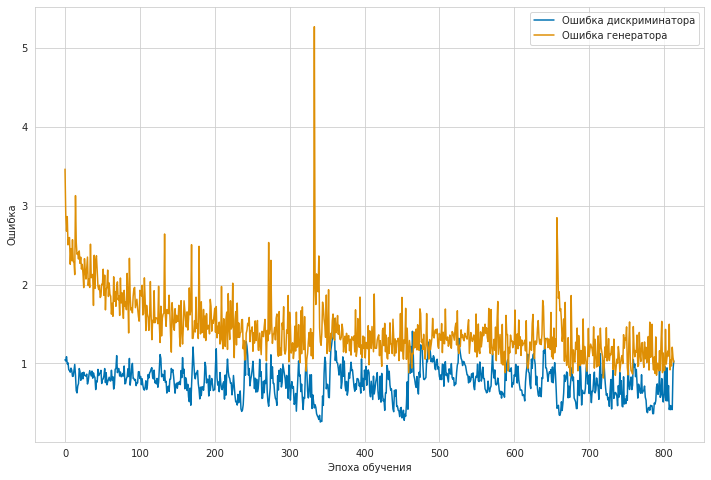

	...epoch 16 261/2500	batch 5/50	D loss: 0.639813	G loss: 0.957477
	...epoch 16 261/2500	batch 21/50	D loss: 0.538140	G loss: 0.968012
	...epoch 16 261/2500	batch 37/50	D loss: 0.624380	G loss: 1.290487


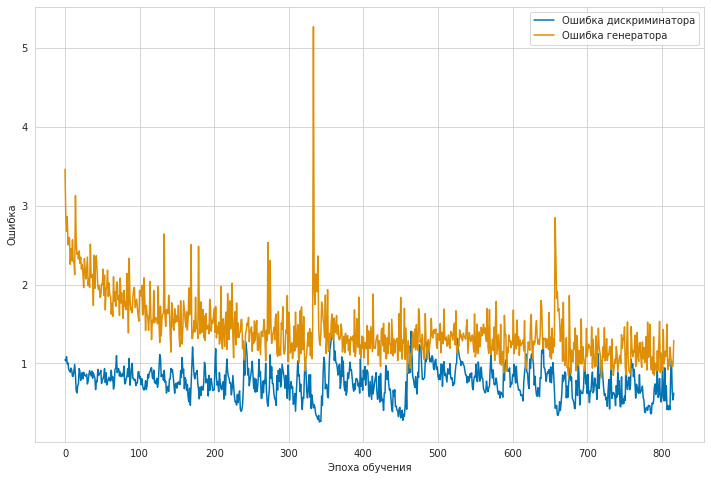

	...epoch 16 262/2500	batch 3/50	D loss: 0.576638	G loss: 0.901061
	...epoch 16 262/2500	batch 19/50	D loss: 1.093279	G loss: 0.796186
	...epoch 16 262/2500	batch 35/50	D loss: 0.870649	G loss: 0.879537


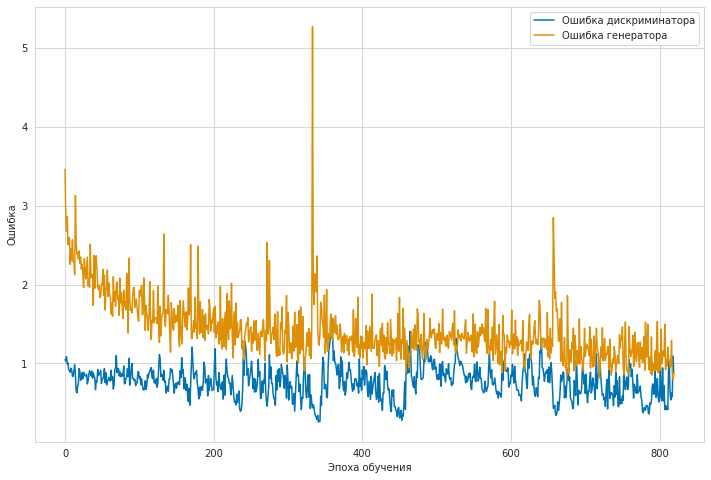

	...epoch 16 263/2500	batch 1/50	D loss: 0.641826	G loss: 1.056743
	...epoch 16 263/2500	batch 17/50	D loss: 0.424602	G loss: 1.091558
	...epoch 16 263/2500	batch 33/50	D loss: 0.582454	G loss: 0.989841
	...epoch 16 263/2500	batch 49/50	D loss: 0.699774	G loss: 1.450256


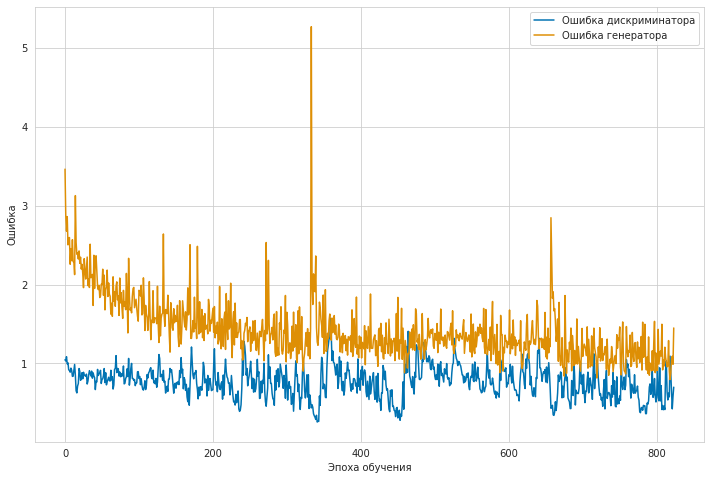

	...epoch 16 264/2500	batch 15/50	D loss: 0.511635	G loss: 0.926373
	...epoch 16 264/2500	batch 31/50	D loss: 0.487533	G loss: 0.913852
	...epoch 16 264/2500	batch 47/50	D loss: 0.612597	G loss: 1.110487


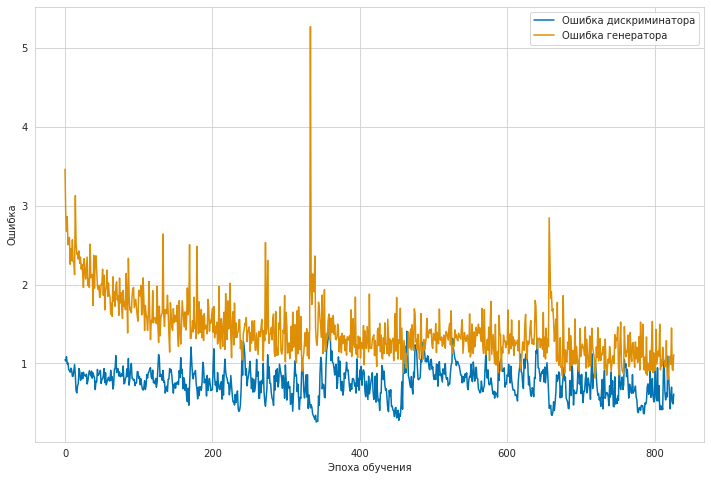

	...epoch 16 265/2500	batch 13/50	D loss: 1.025199	G loss: 1.019017
	...epoch 16 265/2500	batch 29/50	D loss: 0.832660	G loss: 1.213210
	...epoch 16 265/2500	batch 45/50	D loss: 0.983572	G loss: 1.567182


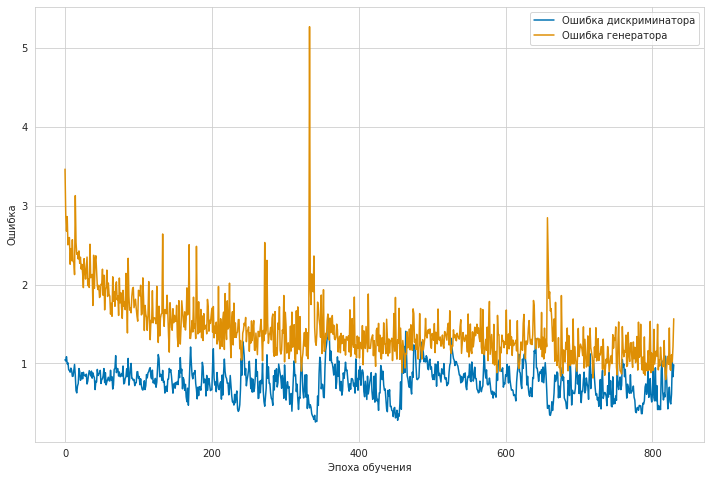

	...epoch 16 266/2500	batch 11/50	D loss: 1.035840	G loss: 0.952693
	...epoch 16 266/2500	batch 27/50	D loss: 0.969593	G loss: 1.112085
	...epoch 16 266/2500	batch 43/50	D loss: 0.746485	G loss: 1.151790


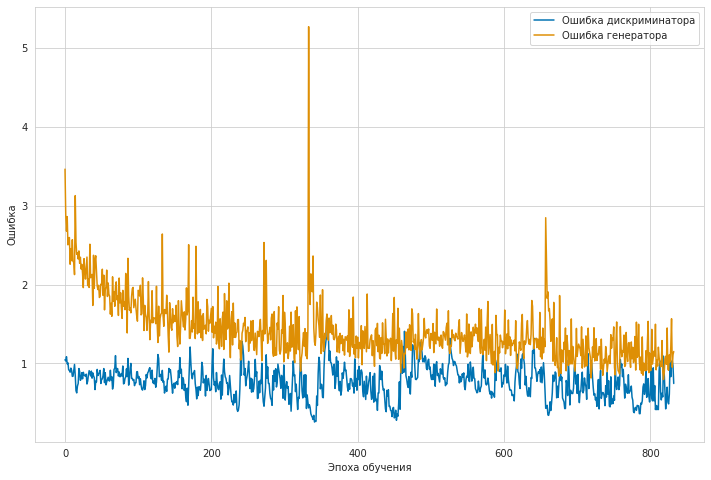

	...epoch 16 267/2500	batch 9/50	D loss: 1.017205	G loss: 1.121912
	...epoch 16 267/2500	batch 25/50	D loss: 0.744068	G loss: 1.320237
	...epoch 16 267/2500	batch 41/50	D loss: 0.646810	G loss: 1.102851


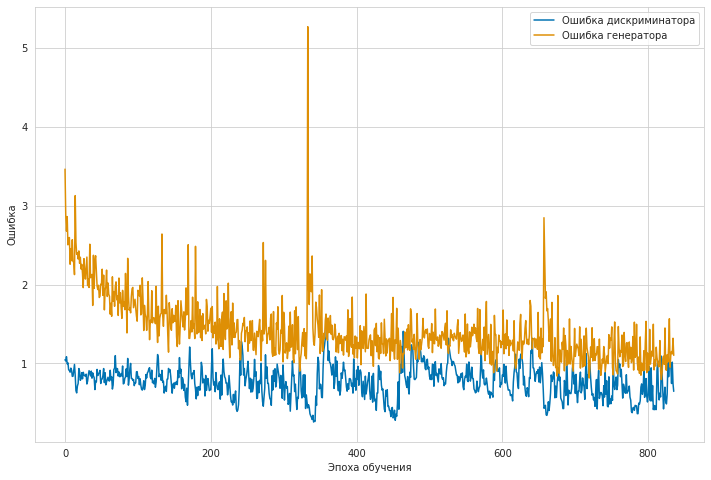

	...epoch 16 268/2500	batch 7/50	D loss: 0.743882	G loss: 1.201327
	...epoch 16 268/2500	batch 23/50	D loss: 0.727494	G loss: 1.455804
	...epoch 16 268/2500	batch 39/50	D loss: 0.482486	G loss: 1.056504


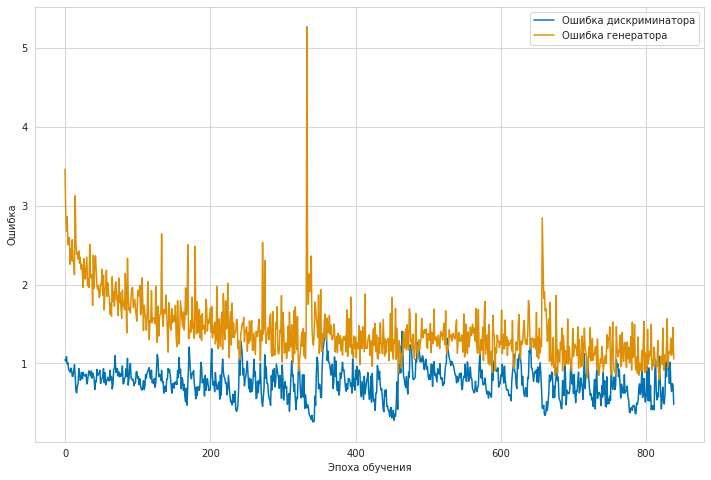

	...epoch 16 269/2500	batch 5/50	D loss: 0.659016	G loss: 0.969254
	...epoch 16 269/2500	batch 21/50	D loss: 0.927479	G loss: 1.152422
	...epoch 16 269/2500	batch 37/50	D loss: 0.619402	G loss: 1.018138


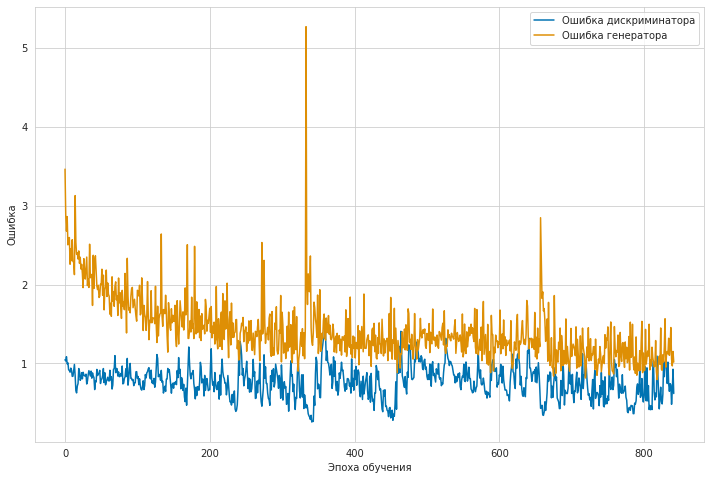

	...epoch 16 270/2500	batch 3/50	D loss: 0.672591	G loss: 0.965545
	...epoch 16 270/2500	batch 19/50	D loss: 0.631793	G loss: 1.258038
	...epoch 16 270/2500	batch 35/50	D loss: 0.642665	G loss: 1.037270


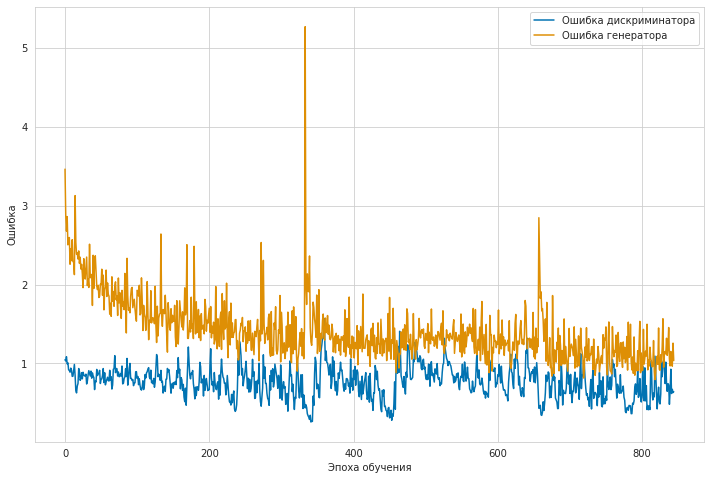

	...epoch 16 271/2500	batch 1/50	D loss: 0.547944	G loss: 1.273289
	...epoch 16 271/2500	batch 17/50	D loss: 0.538167	G loss: 0.913654
	...epoch 16 271/2500	batch 33/50	D loss: 0.450773	G loss: 1.605368
	...epoch 16 271/2500	batch 49/50	D loss: 0.495086	G loss: 1.033902


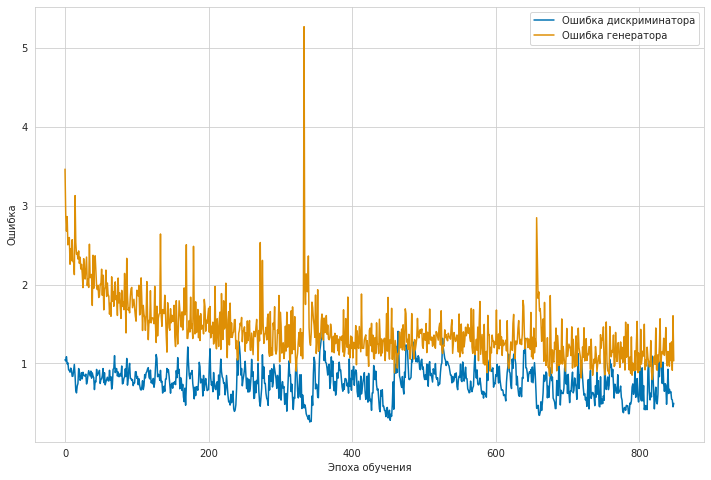

	...epoch 16 272/2500	batch 15/50	D loss: 0.550485	G loss: 0.803704
	...epoch 16 272/2500	batch 31/50	D loss: 0.339058	G loss: 1.368740
	...epoch 16 272/2500	batch 47/50	D loss: 0.483782	G loss: 0.964081


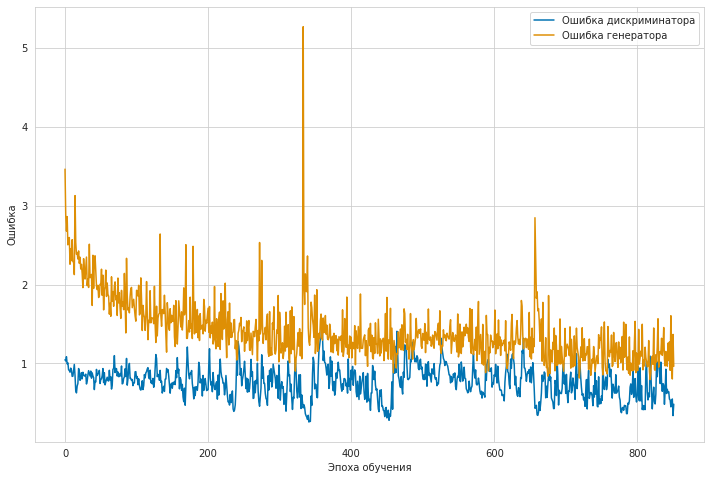

	...epoch 16 273/2500	batch 13/50	D loss: 0.591872	G loss: 0.943156
	...epoch 16 273/2500	batch 29/50	D loss: 0.656647	G loss: 1.037678
	...epoch 16 273/2500	batch 45/50	D loss: 0.453939	G loss: 1.314340


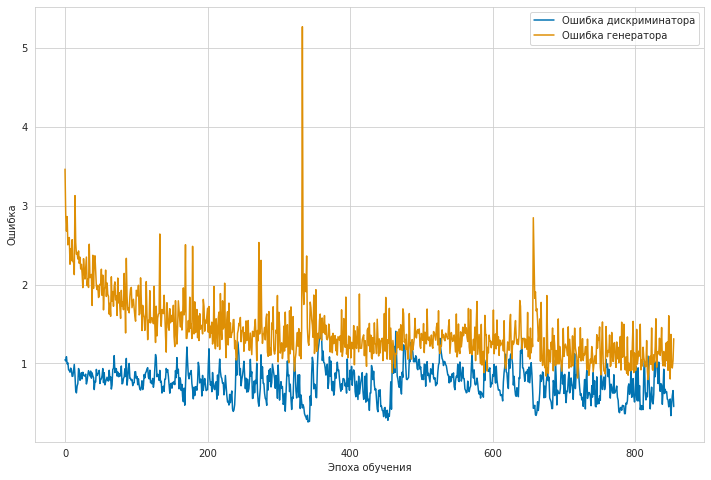

	...epoch 16 274/2500	batch 11/50	D loss: 0.709766	G loss: 1.019422
	...epoch 16 274/2500	batch 27/50	D loss: 0.839424	G loss: 1.227698
	...epoch 16 274/2500	batch 43/50	D loss: 1.248371	G loss: 0.952628


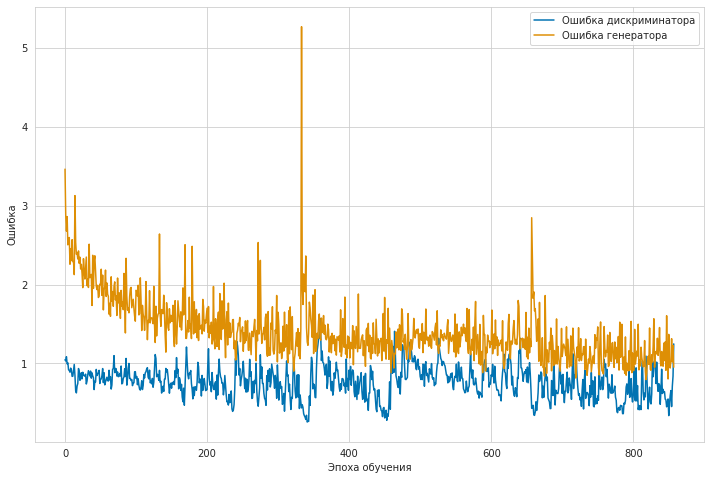

	...epoch 16 275/2500	batch 9/50	D loss: 1.210476	G loss: 1.145088


In [ ]:

from torchvision.utils import save_image
import itertools

#batch_size = 32
batch_size = 8 #1 так в статье

transform = transforms.Compose([
                  transforms.ToTensor(),
                 transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))])

path_to_data = '/content/drive/MyDrive/datasets/facades/'

# data loaders
#########################################################################
train_data_img = loadData_img(path_to_data, 'train', transform)
train_data_templ = loadData_templ(path_to_data, 'train', transform)

train_data_loader_img = torch.utils.data.DataLoader(dataset=train_data_img,
                                                batch_size=batch_size,
                                                shuffle=True)

train_data_loader_templ = torch.utils.data.DataLoader(dataset=train_data_templ,
                                                batch_size=batch_size,
                                                shuffle=True)

test_data_img = loadData_img(path_to_data, 'test', transform)
test_data_templ = loadData_templ(path_to_data, 'test', transform)

test_data_loader_img = torch.utils.data.DataLoader(dataset=test_data_img,
                                               batch_size=batch_size,
                                               shuffle=False)

test_data_loader_templ = torch.utils.data.DataLoader(dataset=test_data_templ,
                                               batch_size=batch_size,
                                               shuffle=False)

##########################################################################

GA2B = Generator(3, 3)
DA = Discriminator(3)
GB2A = Generator(3, 3)
DB = Discriminator(3)

GA2B.cuda()
DA.cuda()
GB2A.cuda()
DB.cuda()

cycle_loss = torch.nn.L1Loss().cuda()
adversarial_loss = torch.nn.MSELoss().cuda()

D_loss_func = torch.nn.MSELoss().cuda()

gan_losses = []
cycle_losses = []

lr, beta1, beta2 = 0.0002, 0.5, 0.999

G_optimizer = torch.optim.Adam(itertools.chain(GA2B.parameters(), 
                GB2A.parameters()), lr=lr, betas=(beta1, beta2))

DA_optimizer = torch.optim.Adam(DA.parameters(), lr=lr, betas=(beta1, beta2))
DB_optimizer = torch.optim.Adam(DB.parameters(), lr=lr, betas=(beta1, beta2))

batches_done = 0

num_epochs = 2500
D_losses = []
G_losses = []


buffer_size = 32
DA_buffer_real = []
DA_buffer_fake = []

DB_buffer_real = [] 
DB_buffer_fake = [] 

for epoch in range(num_epochs):
    for i, (input, target) in enumerate(zip(train_data_loader_templ,train_data_loader_img)):

        A_ = Variable(input.cuda())
        B_ = Variable(target.cuda())

        real_ = Variable(torch.ones(DA(A_).squeeze().size()).cuda())
        fake_ = Variable(torch.zeros(DA(A_).squeeze().size()).cuda())

        G_optimizer.zero_grad()

        # GAN loss
        fake_A = GB2A(B_)
        fake_output_A = DA(fake_A)
        loss_GAN_B2A = adversarial_loss(fake_output_A.squeeze(), real_) 

        fake_B = GA2B(A_)
        fake_output_B = DB(fake_B)
        loss_GAN_A2B = adversarial_loss(fake_output_B.squeeze(), real_) 

        # Cycle loss
        recovered_A = GB2A(fake_B)
        loss_cycle_ABA = cycle_loss(recovered_A, A_) * 10

        recovered_B = GA2B(fake_A)
        loss_cycle_BAB = cycle_loss(recovered_B, B_) * 10

        errG = loss_GAN_A2B + loss_GAN_B2A + loss_cycle_ABA + loss_cycle_BAB
        
        #print(loss_GAN_A2B.item(),loss_GAN_B2A.item(),loss_cycle_ABA.item(), loss_cycle_BAB.item() )
        errG.backward()
        G_optimizer.step()

        DA_buffer_real.append(A_.detach())
        DB_buffer_real.append(B_.detach())
        DA_buffer_fake.append(fake_A.detach())
        DB_buffer_fake.append(fake_B.detach())

        #while len(DA_buffer_real) > buffer_size:
        #  DA_buffer_real.pop(0)
        #  DB_buffer_real.pop(0)
        #  DA_buffer_fake.pop(0)
        #  DB_buffer_fake.pop(0)          
 
        if len(DA_buffer_real) >= buffer_size:
          # DA discr
          DA_optimizer.zero_grad()
          real_ = Variable(torch.ones(DB(torch.cat(DB_buffer_real, dim=0)).squeeze().size()).cuda())
          fake_ = Variable(torch.zeros(DB(torch.cat(DB_buffer_real, dim=0)).squeeze().size()).cuda())


          real_output_A = DA(torch.cat(DA_buffer_real, dim=0))#DA(A_)
          errD_real_A = D_loss_func(real_output_A.squeeze(), real_)

          fake_output_A = DA(torch.cat(DA_buffer_fake, dim=0)) #DA(fake_A)
          errD_fake_A = D_loss_func(fake_output_A.squeeze(), fake_)
          #print(fake_output_A.size(), fake_.size())
          errD_A = errD_real_A + errD_fake_A

          errD_A.backward()
          DA_optimizer.step()

          # DB discr
          DB_optimizer.zero_grad()



          real_output_B = DB(torch.cat(DB_buffer_real, dim=0))#DB(B_)
          errD_real_B = D_loss_func(real_output_B.squeeze(), real_)

          fake_output_B = DB(torch.cat(DB_buffer_fake, dim=0))#DB(fake_B.detach())
          errD_fake_B = D_loss_func(fake_output_B.squeeze(), fake_)

          errD_B = errD_real_B + errD_fake_B

          errD_B.backward()
          DB_optimizer.step()

          D_loss = (errD_A + errD_B).data.item()
          G_loss = errG.data.item()
          D_losses.append(D_loss)
          G_losses.append(G_loss)

          if (D_loss > 0.1):
            buffer_size = buffer_size/2 if buffer_size != 16 else 16 
          else:
            buffer_size = buffer_size*2 if buffer_size != 256 else 256


          print("\t...epoch %d %d/%d\tbatch %d/%d\tD loss: %.6f\tG loss: %.6f" % \
                        (buffer_size, epoch, num_epochs, i, len(train_data_loader_img),  D_loss, G_loss))

          DA_buffer_real = []
          DB_buffer_real = []
          DA_buffer_fake = []
          DB_buffer_fake = []   
          batches_done += 1

          if batches_done % 100 == 0:
                  gen_imgs = GA2B(A_)
                  gen_imgs = gen_imgs.cpu().data
                  save_image(gen_imgs.data, "%s/%05d.png" % (path_to_data + "/resultCycle/", batches_done), nrow=5, normalize=True)

    plot_losses(D_losses,G_losses )


for i, (input, target) in enumerate(test_data_loader):
          x_ = Variable(input.cuda())
          y_ = Variable(target.cuda())
          gen_imgsB = GA2B(x_)
          gen_imgsB = gen_imgsB.cpu().data
          
          gen_imgsA = GB2A(x_)
          gen_imgsA = gen_imgsA.cpu().data

          save_image(gen_imgs.dataB, "%s/%05dB.png" % (path_to_data + "/resultCycle/", batches_done), nrow=5, normalize=True)
          save_image(gen_imgs.dataA, "%s/%05dA.png" % (path_to_data + "/resultCycle/", batches_done), nrow=5, normalize=True)


In [11]:
!nvidia-smi

Fri Dec 18 01:35:47 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.45.01    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   56C    P8    10W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Новый раздел

In [ ]:
for i, (input, target) in enumerate(test_data_loader):
          x_ = Variable(input.cuda())
          y_ = Variable(target.cuda())
          gen_imgs = GA2B(x_)
          gen_imgs = gen_image.cpu().data
          save_image(gen_imgs.data[:], "Cycle%s/%05d.png" % (path_to_data + "/result/", batches_done), nrow=500, normalize=True)
